In [1]:
import os
import pandas as pd
import numpy as np
from tqdm import tqdm
import zipfile
import json
from gensim.models import Word2Vec
from gensim.models import KeyedVectors
from sklearn.preprocessing import MinMaxScaler
import tensorflow as tf
from tensorflow.keras.utils import Sequence
import math
import random as python_random
pd.set_option('display.max_row',500)
pd.set_option('display.max_columns',100)

In [2]:
Attack_list = ['CVE-2014-0160','Bruteforce_CWE-307']
#Attack_list = ['CVE-2012-2122']
'''Attack_list = ['Bruteforce_CWE-307','CVE-2019-5418', 'CVE-2020-13942', 'CVE-2020-23839', 
               'CVE-2014-0160', 'CWE-89-SQL-injection', 'CVE-2020-9484', 'CVE-2017-12635_6', 
               'CVE-2017-7529', 'CVE-2012-2122', 'CVE-2018-3760']'''
Base_dir = "/Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/LID-DS-2021/"
data_case_list = ['training','validation','test']
model_save_dir ='/Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/'
result_save_dir = '/Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/result/'

In [3]:
SEED = 42
BS = 32

In [4]:
np.random.seed(SEED)
python_random.seed(SEED)
tf.random.set_seed(SEED)
os.environ['PYTHONHASHSEED'] = str(SEED)
os.environ['TF_DETERMINISTIC_OPS'] = '1'

# Data Extracting 

In [5]:
def Data_extract(name):
        Base_tmp_dir = Base_dir+name
        for e_1 in data_case_list:
            if e_1 == 'test':
                file_dir = Base_tmp_dir+"/"+ e_1 +"/"+"normal"
                file_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in file_list:   
                    file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(file_list))
                for e in tqdm(file_list):
                    fold_dir = file_dir+"/"+e.replace('.zip','')
                    os.mkdir(fold_dir)
                    myzip = zipfile.ZipFile(file_dir+"/"+e)
                    myzip.extractall(fold_dir)
                    os.remove(file_dir+"/"+e)#zip file 제거
                file_dir = Base_tmp_dir+"/"+ e_1 +"/"+"normal_and_attack"
                file_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in file_list:   
                    file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(file_list))
                for e in tqdm(file_list):
                    fold_dir = file_dir+"/"+e.replace('.zip','')
                    os.mkdir(fold_dir)
                    myzip = zipfile.ZipFile(file_dir+"/"+e)
                    myzip.extractall(fold_dir)
                    os.remove(file_dir+"/"+e)#zip file 제거
            else:
                file_dir = Base_tmp_dir+"/"+ e_1
                file_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in file_list:   
                    file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(file_list))
                for e in tqdm(file_list):
                    fold_dir = file_dir+"/"+e.replace('.zip','')
                    os.mkdir(fold_dir)
                    myzip = zipfile.ZipFile(file_dir+"/"+e)
                    myzip.extractall(fold_dir)
                    os.remove(file_dir+"/"+e)#zip file 제거

In [6]:
for e in Attack_list: #unzip
    print(e)
    Data_extract(e)

CVE-2014-0160
210


  0%|                                                   | 0/210 [00:00<?, ?it/s]


FileExistsError: [Errno 17] File exists: '/Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/LID-DS-2021/CVE-2014-0160/training/abundant_mcclintock_1777'

# Make .csv file part

In [18]:
def make_csv(name): # .sc -> .csv
    Base_tmp_dir = Base_dir+name
    for e_1 in data_case_list:
            if e_1 == 'test':
                file_dir = Base_tmp_dir+"/"+ e_1 +"/"+"normal"
                fold_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in fold_list:   
                    fold_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(fold_list))
                for e in tqdm(fold_list):
                    sample = pd.read_table(file_dir+"/"+e+"/"+e+".sc", header=None)
                    tmp = []
                    for i in range (sample.shape[0]):
                        x = sample[0][i]
                        sp = x.split(' ', 7)
                        tmp.append(sp)
                    data = pd.DataFrame(tmp,columns=['event_time','cpu','user_uid','process','process_id','event_type','event_direction','event_argument'])
                    data.reset_index(drop=True,inplace=True)
                    data.to_csv(file_dir+"/"+e+"/"+e+".csv")
                
                file_dir = Base_tmp_dir+"/"+ e_1 +"/"+"normal_and_attack"
                fold_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in fold_list:   
                    fold_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(fold_list))
                for e in tqdm(fold_list):
                    sample = pd.read_table(file_dir+"/"+e+"/"+e+".sc", header=None)
                    tmp = []
                    for i in range (sample.shape[0]):
                        x = sample[0][i]
                        sp = x.split(' ', 7)
                        tmp.append(sp)
                    data = pd.DataFrame(tmp,columns=['event_time','cpu','user_uid','process','process_id','event_type','event_direction','event_argument'])
                    data.reset_index(drop=True,inplace=True)
                    data.to_csv(file_dir+"/"+e+"/"+e+".csv")

            else:
                file_dir = Base_tmp_dir+"/"+ e_1
                fold_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in fold_list:   
                    fold_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(fold_list))
                for e in tqdm(fold_list):
                    sample = pd.read_table(file_dir+"/"+e+"/"+e+".sc", header=None)
                    tmp = []
                    for i in range (sample.shape[0]):
                        x = sample[0][i]
                        sp = x.split(' ', 7)
                        tmp.append(sp)
                    data = pd.DataFrame(tmp,columns=['event_time','cpu','user_uid','process','process_id','event_type','event_direction','event_argument'])
                    data.reset_index(drop=True,inplace=True)
                    data.to_csv(file_dir+"/"+e+"/"+e+".csv")


In [19]:
for e in Attack_list: #.txt -> .csv converting part
    print(e)
    make_csv(e)

CVE-2012-2122
210


100%|█████████████████████████████████████████| 210/210 [00:36<00:00,  5.68it/s]


60


100%|███████████████████████████████████████████| 60/60 [00:09<00:00,  6.58it/s]


762


100%|█████████████████████████████████████████| 762/762 [02:08<00:00,  5.95it/s]


120


100%|█████████████████████████████████████████| 120/120 [05:12<00:00,  2.60s/it]


# Make Outline_json file part

In [20]:
def make_outline_json(name):
    Base_tmp_dir = Base_dir+name
    if "outline_json" not in os.listdir(Base_tmp_dir):
        os.mkdir(Base_tmp_dir+"/outline_json")
    for e_1 in data_case_list:
            scenario_name = []
            is_exploit = []
            recording_time =[]
            exploit_absolute = []
            victim_ip = []
            victim_name = []
            attacker_ip = []
            attacker_name = []
            if e_1 == 'test':
                file_dir = Base_tmp_dir+"/"+ e_1 +"/"+"normal"#normal file
                file_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in file_list:   
                    file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(file_list))
                for e in tqdm(file_list):
                    scenario_name.append(e)
                    with open(file_dir + "/"+e+"/"+e+".json", 'r', encoding='utf-8') as file:
                        json_data = json.load(file)
                    is_exploit.append(json_data['exploit'])
                    recording_time.append(json_data["recording_time"])
                    exploit_absolute.append(-1)
                    attacker_ip.append("no")
                    attacker_name.append("no")
                    victim_ip.append(json_data['container'][-1]['ip'])
                    victim_name.append(json_data['container'][-1]['name'])
                data = pd.DataFrame(zip(scenario_name,is_exploit,recording_time,exploit_absolute,
                                    victim_ip,victim_name,attacker_ip,attacker_name),
                                    columns=['scenario_name','is_exploit','recording_time','exploit_absolute',
                                    'victim_ip','victim_name','attacker_ip','attacker_name'])
                data.to_csv(Base_tmp_dir+"/outline_json/"+e_1+"_normal.csv")
                     
                scenario_name = []
                is_exploit = []
                recording_time =[]
                exploit_absolute = []
                victim_ip = []
                victim_name = []
                attacker_ip = []
                attacker_name = []
    
                file_dir = Base_tmp_dir+"/"+ e_1 +"/"+"normal_and_attack"#normal_and_attack_file
                file_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in file_list:   
                    file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(file_list))
                for e in tqdm(file_list):
                    scenario_name.append(e)
                    with open(file_dir + "/"+e+"/"+e+".json", 'r', encoding='utf-8') as file:
                        json_data = json.load(file)
                    is_exploit.append(json_data['exploit'])
                    recording_time.append(json_data["recording_time"])
                    tmp_str = str(json_data['time']['exploit'][0]['absolute']).replace('.','')
                    exploit_absolute.append(tmp_str)
                    attacker_ip.append(json_data['container'][-2]['ip'])
                    attacker_name.append(json_data['container'][-2]['name'])
                    victim_ip.append(json_data['container'][-1]['ip'])
                    victim_name.append(json_data['container'][-1]['name'])
                    print(json_data['exploit'])
                    #print("Is victim? : " + json_data['container'][-1]['role'])
                    #print("Is attack? : " + json_data['container'][-2]['role'])
        
                data = pd.DataFrame(zip(scenario_name,is_exploit,recording_time,exploit_absolute,
                                    victim_ip,victim_name,attacker_ip,attacker_name),
                                    columns=['scenario_name','is_exploit','recording_time','exploit_absolute',
                                    'victim_ip','victim_name','attacker_ip','attacker_name'])
                data.to_csv(Base_tmp_dir+"/outline_json/"+e_1+"_normal_and_attack.csv")
                   
            else: #validation or training
                file_dir = Base_tmp_dir+"/"+ e_1
                file_list = sorted(os.listdir(file_dir))
                if '.DS_Store' in file_list:   
                    file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
                print(len(file_list))
                for e in tqdm(file_list):
                    scenario_name.append(e)
                    with open(file_dir + "/"+e+"/"+e+".json", 'r', encoding='utf-8') as file:
                        json_data = json.load(file)
                    is_exploit.append(json_data['exploit'])
                    recording_time.append(json_data["recording_time"])
                    if json_data['exploit']==True:
                        tmp_str = str(json_data['time']['exploit'][0]['absolute']).replace('.','')
                        exploit_absolute.append(tmp_str)
                        attacker_ip.append(json_data['container'][-1]['ip'])
                        attacker_name.append(json_data['container'][-1]['name'])
                        victim_ip.append(json_data['container'][-2]['ip'])
                        victim_name.append(json_data['container'][-2]['name'])
                        
                    else:
                        exploit_absolute.append(-1)
                        attacker_ip.append("no")
                        attacker_name.append("no")
                        victim_ip.append(json_data['container'][-1]['ip'])
                        victim_name.append(json_data['container'][-1]['name'])
                data = pd.DataFrame(zip(scenario_name,is_exploit,recording_time,exploit_absolute,
                                    victim_ip,victim_name,attacker_ip,attacker_name),
                                    columns=['scenario_name','is_exploit','recording_time','exploit_absolute',
                                    'victim_ip','victim_name','attacker_ip','attacker_name'])
                data.to_csv(Base_tmp_dir+"/outline_json/"+e_1+".csv")
                            
                    
                   

In [21]:
for e in Attack_list:
    make_outline_json(e)

210


100%|███████████████████████████████████████| 210/210 [00:00<00:00, 5052.83it/s]


60


100%|█████████████████████████████████████████| 60/60 [00:00<00:00, 5409.79it/s]


762


100%|███████████████████████████████████████| 762/762 [00:00<00:00, 5699.24it/s]


120


100%|███████████████████████████████████████| 120/120 [00:00<00:00, 5165.51it/s]

True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True
True


# Detect nan

In [65]:
def detect_nan(name):
    Base_tmp_dir = Base_dir+name
    for e_1 in data_case_list:
        count=0
        if e_1 == 'test':
            file_dir = Base_tmp_dir+"/"+ e_1+"/normal"
            file_list = sorted(os.listdir(file_dir))
            if '.DS_Store' in file_list:   
                 file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
            print(len(file_list))
            print("TEST ONLY NORMAL")
            print("##########################################")
            for e in tqdm(file_list):
                sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")
                if sample['process'].isnull().sum() != 0:
                    print('process detected')
                    print(e)
                    print(sample['process'].isnull().sum())
                    count = count+1
                if sample['event_type'].isnull().sum() != 0:
                    print('event_type detected')
                    print(e)
                    print(sample['event_type'].isnull().sum())
                    count = count+1
                if sample['cpu'].isnull().sum() != 0:
                    print('cpu detected')
                    print(e)
                    print(sample['cpu'].isnull().sum())
                    count = count+1
                if sample['user_uid'].isnull().sum() != 0:
                    print('user_uid detected')
                    print(e)
                    print(sample['user_uid'].isnull().sum())
                    count = count+1
                if sample['event_direction'].isnull().sum() != 0:
                    print('event_direction detected')
                    print(e)
                    print(sample['event_direction'].isnull().sum())
                    count = count+1
            print("---------------------------------------------")
            print("Detect complete" + name+ "normal test data")
            print(f"Total file has nan : {count}")
            print("---------------------------------------------")
            count=0
            file_dir = Base_tmp_dir+"/"+ e_1+"/normal_and_attack"
            file_list = sorted(os.listdir(file_dir))
            if '.DS_Store' in file_list:   
                 file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
            print(len(file_list))
            print("DETECT NORMAL AND ATTACK TEST DATA")
            print("##########################################")
            for e in tqdm(file_list):
                sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")
                if sample['process'].isnull().sum() != 0:
                    print('process detected')
                    print(e)
                    print(sample['process'].isnull().sum())
                    count = count+1
                if sample['event_type'].isnull().sum() != 0:
                    print('event_type detected')
                    print(e)
                    print(sample['event_type'].isnull().sum())
                    count = count+1
                if sample['cpu'].isnull().sum() != 0:
                    print('cpu detected')
                    print(e)
                    print(sample['cpu'].isnull().sum())
                    count = count+1
                if sample['user_uid'].isnull().sum() != 0:
                    print('user_uid detected')
                    print(e)
                    print(sample['user_uid'].isnull().sum())
                    count = count+1
                if sample['event_direction'].isnull().sum() != 0:
                    print('event_direction detected')
                    print(e)
                    print(sample['event_direction'].isnull().sum())
                    count = count+1
            print("---------------------------------------------")
            print("Detect complete" + name+ " normal and test data")
            print(f"Total file has nan : {count}")
            print("---------------------------------------------")
        else:
            file_dir = Base_tmp_dir+"/"+ e_1
            file_list = sorted(os.listdir(file_dir))
            if '.DS_Store' in file_list:   
                 file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
            print(len(file_list))
            print("DETECT " + e_1)
            print("##########################################")
            for e in tqdm(file_list):
                sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")
                if sample['process'].isnull().sum() != 0:
                    print('process detected')
                    print(e)
                    print(sample['process'].isnull().sum())
                    count = count+1
                if sample['event_type'].isnull().sum() != 0:
                    print('event_type detected')
                    print(e)
                    print(sample['event_type'].isnull().sum())
                    count = count+1
                if sample['cpu'].isnull().sum() != 0:
                    print('cpu detected')
                    print(e)
                    print(sample['cpu'].isnull().sum())
                    count = count+1
                if sample['user_uid'].isnull().sum() != 0:
                    print('user_uid detected')
                    print(e)
                    print(sample['user_uid'].isnull().sum())
                    count = count+1
                if sample['event_direction'].isnull().sum() != 0:
                    print('event_direction detected')
                    print(e)
                    print(sample['event_direction'].isnull().sum())
                    count = count+1
            print("---------------------------------------------")
            print("Detect Complete "+ name+" " + e_1+ " data")
            print(f"Total file has nan : {count}")
            print("---------------------------------------------")

In [66]:
for name in Attack_list:
    print("Detect nan "+name)
    print("STARTING")
    detect_nan(name)

Detect nan Bruteforce_CWE-307
STARTING
210
DETECT training
##########################################


 46%|███████████████████▍                      | 97/210 [00:01<00:01, 71.65it/s]

process detected
bumpy_archimedes_1442
1504


 70%|████████████████████████████▋            | 147/210 [00:01<00:00, 77.11it/s]

process detected
cool_galois_5635
3028


100%|█████████████████████████████████████████| 210/210 [00:02<00:00, 76.85it/s]


---------------------------------------------
Detect Complete Bruteforce_CWE-307 training data
Total file has nan : 2
---------------------------------------------
60
DETECT validation
##########################################


100%|███████████████████████████████████████████| 60/60 [00:00<00:00, 83.47it/s]


---------------------------------------------
Detect Complete Bruteforce_CWE-307 validation data
Total file has nan : 0
---------------------------------------------
768
TEST ONLY NORMAL
##########################################


100%|█████████████████████████████████████████| 768/768 [00:10<00:00, 75.70it/s]


---------------------------------------------
Detect completeBruteforce_CWE-307normal test data
Total file has nan : 0
---------------------------------------------
139
DETECT NORMAL AND ATTACK TEST DATA
##########################################


  4%|█▊                                         | 6/139 [00:00<00:02, 54.67it/s]

process detected
blue_haibt_8901
312


 54%|██████████████████████▋                   | 75/139 [00:01<00:00, 64.92it/s]

process detected
lemon_edison_5091
604


 97%|███████████████████████████████████████▊ | 135/139 [00:02<00:00, 67.96it/s]

process detected
thousands_yonath_7961
490


100%|█████████████████████████████████████████| 139/139 [00:02<00:00, 64.97it/s]


---------------------------------------------
Detect completeBruteforce_CWE-307 normal and test data
Total file has nan : 3
---------------------------------------------
Detect nan CWE-89-SQL-injection
STARTING
210
DETECT training
##########################################


  2%|█                                          | 5/210 [00:00<00:22,  9.28it/s]

process detected
acidic_ganguly_5247
9322


 26%|███████████                               | 55/210 [00:06<00:19,  8.11it/s]

process detected
big_dijkstra_9046
389


 43%|██████████████████▏                       | 91/210 [00:11<00:14,  8.46it/s]

process detected
bumpy_lalande_9739
5150
process detected
bumpy_lamport_5763
19268


 57%|███████████████████████▏                 | 119/210 [00:14<00:09,  9.13it/s]

process detected
clean_franklin_8510
16370


 82%|█████████████████████████████████▊       | 173/210 [00:20<00:03, 10.61it/s]

process detected
dead_darwin_6543
4086


100%|█████████████████████████████████████████| 210/210 [00:24<00:00,  8.70it/s]


---------------------------------------------
Detect Complete CWE-89-SQL-injection training data
Total file has nan : 6
---------------------------------------------
60
DETECT validation
##########################################


100%|███████████████████████████████████████████| 60/60 [00:06<00:00,  9.38it/s]


---------------------------------------------
Detect Complete CWE-89-SQL-injection validation data
Total file has nan : 0
---------------------------------------------
760
TEST ONLY NORMAL
##########################################


  0%|▏                                          | 3/760 [00:00<00:34, 21.95it/s]

process detected
famous_williamson_6512
16950


  7%|██▉                                       | 53/760 [00:06<01:21,  8.67it/s]

process detected
gentle_vaughan_6731
45566


  9%|███▋                                      | 66/760 [00:07<01:11,  9.66it/s]

process detected
gorgeous_perlman_5628
22567


 11%|████▋                                     | 84/760 [00:09<01:37,  6.92it/s]

process detected
hallowed_archimedes_7512
6051


 12%|█████                                     | 91/760 [00:10<01:30,  7.39it/s]

process detected
handsome_dewdney_2058
494


 15%|██████▎                                  | 117/760 [00:13<00:58, 11.06it/s]

process detected
hissing_kalam_8056
504


 16%|██████▋                                  | 125/760 [00:14<01:04,  9.78it/s]

process detected
hot_thompson_4242
25394


 17%|███████                                  | 130/760 [00:14<01:11,  8.87it/s]

process detected
howling_sinoussi_7284
764


 21%|████████▌                                | 158/760 [00:18<01:10,  8.56it/s]

process detected
itchy_heisenberg_4950
12242


 24%|█████████▊                               | 181/760 [00:21<01:08,  8.51it/s]

process detected
juicy_mendeleev_5056
19808


 27%|███████████▏                             | 208/760 [00:24<00:59,  9.31it/s]

process detected
little_tu_8424
8318


 33%|█████████████▌                           | 252/760 [00:29<00:55,  9.22it/s]

process detected
mealy_lamport_3772
307


 37%|███████████████▎                         | 284/760 [00:33<01:03,  7.52it/s]

process detected
muscular_sammet_4613
273


 40%|████████████████▌                        | 307/760 [00:36<00:44, 10.07it/s]

process detected
noisy_jones_5324
21288


 45%|██████████████████▌                      | 345/760 [00:40<00:44,  9.35it/s]

process detected
old_jones_4414
42962


 46%|██████████████████▋                      | 346/760 [00:41<00:48,  8.52it/s]

process detected
orange_hoover_5077
217


 61%|█████████████████████████▏               | 467/760 [00:56<00:39,  7.40it/s]

process detected
round_tu_2246
196


 63%|██████████████████████████               | 482/760 [00:58<00:34,  7.99it/s]

process detected
scary_kalam_9347
82


 64%|██████████████████████████▏              | 486/760 [00:58<00:25, 10.86it/s]

process detected
scrawny_mayer_2248
1315


 66%|███████████████████████████▏             | 505/760 [01:00<00:25, 10.03it/s]

process detected
shapely_keller_7822
2830


 73%|█████████████████████████████▉           | 556/760 [01:06<00:24,  8.17it/s]

process detected
spoiled_shockley_5513
4477


 76%|██████████████████████████████▉          | 574/760 [01:08<00:22,  8.14it/s]

process detected
steep_varahamihira_8337
136


 76%|███████████████████████████████▏         | 578/760 [01:09<00:21,  8.56it/s]

process detected
sticky_taussig_2728
7264


 85%|██████████████████████████████████▊      | 646/760 [01:17<00:14,  8.00it/s]

process detected
thundering_poitras_8151
12264


 86%|███████████████████████████████████      | 651/760 [01:17<00:13,  7.99it/s]

process detected
tight_minsky_8725
11374


 87%|███████████████████████████████████▊     | 663/760 [01:19<00:11,  8.31it/s]

process detected
tiny_pasteur_3605
15226
process detected
ugly_clarke_7409
26186


 91%|█████████████████████████████████████▍   | 694/760 [01:23<00:07,  8.68it/s]

process detected
uptight_rhodes_1378
1702


 92%|█████████████████████████████████████▌   | 696/760 [01:23<00:07,  8.50it/s]

process detected
vast_mayer_8293
9332


100%|█████████████████████████████████████████| 760/760 [01:31<00:00,  8.34it/s]


---------------------------------------------
Detect completeCWE-89-SQL-injectionnormal test data
Total file has nan : 29
---------------------------------------------
120
DETECT NORMAL AND ATTACK TEST DATA
##########################################


 39%|████████████████▍                         | 47/120 [00:06<00:09,  7.41it/s]

process detected
important_bhabha_8359
2955


 76%|███████████████████████████████▊          | 91/120 [00:13<00:04,  6.22it/s]

process detected
substantial_galileo_3513
50013


 92%|█████████████████████████████████████▌   | 110/120 [00:15<00:01,  8.18it/s]

process detected
vast_diffie_8844
8672


100%|█████████████████████████████████████████| 120/120 [00:17<00:00,  6.95it/s]


---------------------------------------------
Detect completeCWE-89-SQL-injection normal and test data
Total file has nan : 3
---------------------------------------------
Detect nan CVE-2014-0160
STARTING
210
DETECT training
##########################################


 10%|████                                     | 21/210 [00:00<00:00, 203.46it/s]

process detected
alive_aryabhata_1878
284


100%|████████████████████████████████████████| 210/210 [00:00<00:00, 224.37it/s]


process detected
drab_elbakyan_5293
422
---------------------------------------------
Detect Complete CVE-2014-0160 training data
Total file has nan : 2
---------------------------------------------
60
DETECT validation
##########################################


100%|██████████████████████████████████████████| 60/60 [00:00<00:00, 245.91it/s]


---------------------------------------------
Detect Complete CVE-2014-0160 validation data
Total file has nan : 0
---------------------------------------------
758
TEST ONLY NORMAL
##########################################


100%|████████████████████████████████████████| 758/758 [00:03<00:00, 230.38it/s]


---------------------------------------------
Detect completeCVE-2014-0160normal test data
Total file has nan : 0
---------------------------------------------
120
DETECT NORMAL AND ATTACK TEST DATA
##########################################


100%|████████████████████████████████████████| 120/120 [00:00<00:00, 403.93it/s]

---------------------------------------------
Detect completeCVE-2014-0160 normal and test data
Total file has nan : 0
---------------------------------------------


# Word2Vec modeling Part

In [5]:
W2V_Sliding_size = 10
W2V_Window_size = 7
W2V_Vector_size = 50
#W2V_Vector_size = [150,200,250,300]
w2v_model_name = 'word2vec_combination_'+str(W2V_Window_size)+'_'+str(W2V_Vector_size)+'.model'
#w2v_model_name = 'word2vec_CVE_'+str(W2V_Window_size)+'_'+str(W2V_Vector_size)+'.model'
print(w2v_model_name)

word2vec_combination_7_50.model


In [6]:
def W2V(name_list,sliding_size,window_size,v_size): # .sc -> .
    sentence = []
    for name in name_list:
        print("Saving "+ name +" system call sequence")
        Base_tmp_dir = Base_dir+name
        file_dir = Base_tmp_dir+"/"+ 'training'
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        print(len(file_list))
        for e in tqdm(file_list):
            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")
            system_calls = sample['event_type']
            sentence.append(system_calls.tolist())
    model = Word2Vec(sentences=sentence, vector_size=v_size, window=window_size, workers=0, sg=1, seed=SEED)
    return model

In [26]:
for e in W2V_Vector_size:
    w2v_model_name = 'word2vec_all_'+str(W2V_Window_size)+'_'+str(e)+'.model'
    print(w2v_model_name)
    w2v_model = W2V(Attack_list,W2V_Sliding_size,W2V_Window_size,e)
    #model = W2V('CWE-89-SQL-injection',W2V_Sliding_size,W2V_Window_size,W2V_Vector_size)
    #plz set attack name
    w2v_model.save(model_save_dir+'w2v/'+w2v_model_name)
    print("Save complete : "+ model_save_dir+'w2v/'+w2v_model_name)
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!
#CAUTION!!!!!!!!!!!!!!!!

word2vec_all_7_10.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 179.05it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 61.75it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:04<00:00, 50.33it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_10.model
word2vec_all_7_20.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 182.96it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 61.91it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 55.86it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_20.model
word2vec_all_7_30.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 177.26it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 60.29it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:04<00:00, 43.44it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_30.model
word2vec_all_7_40.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 180.68it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 66.19it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:04<00:00, 46.62it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_40.model
word2vec_all_7_50.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 138.66it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 58.63it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 55.07it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_50.model
word2vec_all_7_60.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 148.31it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 62.70it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:04<00:00, 49.30it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_60.model
word2vec_all_7_70.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 166.57it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 62.28it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:04<00:00, 47.66it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_70.model
word2vec_all_7_80.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 145.32it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 59.26it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 52.73it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_80.model
word2vec_all_7_90.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 136.65it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 53.00it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:04<00:00, 44.60it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_90.model
word2vec_all_7_100.model
Saving CVE-2014-0160 system call sequence
210


100%|████████████████████████████████████████| 210/210 [00:01<00:00, 181.30it/s]


Saving Bruteforce_CWE-307 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 64.17it/s]


Saving CVE-2012-2122 system call sequence
210


100%|█████████████████████████████████████████| 210/210 [00:03<00:00, 57.82it/s]


Save complete : /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/w2v/word2vec_all_7_100.model


In [88]:
w2v_model.wv

In [73]:
w2v_model.wv.key_to_index

{'read': 0,
 'open': 1,
 'close': 2,
 'fstat': 3,
 'umask': 4,
 'writev': 5,
 'poll': 6,
 'setitimer': 7,
 'semop': 8,
 'fcntl': 9,
 'write': 10,
 'brk': 11,
 'getcwd': 12,
 'chdir': 13,
 'mmap': 14,
 'epoll_wait': 15,
 'getsockname': 16,
 'accept': 17,
 'shutdown': 18,
 'stat': 19,
 'times': 20,
 'munmap': 21,
 'rt_sigaction': 22,
 'rt_sigprocmask': 23,
 'chmod': 24,
 'rename': 25,
 'select': 26,
 'wait4': 27,
 'lstat': 28,
 'geteuid': 29,
 'lseek': 30,
 'epoll_ctl': 31,
 'clone': 32,
 'epoll_create1': 33,
 'set_robust_list': 34,
 'setgid': 35,
 'setgroups': 36,
 'setuid': 37}

# Load Word2vec model

In [7]:
#load embedding model
w2v_model = Word2Vec.load(model_save_dir+'w2v/'+w2v_model_name)

# Making Training data and validation data

In [8]:
model_input_sliding_size = 30
np.set_printoptions(threshold=np.inf)

In [9]:
def making_model_input(x,model_input_sliding_size):
    s_size = model_input_sliding_size
    x = np.array(x)
    data = []
    for i in range(x.shape[0]-s_size+1):
        data.append(x[i:i+s_size][:])
    
    return np.array(data)

In [10]:
def embedding_syscall(syscall): #해당하는 w2v모델과 공격이 일치하는지 확인해야함.
    embedding_vector = w2v_model.wv.get_vector(syscall)
    return embedding_vector

In [11]:
scaler= MinMaxScaler() #Use MinMaxScaler

In [12]:
def extract_params(arg_list): #extract r
    arg_list = arg_list.astype(str)
    res = []
    size = []
    fd = []
    for i in range(len(arg_list)):
        tmp = arg_list[i].strip().split(' ')
        params = {}
        for e in tmp:
            try:
                split = e.split('=',1)
                params[split[0]] = split[1]
            except:
                pass
        try:
            if int(params['res']) < 10000000:
                res.append(int(params['res']))
            else:
                res.append(-1)
        except:
            res.append(0)
      
        try:
            if int(params['size']) < 10000000:
                size.append(int(params['size']))
            else:
                size.append(-1)
        except:             
            size.append(0)
        try:
            tmp_fd = params['fd'].split('(')[0]  
            if int(tmp_fd) < 10000000:
                fd.append(tmp_fd)
    
            else:
                fd.append(-1)
        except:             
            fd.append(0)
    return res, size, fd;

In [13]:
training_file_size = 30
validation_file_size = 10

In [14]:
def make_training(name_list):
    sample_event_direction = []
    sample_event_type = []
    #sample_cpu = []
    sample_user_uid = []
    sample_res = []
    sample_size = []
    sample_fd = []
    for name in name_list:
        print("Start "+ name)
        Base_tmp_dir = Base_dir+name
        file_dir = Base_tmp_dir+"/"+ 'training'
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        file_list = file_list[:training_file_size]
        for e in tqdm(file_list):
            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")
            sample_event_direction.extend(sample['event_direction'])

            sample_event_type_tmp = sample['event_type'].tolist()
            sample_event_type_tmp = list(map(embedding_syscall,sample_event_type_tmp))
            sample_event_type.extend(sample_event_type_tmp)
            #sample_cpu.extend(sample['cpu'])
            sample_user_uid.extend(sample['user_uid'])
            sample_param = sample['event_argument']
            tmp_res, tmp_size, tmp_fd = extract_params(sample_param)
            sample_fd.extend(tmp_fd)
            sample_res.extend(tmp_res)
            sample_size.extend(tmp_size)
        
    #return_x = pd.DataFrame(zip(sample_cpu,sample_user_uid), columns=['cpu','user_uid'])
    return_x = pd.DataFrame(zip(sample_res),columns =['res'])
    '''
    Normalization part
    '''
    return_x = scaler.fit_transform(return_x)
    return_x = pd.DataFrame(return_x,columns=['res'])
    return_x['event_direction'] = sample_event_direction
    return_x = pd.get_dummies(return_x, columns=['event_direction'])
    return_x.drop(['event_direction_<'],axis=1,inplace=True)

    sample_event_type_df = pd.DataFrame(sample_event_type)
    return_x = pd.concat([return_x, sample_event_type_df],axis=1)
    
    return return_x
    

In [15]:
def make_validation(name_list):
    sample_event_direction = []
    sample_event_type = []
    #sample_cpu = []
    sample_user_uid = []
    sample_res = []
    sample_size = []
    sample_fd = []
    for name in name_list:
        print("Start "+ name)
        Base_tmp_dir = Base_dir+name
        file_dir = Base_tmp_dir+"/"+ 'validation'
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        file_list = file_list[:validation_file_size]
        for e in tqdm(file_list):
            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")
            sample_event_direction.extend(sample['event_direction'])

            sample_event_type_tmp = sample['event_type'].tolist()
            sample_event_type_tmp = list(map(embedding_syscall,sample_event_type_tmp))
            sample_event_type.extend(sample_event_type_tmp)


            #sample_cpu.extend(sample['cpu'])
            sample_user_uid.extend(sample['user_uid'])
            sample_param = sample['event_argument']
            tmp_res, tmp_size,tmp_fd = extract_params(sample_param)
            sample_res.extend(tmp_res)
            sample_size.extend(tmp_size)
            sample_fd.extend(tmp_fd)
        
    #return_x = pd.DataFrame(zip(sample_cpu,sample_user_uid), columns=['cpu','user_uid'])

    return_x = pd.DataFrame(zip(sample_res),columns =['res'])
    return_x = scaler.transform(return_x)
    return_x = pd.DataFrame(return_x,columns=['res'])
    
    
    return_x['event_direction'] = sample_event_direction
    return_x = pd.get_dummies(return_x, columns=['event_direction'])
    return_x.drop(['event_direction_<'],axis=1,inplace=True)
    

    sample_event_type_df = pd.DataFrame(sample_event_type)
    return_x = pd.concat([return_x, sample_event_type_df],axis=1)
    
    return return_x
    

In [16]:
training_data = make_training(Attack_list)
validation_data = make_validation(Attack_list)
#plz set attack name..
print(training_data.shape)
print(validation_data.shape)

Start CVE-2014-0160


100%|███████████████████████████████████████████| 30/30 [00:00<00:00, 62.50it/s]


Start Bruteforce_CWE-307


100%|███████████████████████████████████████████| 30/30 [00:01<00:00, 17.58it/s]


Start CVE-2014-0160


100%|███████████████████████████████████████████| 10/10 [00:00<00:00, 84.19it/s]


Start Bruteforce_CWE-307


100%|███████████████████████████████████████████| 10/10 [00:00<00:00, 21.30it/s]


(588393, 52)
(159260, 52)


In [17]:
training_data

,res,event_direction_>,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
0,0.000122,0,0.018452,-0.014089,-0.016550,0.017445,0.002201,-0.002484,0.009500,-0.004667,-0.014883,0.009187,-0.012960,0.002120,0.017963,0.017446,-0.005569,0.011212,0.004507,-0.000825,-0.014403,-0.004946,0.006077,0.019465,-0.019804,0.008710,0.013853,0.018048,-0.003048,-0.015261,-0.009161,0.014021,0.015117,0.005483,-0.015090,-0.015123,-0.000873,0.003530,-0.018705,0.007444,0.001780,-0.019508,-0.016173,-0.001827,0.008903,0.013016,-0.002748,-0.008186,0.018732,-0.001658,-0.007384,-0.002307
1,0.000061,1,0.019202,0.012059,0.018528,-0.010458,-0.008488,0.013976,-0.010205,-0.017711,0.006765,0.012039,0.018728,0.017112,-0.015191,0.010884,0.013845,0.007925,0.012792,0.013519,-0.002138,-0.018394,-0.001752,-0.011929,-0.015451,-0.015003,0.007895,0.000181,0.001594,0.009808,0.001931,0.005200,-0.016559,0.014045,-0.002049,-0.013791,0.012533,0.009385,-0.017879,-0.012278,-0.019370,-0.009170,-0.016001,0.008396,0.000902,0.019208,0.009977,0.004462,0.000373,-0.017820,-0.017192,0.004652
2,0.000061,0,0.019202,0.012059,0.018528,-0.010458,-0.008488,0.013976,-0.010205,-0.017711,0.006765,0.012039,0.018728,0.017112,-0.015191,0.010884,0.013845,0.007925,0.012792,0.013519,-0.002138,-0.018394,-0.001752,-0.011929,-0.015451,-0.015003,0.007895,0.000181,0.001594,0.009808,0.001931,0.005200,-0.016559,0.014045,-0.002049,-0.013791,0.012533,0.009385,-0.017879,-0.012278,-0.019370,-0.009170,-0.016001,0.008396,0.000902,0.019208,0.009977,0.004462,0.000373,-0.017820,-0.017192,0.004652
3,0.000061,1,0.019921,0.011096,-0.007183,0.018873,-0.000028,0.000030,-0.002652,-0.014244,0.017375,-0.019443,-0.013029,-0.010814,-0.008828,-0.014727,-0.019282,0.007106,0.018772,-0.015127,-0.008139,0.000253,0.017100,0.007770,0.010648,0.003245,-0.003319,-0.012009,0.014573,0.012165,-0.018996,0.008616,-0.016624,0.009559,0.013038,-0.014758,-0.002647,-0.015050,0.002691,0.017103,-0.016765,-0.004097,0.018925,-0.007962,-0.014711,-0.000457,0.000335,0.006515,-0.007450,0.018225,0.000841,-0.008542
4,0.000061,0,0.019921,0.011096,-0.007183,0.018873,-0.000028,0.000030,-0.002652,-0.014244,0.017375,-0.019443,-0.013029,-0.010814,-0.008828,-0.014727,-0.019282,0.007106,0.018772,-0.015127,-0.008139,0.000253,0.017100,0.007770,0.010648,0.003245,-0.003319,-0.012009,0.014573,0.012165,-0.018996,0.008616,-0.016624,0.009559,0.013038,-0.014758,-0.002647,-0.015050,0.002691,0.017103,-0.016765,-0.004097,0.018925,-0.007962,-0.014711,-0.000457,0.000335,0.006515,-0.007450,0.018225,0.000841,-0.008542
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
588388,0.000061,1,0.019921,0.011096,-0.007183,0.018873,-0.000028,0.000030,-0.002652,-0.014244,0.017375,-0.019443,-0.013029,-0.010814,-0.008828,-0.014727,-0.019282,0.007106,0.018772,-0.015127,-0.008139,0.000253,0.017100,0.007770,0.010648,0.003245,-0.003319,-0.012009,0.014573,0.012165,-0.018996,0.008616,-0.016624,0.009559,0.013038,-0.014758,-0.002647,-0.015050,0.002691,0.017103,-0.016765,-0.004097,0.018925,-0.007962,-0.014711,-0.000457,0.000335,0.006515,-0.007450,0.018225,0.000841,-0.008542
588389,0.000061,0,0.010386,-0.003946,0.007993,0.015825,0.004425,0.006865,-0.009814,-0.010494,-0.003400,0.014111,0.000968,-0.006079,0.011184,0.014134,0.016101,-0.008042,0.008386,0.003613,-0.002041,-0.004122,-0.015418,-0.009007,0.001987,0.015462,0.014654,-0.012496,0.007173,-0.016608,0.007001,-0.006323,-0.002006,0.008706,-0.003004,0.012297,0.001343,0.019950,0.005530,-0.008146,0.011011,-0.003682,0.001367,-0.014527,-0.015226,0.002995,-0.012532,0.019903,0.014227,0.008035,0.009388,0.003809
588390,0.000061,1,-0.017588,-0.004305,-0.000168,0.016612,-0.011220,-0.000123,-0.006237,-0.014625,-0.015879,-0.005385,-0.016703,-0.017313,-0.005965,-0.011921,0.002192,-0.019293,-0.007927,-0.001869,0.018526,0.0

In [18]:
#Make model input 
train_x = making_model_input(training_data,model_input_sliding_size)
val_x  = making_model_input(validation_data,model_input_sliding_size)

In [19]:
class MyDataset(Sequence):
    def __init__(self, x, y, batch_size):
        self.x=x
        self.y=y
        self.batch_size = batch_size

    def __getitem__(self, index):
        batch_x = self.x[index*self.batch_size:(index+1)*self.batch_size]
        batch_y = self.y[index*self.batch_size:(index+1)*self.batch_size]
        return batch_x,batch_y

    def __len__(self):
        return math.ceil(len(self.x)/self.batch_size)


In [20]:
train_loader = MyDataset(train_x,train_x,BS)
val_loader = MyDataset(val_x,val_x, BS)

# Modeling part ~~


In [3]:
import matplotlib.pyplot as plt
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.callbacks import EarlyStopping,ReduceLROnPlateau,ModelCheckpoint
from tensorflow.keras.models import load_model

In [22]:
import gc
gc.collect()

0

In [23]:
model_name = 'FinalConv1dDense_'+str(W2V_Window_size)+'_'+str(W2V_Vector_size)+'_time_'+ str(model_input_sliding_size)
#model_name = 'Conv1dDenseDropout_Combination_'+str(W2V_Window_size)+'_'+str(W2V_Vector_size)+'_time_'+ str(model_input_sliding_size)
model_name = model_name + '_layer_64'
print(model_name)

FinalConv1dDense_7_50_time_30_layer_64


In [24]:
def modeling(x):
    x_train = x
    initializers = keras.initializers.he_normal(seed=SEED)
    model = keras.Sequential()
    model.add(layers.Input(shape=(x.shape[1],x.shape[2])))
    model.add(layers.Conv1D(filters=64, kernel_size=3, padding='same',dilation_rate=1, activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Dropout(0.3))
    model.add(layers.Conv1D(filters=32, kernel_size=3, padding='same',dilation_rate=1, activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Dropout(0.3))
    model.add(layers.Conv1D(filters=16, kernel_size=3, padding='same',dilation_rate=1, activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Dense(8,activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Conv1DTranspose(filters=16, kernel_size=3, padding='same',dilation_rate=1, activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Conv1DTranspose(filters=32, kernel_size=3, padding='same',dilation_rate=1, activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Conv1DTranspose(filters=64, kernel_size=3, padding='same',dilation_rate=1, activation="leaky_relu",kernel_initializer = initializers))
    model.add(layers.Dense(x_train.shape[2],activation='linear',kernel_initializer = initializers)) #error backpropagation
    model.compile(optimizer='adam', loss='mse')
    model.build(x_train.shape)
    model.summary()
    return modeln
early_stopping = EarlyStopping(monitor = 'val_loss', min_delta = 0, patience = 10, mode = 'auto')
model_check_point = ModelCheckpoint(filepath = model_save_dir+'DL/'+model_name+'.h5', monitor = 'val_loss',save_best_only=True,verbose=1)
Reduce_lr = ReduceLROnPlateau(monitor= 'val_loss', factor=0.5, patience=5, min_lr=1e-6,mode = 'min')
model_ae = modeling(train_x) 
history = model_ae.fit(train_loader, validation_data=val_loader, epochs = 30
                    ,callbacks=[early_stopping,model_check_point,Reduce_lr]).history

Metal device set to: Apple M1 Pro
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 30, 64)            10048     
                                                                 
 dropout (Dropout)           (None, 30, 64)            0         
                                                                 
 conv1d_1 (Conv1D)           (None, 30, 32)            6176      
                                                                 
 dropout_1 (Dropout)         (None, 30, 32)            0         
                                                                 
 conv1d_2 (Conv1D)           (None, 30, 16)            1552      
                                                                 
 dense (Dense)               (None, 30, 8)             136       
                                                                 
 conv1d_transpose (Con

2022-11-26 00:11:58.267069: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:306] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2022-11-26 00:11:58.267614: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:272] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


Epoch 1/30


2022-11-26 00:11:58.526687: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz
2022-11-26 00:11:58.797029: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


18385/18387 [============================>.] - ETA: 0s - loss: 7.1082e-05

2022-11-26 00:15:24.072873: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.



Epoch 1: val_loss improved from inf to 0.00001, saving model to /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/DL/FinalConv1dDense_7_50_time_30_layer_64.h5
18387/18387 [==============================] - 233s 13ms/step - loss: 7.1077e-05 - val_loss: 1.1197e-05 - lr: 0.0010
Epoch 2/30
18384/18387 [============================>.] - ETA: 0s - loss: 9.9108e-06
Epoch 2: val_loss improved from 0.00001 to 0.00001, saving model to /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/DL/FinalConv1dDense_7_50_time_30_layer_64.h5
18387/18387 [==============================] - 235s 13ms/step - loss: 9.9107e-06 - val_loss: 5.0272e-06 - lr: 0.0010
Epoch 3/30
18386/18387 [============================>.] - ETA: 0s - loss: 6.5191e-06
Epoch 3: val_loss improved from 0.00001 to 0.00000, saving model to /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/DL/FinalConv1dDense_7_50_time_30_layer_64.h5
18387/18387 [============================

18387/18387 [==============================] - 240s 13ms/step - loss: 9.5893e-07 - val_loss: 4.4964e-07 - lr: 6.2500e-05
Epoch 25/30
18385/18387 [============================>.] - ETA: 0s - loss: 9.5078e-07
Epoch 25: val_loss did not improve from 0.00000
18387/18387 [==============================] - 232s 13ms/step - loss: 9.5071e-07 - val_loss: 4.2020e-07 - lr: 6.2500e-05
Epoch 26/30
18387/18387 [==============================] - ETA: 0s - loss: 9.4344e-07
Epoch 26: val_loss did not improve from 0.00000
18387/18387 [==============================] - 239s 13ms/step - loss: 9.4344e-07 - val_loss: 4.5308e-07 - lr: 6.2500e-05
Epoch 27/30
18386/18387 [============================>.] - ETA: 0s - loss: 9.1950e-07
Epoch 27: val_loss improved from 0.00000 to 0.00000, saving model to /Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/models/DL/FinalConv1dDense_7_50_time_30_layer_64.h5
18387/18387 [==============================] - 237s 13ms/step - loss: 9.1947e-07 - val_loss: 3.8

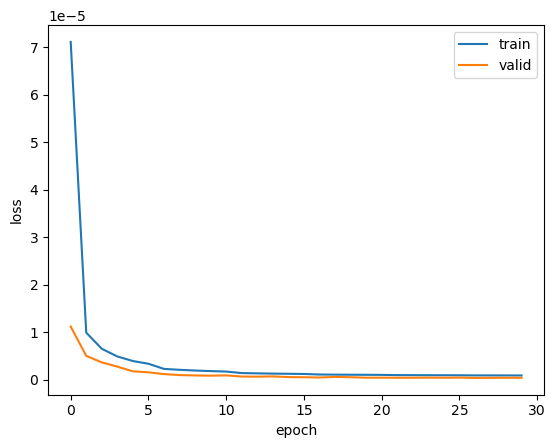

In [25]:
plt.plot(history['loss'], label ="train")
plt.plot(history['val_loss'], label="valid")
plt.legend()
plt.xlabel('epoch')
plt.ylabel('loss')
plt.show()

In [ ]:
### print('/Users/cain/Desktop/공부/ML,DL Project/LID-DS-2021_Preprocessing/models/'+model_name+'.h5')

# Load model

In [26]:
loaded_model = load_model(model_save_dir+'DL/'+model_name+'.h5')
weights,bias = loaded_model.layers[0].get_weights()
loaded_model.compile(optimizer='adam', loss='mse')
loaded_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 30, 64)            10048     
                                                                 
 dropout (Dropout)           (None, 30, 64)            0         
                                                                 
 conv1d_1 (Conv1D)           (None, 30, 32)            6176      
                                                                 
 dropout_1 (Dropout)         (None, 30, 32)            0         
                                                                 
 conv1d_2 (Conv1D)           (None, 30, 16)            1552      
                                                                 
 dense (Dense)               (None, 30, 8)             136       
                                                                 
 conv1d_transpose (Conv1DTra  (None, 30, 16)           4

# Making 3d -> 2d data

In [27]:
def make_2d(x):
    arr = np.empty((x.shape[0],x.shape[2]))
    #print(arr.shape) 
    for i in range(x.shape[0]):
            arr[i] = x[i,(x.shape[1]-1),:]
    return arr

# Labeling 

In [28]:
def make_label(directory , scenario_name):
    sample = pd.read_csv(directory+"/test/normal_and_attack/"+scenario_name+"/"+scenario_name+".csv",index_col=0)
    json_csv = pd.read_csv(directory+'/outline_json/test_normal_and_attack.csv',index_col=0)
    #print(json_csv)
    tmp_json_csv =json_csv.loc[json_csv['scenario_name'] == scenario_name,'exploit_absolute']
    tmp_json_csv = tmp_json_csv.astype(str)
    tmp_json_csv = tmp_json_csv.tolist()
    #print(tmp_json_csv)
    start_ex = tmp_json_csv[0][:12]
    start_ex = int(start_ex)
    
    event_record_time = sample['event_time']
    event_record_time = event_record_time.astype(str)
    event_record_time = event_record_time.apply(lambda x : x[:12])
    event_record_time = event_record_time.astype(int)
    
    label = event_record_time[(event_record_time == start_ex)]
    label = label.index.tolist()
    real_label = label[0]
    return real_label
    


# Testing

In [29]:
test_attack_data_size = 100
test_noraml_data_size = 300
'''test_attack_data_size = 139
test_noraml_data_size = 300'''

'test_attack_data_size = 139\ntest_noraml_data_size = 300'

In [30]:
def testing(Attack_list,threshold_list):
    recall_all = []
    precision_all = []
    fpr_all = []
    f1_score_all=[]
    for name in Attack_list:
        Base_tmp_dir = Base_dir+name
        file_dir = Base_tmp_dir+"/"+ 'test/normal_and_attack'
        #Use normal_and_attack data
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        #print(len(file_list))
        file_list = file_list[:test_attack_data_size]
        attack_data_count = len(file_list)
        real_anomaly_count = [0 for i in range(len(threshold_list))]
        false_positive_count = [0 for i in range(len(threshold_list))]
        file_list = file_list[:test_attack_data_size]
        for e in tqdm(file_list):
            #print(e)
            sample_event_direction = []
            sample_event_type = []
            sample_user_uid = []
            sample_res = []
            sample_size = []
            sample_fd = []

            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")


            sample_event_direction.extend(sample['event_direction'])
            sample_event_type_tmp = sample['event_type'].tolist()
            sample_event_type_tmp = list(map(embedding_syscall,sample_event_type_tmp))
            sample_event_type.extend(sample_event_type_tmp)

            sample_user_uid.extend(sample['user_uid'])

            sample_param = sample['event_argument']

            tmp_res, tmp_size, tmp_fd= extract_params(sample_param)

            sample_res.extend(tmp_res)
            sample_size.extend(tmp_size)
            sample_fd.extend(tmp_fd)

            return_x = pd.DataFrame(zip(sample_res),columns=['res'])        
            return_x = scaler.transform(return_x)
            return_x = pd.DataFrame(return_x,columns=['res'])

            return_x['event_direction'] = sample_event_direction
            return_x = pd.get_dummies(return_x, columns=['event_direction'])
            return_x.drop(['event_direction_<'],axis=1,inplace=True)
            
            sample_event_type_df = pd.DataFrame(sample_event_type)
            return_x = pd.concat([return_x, sample_event_type_df],axis=1)

            test_x = making_model_input(return_x,model_input_sliding_size)


            predict = loaded_model.predict(test_x,verbose=0)

            pred = make_2d(predict)
            test_chk = return_x[model_input_sliding_size-1:]

            error = test_chk - pred
            mse = pd.Series(np.mean(np.power(error,2),axis=1))
            mean_window = mse.rolling(30,center=True).mean()
            window_error = mean_window.fillna(0)
            window_error.reset_index(drop=True,inplace=True)
            mse = mse.reset_index()
            plt.plot(window_error)
            #plt.axhline(y=threshold, color='r', linewidth=1)
            plt.show()

            real_label = make_label(Base_tmp_dir,e)

            '''  cos_similarity = np.array([])
            testing_1= torch.tensor(test_chk.values)
            testing_2 = torch.tensor(pred)
            #print(validation_chk.iloc[0])
            for i in range(testing_1.shape[0]):
                tmp_a = testing_1[i].reshape(-1,1)
                tmp_b = testing_2[i].reshape(-1,1)
                cos_similarity = np.append(cos_similarity,cos(testing_1,testing_2))
            result_cos = np.array(cos_similarity)
            plt.plot(result_cos)
            plt.show()'''
            k=0
            for threshold in threshold_list:
                chk =0 
                flag_real = 0
                flag_false=0
                checking_index = np.array(np.where(window_error > threshold)).reshape(-1)
                checking_index = checking_index + 30
                
                if len(np.where(checking_index >= real_label)[0]) > 0:
                    flag_real = 1
                    
                if len(np.where(checking_index < real_label)[0]) > 0 :
                    flag_false = 1
                
                    
                if flag_false > 0:
                    false_positive_count[k] = false_positive_count[k] + 1
                    #print("FALSE ALARM!!!!!!!!!!!!!!!")

                if flag_real > 0:
                    real_anomaly_count[k] = real_anomaly_count[k] + 1
                    #print("ALARM!!!!!!!!!!!!!!!")

    
               
                k=k+1
            gc.collect()    
        file_dir = Base_tmp_dir+"/"+ 'test/normal'
        #Use normal_and_attack data
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        #print(len(file_list))
        
        
        file_list=file_list[:test_noraml_data_size]
        normal_data_count = len(file_list)

        false_anomaly_count = [0 for i in range(len(threshold_list))]
        chk_more_false = [0 for i in range(len(threshold_list))]

       
        for e in tqdm(file_list):
            #print(e)
            sample_event_direction = []
            sample_event_type = []
            sample_user_uid = []
            sample_res = []
            sample_size = []
            sample_fd = []

            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")


            sample_event_direction.extend(sample['event_direction'])
            sample_event_type_tmp = sample['event_type'].tolist()
            sample_event_type_tmp = list(map(embedding_syscall,sample_event_type_tmp))
            sample_event_type.extend(sample_event_type_tmp)

            sample_user_uid.extend(sample['user_uid'])

            sample_param = sample['event_argument']

            tmp_res, tmp_size, tmp_fd= extract_params(sample_param)

            sample_res.extend(tmp_res)
            sample_size.extend(tmp_size)
            sample_fd.extend(tmp_fd)

            return_x = pd.DataFrame(zip(sample_res),columns=['res'])        
            return_x = scaler.transform(return_x)
            return_x = pd.DataFrame(return_x,columns=['res'])


            return_x['event_direction'] = sample_event_direction
            return_x = pd.get_dummies(return_x, columns=['event_direction'])
            return_x.drop(['event_direction_<'],axis=1,inplace=True)
                
            
            sample_event_type_df = pd.DataFrame(sample_event_type)
            return_x = pd.concat([return_x, sample_event_type_df],axis=1)

            test_x = making_model_input(return_x,model_input_sliding_size)

            predict = loaded_model.predict(test_x,verbose=0)

            pred = make_2d(predict)
            test_chk = return_x[model_input_sliding_size-1:]


            error = test_chk - pred
            mse = pd.Series(np.mean(np.power(error,2),axis=1))
            mean_window = mse.rolling(30,center=True).mean()
            window_error = mean_window.fillna(0)
            window_error.reset_index(drop=True,inplace=True)
            mse = mse.reset_index()
            plt.plot(window_error)
            #plt.axhline(y=threshold, color='r', linewidth=1)
            plt.show()

            ''' cos_similarity = np.array([])
            testing_1= torch.tensor(test_chk.values)
            testing_2 = torch.tensor(pred)
            #print(validation_chk.iloc[0])
            for i in range(testing_1.shape[0]):
                tmp_a = testing_1[i].reshape(-1,1)
                tmp_b = testing_2[i].reshape(-1,1)
                cos_similarity = np.append(cos_similarity,cos(testing_1,testing_2))
            result_cos = np.array(cos_similarity)
            plt.plot(result_cos)
            plt.show()'''
            k=0
            for threshold in threshold_list:
                checking_index = np.array(np.where(window_error > threshold)).reshape(-1)
                checking_index = checking_index + 30
                if len(checking_index) > 0:
                    false_anomaly_count[k] = false_anomaly_count[k] + 1
                k=k+1
        gc.collect()
        recall = []
        precision = []
        fpr = []
        f1_score=[]
        result_file_name = result_save_dir + model_name + '_' + str(threshold_list[0]) + '_' + str(len(threshold_list)) + '.txt'
        f = open(result_file_name,'a')
        f.write("Attack name : "+name+"\n")
        print(name)
        f.write("#####################\n")
        f.write("#####################\n")
        f.write("#####################\n")
        f.write("#####################\n")
        for i in range(len(threshold_list)):
            recall_tmp = real_anomaly_count[i]/attack_data_count
            precision_tmp = real_anomaly_count[i]/(false_anomaly_count[i]+real_anomaly_count[i]+1e-8)#epsilon
            fpr_tmp = false_anomaly_count[i]/normal_data_count
            f1_score_tmp = 2*precision_tmp*recall_tmp/(precision_tmp+recall_tmp+1e-8)#epsilon
            f.write(f"threshold : %e\n" % threshold_list[i])
            f.write("Data count(Normal_and_Attack) : " + str(attack_data_count)+"\n")
            f.write("anomaly_count : " + str(real_anomaly_count[i])+"\n")           
            f.write("Data count(Only Normal) : " + str(normal_data_count)+"\n")
            f.write("false_positive_count : " + str(false_anomaly_count[i])+"\n")
            f.write("Recall : "+str(recall_tmp)+"\n") 
            f.write("Precision : "+str(precision_tmp)+"\n")
            f.write("FPR(False Positive Rate) : "+str(fpr_tmp)+"\n")
            f.write("F1 score : " + str(f1_score_tmp)+"\n")
            f.write("----------------------------------\n")
            recall.append(recall_tmp)
            precision.append(precision_tmp)
            fpr.append(fpr_tmp)
            f1_score.append(f1_score_tmp)
        recall_all.append(recall)
        precision_all.append(precision)
        fpr_all.append(fpr)
        f1_score_all.append(f1_score)
        f.close()
    return recall_all, precision_all, fpr_all, f1_score_all, result_file_name

In [31]:
threshold_list = []
for i in range(200):
    threshold_list.append((i+1)*5e-6)

In [32]:
Attack_list

['CVE-2014-0160', 'Bruteforce_CWE-307']

In [33]:
import warnings
warnings.filterwarnings(action='ignore')

  0%|                                                   | 0/100 [00:00<?, ?it/s]2022-11-26 02:11:23.496791: I tensorflow/core/grappler/optimizers/custom_graph_optimizer_registry.cc:114] Plugin optimizer for device_type GPU is enabled.


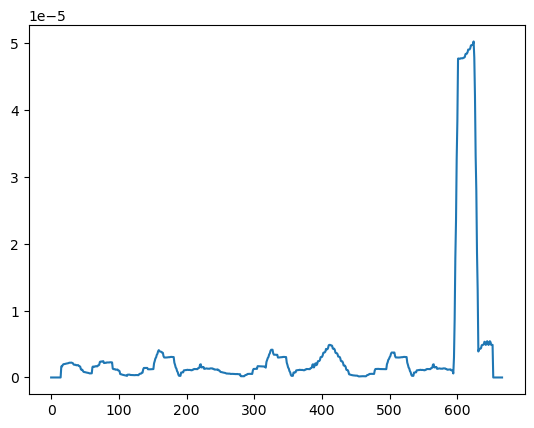

  1%|▍                                          | 1/100 [00:01<02:41,  1.64s/it]

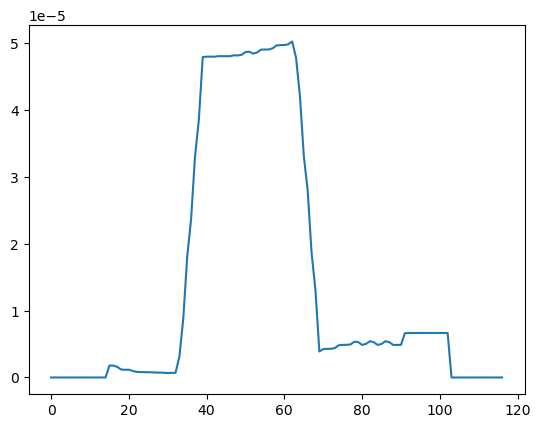

  2%|▊                                          | 2/100 [00:01<01:18,  1.25it/s]

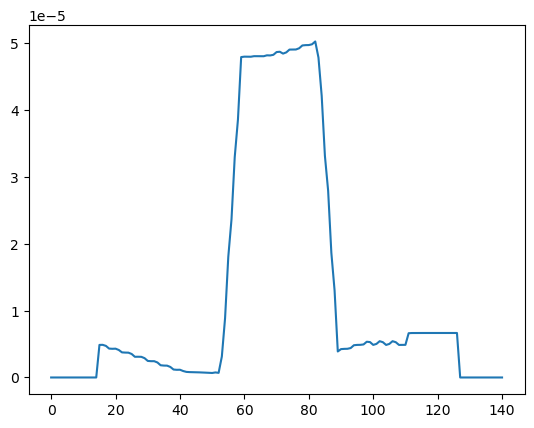

  3%|█▎                                         | 3/100 [00:02<00:51,  1.87it/s]

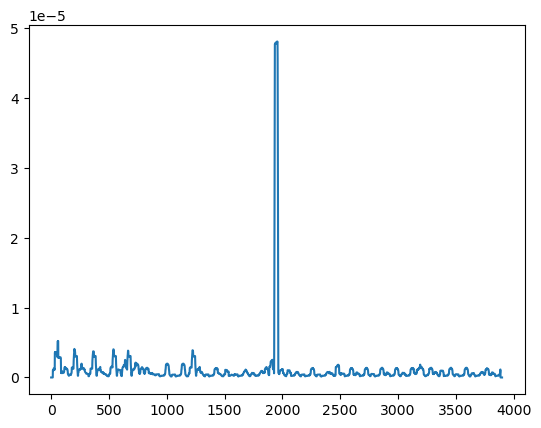

  4%|█▋                                         | 4/100 [00:02<01:05,  1.47it/s]

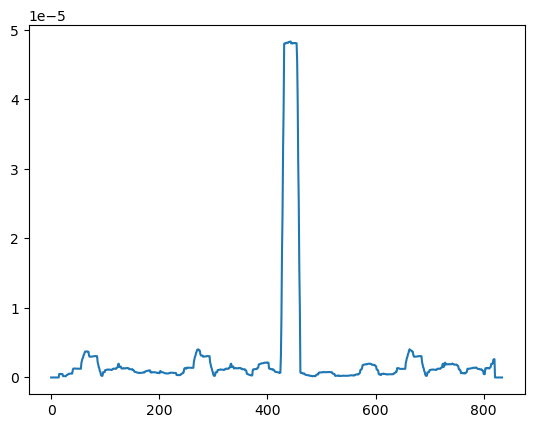

  5%|██▏                                        | 5/100 [00:03<00:52,  1.80it/s]

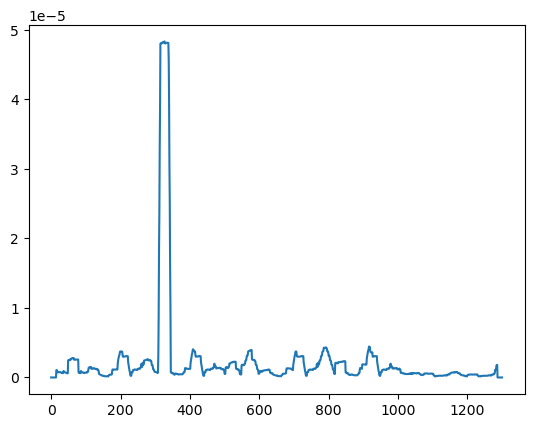

  6%|██▌                                        | 6/100 [00:03<00:52,  1.79it/s]

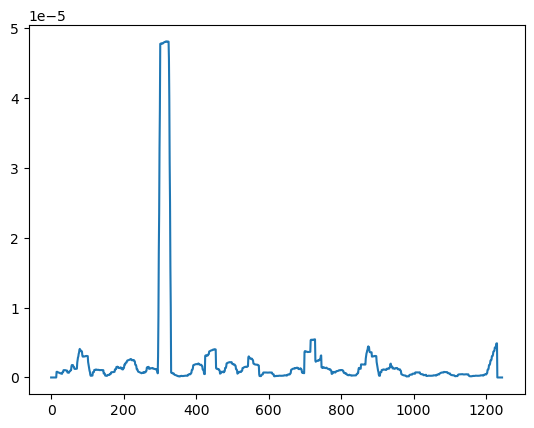

  7%|███                                        | 7/100 [00:04<00:47,  1.96it/s]

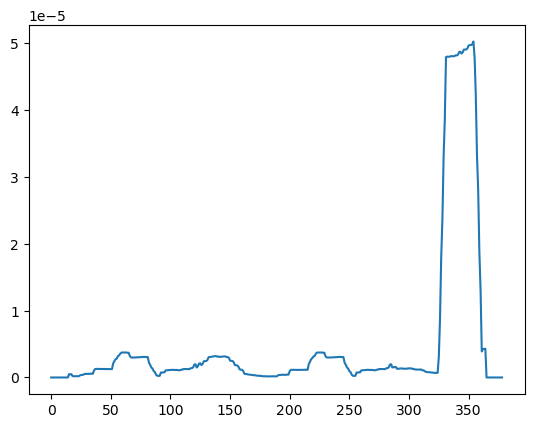

  8%|███▍                                       | 8/100 [00:04<00:38,  2.38it/s]

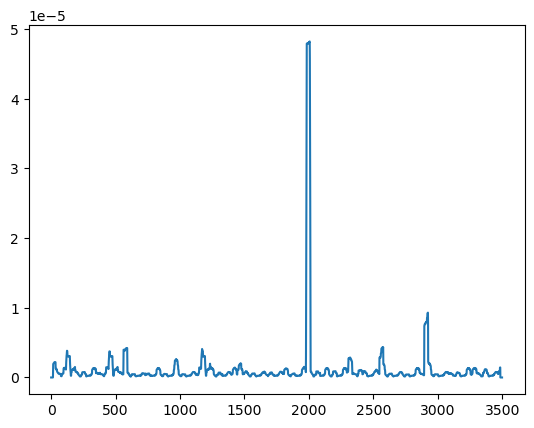

  9%|███▊                                       | 9/100 [00:05<00:49,  1.85it/s]

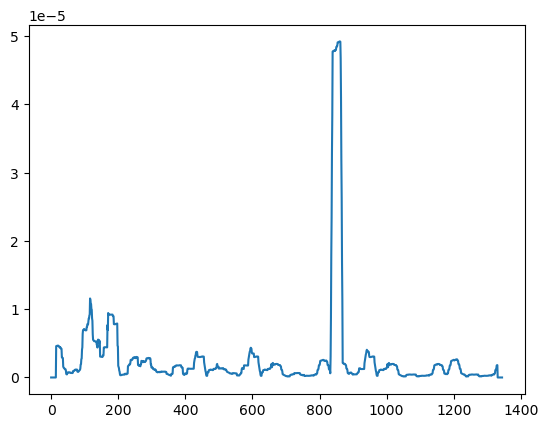

 10%|████▏                                     | 10/100 [00:05<00:47,  1.88it/s]

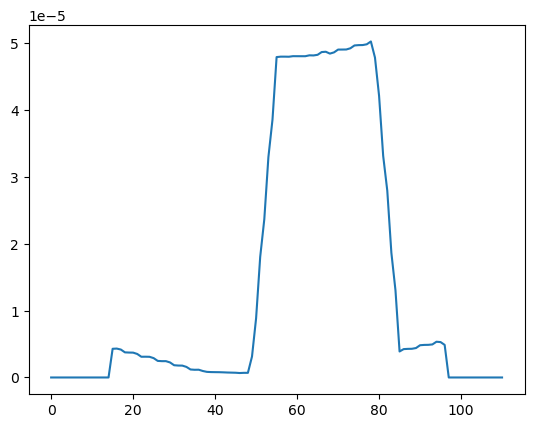

 11%|████▌                                     | 11/100 [00:06<00:38,  2.34it/s]

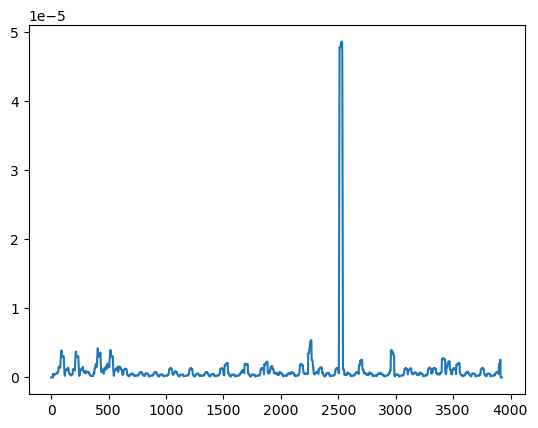

 12%|█████                                     | 12/100 [00:06<00:49,  1.78it/s]

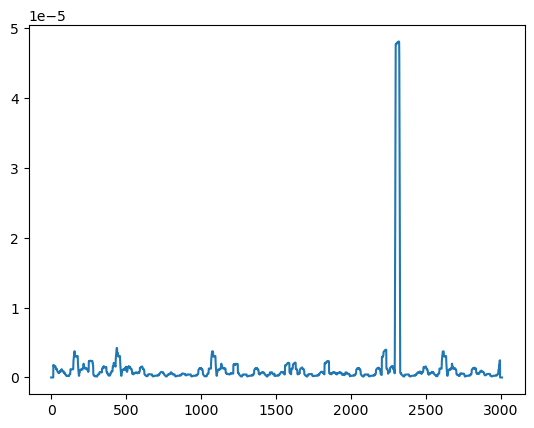

 13%|█████▍                                    | 13/100 [00:07<00:52,  1.66it/s]

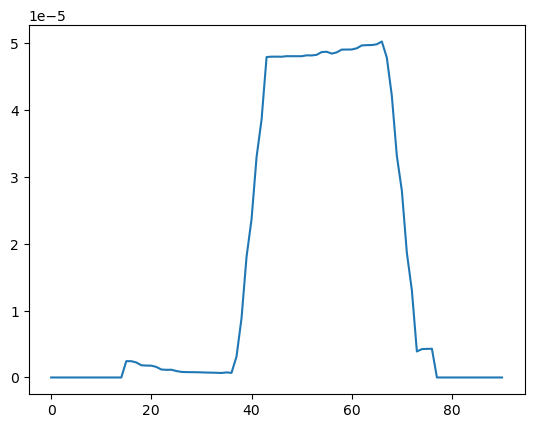

 14%|█████▉                                    | 14/100 [00:07<00:40,  2.13it/s]

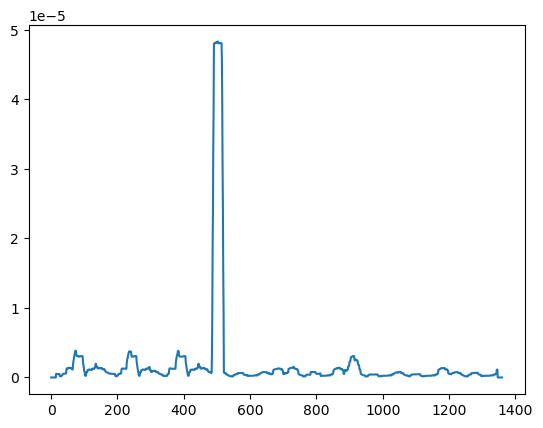

 15%|██████▎                                   | 15/100 [00:08<00:40,  2.11it/s]

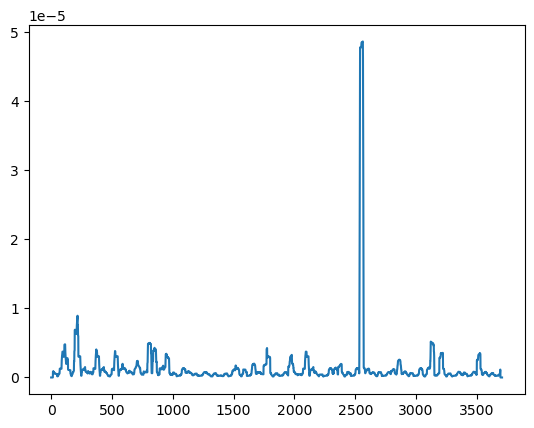

 16%|██████▋                                   | 16/100 [00:09<00:48,  1.75it/s]

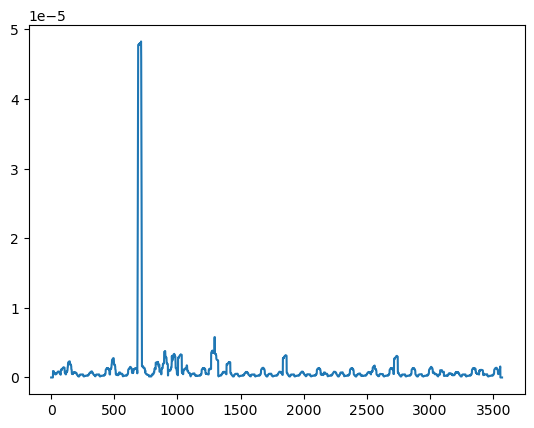

 17%|███████▏                                  | 17/100 [00:09<00:53,  1.55it/s]

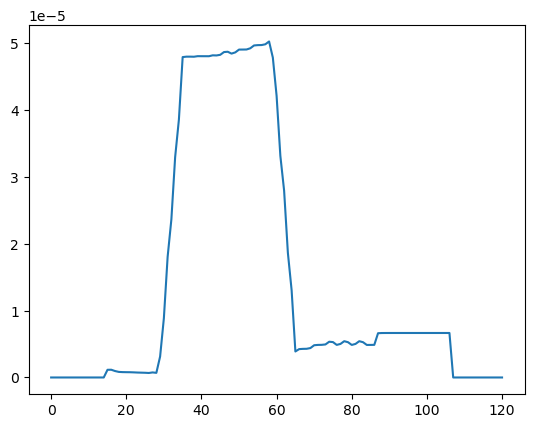

 18%|███████▌                                  | 18/100 [00:10<00:42,  1.95it/s]

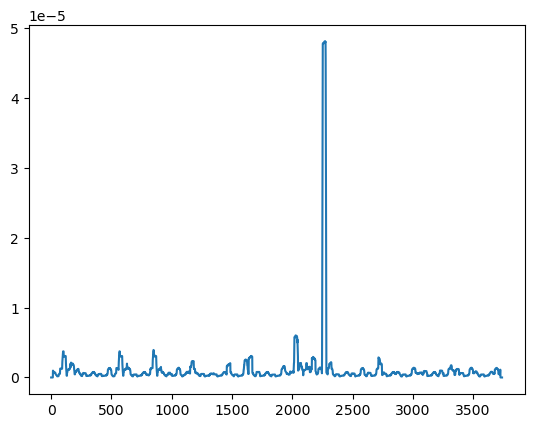

 19%|███████▉                                  | 19/100 [00:10<00:48,  1.67it/s]

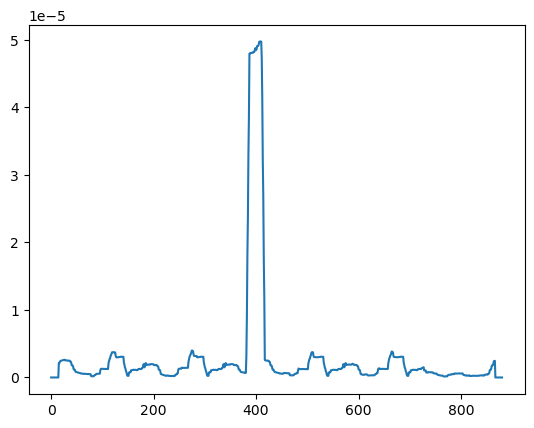

 20%|████████▍                                 | 20/100 [00:11<00:40,  1.96it/s]

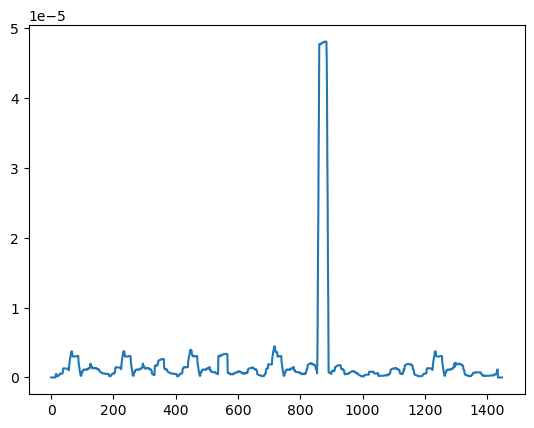

 21%|████████▊                                 | 21/100 [00:11<00:38,  2.03it/s]

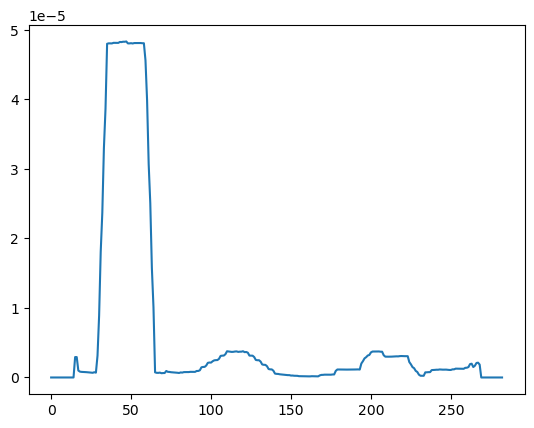

 22%|█████████▏                                | 22/100 [00:11<00:31,  2.47it/s]

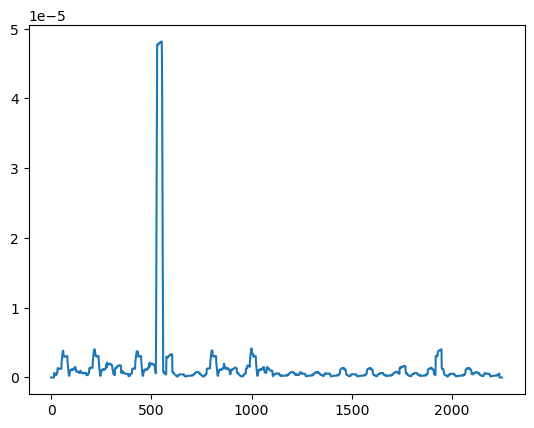

 23%|█████████▋                                | 23/100 [00:12<00:34,  2.22it/s]

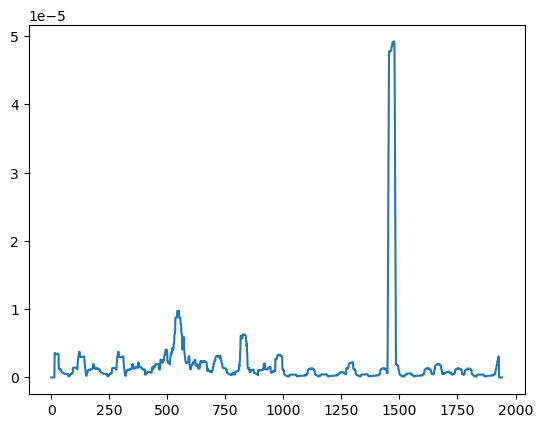

 24%|██████████                                | 24/100 [00:12<00:35,  2.14it/s]

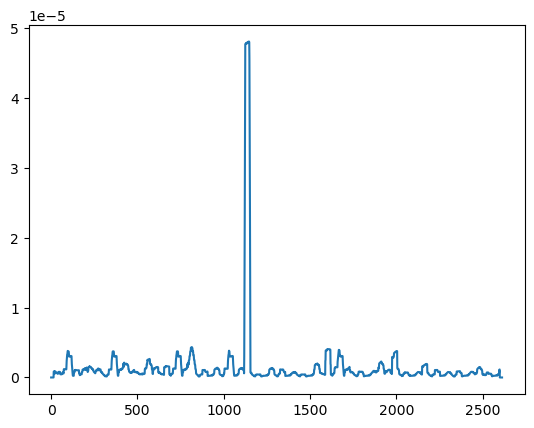

 25%|██████████▌                               | 25/100 [00:13<00:40,  1.86it/s]

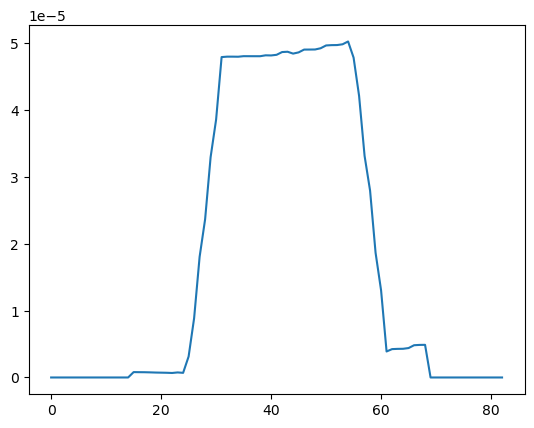

 26%|██████████▉                               | 26/100 [00:13<00:31,  2.33it/s]

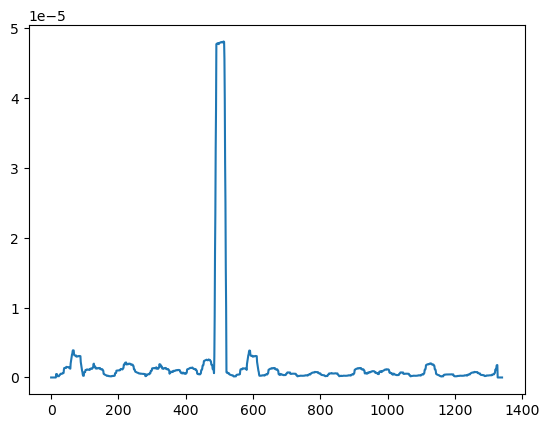

 27%|███████████▎                              | 27/100 [00:14<00:30,  2.39it/s]

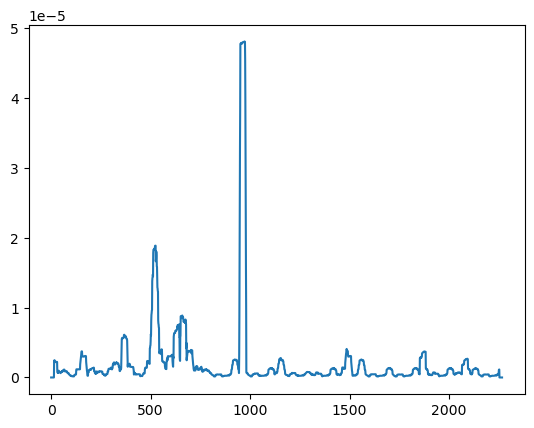

 28%|███████████▊                              | 28/100 [00:14<00:33,  2.17it/s]

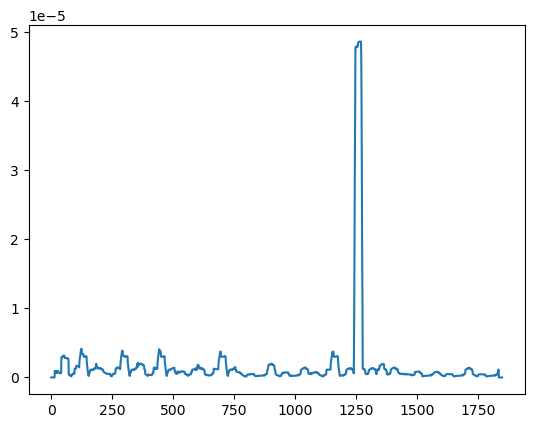

 29%|████████████▏                             | 29/100 [00:15<00:33,  2.11it/s]

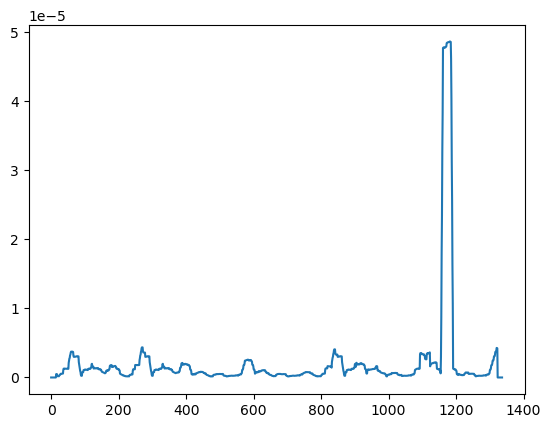

 30%|████████████▌                             | 30/100 [00:15<00:31,  2.23it/s]

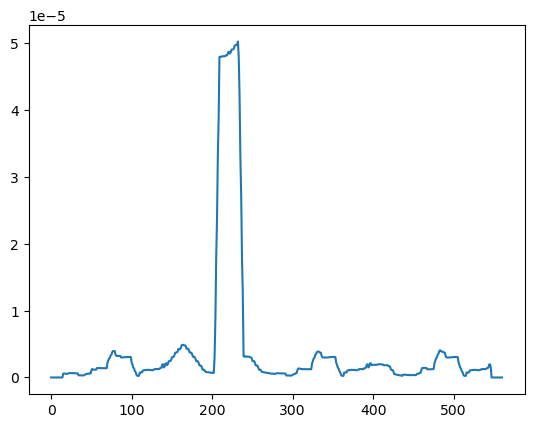

 31%|█████████████                             | 31/100 [00:15<00:27,  2.51it/s]

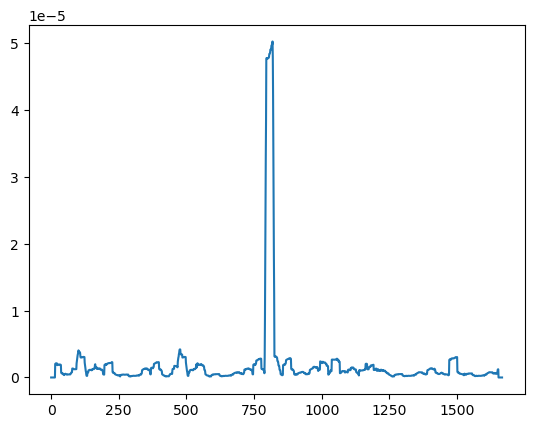

 32%|█████████████▍                            | 32/100 [00:16<00:28,  2.42it/s]

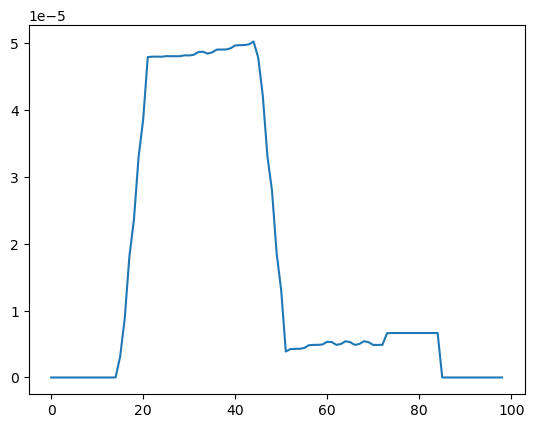

 33%|█████████████▊                            | 33/100 [00:16<00:22,  2.94it/s]

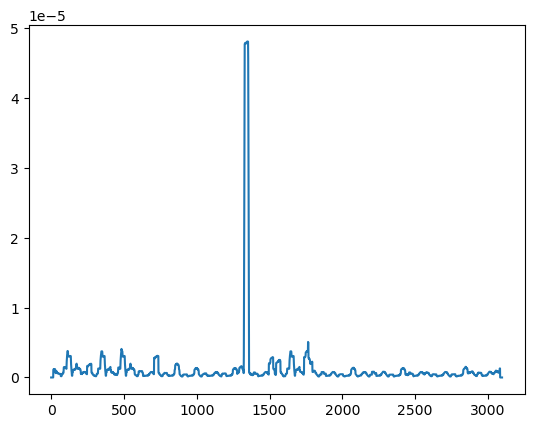

 34%|██████████████▎                           | 34/100 [00:17<00:30,  2.20it/s]

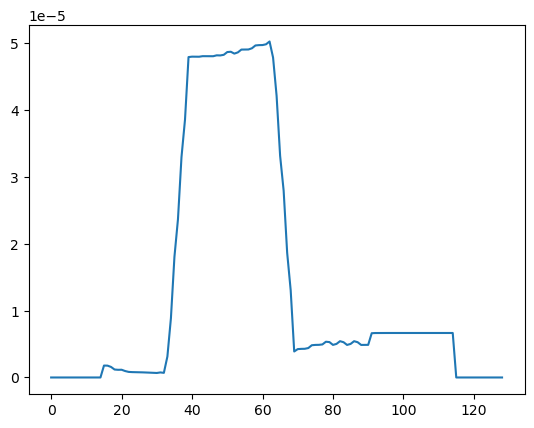

 35%|██████████████▋                           | 35/100 [00:17<00:24,  2.69it/s]

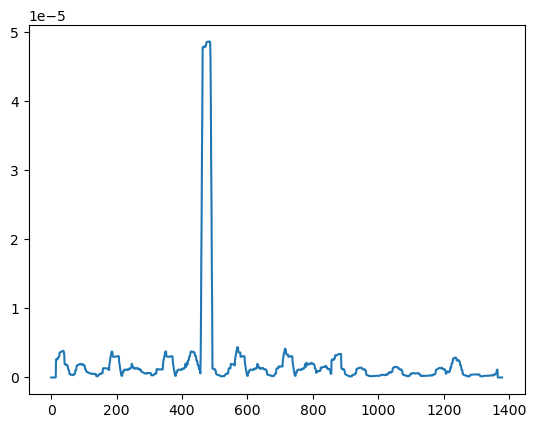

 36%|███████████████                           | 36/100 [00:17<00:24,  2.62it/s]

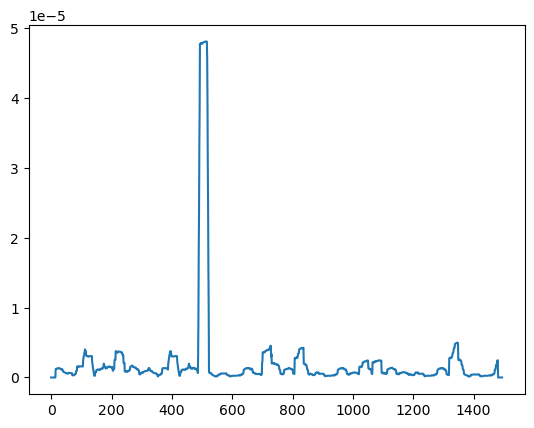

 37%|███████████████▌                          | 37/100 [00:18<00:24,  2.55it/s]

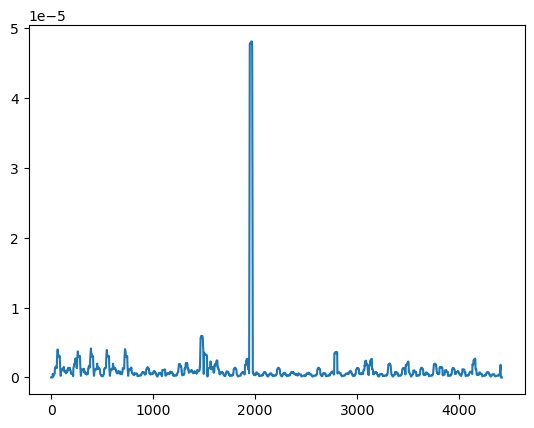

 38%|███████████████▉                          | 38/100 [00:19<00:35,  1.77it/s]

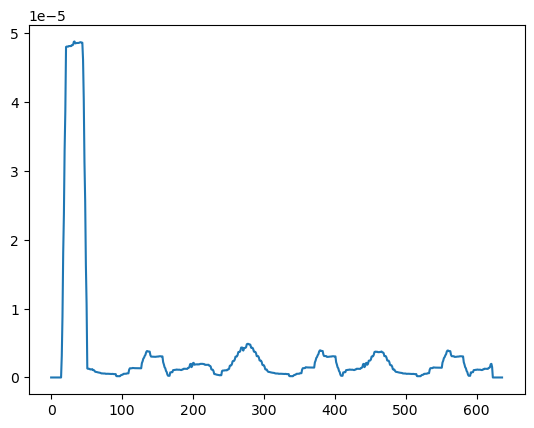

 39%|████████████████▍                         | 39/100 [00:19<00:29,  2.10it/s]

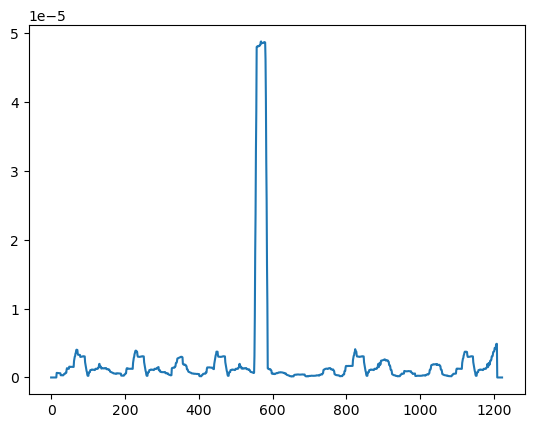

 40%|████████████████▊                         | 40/100 [00:19<00:27,  2.17it/s]

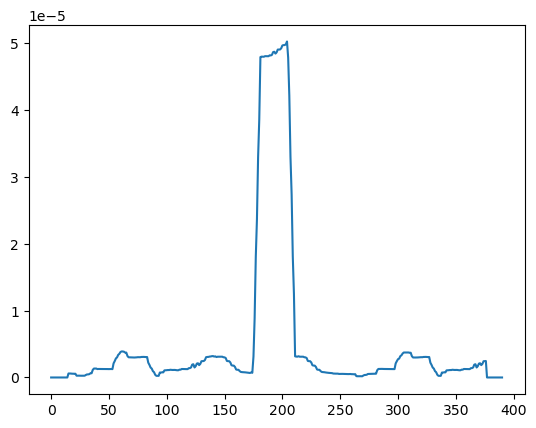

 41%|█████████████████▏                        | 41/100 [00:20<00:23,  2.56it/s]

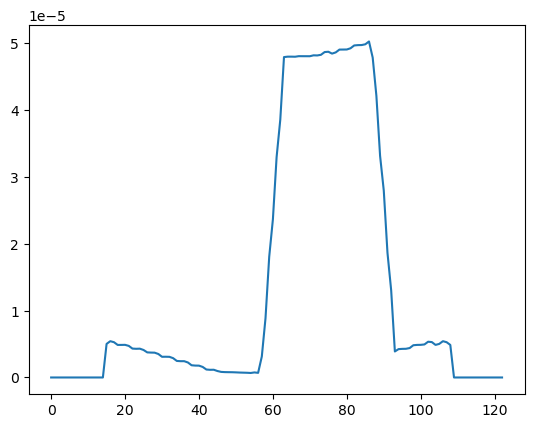

 42%|█████████████████▋                        | 42/100 [00:20<00:18,  3.07it/s]

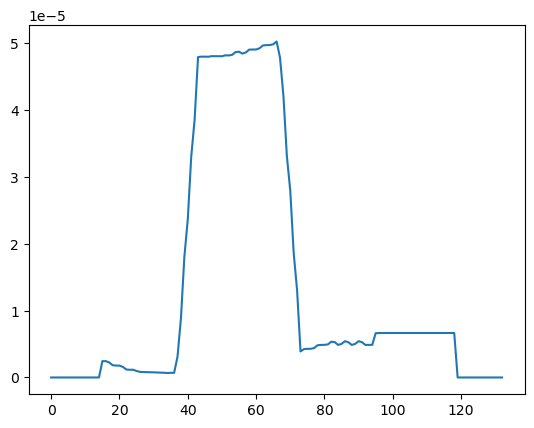

 43%|██████████████████                        | 43/100 [00:20<00:16,  3.56it/s]

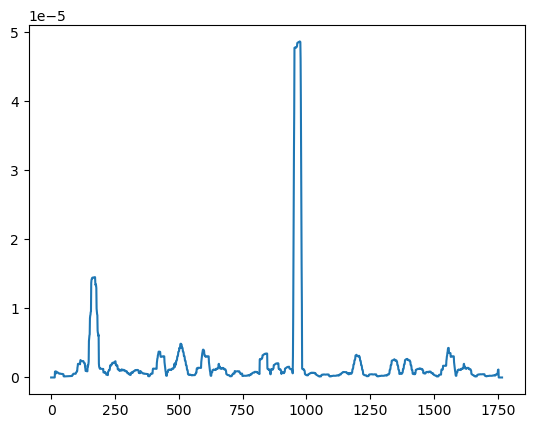

 44%|██████████████████▍                       | 44/100 [00:20<00:18,  2.98it/s]

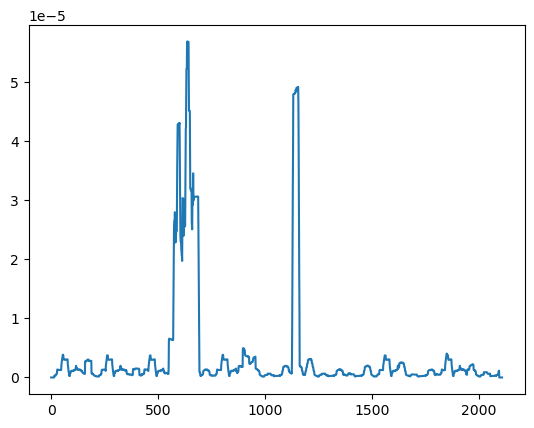

 45%|██████████████████▉                       | 45/100 [00:21<00:21,  2.56it/s]

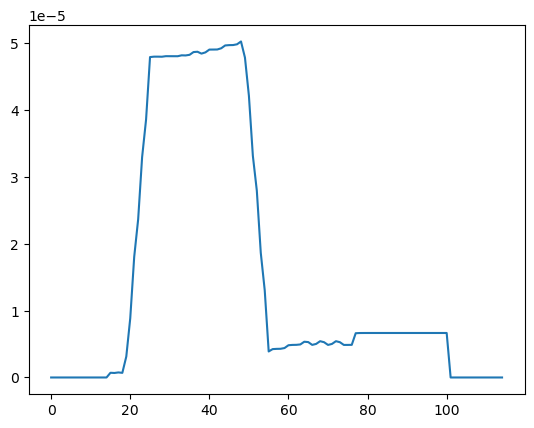

 46%|███████████████████▎                      | 46/100 [00:21<00:17,  3.09it/s]

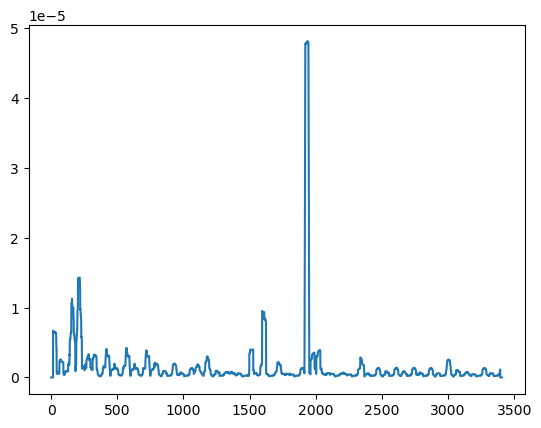

 47%|███████████████████▋                      | 47/100 [00:22<00:23,  2.21it/s]

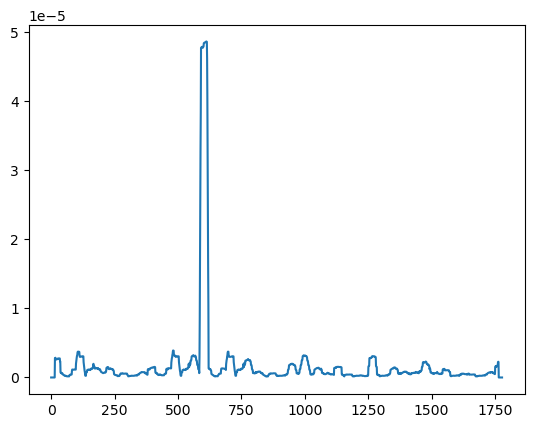

 48%|████████████████████▏                     | 48/100 [00:22<00:23,  2.20it/s]

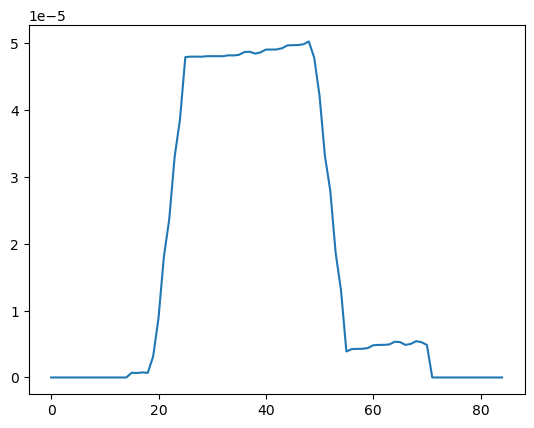

 49%|████████████████████▌                     | 49/100 [00:22<00:18,  2.69it/s]

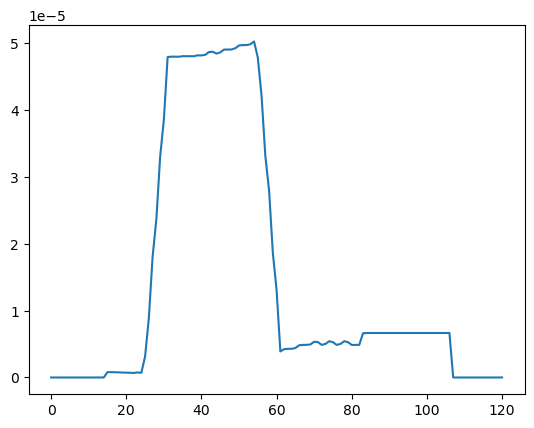

 50%|█████████████████████                     | 50/100 [00:23<00:15,  3.22it/s]

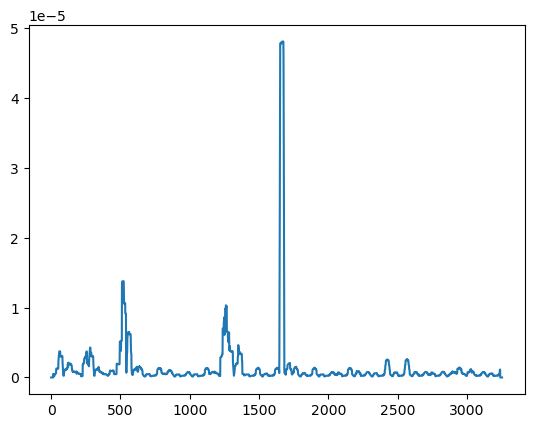

 51%|█████████████████████▍                    | 51/100 [00:23<00:21,  2.32it/s]

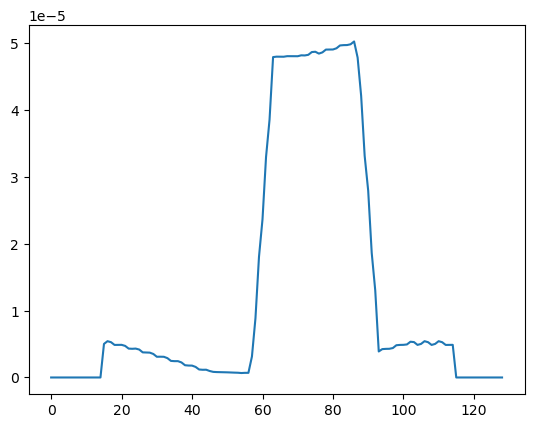

 52%|█████████████████████▊                    | 52/100 [00:24<00:17,  2.82it/s]

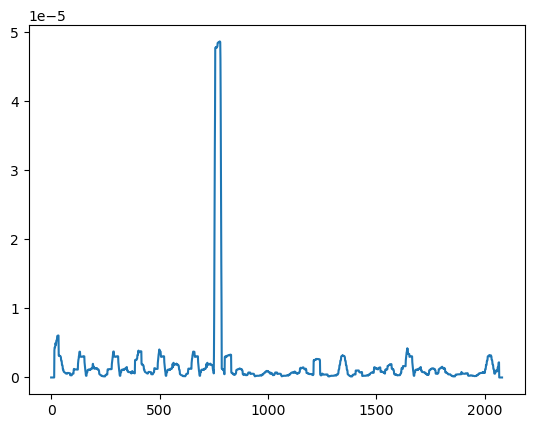

 53%|██████████████████████▎                   | 53/100 [00:24<00:18,  2.49it/s]

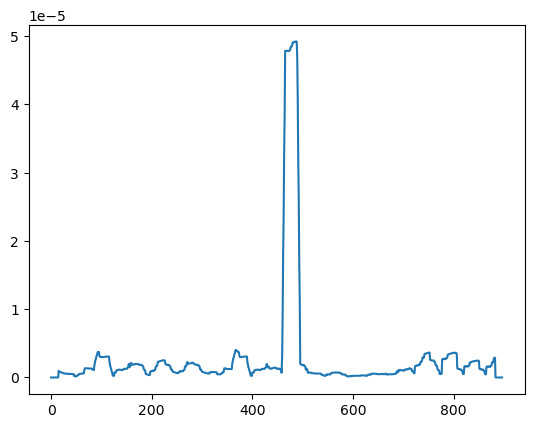

 54%|██████████████████████▋                   | 54/100 [00:24<00:17,  2.67it/s]

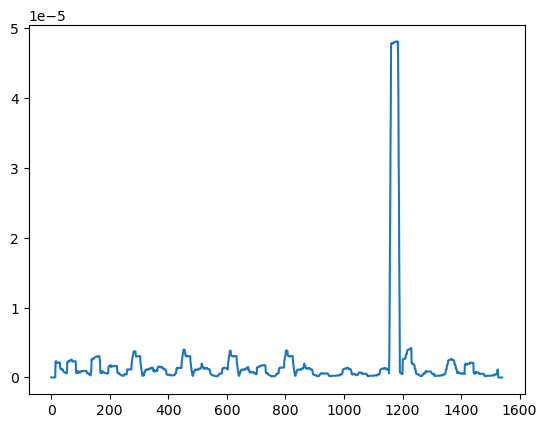

 55%|███████████████████████                   | 55/100 [00:25<00:17,  2.55it/s]

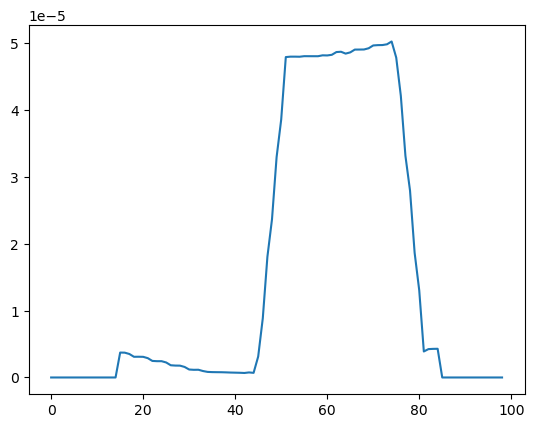

 56%|███████████████████████▌                  | 56/100 [00:25<00:14,  3.04it/s]

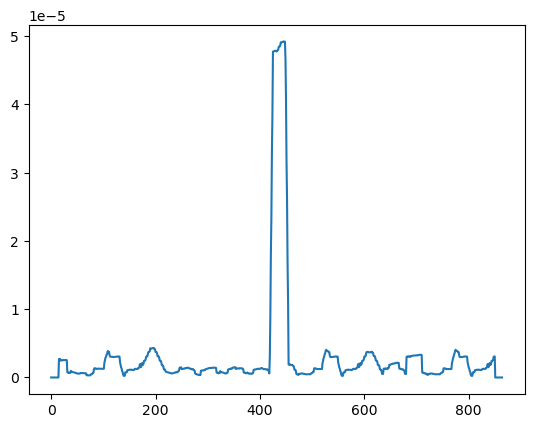

 57%|███████████████████████▉                  | 57/100 [00:25<00:13,  3.11it/s]

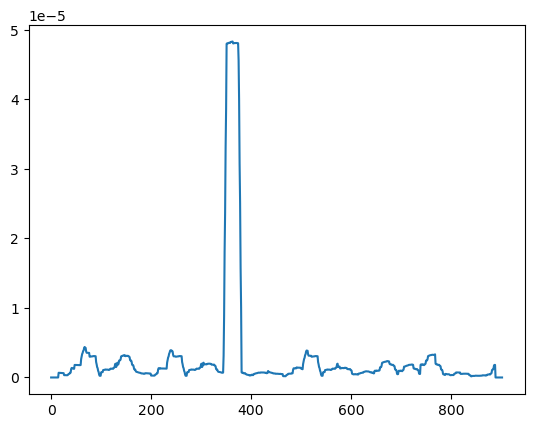

 58%|████████████████████████▎                 | 58/100 [00:26<00:13,  3.15it/s]

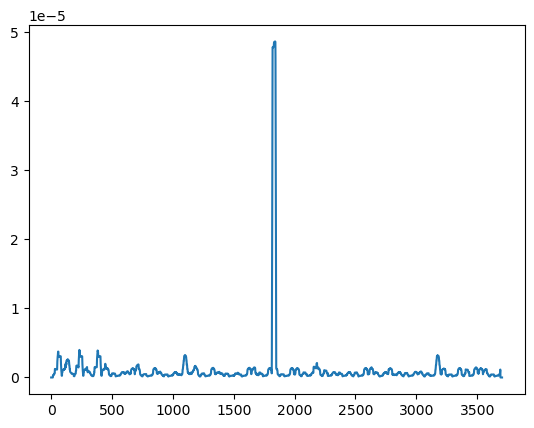

 59%|████████████████████████▊                 | 59/100 [00:26<00:18,  2.17it/s]

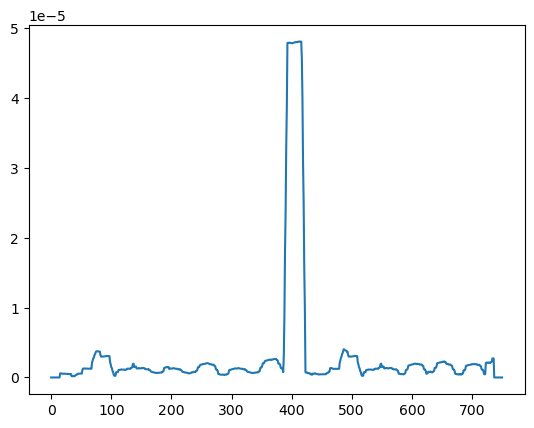

 60%|█████████████████████████▏                | 60/100 [00:27<00:16,  2.44it/s]

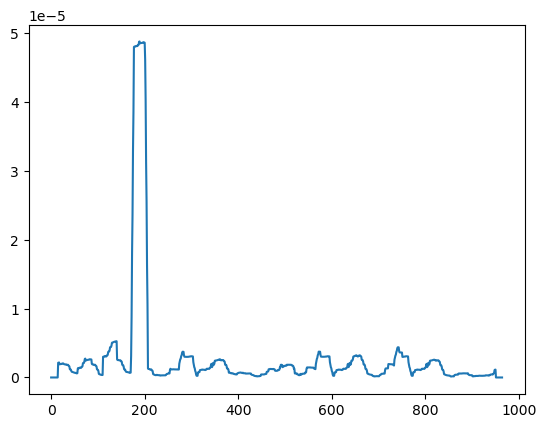

 61%|█████████████████████████▌                | 61/100 [00:27<00:14,  2.60it/s]

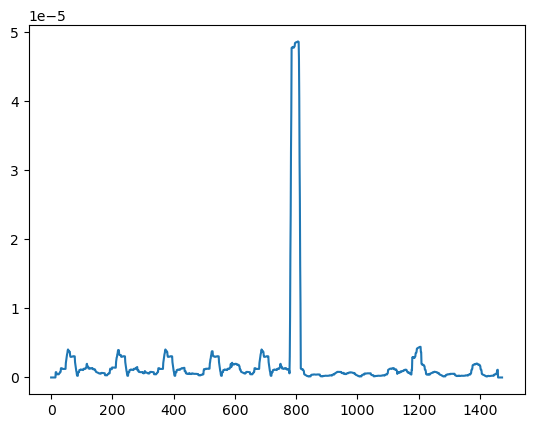

 62%|██████████████████████████                | 62/100 [00:27<00:14,  2.55it/s]

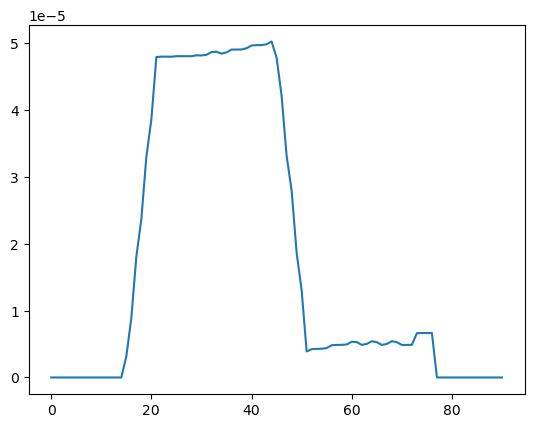

 63%|██████████████████████████▍               | 63/100 [00:28<00:11,  3.10it/s]

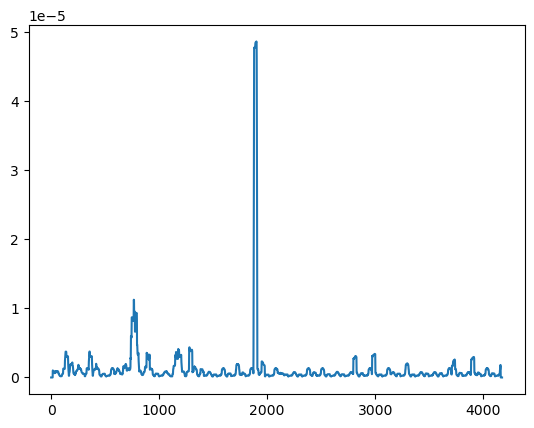

 64%|██████████████████████████▉               | 64/100 [00:28<00:17,  2.05it/s]

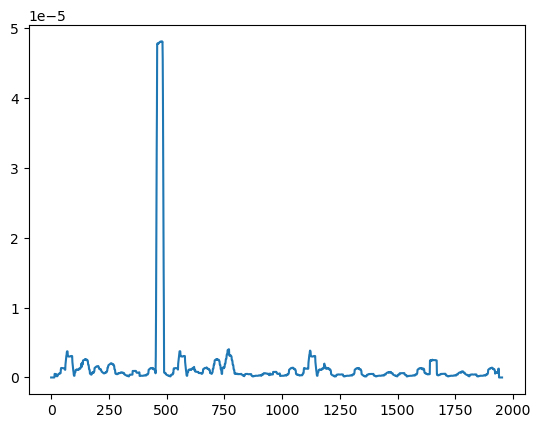

 65%|███████████████████████████▎              | 65/100 [00:29<00:17,  2.03it/s]

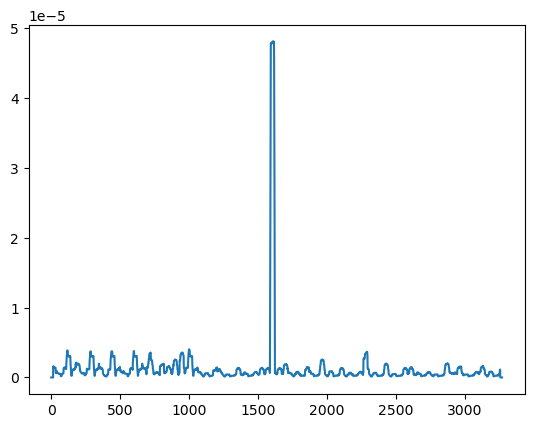

 66%|███████████████████████████▋              | 66/100 [00:30<00:19,  1.78it/s]

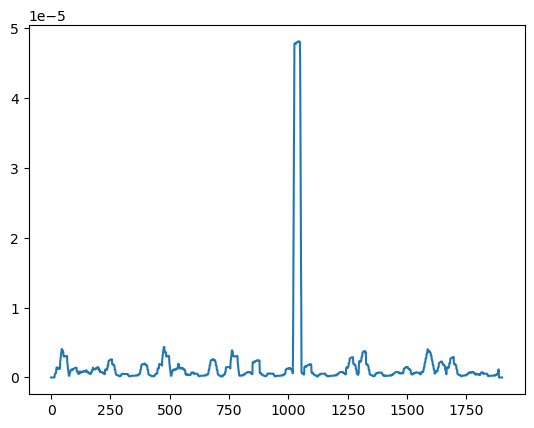

 67%|████████████████████████████▏             | 67/100 [00:30<00:17,  1.84it/s]

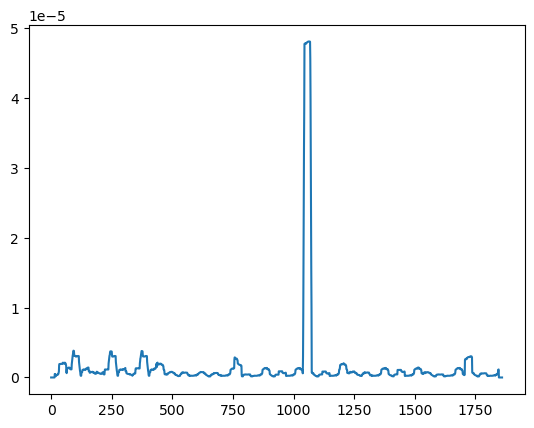

 68%|████████████████████████████▌             | 68/100 [00:31<00:16,  1.90it/s]

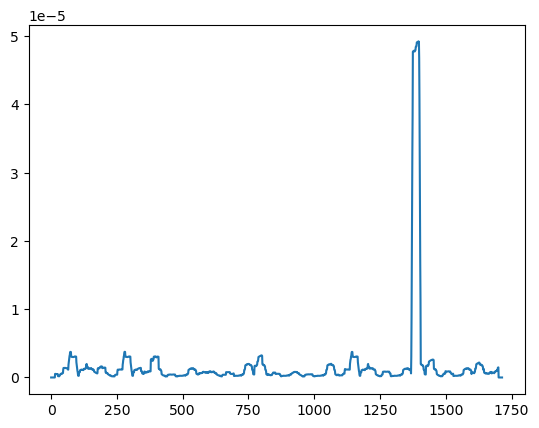

 69%|████████████████████████████▉             | 69/100 [00:31<00:15,  1.98it/s]

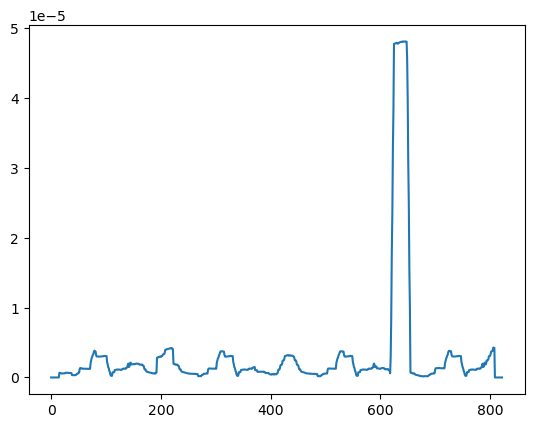

 70%|█████████████████████████████▍            | 70/100 [00:31<00:13,  2.26it/s]

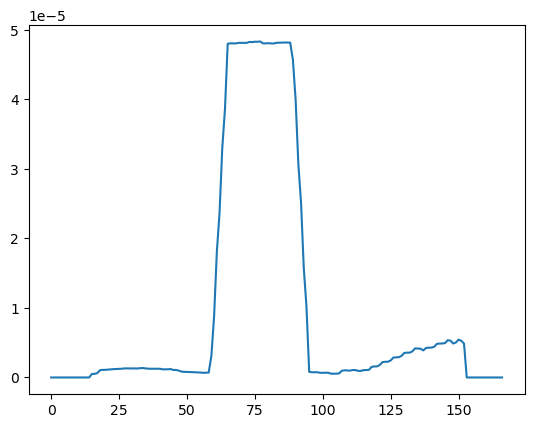

 71%|█████████████████████████████▊            | 71/100 [00:32<00:10,  2.72it/s]

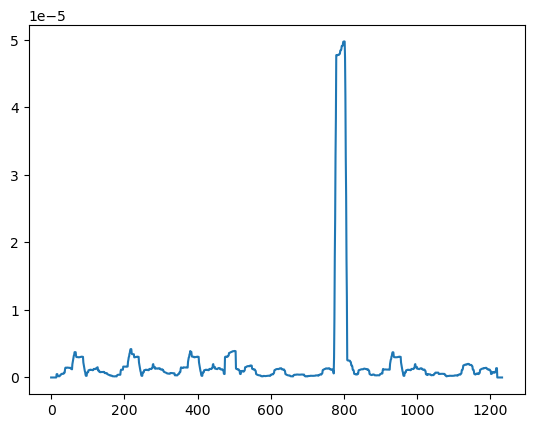

 72%|██████████████████████████████▏           | 72/100 [00:32<00:10,  2.70it/s]

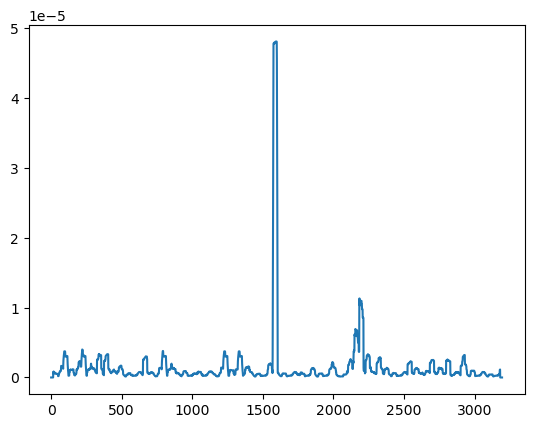

 73%|██████████████████████████████▋           | 73/100 [00:33<00:12,  2.11it/s]

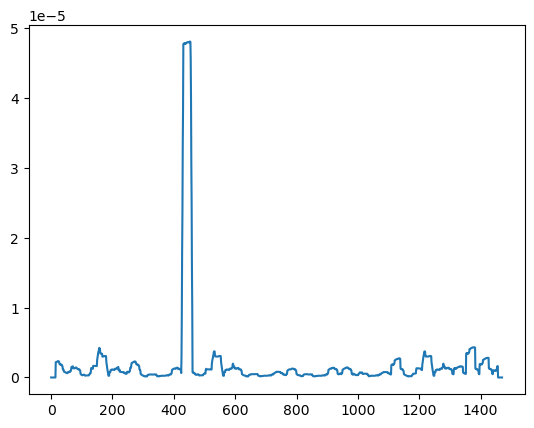

 74%|███████████████████████████████           | 74/100 [00:33<00:11,  2.21it/s]

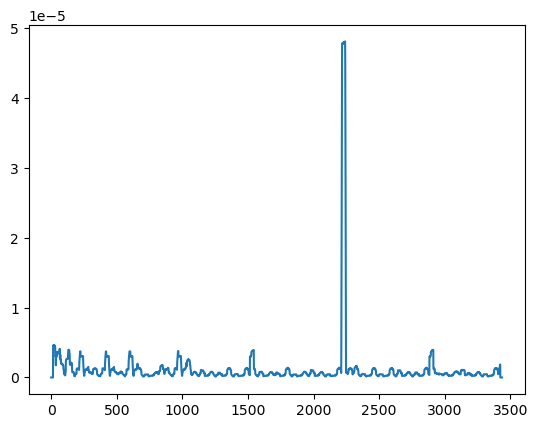

 75%|███████████████████████████████▌          | 75/100 [00:34<00:13,  1.82it/s]

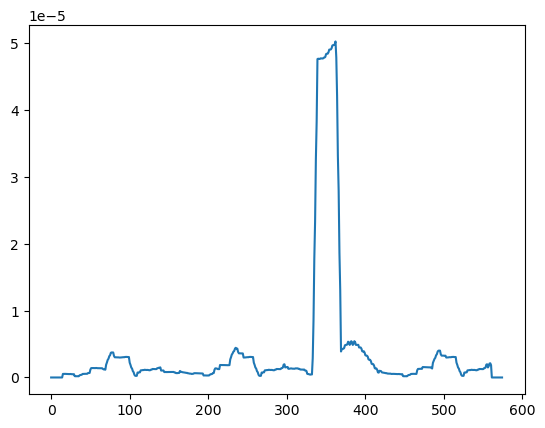

 76%|███████████████████████████████▉          | 76/100 [00:34<00:11,  2.17it/s]

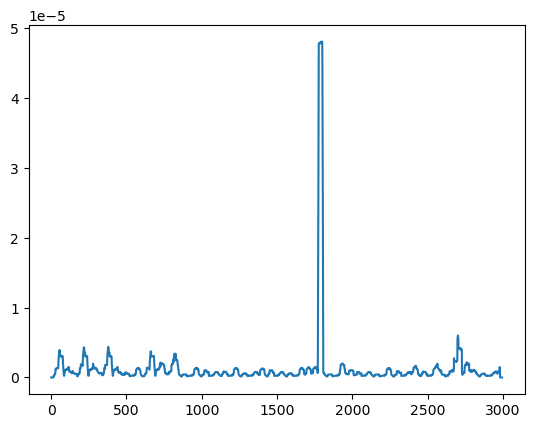

 77%|████████████████████████████████▎         | 77/100 [00:35<00:12,  1.89it/s]

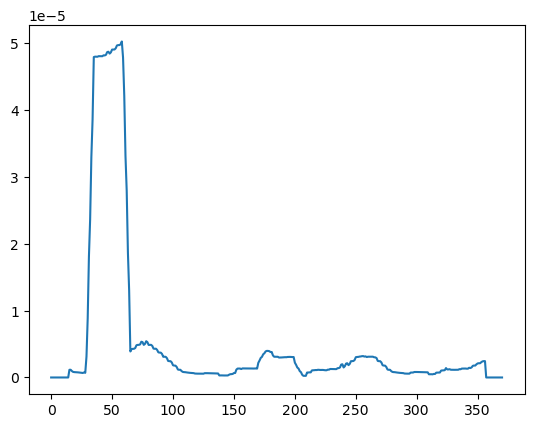

 78%|████████████████████████████████▊         | 78/100 [00:35<00:09,  2.22it/s]

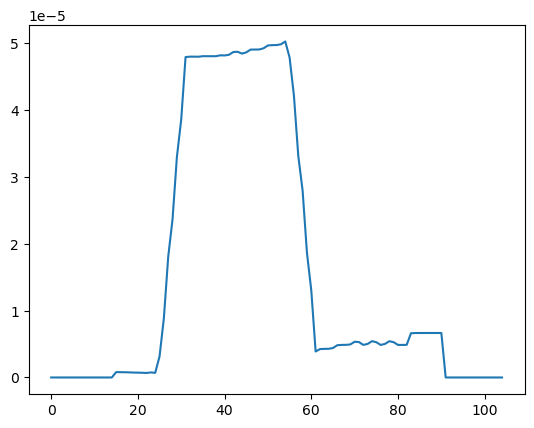

 79%|█████████████████████████████████▏        | 79/100 [00:35<00:07,  2.72it/s]

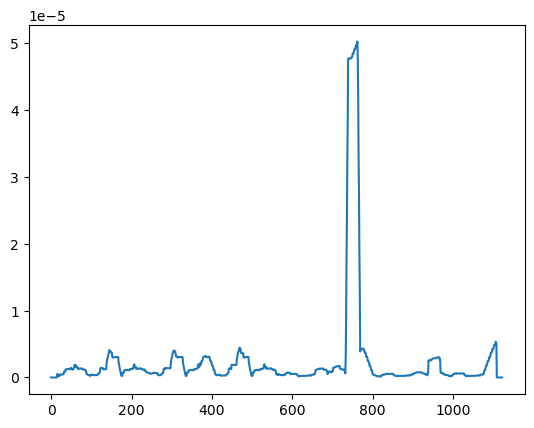

 80%|█████████████████████████████████▌        | 80/100 [00:36<00:07,  2.75it/s]

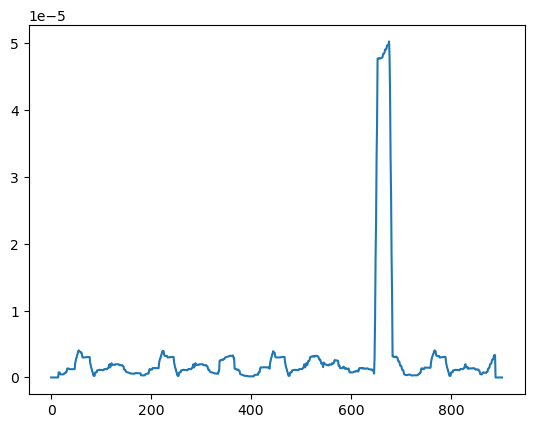

 81%|██████████████████████████████████        | 81/100 [00:36<00:06,  2.87it/s]

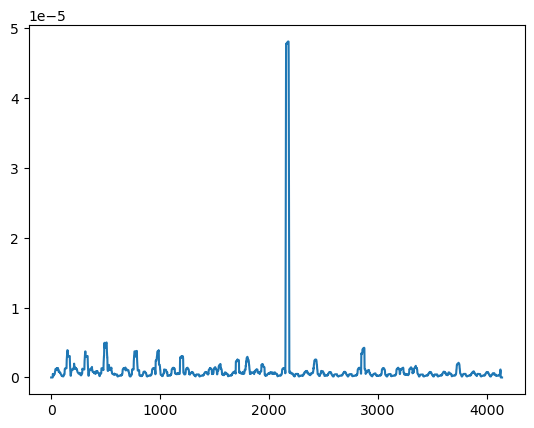

 82%|██████████████████████████████████▍       | 82/100 [00:37<00:09,  1.98it/s]

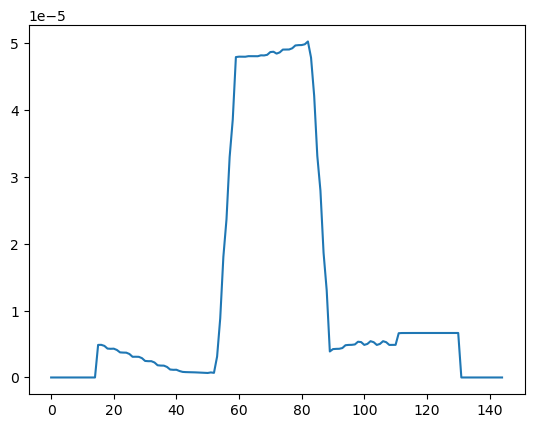

 83%|██████████████████████████████████▊       | 83/100 [00:37<00:06,  2.45it/s]

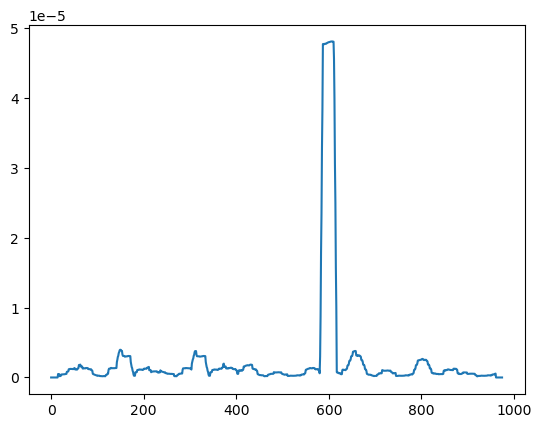

 84%|███████████████████████████████████▎      | 84/100 [00:37<00:06,  2.62it/s]

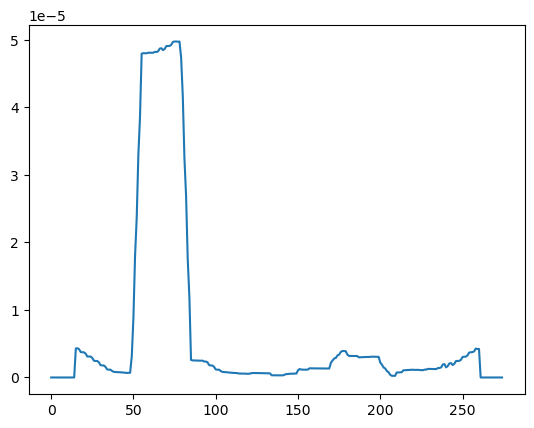

 85%|███████████████████████████████████▋      | 85/100 [00:38<00:04,  3.06it/s]

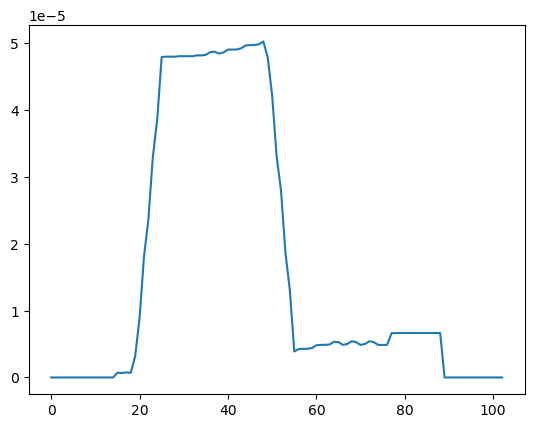

 86%|████████████████████████████████████      | 86/100 [00:38<00:03,  3.57it/s]

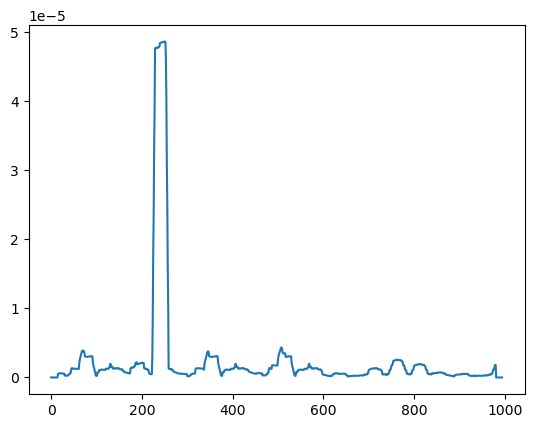

 87%|████████████████████████████████████▌     | 87/100 [00:38<00:04,  3.10it/s]

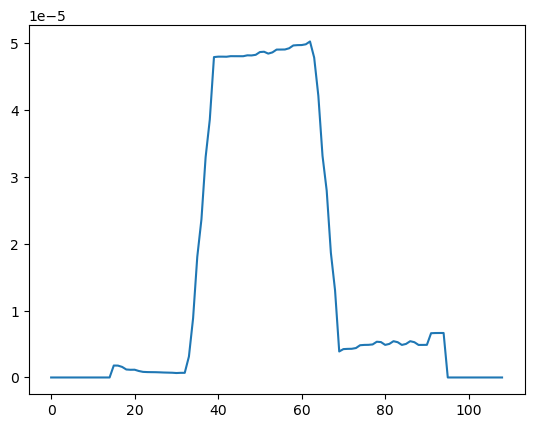

 88%|████████████████████████████████████▉     | 88/100 [00:38<00:03,  3.62it/s]

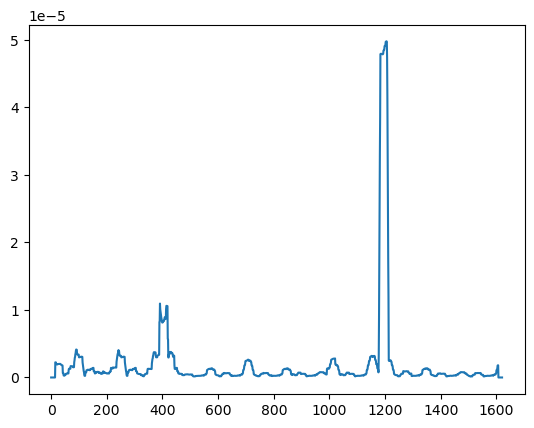

 89%|█████████████████████████████████████▍    | 89/100 [00:39<00:03,  3.03it/s]

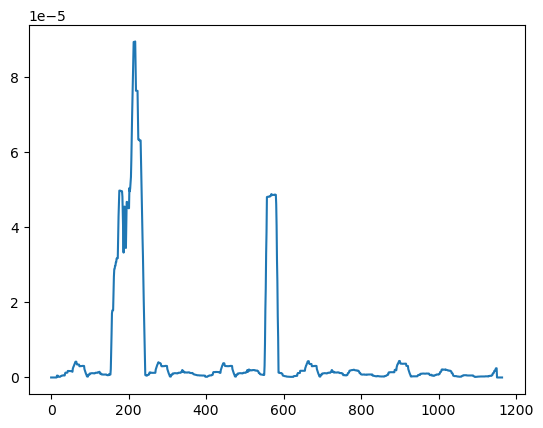

 90%|█████████████████████████████████████▊    | 90/100 [00:39<00:03,  2.81it/s]

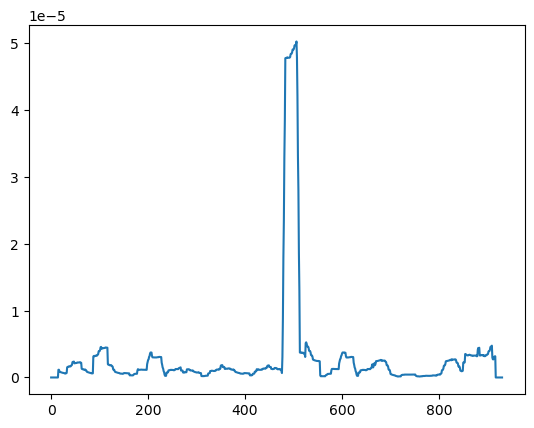

 91%|██████████████████████████████████████▏   | 91/100 [00:39<00:03,  2.86it/s]

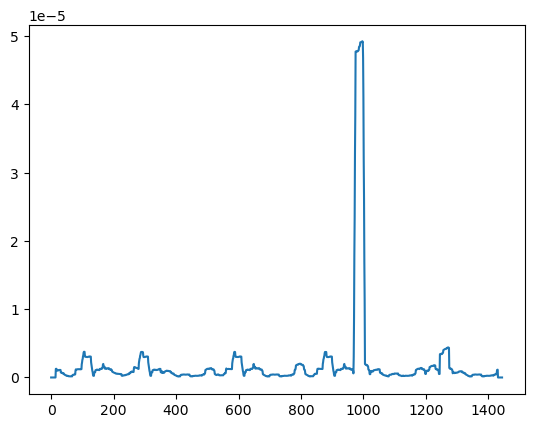

 92%|██████████████████████████████████████▋   | 92/100 [00:40<00:02,  2.72it/s]

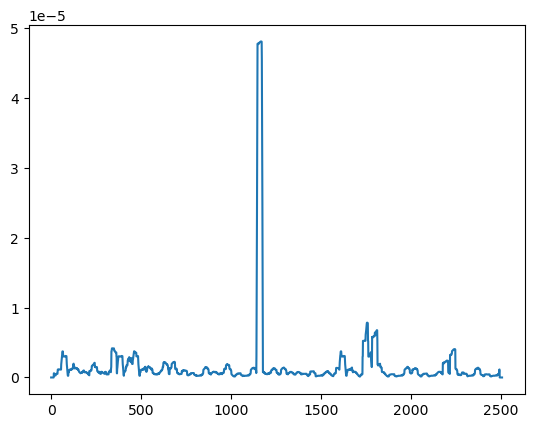

 93%|███████████████████████████████████████   | 93/100 [00:40<00:03,  2.27it/s]

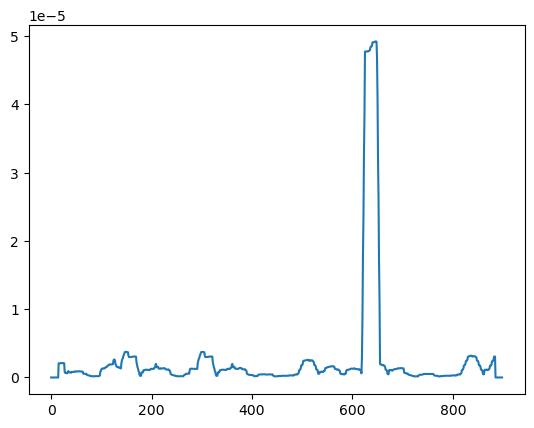

 94%|███████████████████████████████████████▍  | 94/100 [00:41<00:02,  2.49it/s]

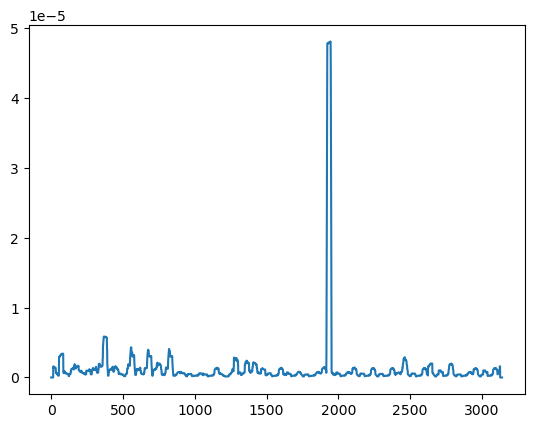

 95%|███████████████████████████████████████▉  | 95/100 [00:42<00:02,  2.03it/s]

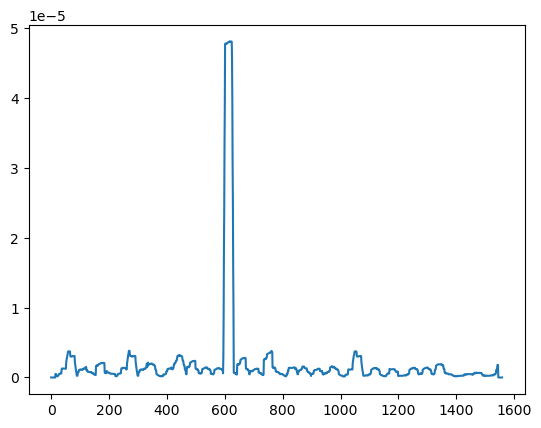

 96%|████████████████████████████████████████▎ | 96/100 [00:42<00:01,  2.11it/s]

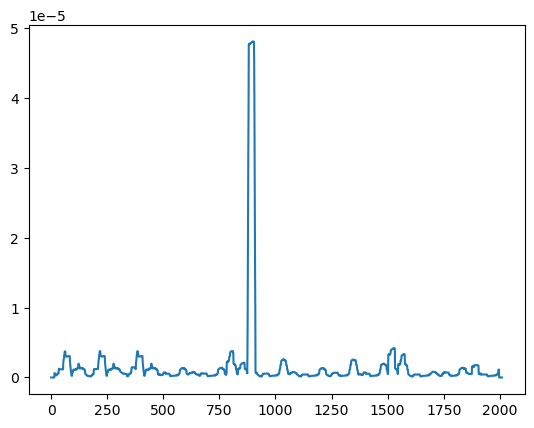

 97%|████████████████████████████████████████▋ | 97/100 [00:42<00:01,  2.08it/s]

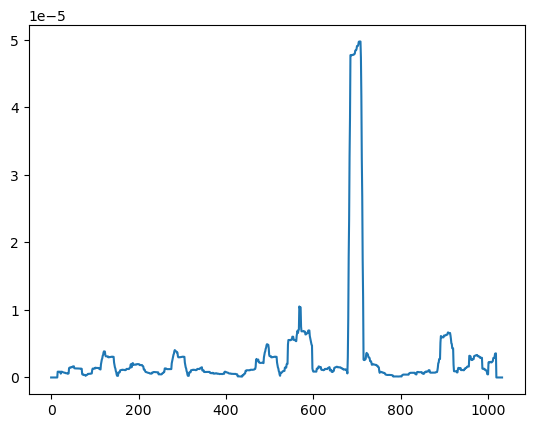

 98%|█████████████████████████████████████████▏| 98/100 [00:43<00:00,  2.27it/s]

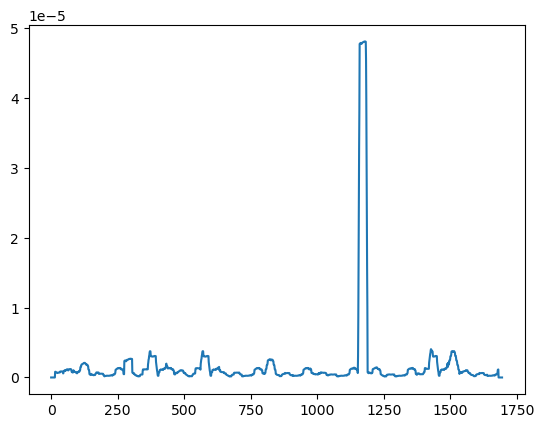

 99%|█████████████████████████████████████████▌| 99/100 [00:43<00:00,  2.26it/s]

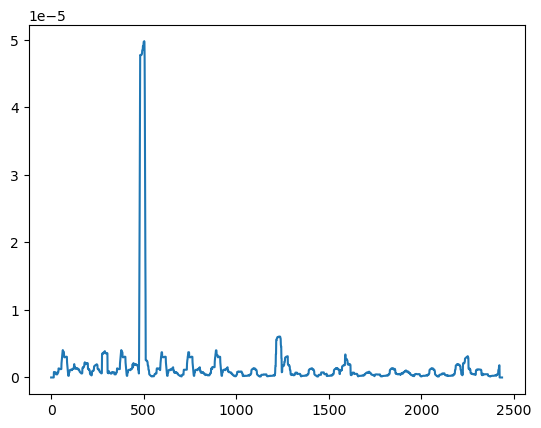

  0%|                                                   | 0/300 [00:00<?, ?it/s]

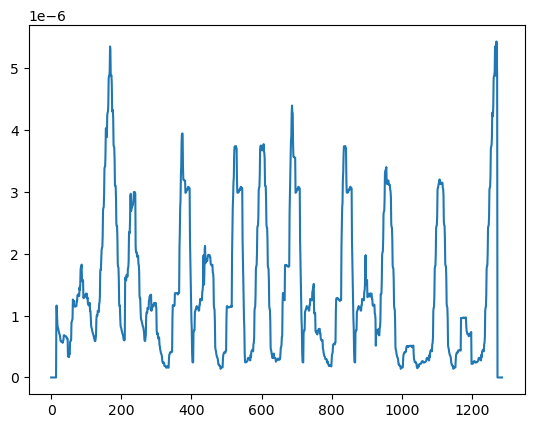

  0%|▏                                          | 1/300 [00:00<01:32,  3.24it/s]

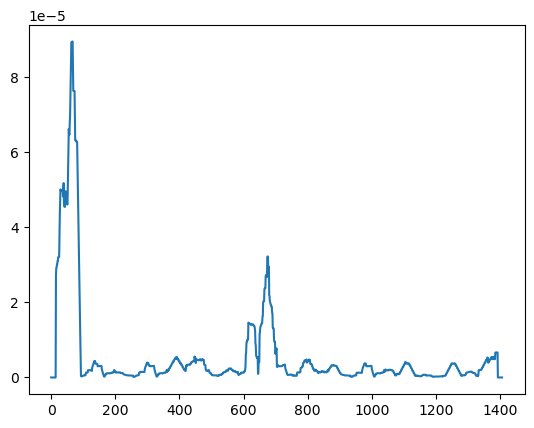

  1%|▎                                          | 2/300 [00:00<01:36,  3.08it/s]

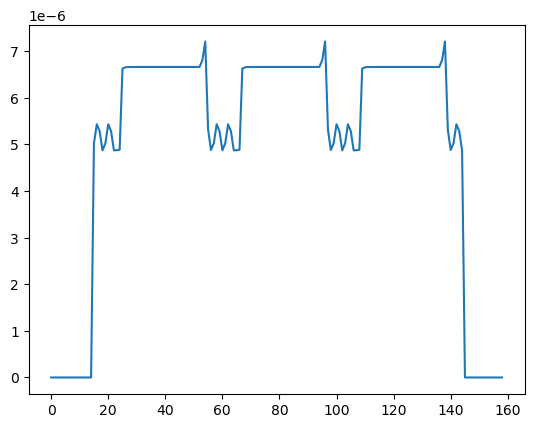

  1%|▍                                          | 3/300 [00:00<01:08,  4.36it/s]

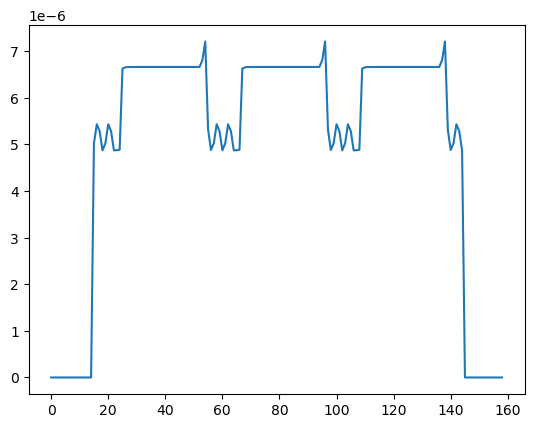

  1%|▌                                          | 4/300 [00:00<00:54,  5.44it/s]

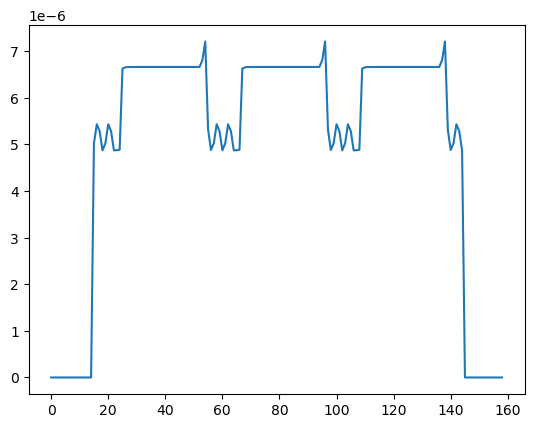

  2%|▋                                          | 5/300 [00:00<00:46,  6.31it/s]

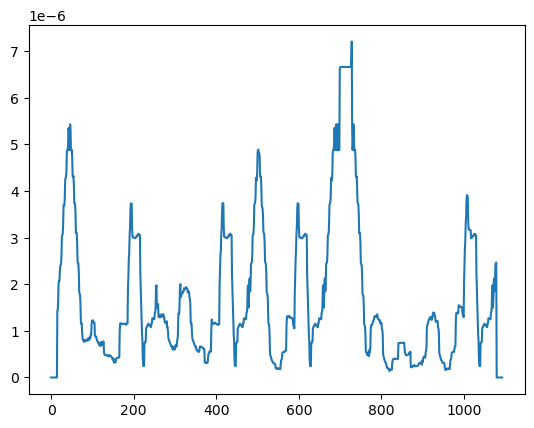

  2%|▊                                          | 6/300 [00:01<01:01,  4.74it/s]

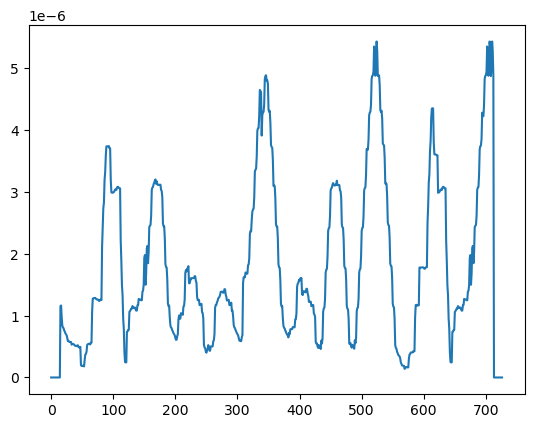

  2%|█                                          | 7/300 [00:01<01:04,  4.56it/s]

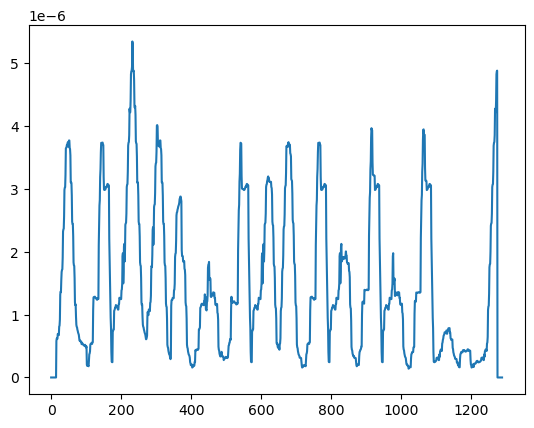

  3%|█▏                                         | 8/300 [00:01<01:14,  3.92it/s]

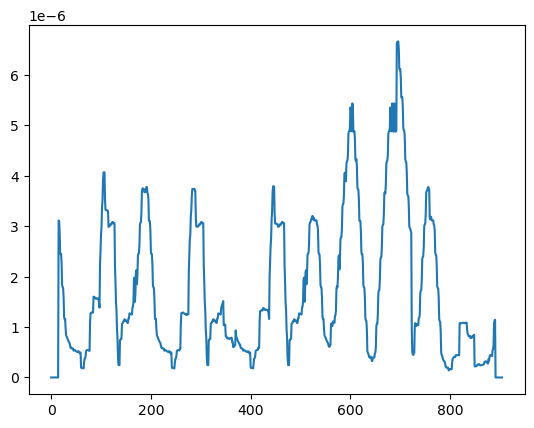

  3%|█▎                                         | 9/300 [00:02<01:13,  3.95it/s]

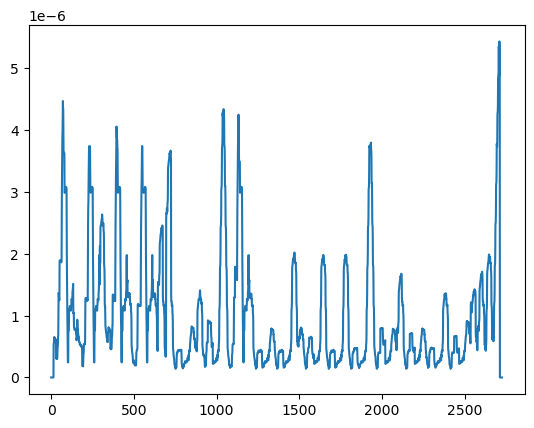

  3%|█▍                                        | 10/300 [00:02<01:41,  2.86it/s]

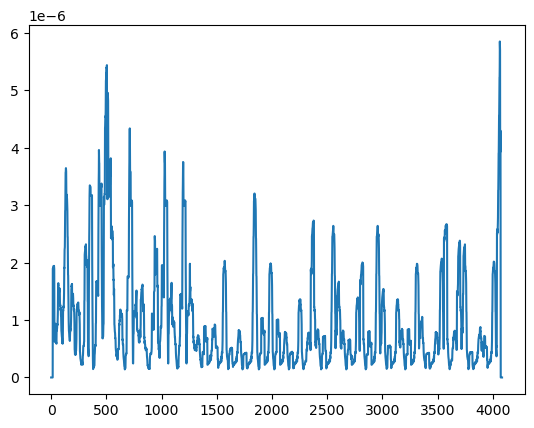

  4%|█▌                                        | 11/300 [00:03<02:22,  2.02it/s]

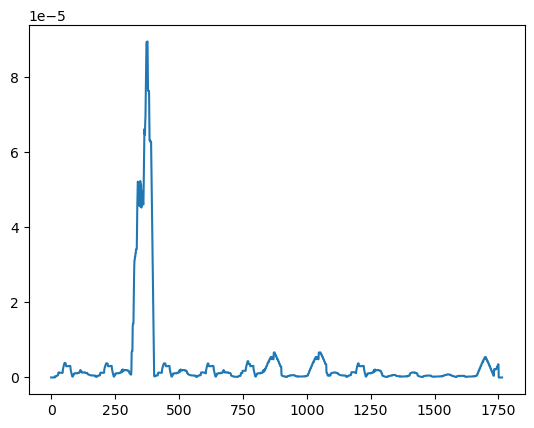

  4%|█▋                                        | 12/300 [00:03<02:14,  2.14it/s]

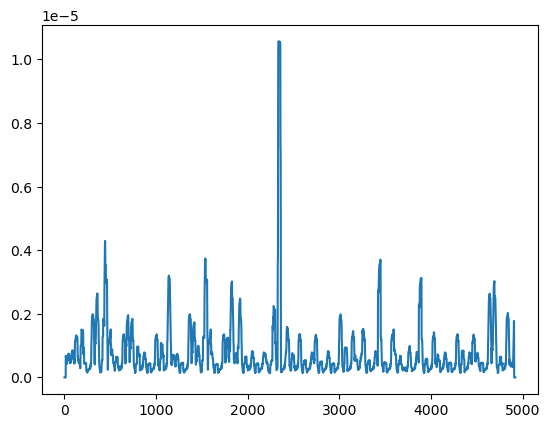

  4%|█▊                                        | 13/300 [00:04<02:56,  1.63it/s]

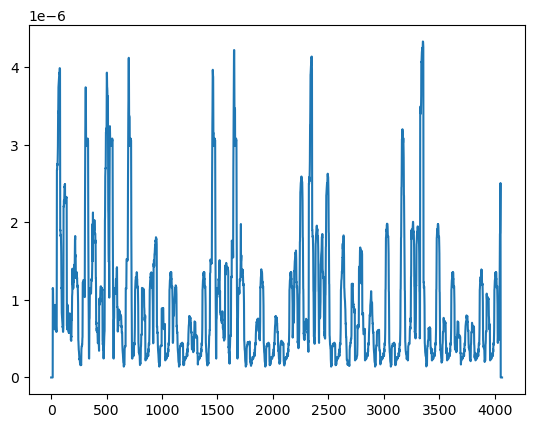

  5%|█▉                                        | 14/300 [00:05<03:11,  1.49it/s]

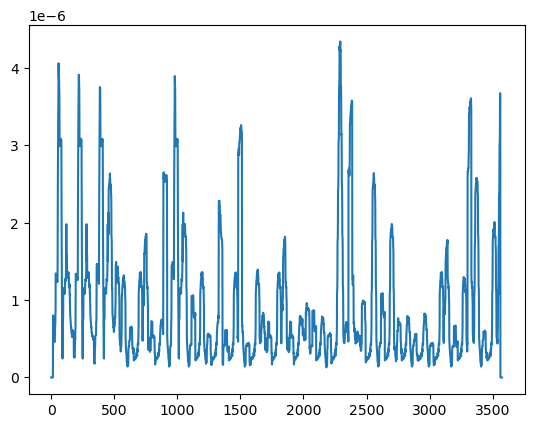

  5%|██                                        | 15/300 [00:06<03:14,  1.47it/s]

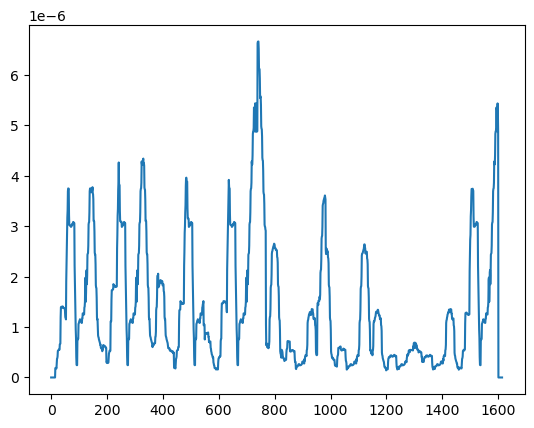

  5%|██▏                                       | 16/300 [00:06<02:48,  1.69it/s]

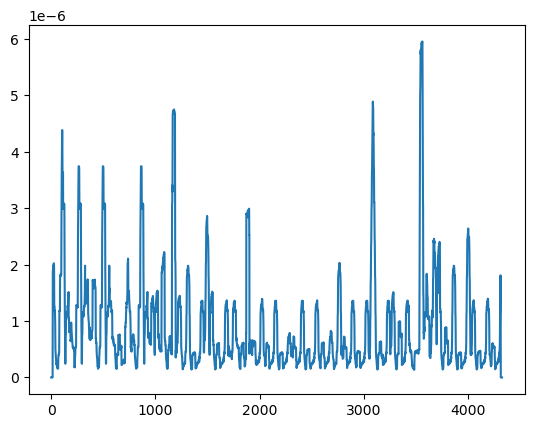

  6%|██▍                                       | 17/300 [00:07<03:11,  1.48it/s]

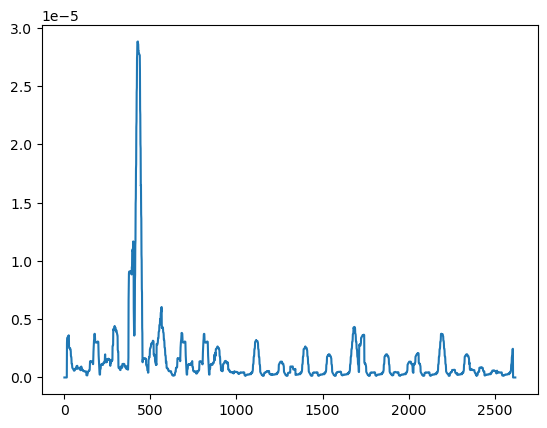

  6%|██▌                                       | 18/300 [00:08<03:00,  1.56it/s]

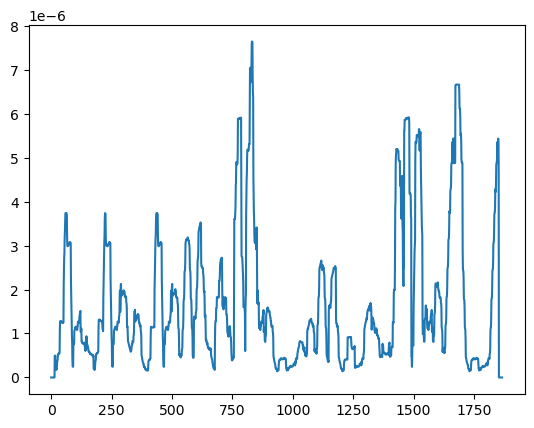

  6%|██▋                                       | 19/300 [00:08<02:40,  1.75it/s]

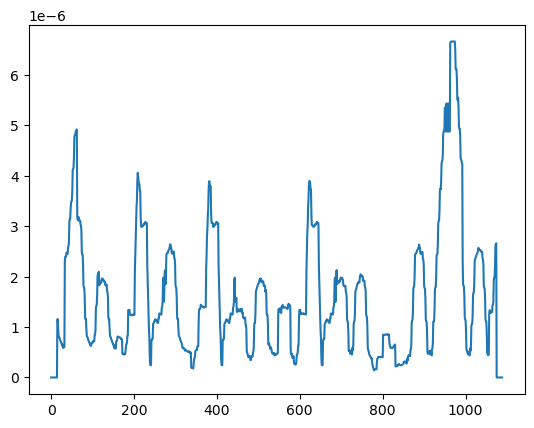

  7%|██▊                                       | 20/300 [00:08<02:17,  2.04it/s]

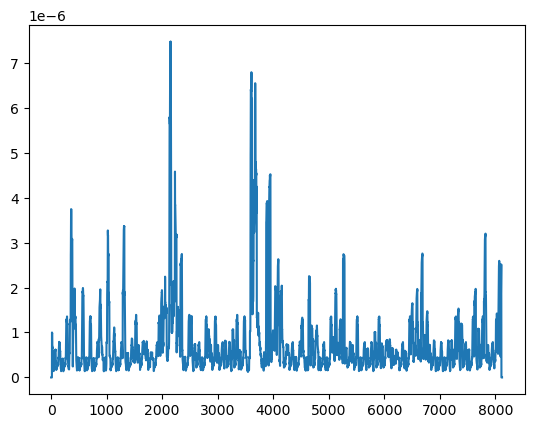

  7%|██▉                                       | 21/300 [00:10<03:48,  1.22it/s]

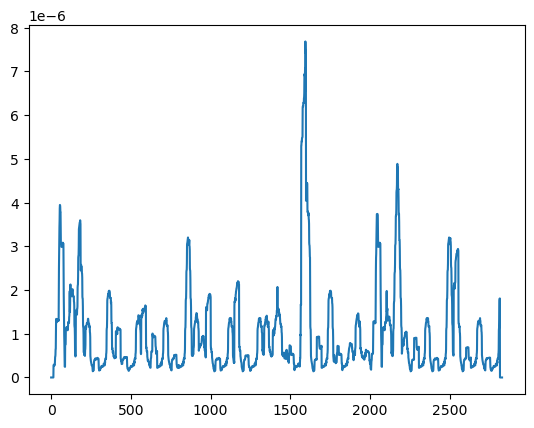

  7%|███                                       | 22/300 [00:11<03:31,  1.31it/s]

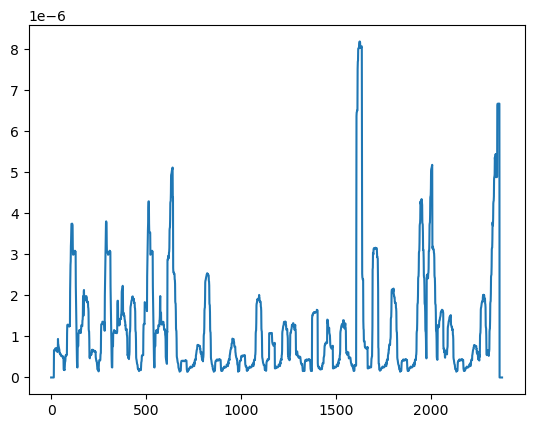

  8%|███▏                                      | 23/300 [00:11<03:11,  1.44it/s]

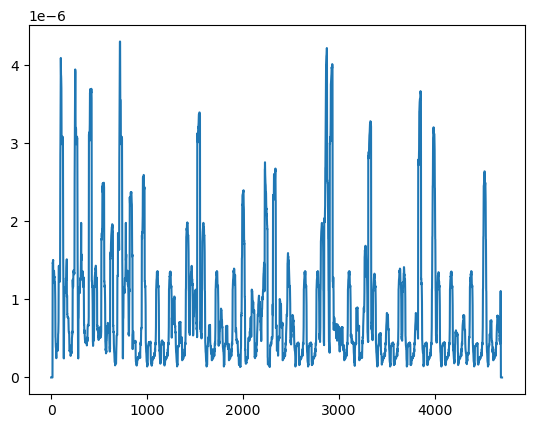

  8%|███▎                                      | 24/300 [00:12<03:35,  1.28it/s]

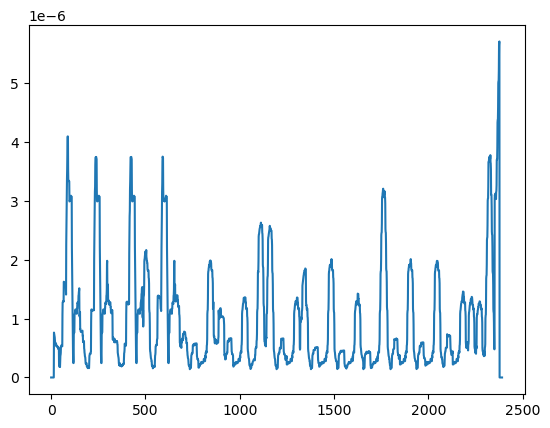

  8%|███▌                                      | 25/300 [00:13<03:13,  1.42it/s]

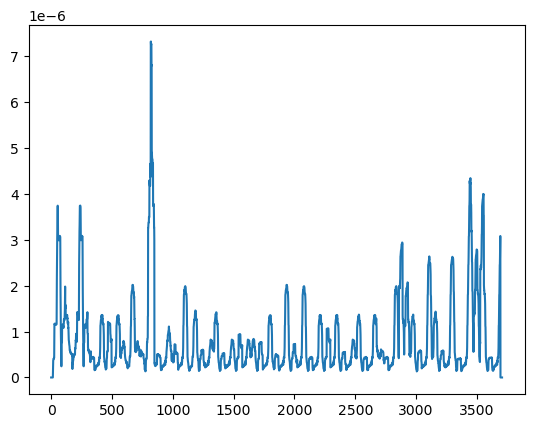

  9%|███▋                                      | 26/300 [00:13<03:17,  1.39it/s]

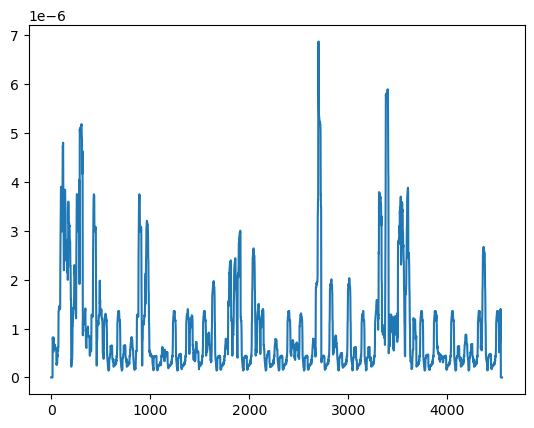

  9%|███▊                                      | 27/300 [00:14<03:33,  1.28it/s]

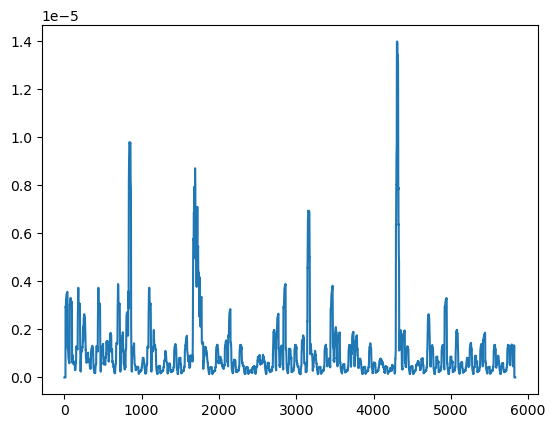

  9%|███▉                                      | 28/300 [00:15<04:00,  1.13it/s]

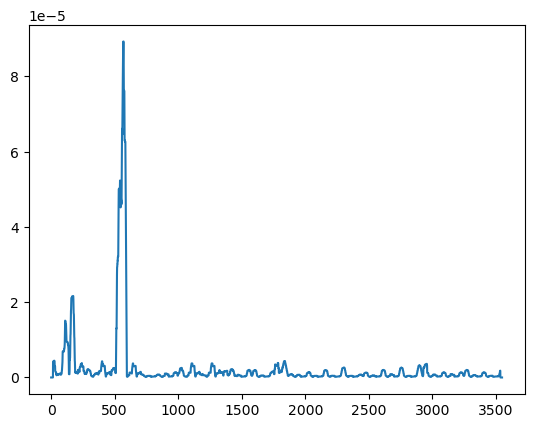

 10%|████                                      | 29/300 [00:16<03:46,  1.20it/s]

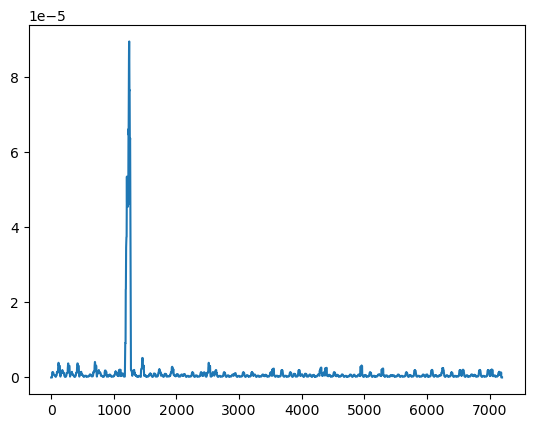

 10%|████▏                                     | 30/300 [00:18<04:26,  1.01it/s]

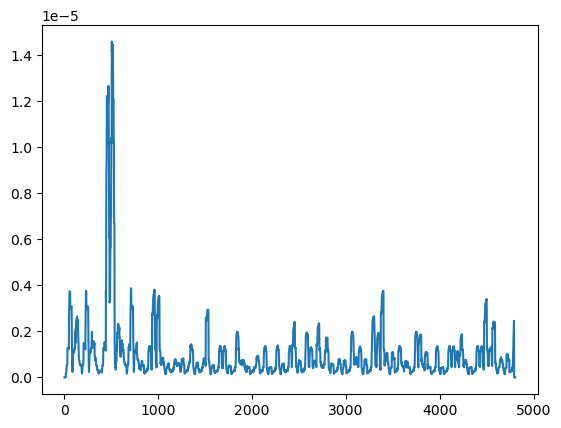

 10%|████▎                                     | 31/300 [00:18<04:20,  1.03it/s]

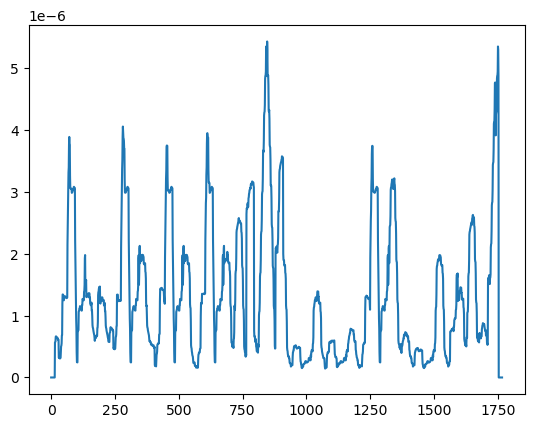

 11%|████▍                                     | 32/300 [00:19<03:33,  1.25it/s]

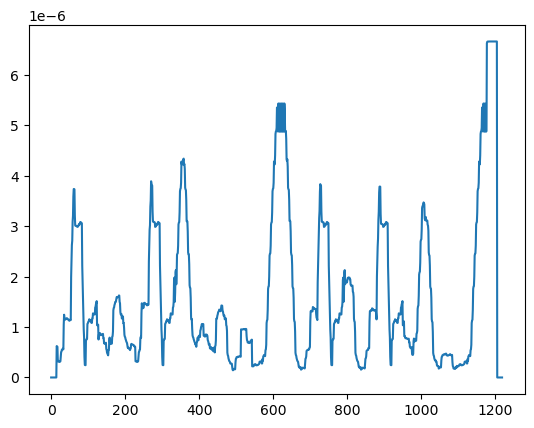

 11%|████▌                                     | 33/300 [00:19<02:55,  1.52it/s]

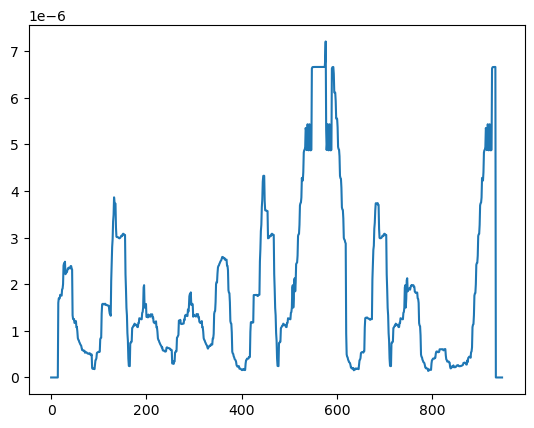

 11%|████▊                                     | 34/300 [00:19<02:24,  1.84it/s]

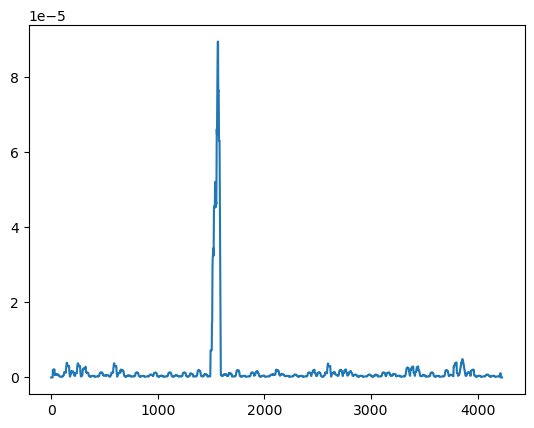

 12%|████▉                                     | 35/300 [00:20<02:47,  1.59it/s]

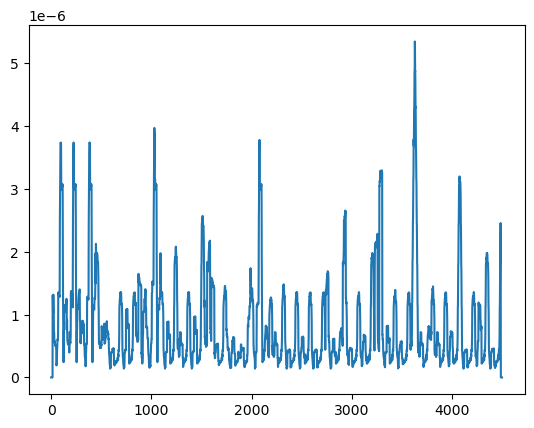

 12%|█████                                     | 36/300 [00:21<03:06,  1.41it/s]

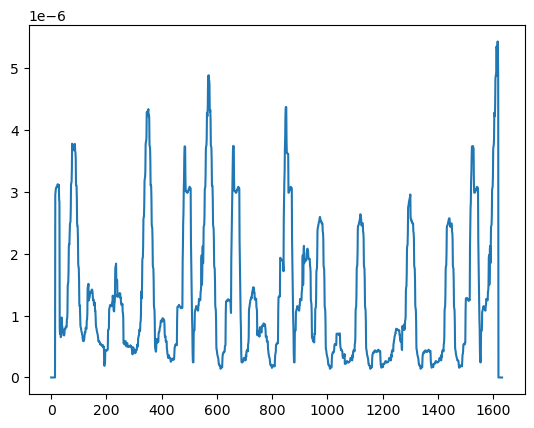

 12%|█████▏                                    | 37/300 [00:22<02:40,  1.64it/s]

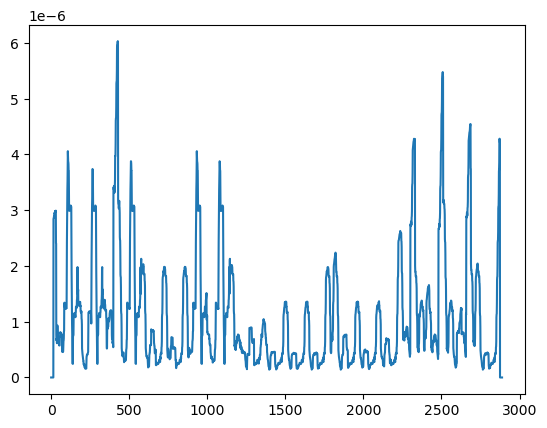

 13%|█████▎                                    | 38/300 [00:22<02:41,  1.63it/s]

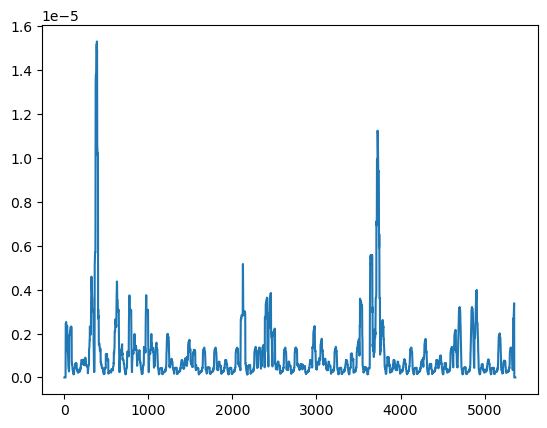

 13%|█████▍                                    | 39/300 [00:23<03:13,  1.35it/s]

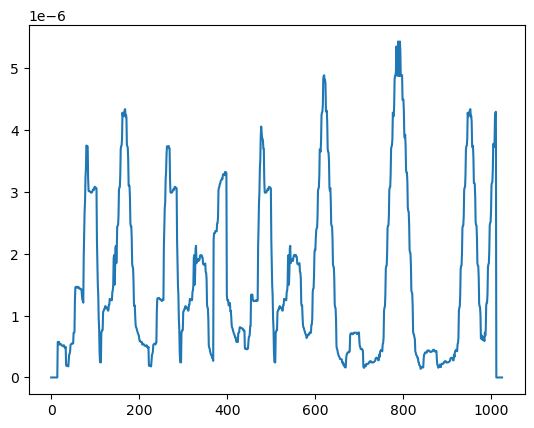

 13%|█████▌                                    | 40/300 [00:23<02:35,  1.67it/s]

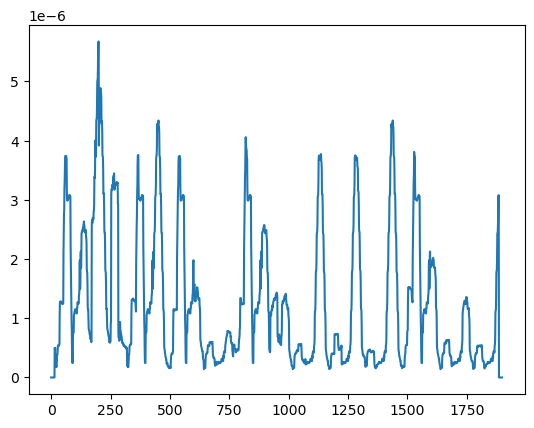

 14%|█████▋                                    | 41/300 [00:24<02:20,  1.84it/s]

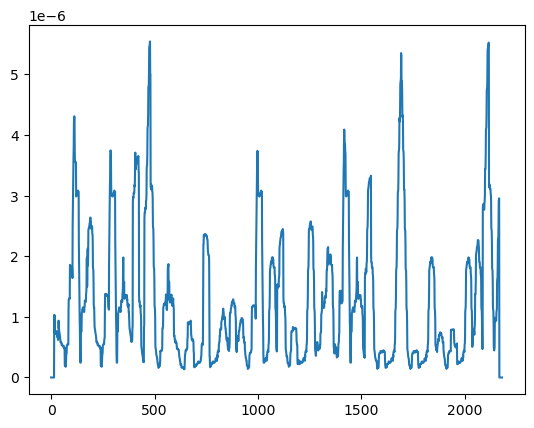

 14%|█████▉                                    | 42/300 [00:24<02:16,  1.89it/s]

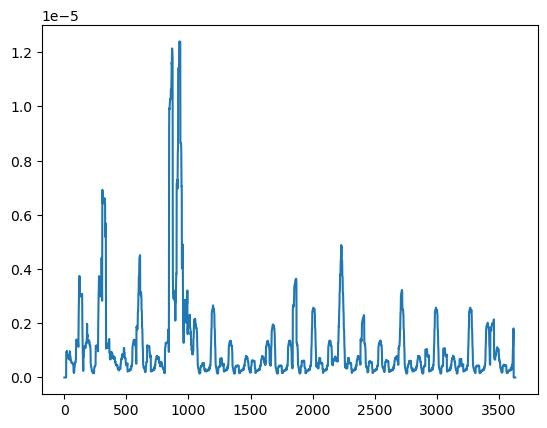

 14%|██████                                    | 43/300 [00:25<02:31,  1.69it/s]

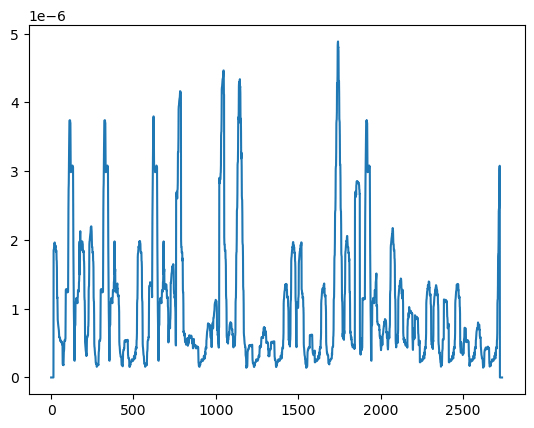

 15%|██████▏                                   | 44/300 [00:26<02:29,  1.71it/s]

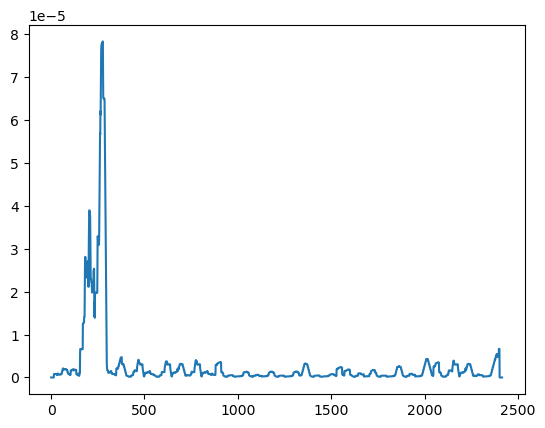

 15%|██████▎                                   | 45/300 [00:26<02:36,  1.63it/s]

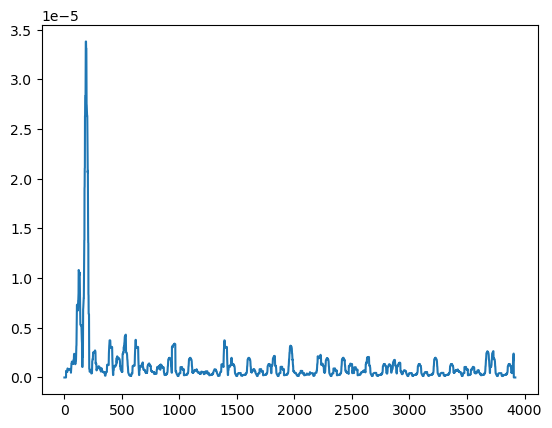

 15%|██████▍                                   | 46/300 [00:27<02:50,  1.49it/s]

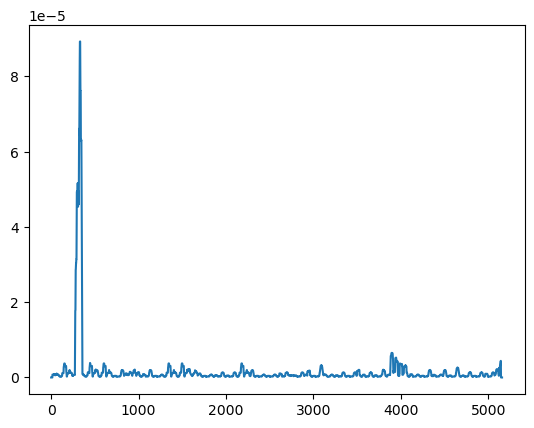

 16%|██████▌                                   | 47/300 [00:28<03:16,  1.29it/s]

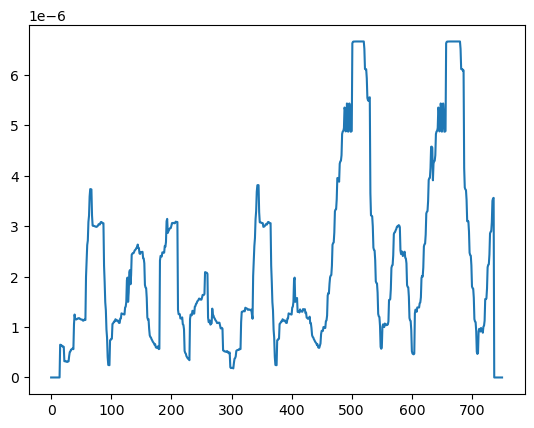

 16%|██████▋                                   | 48/300 [00:28<02:33,  1.64it/s]

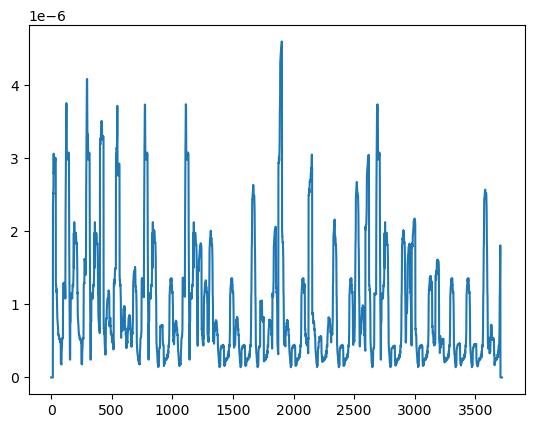

 16%|██████▊                                   | 49/300 [00:29<02:43,  1.53it/s]

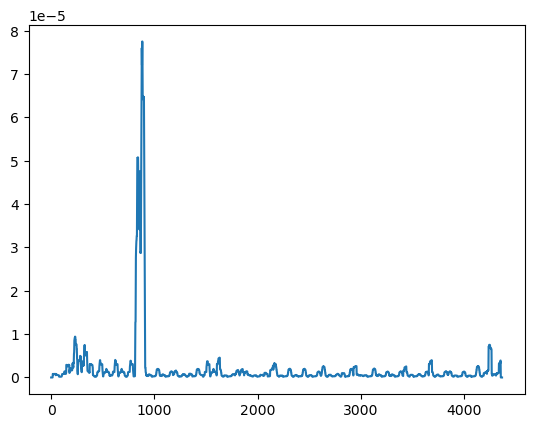

 17%|███████                                   | 50/300 [00:30<02:57,  1.41it/s]

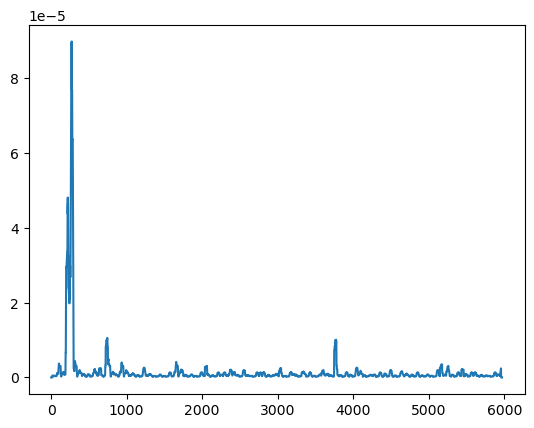

 17%|███████▏                                  | 51/300 [00:31<03:28,  1.19it/s]

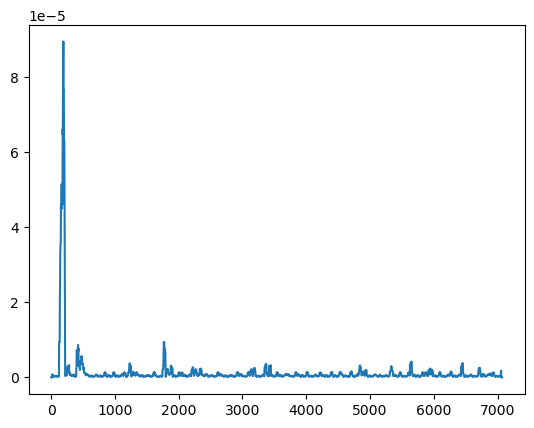

 17%|███████▎                                  | 52/300 [00:32<04:03,  1.02it/s]

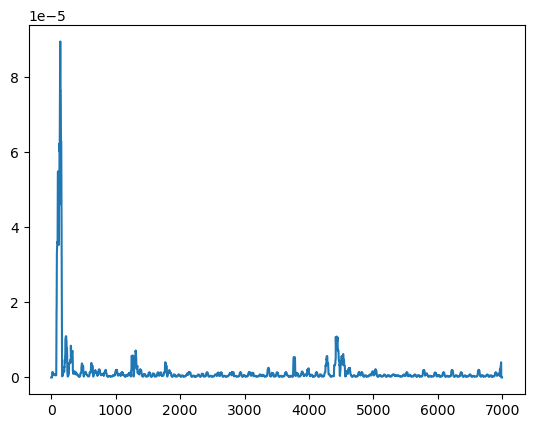

 18%|███████▍                                  | 53/300 [00:34<04:26,  1.08s/it]

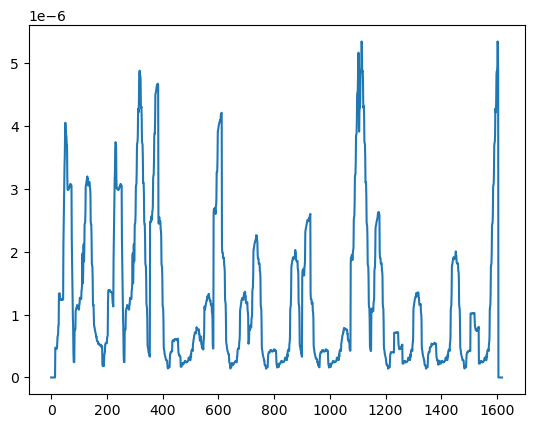

 18%|███████▌                                  | 54/300 [00:34<03:34,  1.15it/s]

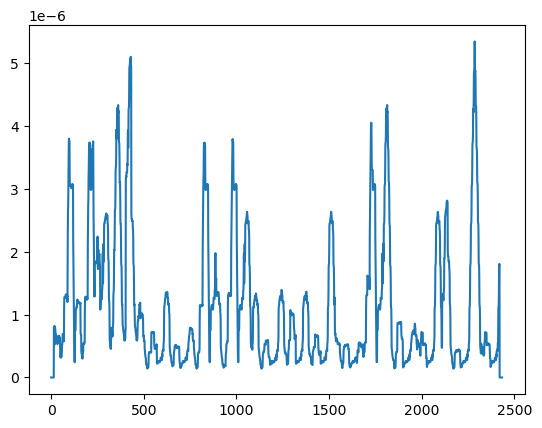

 18%|███████▋                                  | 55/300 [00:35<03:08,  1.30it/s]

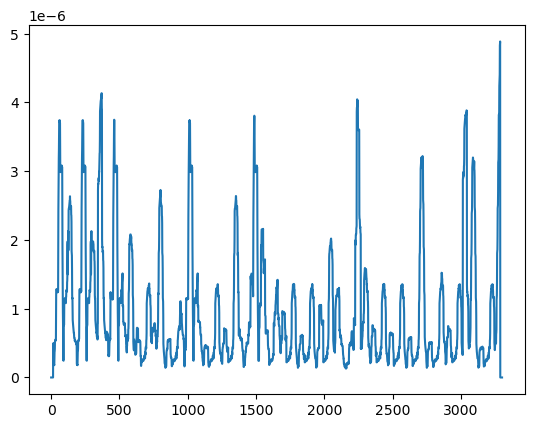

 19%|███████▊                                  | 56/300 [00:35<02:59,  1.36it/s]

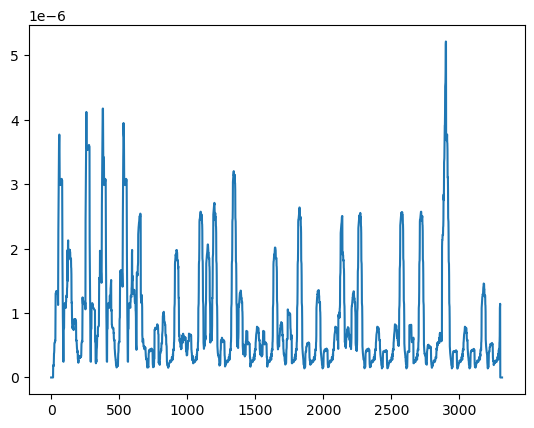

 19%|███████▉                                  | 57/300 [00:36<02:53,  1.40it/s]

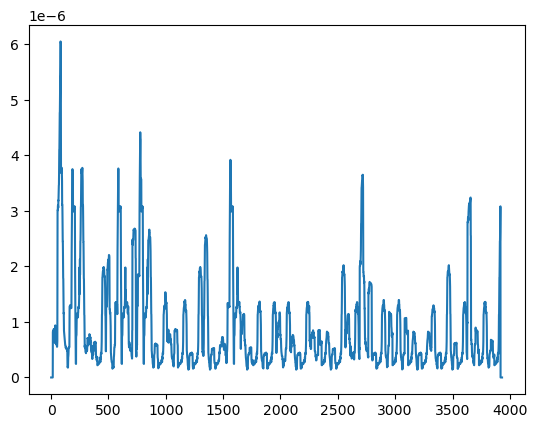

 19%|████████                                  | 58/300 [00:37<02:57,  1.36it/s]

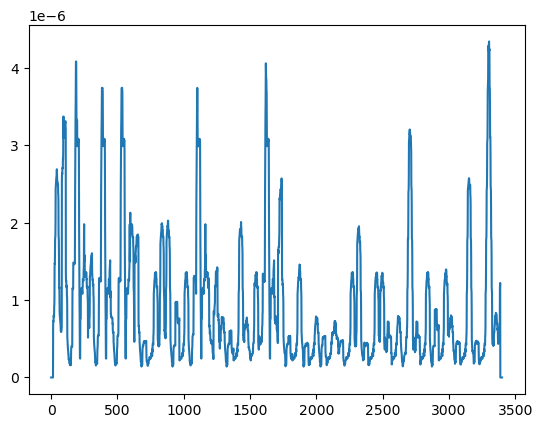

 20%|████████▎                                 | 59/300 [00:37<02:52,  1.40it/s]

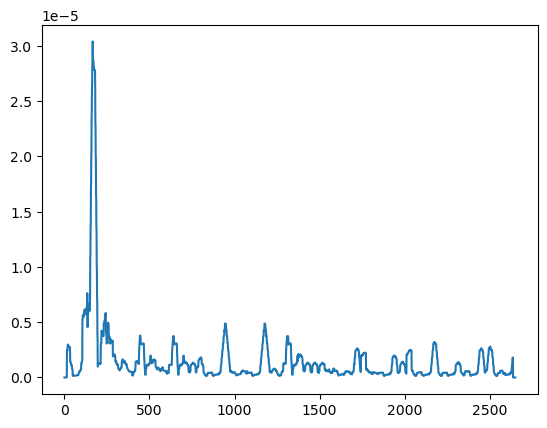

 20%|████████▍                                 | 60/300 [00:38<02:41,  1.49it/s]

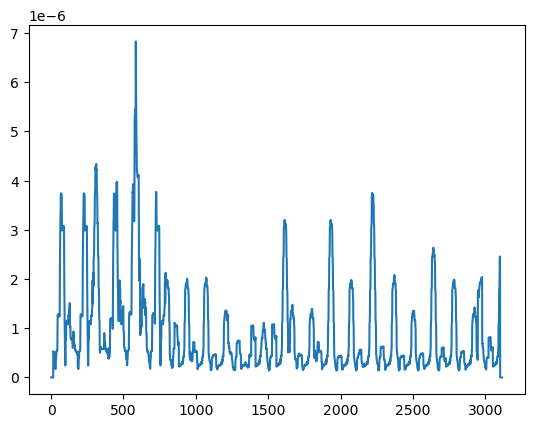

 20%|████████▌                                 | 61/300 [00:39<02:40,  1.49it/s]

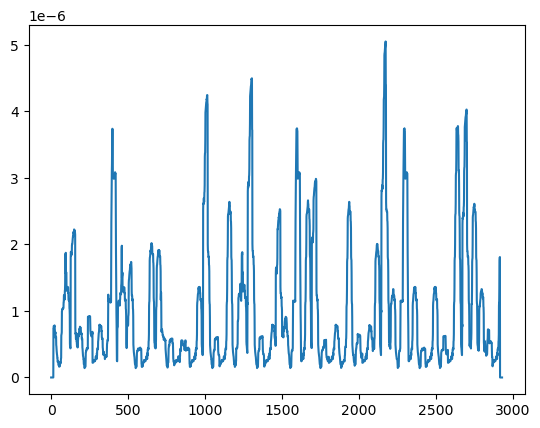

 21%|████████▋                                 | 62/300 [00:39<02:34,  1.54it/s]

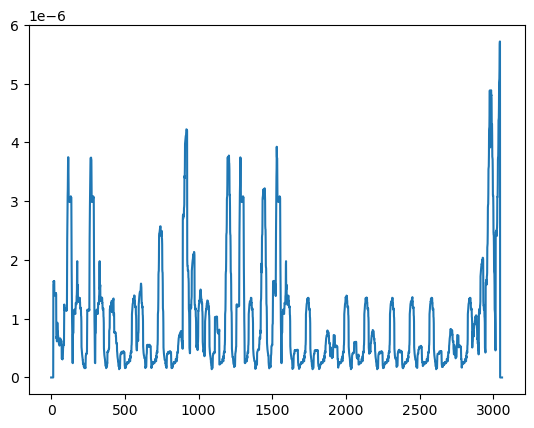

 21%|████████▊                                 | 63/300 [00:40<02:32,  1.56it/s]

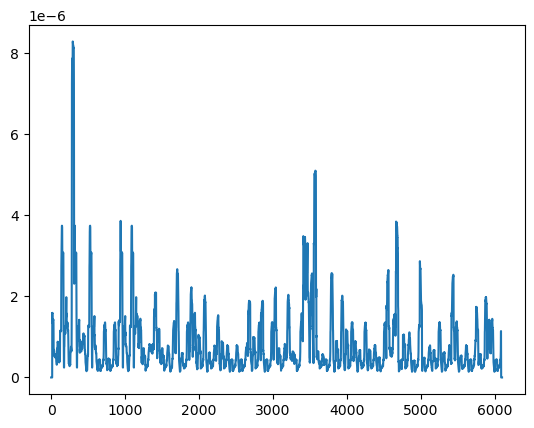

 21%|████████▉                                 | 64/300 [00:41<03:09,  1.25it/s]

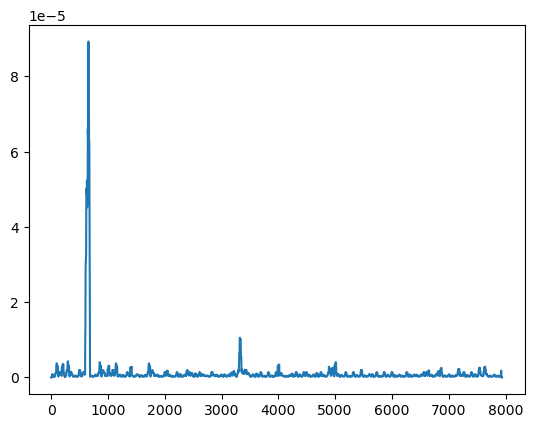

 22%|█████████                                 | 65/300 [00:43<03:57,  1.01s/it]

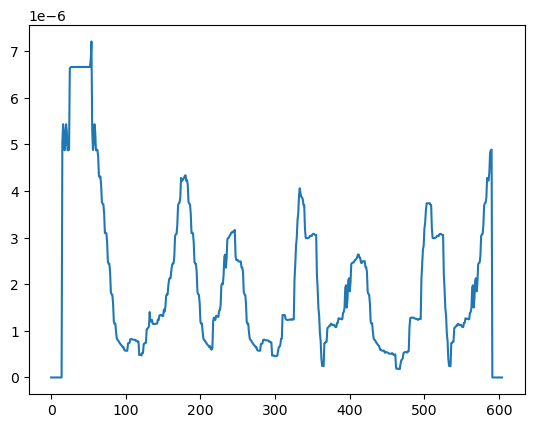

 22%|█████████▏                                | 66/300 [00:43<03:00,  1.29it/s]

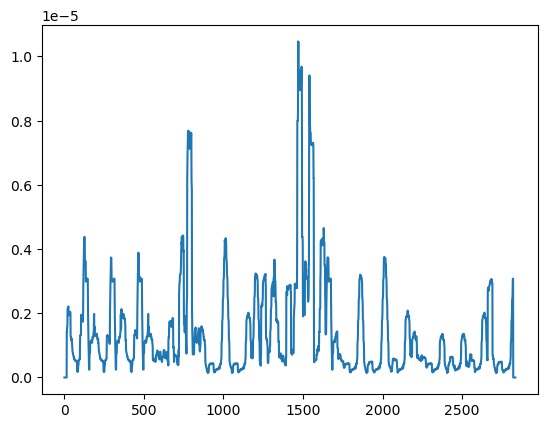

 22%|█████████▍                                | 67/300 [00:43<02:46,  1.40it/s]

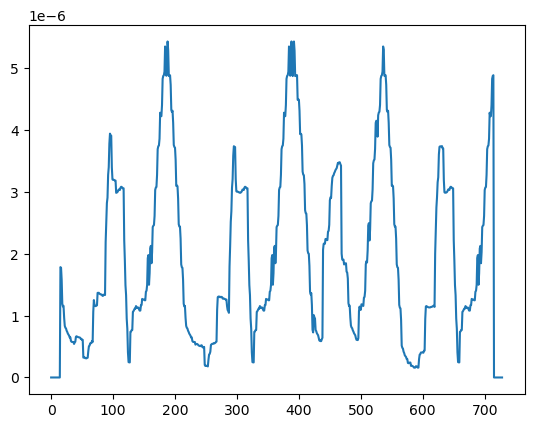

 23%|█████████▌                                | 68/300 [00:44<02:18,  1.68it/s]

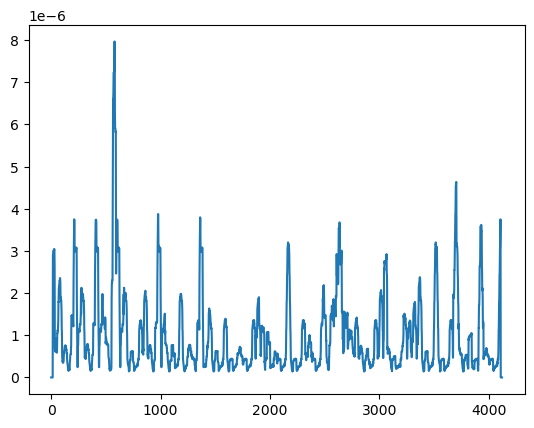

 23%|█████████▋                                | 69/300 [00:45<02:31,  1.52it/s]

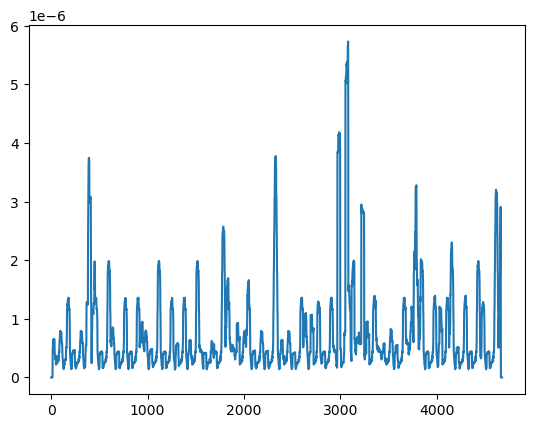

 23%|█████████▊                                | 70/300 [00:45<02:47,  1.37it/s]

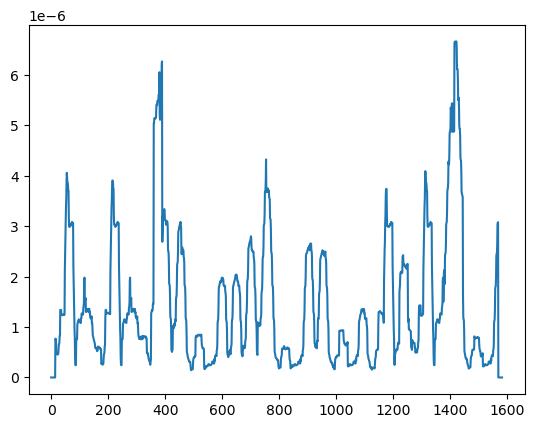

 24%|█████████▉                                | 71/300 [00:46<02:22,  1.61it/s]

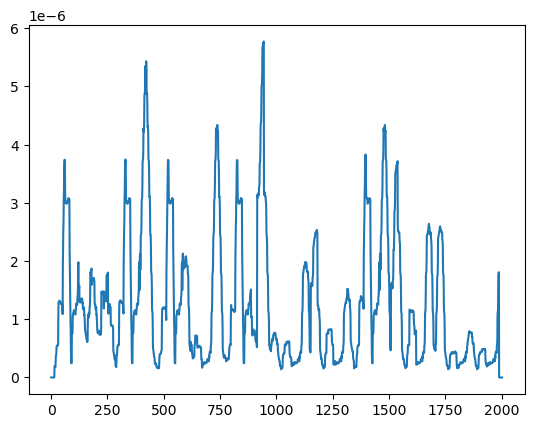

 24%|██████████                                | 72/300 [00:46<02:08,  1.77it/s]

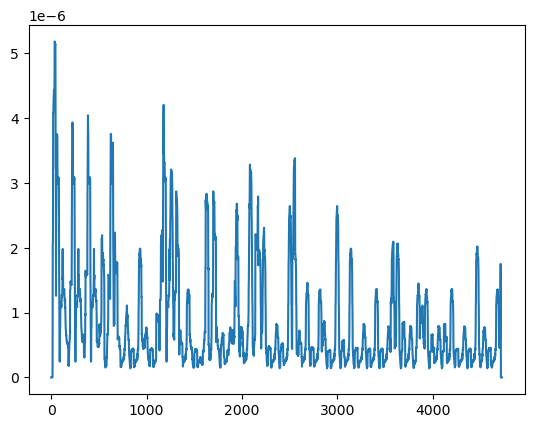

 24%|██████████▏                               | 73/300 [00:47<02:31,  1.50it/s]

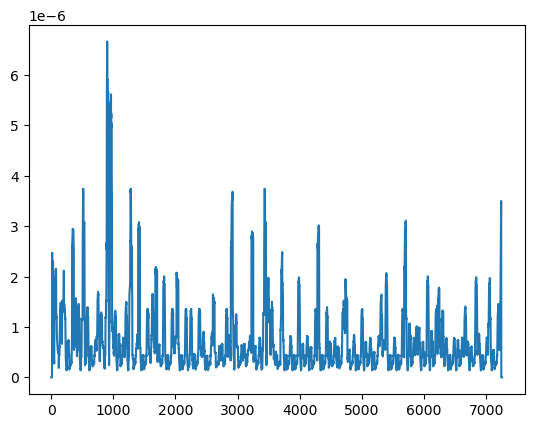

 25%|██████████▎                               | 74/300 [00:48<03:17,  1.15it/s]

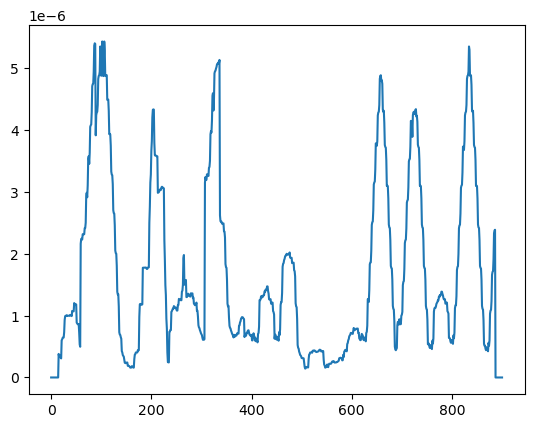

 25%|██████████▌                               | 75/300 [00:49<02:34,  1.46it/s]

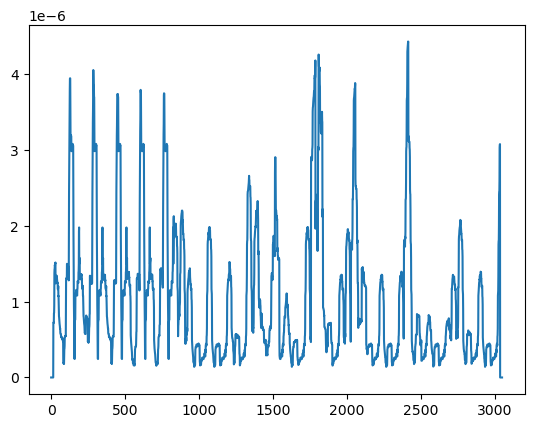

 25%|██████████▋                               | 76/300 [00:49<02:27,  1.51it/s]

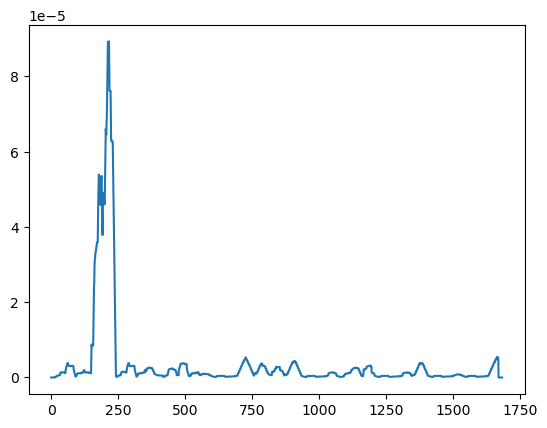

 26%|██████████▊                               | 77/300 [00:50<02:09,  1.73it/s]

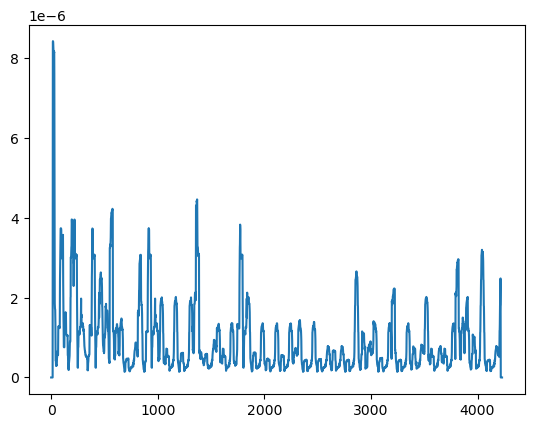

 26%|██████████▉                               | 78/300 [00:51<02:24,  1.54it/s]

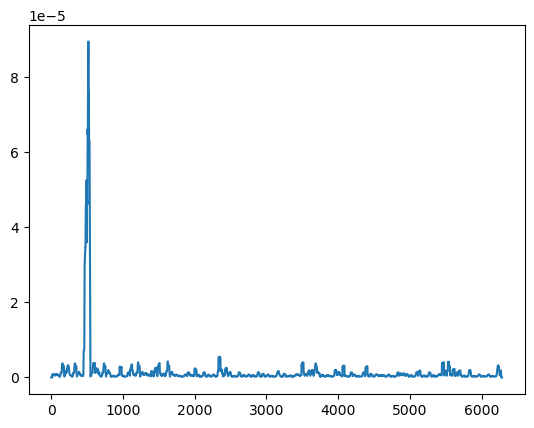

 26%|███████████                               | 79/300 [00:52<02:58,  1.24it/s]

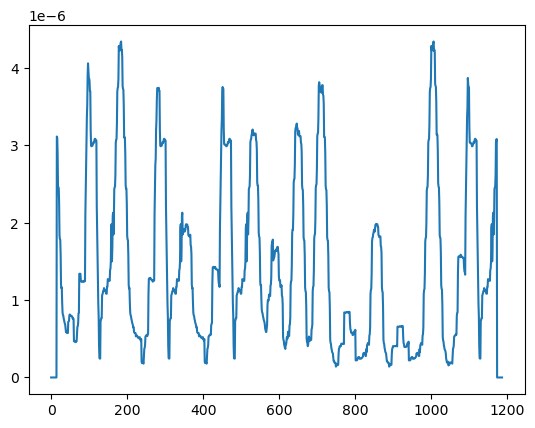

 27%|███████████▏                              | 80/300 [00:52<02:30,  1.46it/s]

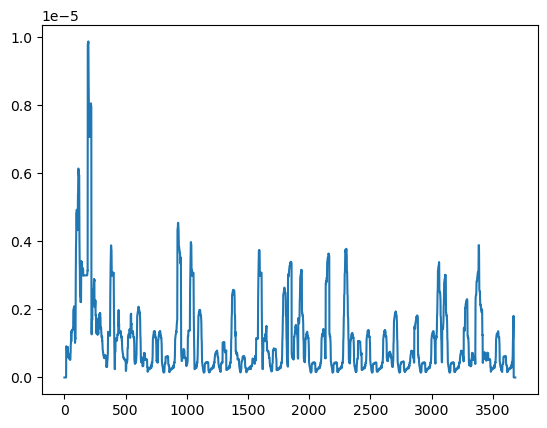

 27%|███████████▎                              | 81/300 [00:53<02:32,  1.43it/s]

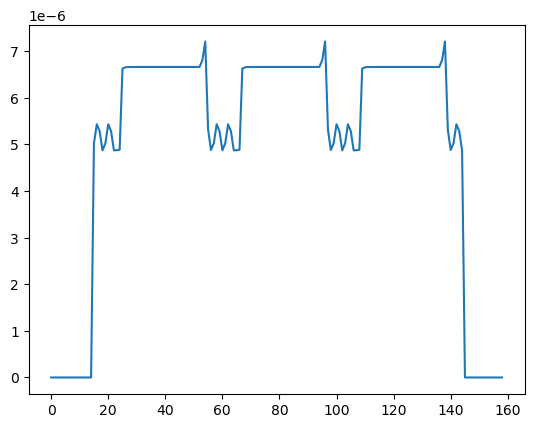

 27%|███████████▍                              | 82/300 [00:53<01:54,  1.90it/s]

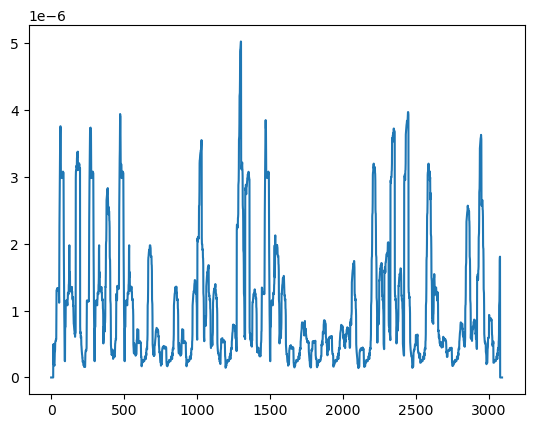

 28%|███████████▌                              | 83/300 [00:54<02:01,  1.78it/s]

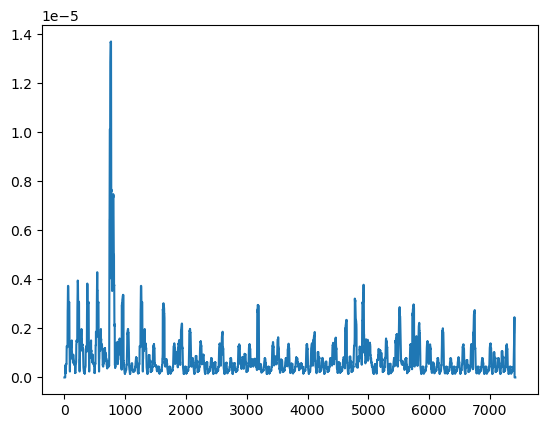

 28%|███████████▊                              | 84/300 [00:55<02:54,  1.24it/s]

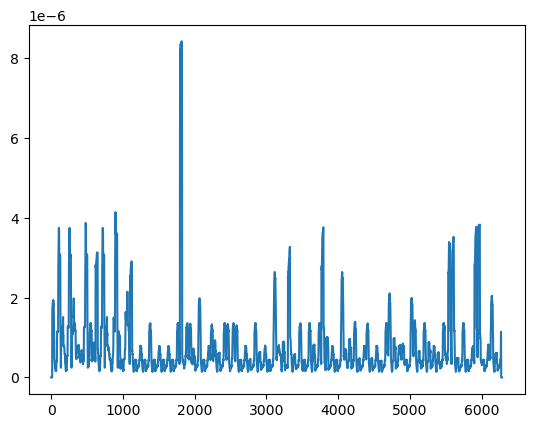

 28%|███████████▉                              | 85/300 [00:56<03:15,  1.10it/s]

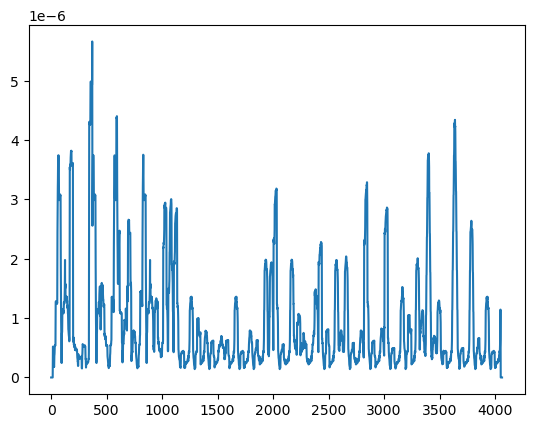

 29%|████████████                              | 86/300 [00:57<03:07,  1.14it/s]

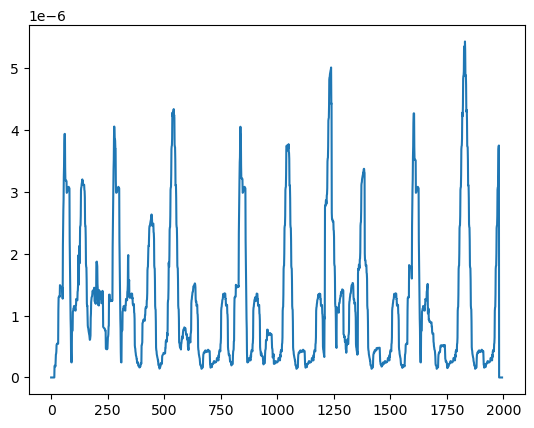

 29%|████████████▏                             | 87/300 [00:57<02:39,  1.33it/s]

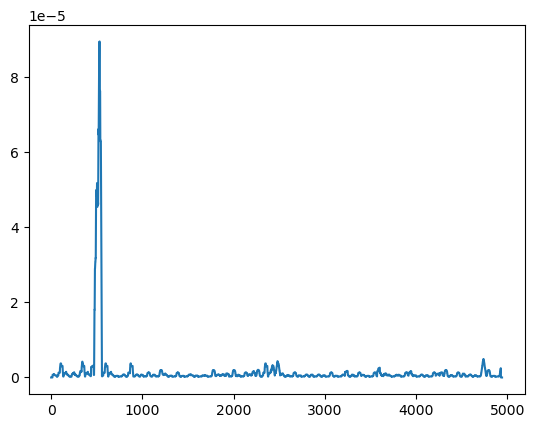

 29%|████████████▎                             | 88/300 [00:58<02:52,  1.23it/s]

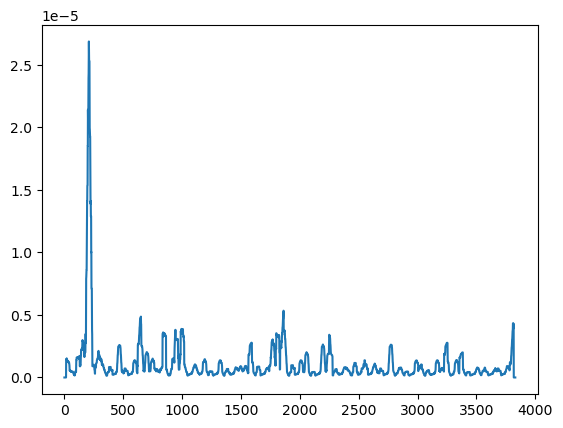

 30%|████████████▍                             | 89/300 [00:59<02:50,  1.24it/s]

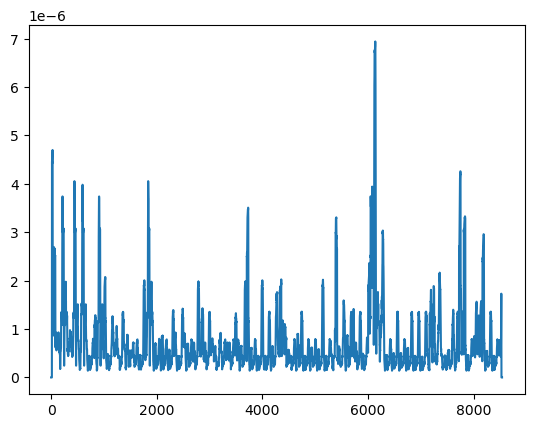

 30%|████████████▌                             | 90/300 [01:01<03:40,  1.05s/it]

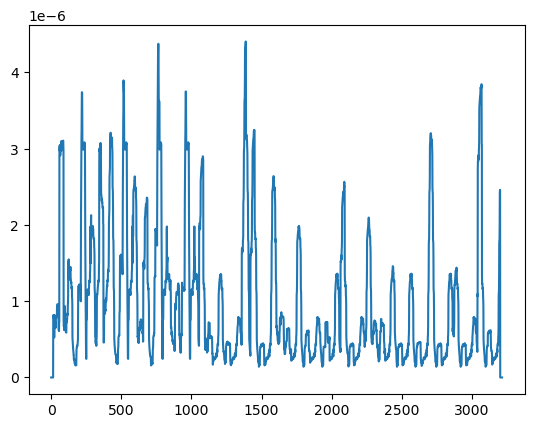

 30%|████████████▋                             | 91/300 [01:01<03:14,  1.08it/s]

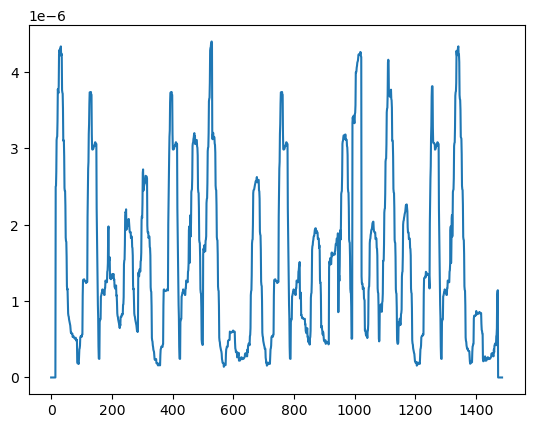

 31%|████████████▉                             | 92/300 [01:02<02:37,  1.32it/s]

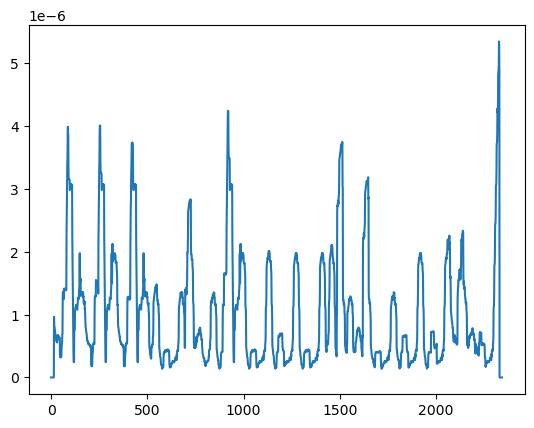

 31%|█████████████                             | 93/300 [01:02<02:21,  1.46it/s]

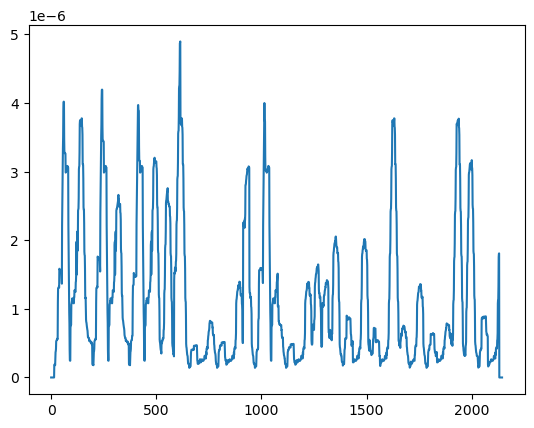

 31%|█████████████▏                            | 94/300 [01:03<02:08,  1.60it/s]

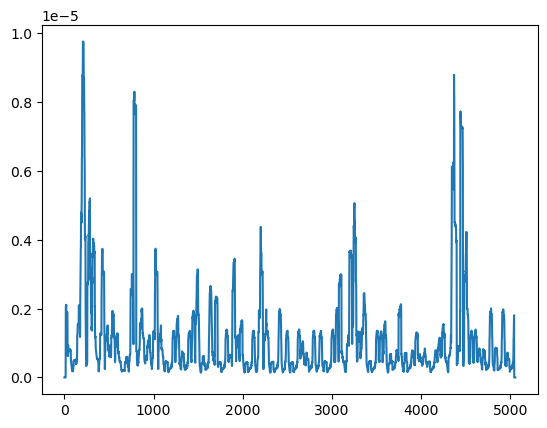

 32%|█████████████▎                            | 95/300 [01:04<02:31,  1.35it/s]

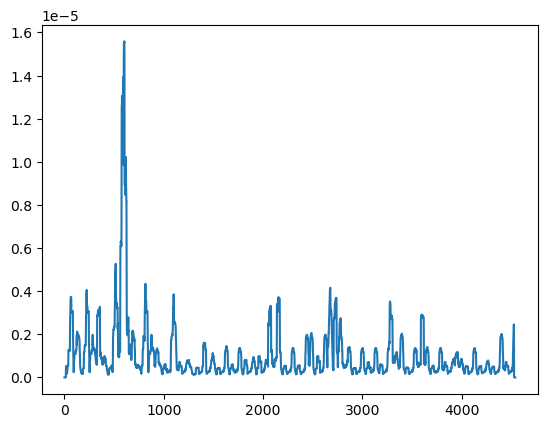

 32%|█████████████▍                            | 96/300 [01:05<02:39,  1.28it/s]

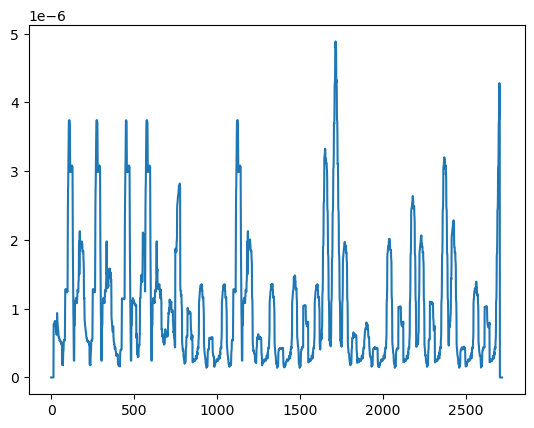

 32%|█████████████▌                            | 97/300 [01:05<02:27,  1.38it/s]

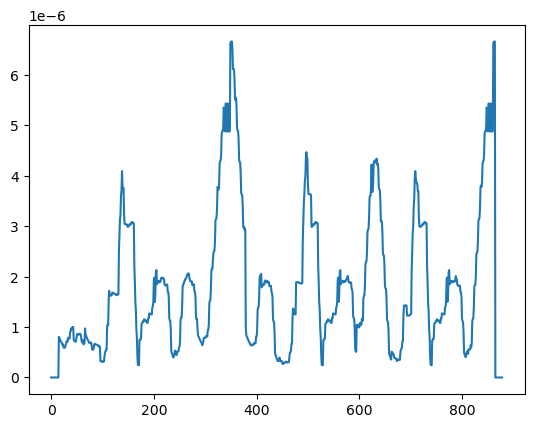

 33%|█████████████▋                            | 98/300 [01:05<01:57,  1.72it/s]

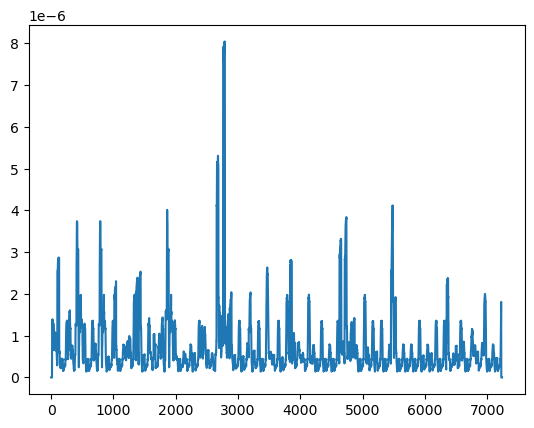

 33%|█████████████▊                            | 99/300 [01:07<02:43,  1.23it/s]

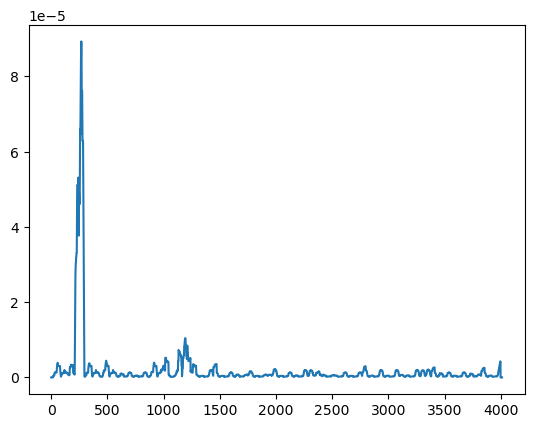

 33%|█████████████▋                           | 100/300 [01:08<02:46,  1.20it/s]

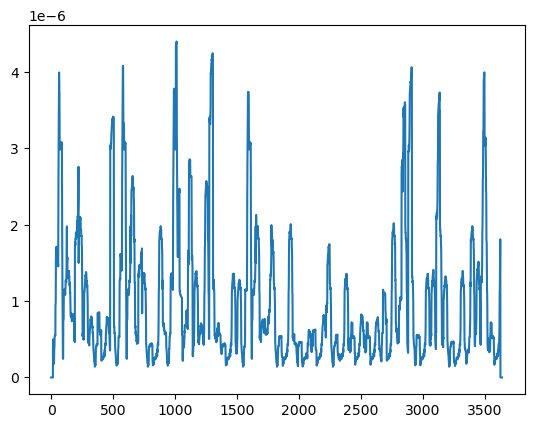

 34%|█████████████▊                           | 101/300 [01:08<02:40,  1.24it/s]

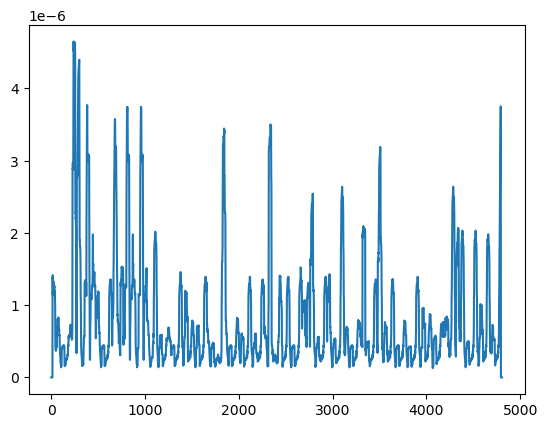

 34%|█████████████▉                           | 102/300 [01:09<02:46,  1.19it/s]

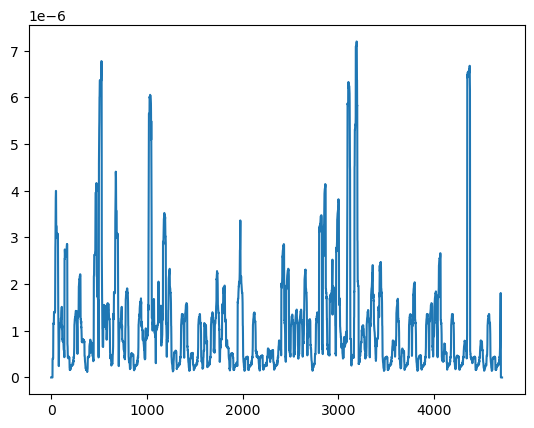

 34%|██████████████                           | 103/300 [01:10<02:49,  1.16it/s]

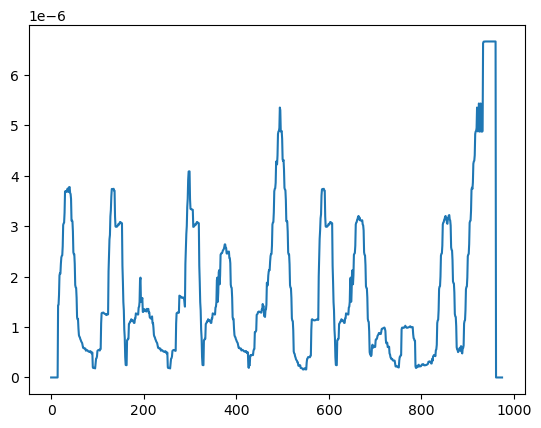

 35%|██████████████▏                          | 104/300 [01:11<02:13,  1.47it/s]

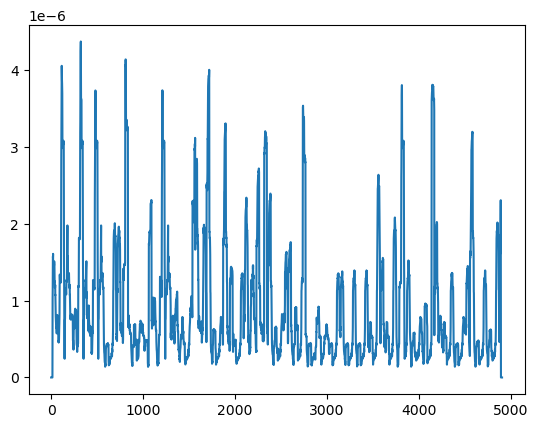

 35%|██████████████▎                          | 105/300 [01:12<02:29,  1.31it/s]

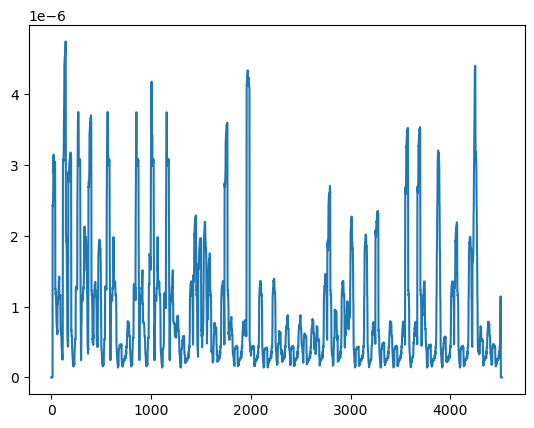

 35%|██████████████▍                          | 106/300 [01:13<02:41,  1.20it/s]

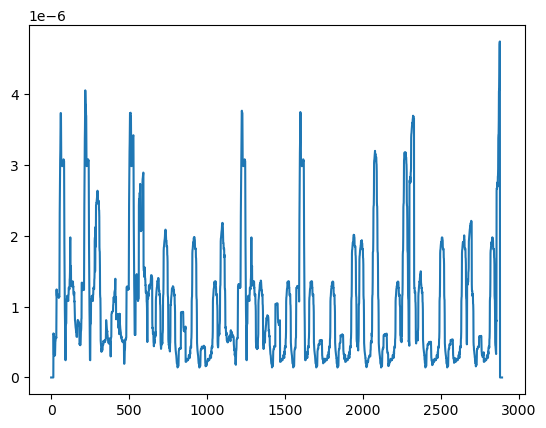

 36%|██████████████▌                          | 107/300 [01:13<02:29,  1.29it/s]

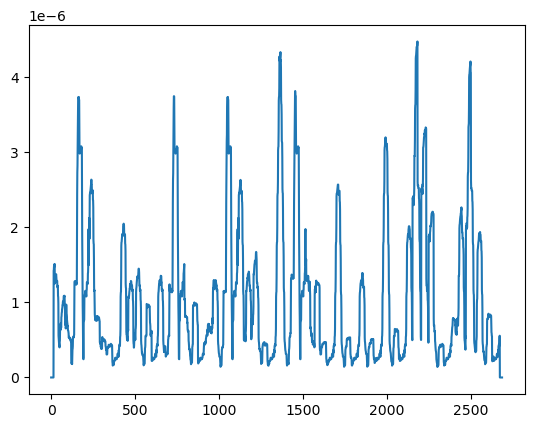

 36%|██████████████▊                          | 108/300 [01:14<02:16,  1.41it/s]

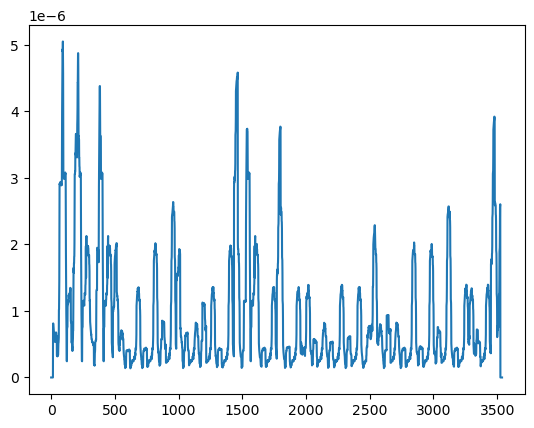

 36%|██████████████▉                          | 109/300 [01:14<02:15,  1.41it/s]

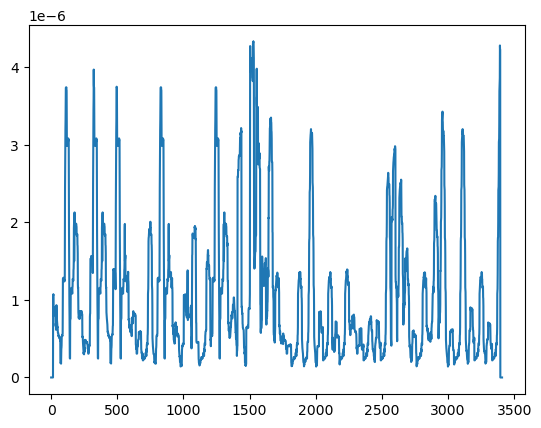

 37%|███████████████                          | 110/300 [01:15<02:15,  1.40it/s]

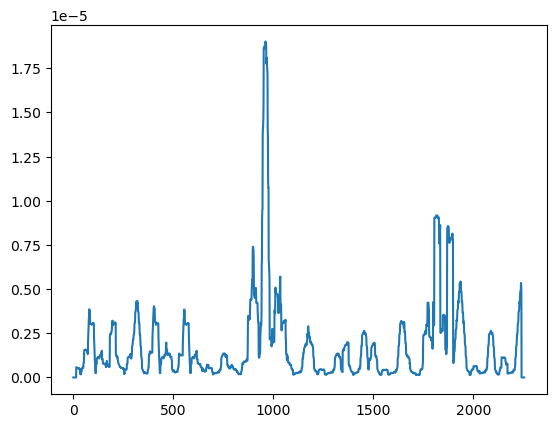

 37%|███████████████▏                         | 111/300 [01:16<02:02,  1.54it/s]

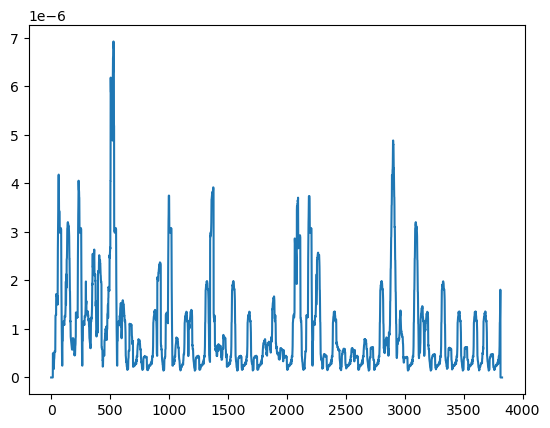

 37%|███████████████▎                         | 112/300 [01:16<02:09,  1.46it/s]

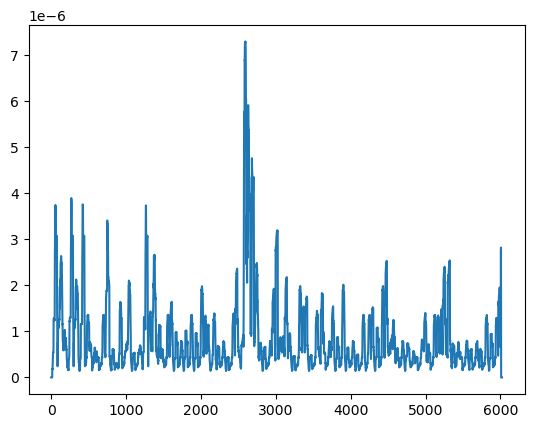

 38%|███████████████▍                         | 113/300 [01:18<02:35,  1.21it/s]

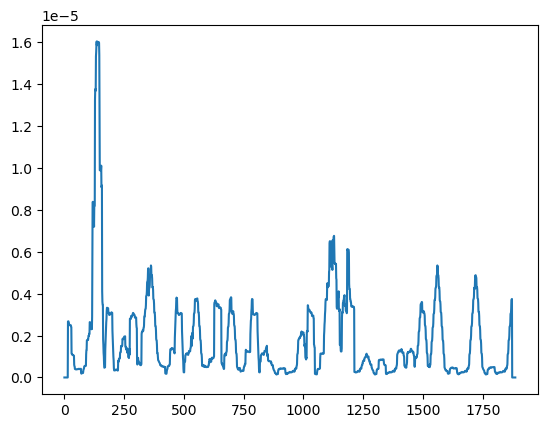

 38%|███████████████▌                         | 114/300 [01:18<02:11,  1.42it/s]

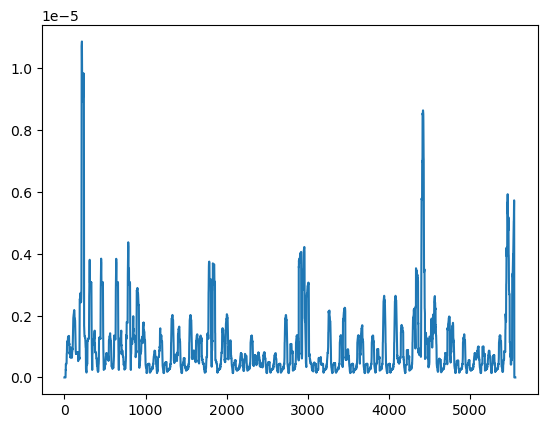

 38%|███████████████▋                         | 115/300 [01:19<02:29,  1.24it/s]

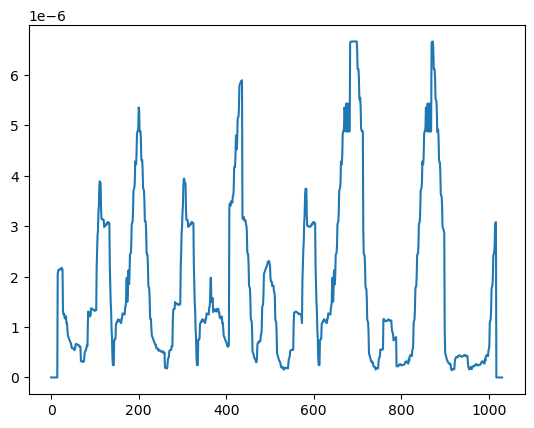

 39%|███████████████▊                         | 116/300 [01:19<02:02,  1.50it/s]

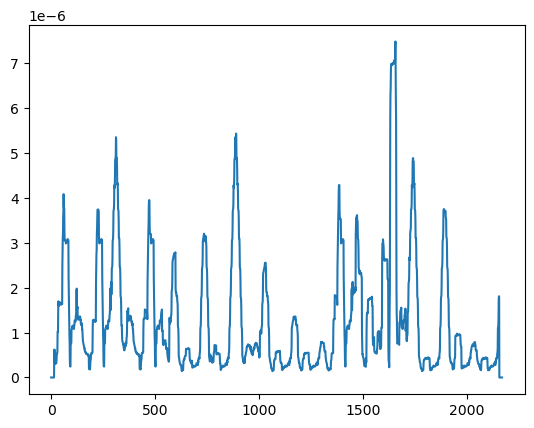

 39%|███████████████▉                         | 117/300 [01:20<01:51,  1.64it/s]

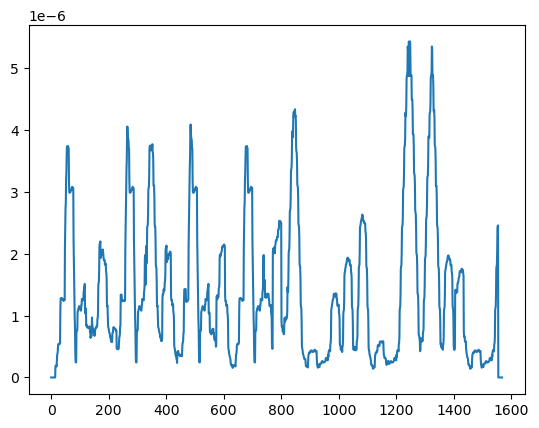

 39%|████████████████▏                        | 118/300 [01:20<01:38,  1.85it/s]

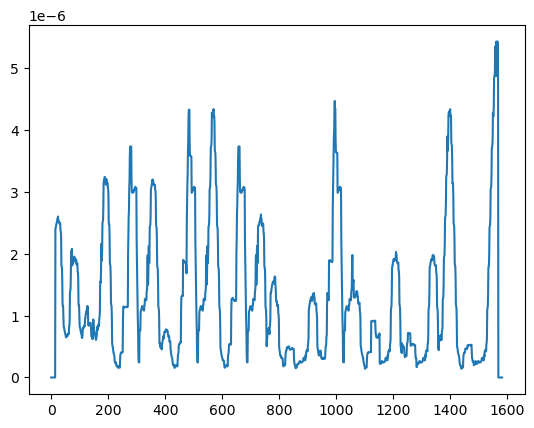

 40%|████████████████▎                        | 119/300 [01:21<01:28,  2.04it/s]

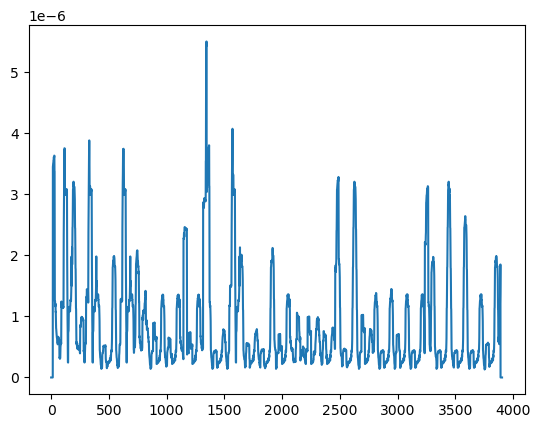

 40%|████████████████▍                        | 120/300 [01:21<01:43,  1.73it/s]

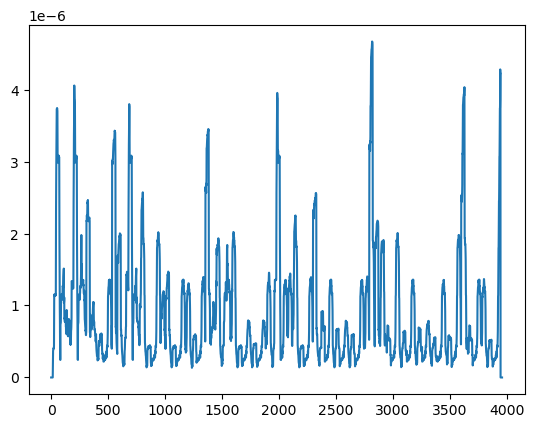

 40%|████████████████▌                        | 121/300 [01:22<01:55,  1.55it/s]

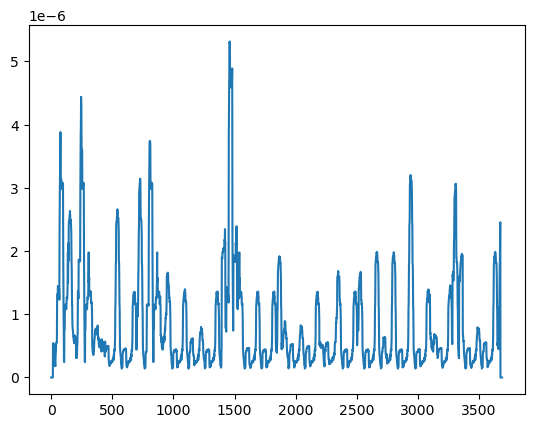

 41%|████████████████▋                        | 122/300 [01:23<01:59,  1.49it/s]

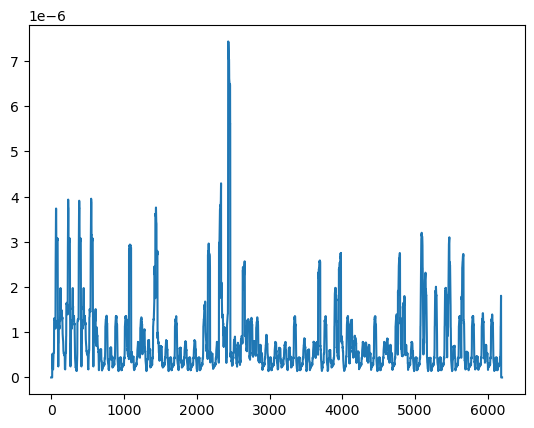

 41%|████████████████▊                        | 123/300 [01:24<02:29,  1.18it/s]

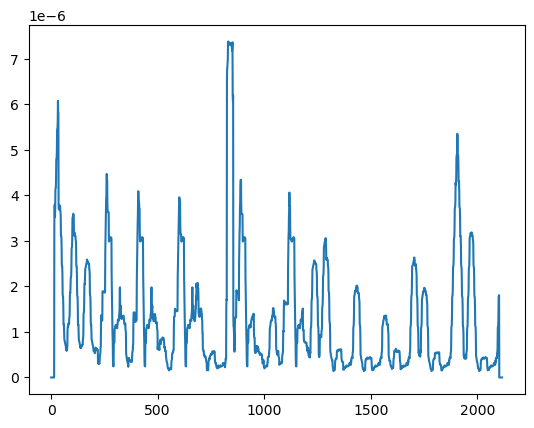

 41%|████████████████▉                        | 124/300 [01:25<02:08,  1.36it/s]

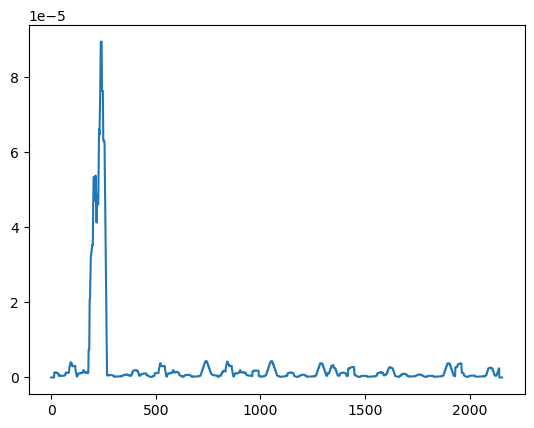

 42%|█████████████████                        | 125/300 [01:25<01:54,  1.53it/s]

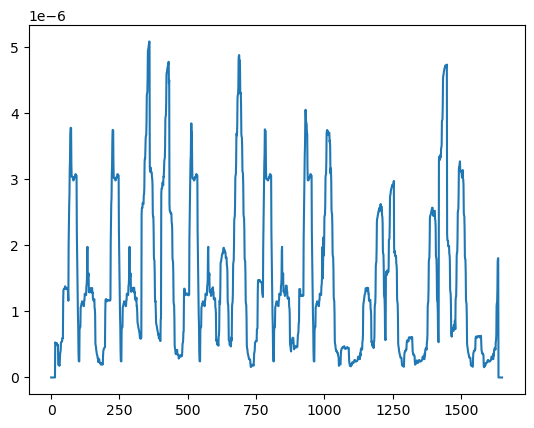

 42%|█████████████████▏                       | 126/300 [01:26<01:44,  1.67it/s]

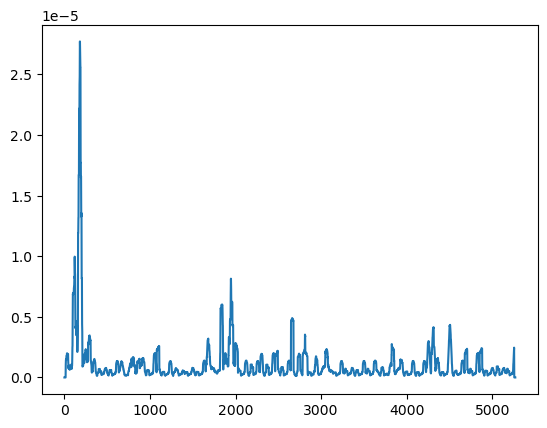

 42%|█████████████████▎                       | 127/300 [01:27<02:06,  1.37it/s]

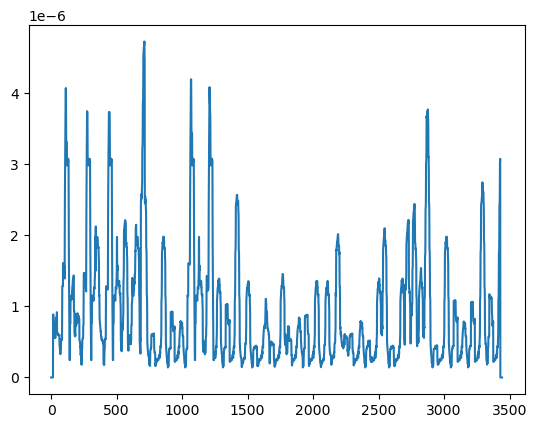

 43%|█████████████████▍                       | 128/300 [01:27<02:03,  1.40it/s]

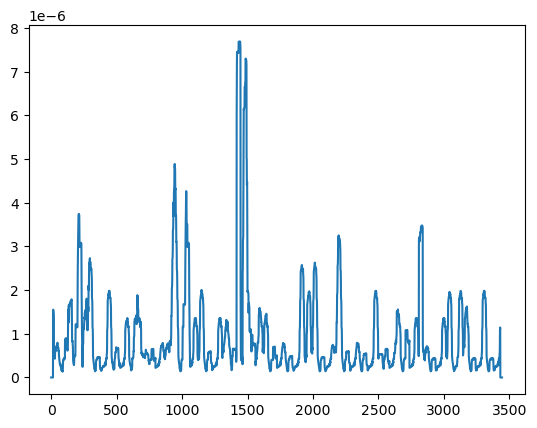

 43%|█████████████████▋                       | 129/300 [01:28<02:01,  1.41it/s]

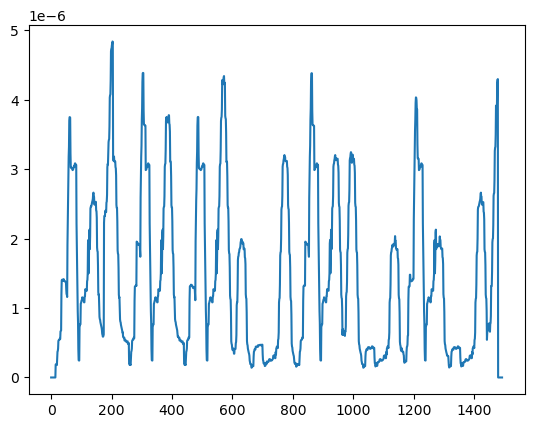

 43%|█████████████████▊                       | 130/300 [01:28<01:42,  1.66it/s]

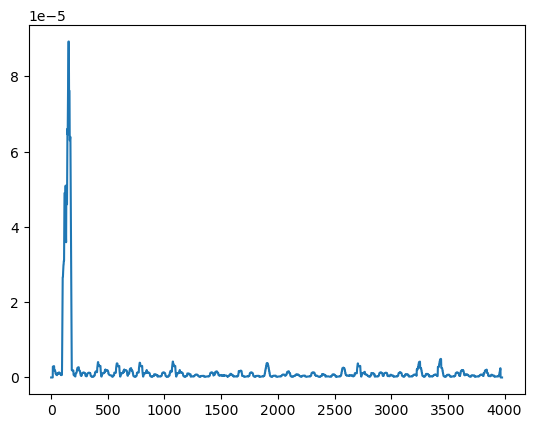

 44%|█████████████████▉                       | 131/300 [01:29<01:51,  1.52it/s]

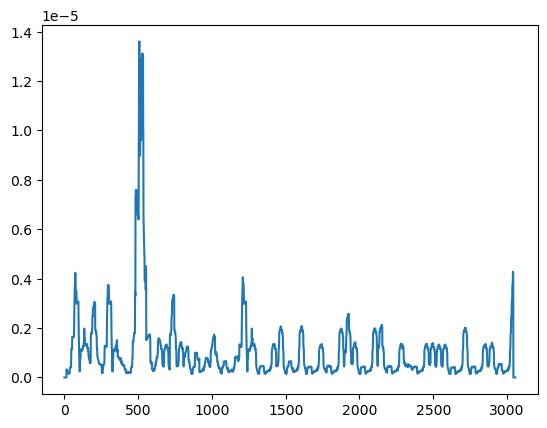

 44%|██████████████████                       | 132/300 [01:30<01:48,  1.54it/s]

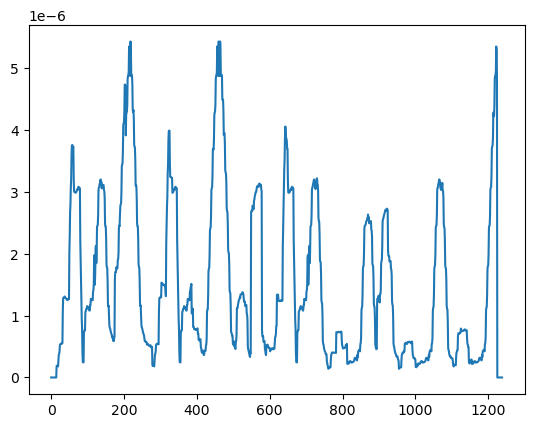

 44%|██████████████████▏                      | 133/300 [01:30<01:31,  1.83it/s]

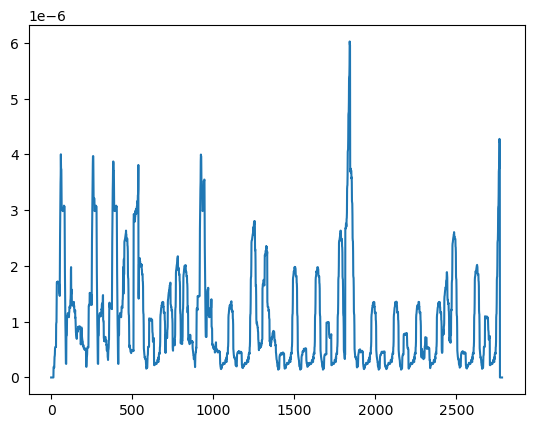

 45%|██████████████████▎                      | 134/300 [01:31<01:32,  1.80it/s]

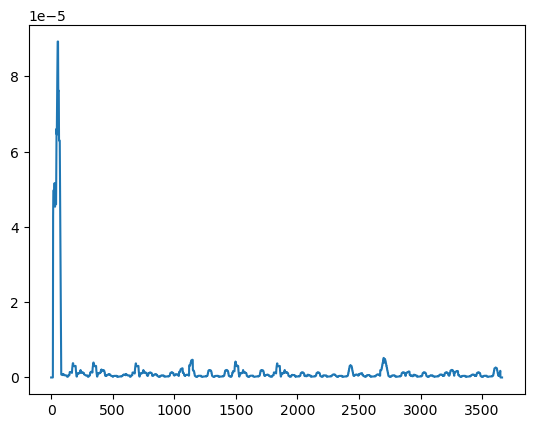

 45%|██████████████████▍                      | 135/300 [01:31<01:40,  1.65it/s]

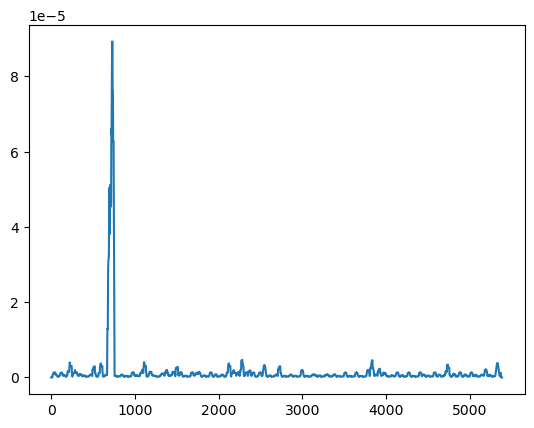

 45%|██████████████████▌                      | 136/300 [01:32<02:02,  1.34it/s]

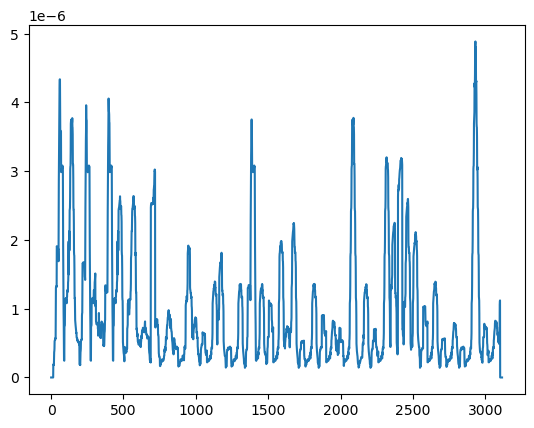

 46%|██████████████████▋                      | 137/300 [01:33<01:56,  1.40it/s]

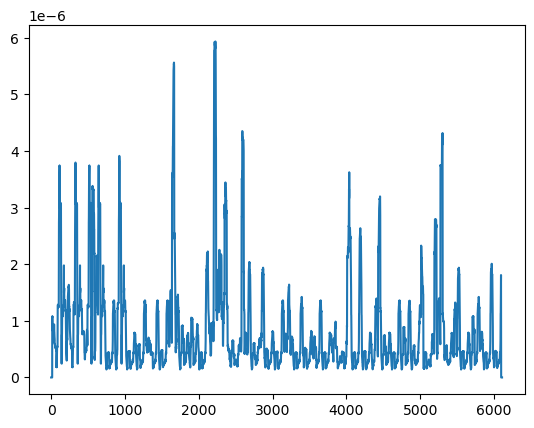

 46%|██████████████████▊                      | 138/300 [01:34<02:17,  1.18it/s]

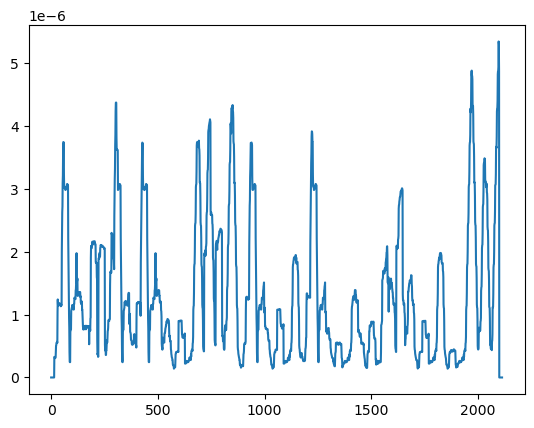

 46%|██████████████████▉                      | 139/300 [01:35<01:58,  1.36it/s]

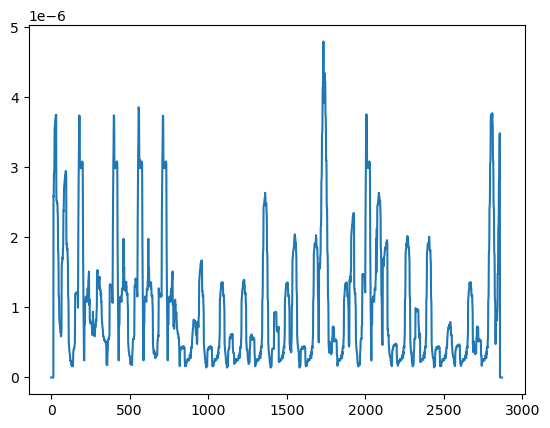

 47%|███████████████████▏                     | 140/300 [01:35<01:50,  1.44it/s]

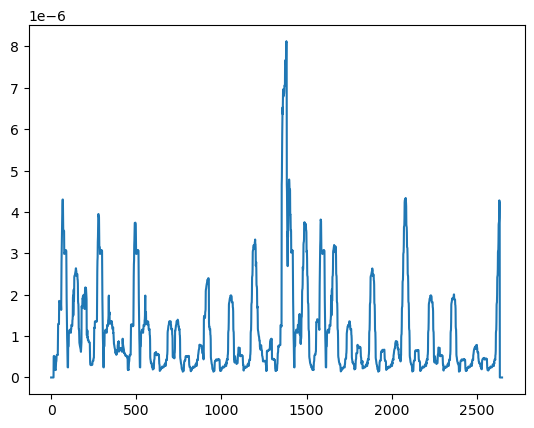

 47%|███████████████████▎                     | 141/300 [01:36<01:44,  1.52it/s]

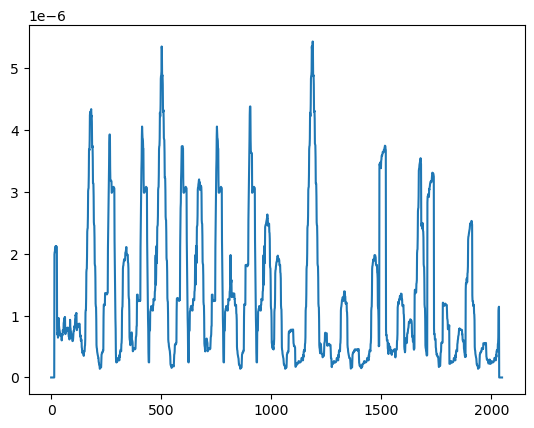

 47%|███████████████████▍                     | 142/300 [01:36<01:35,  1.66it/s]

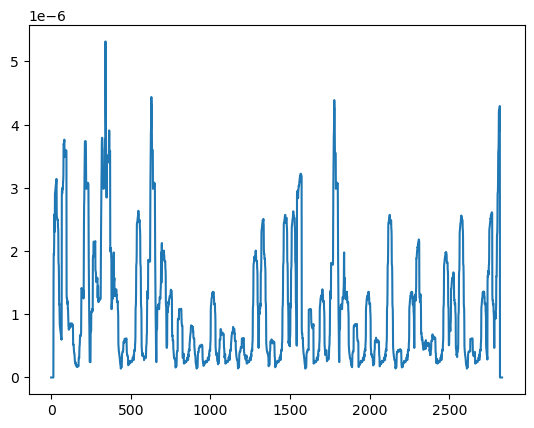

 48%|███████████████████▌                     | 143/300 [01:37<01:33,  1.67it/s]

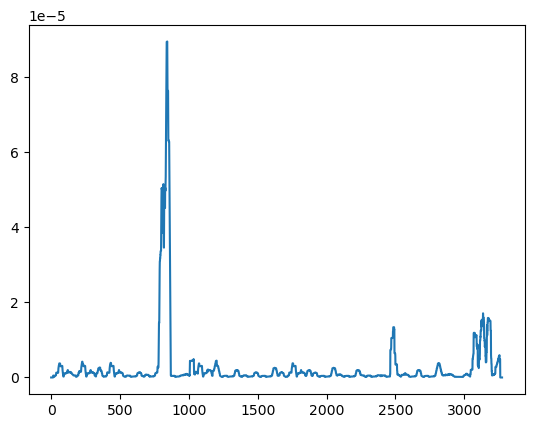

 48%|███████████████████▋                     | 144/300 [01:38<01:37,  1.60it/s]

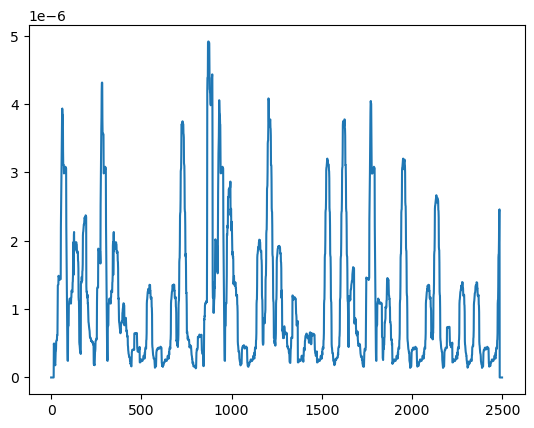

 48%|███████████████████▊                     | 145/300 [01:38<01:33,  1.66it/s]

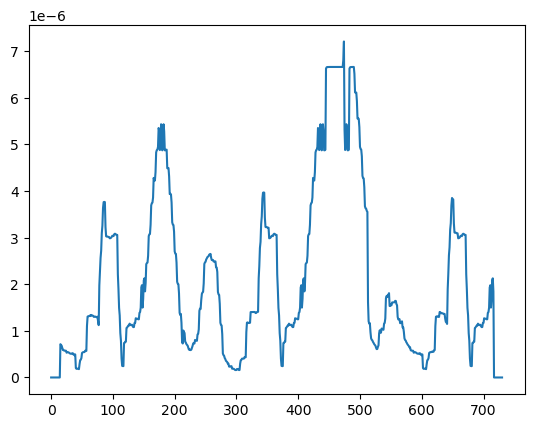

 49%|███████████████████▉                     | 146/300 [01:38<01:15,  2.03it/s]

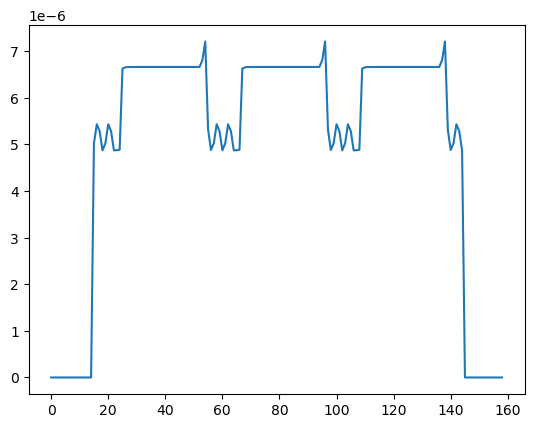

 49%|████████████████████                     | 147/300 [01:39<00:58,  2.60it/s]

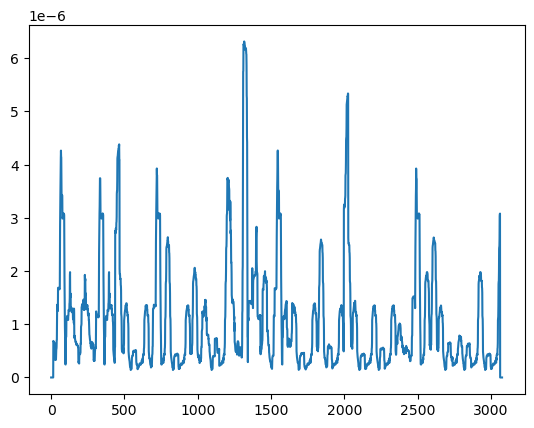

 49%|████████████████████▏                    | 148/300 [01:39<01:09,  2.19it/s]

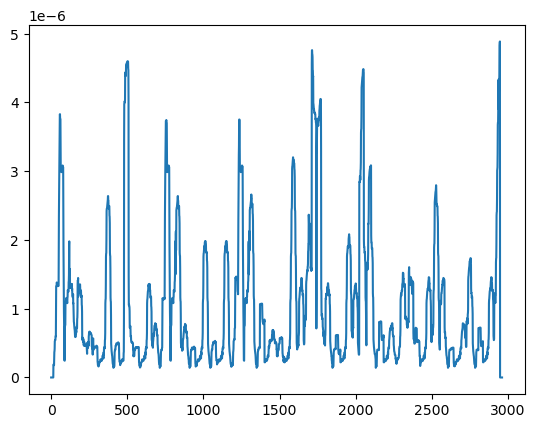

 50%|████████████████████▎                    | 149/300 [01:40<01:16,  1.97it/s]

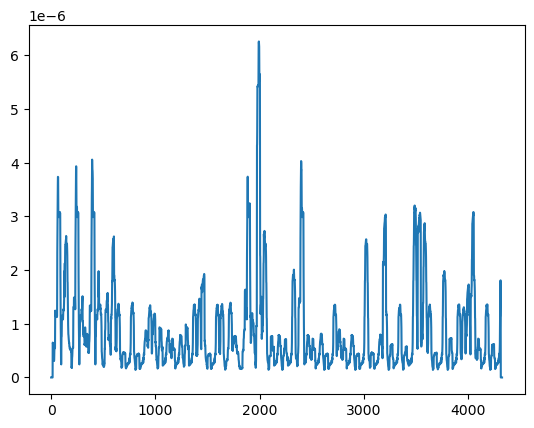

 50%|████████████████████▌                    | 150/300 [01:41<01:31,  1.64it/s]

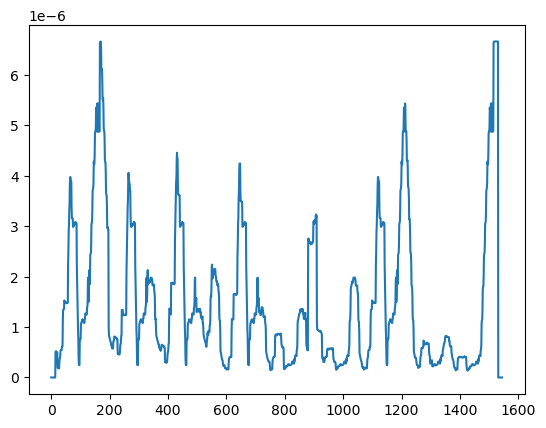

 50%|████████████████████▋                    | 151/300 [01:41<01:24,  1.76it/s]

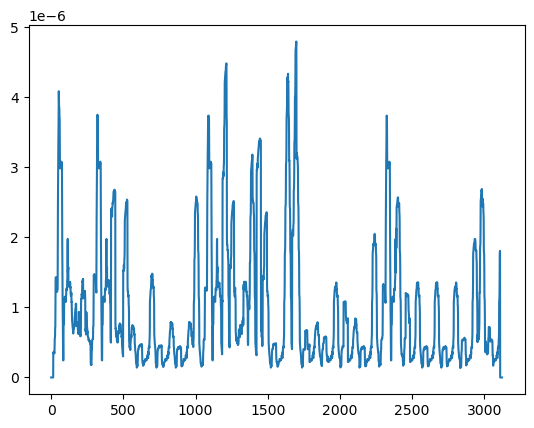

 51%|████████████████████▊                    | 152/300 [01:42<01:27,  1.69it/s]

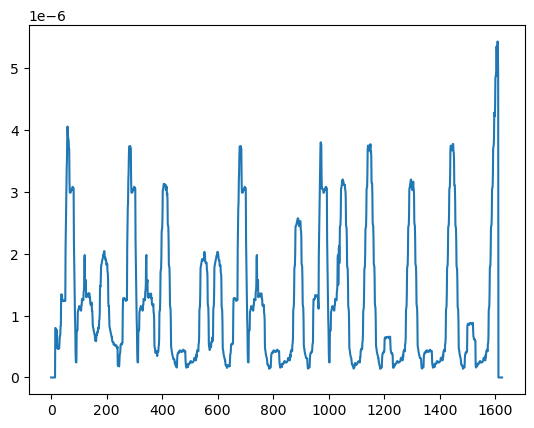

 51%|████████████████████▉                    | 153/300 [01:42<01:17,  1.89it/s]

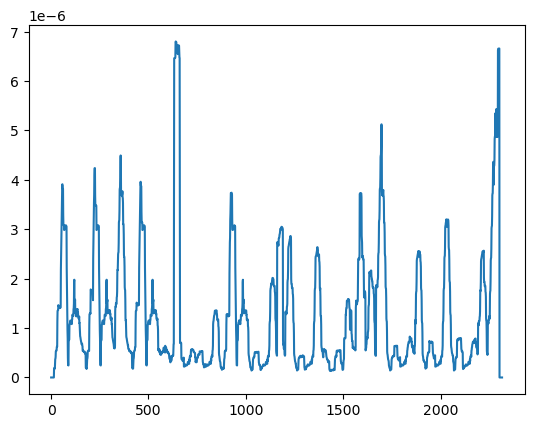

 51%|█████████████████████                    | 154/300 [01:43<01:16,  1.92it/s]

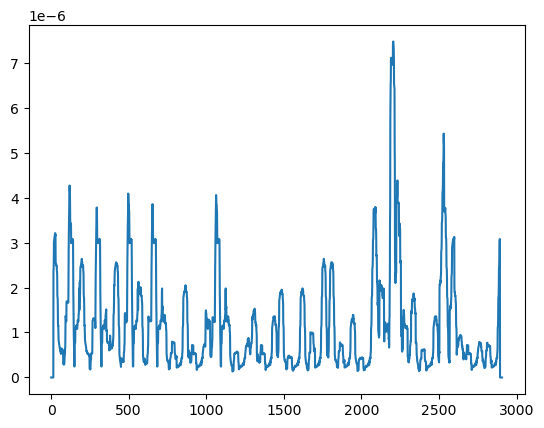

 52%|█████████████████████▏                   | 155/300 [01:43<01:18,  1.84it/s]

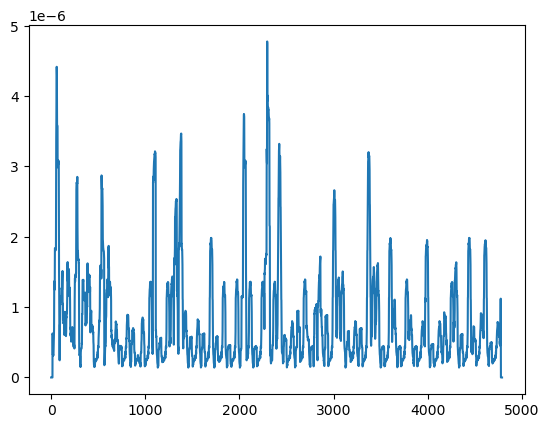

 52%|█████████████████████▎                   | 156/300 [01:44<01:35,  1.50it/s]

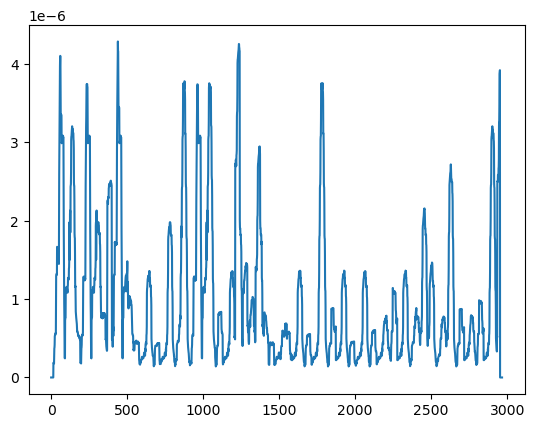

 52%|█████████████████████▍                   | 157/300 [01:45<01:32,  1.54it/s]

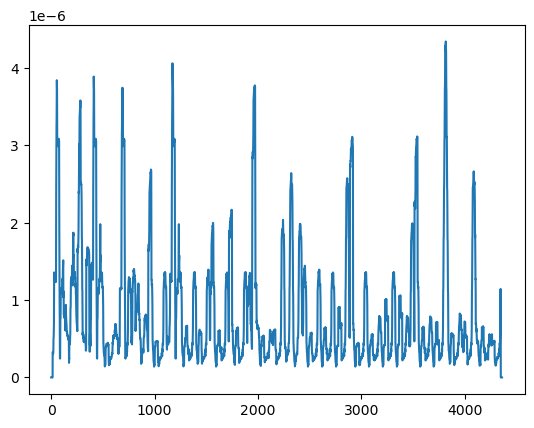

 53%|█████████████████████▌                   | 158/300 [01:46<01:40,  1.41it/s]

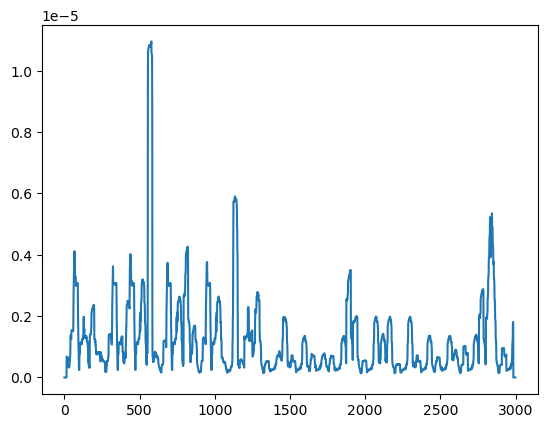

 53%|█████████████████████▋                   | 159/300 [01:46<01:35,  1.47it/s]

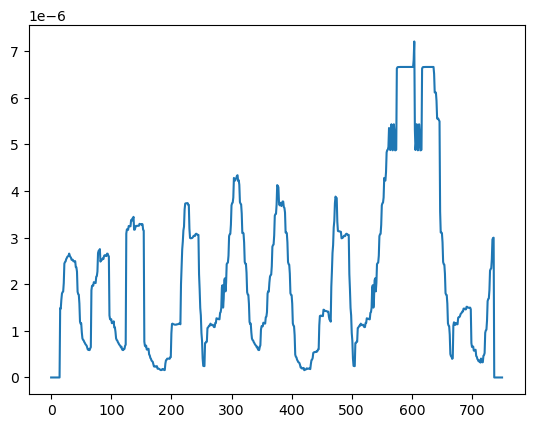

 53%|█████████████████████▊                   | 160/300 [01:46<01:16,  1.84it/s]

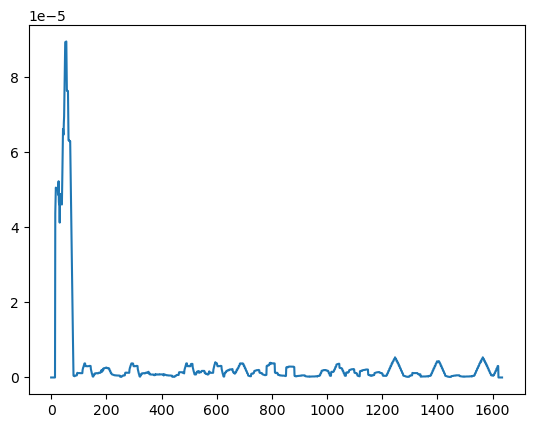

 54%|██████████████████████                   | 161/300 [01:47<01:08,  2.03it/s]

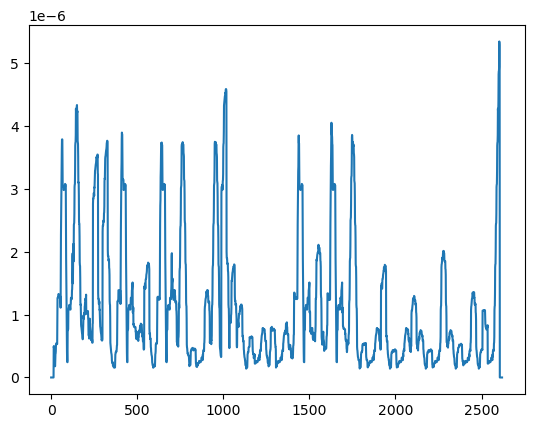

 54%|██████████████████████▏                  | 162/300 [01:47<01:11,  1.94it/s]

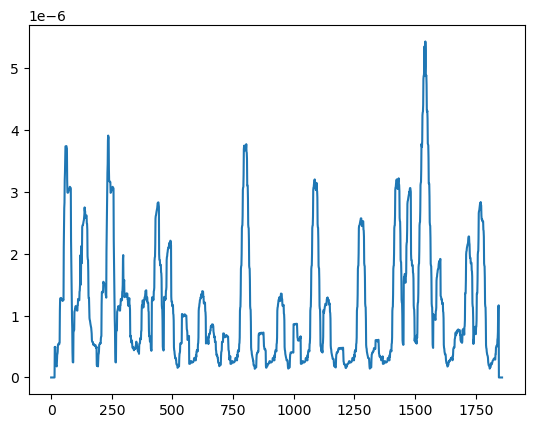

 54%|██████████████████████▎                  | 163/300 [01:48<01:06,  2.05it/s]

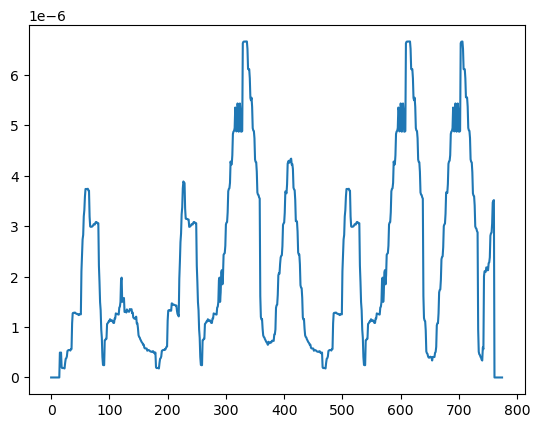

 55%|██████████████████████▍                  | 164/300 [01:48<00:56,  2.40it/s]

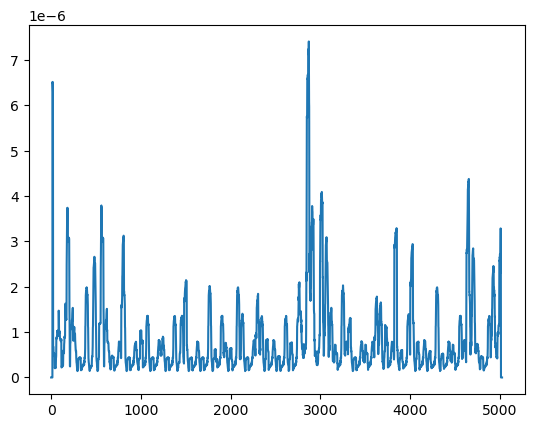

 55%|██████████████████████▌                  | 165/300 [01:49<01:20,  1.69it/s]

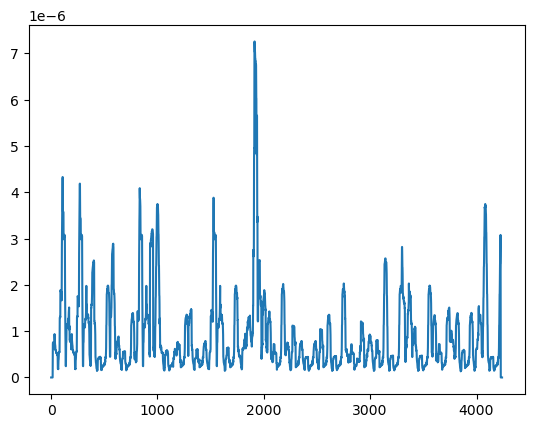

 55%|██████████████████████▋                  | 166/300 [01:50<01:29,  1.50it/s]

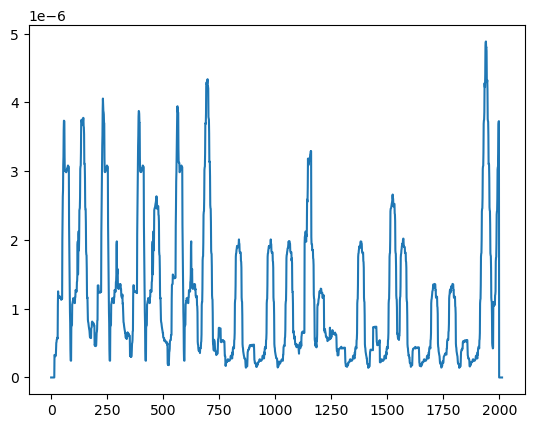

 56%|██████████████████████▊                  | 167/300 [01:50<01:20,  1.66it/s]

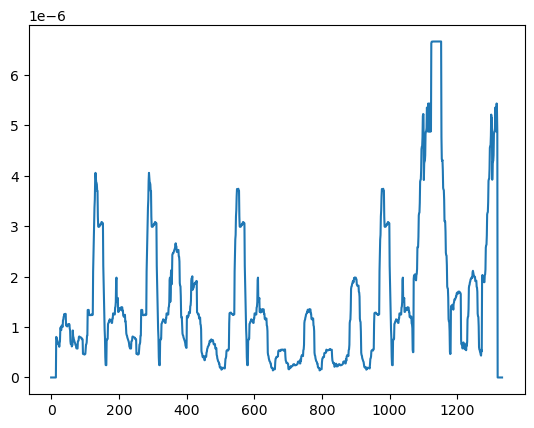

 56%|██████████████████████▉                  | 168/300 [01:51<01:08,  1.92it/s]

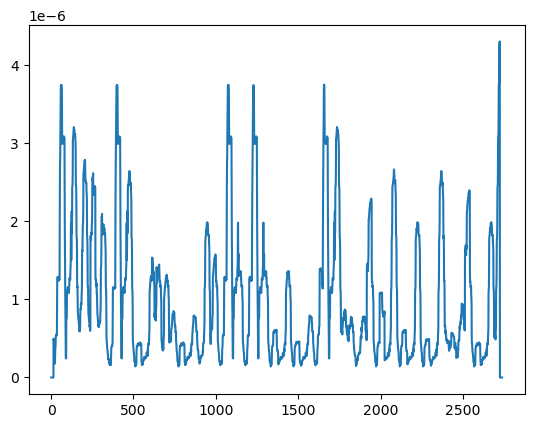

 56%|███████████████████████                  | 169/300 [01:51<01:11,  1.84it/s]

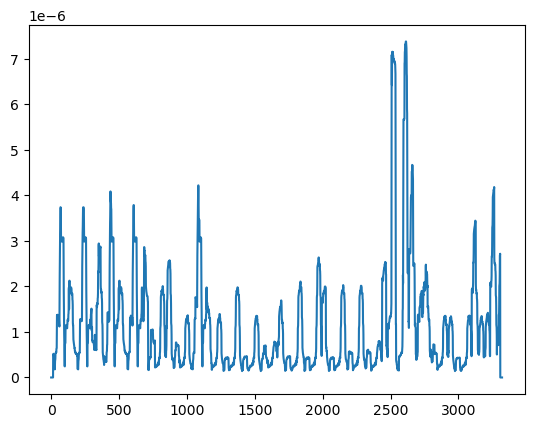

 57%|███████████████████████▏                 | 170/300 [01:52<01:17,  1.68it/s]

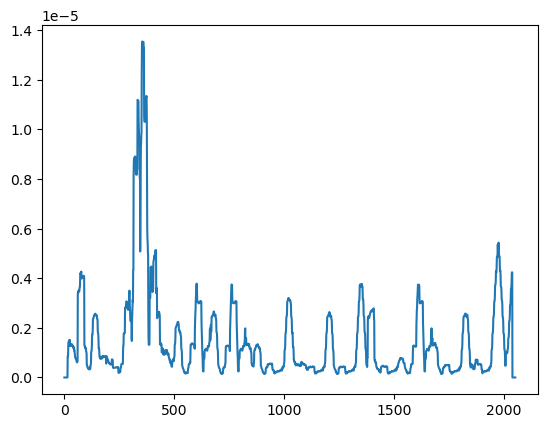

 57%|███████████████████████▎                 | 171/300 [01:53<01:12,  1.79it/s]

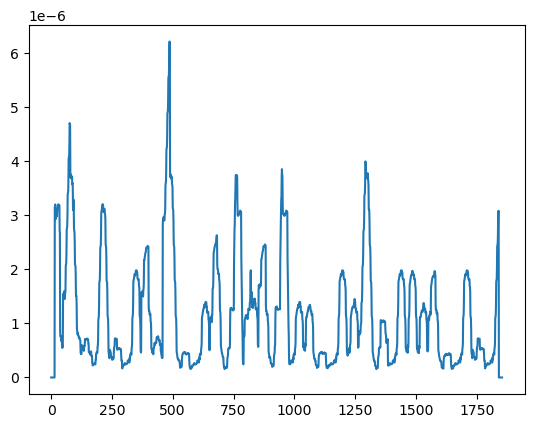

 57%|███████████████████████▌                 | 172/300 [01:53<01:06,  1.93it/s]

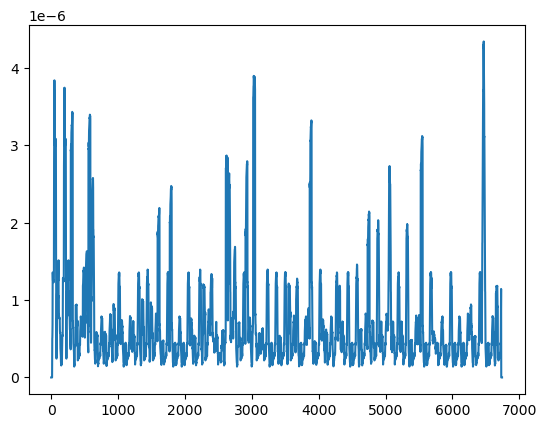

 58%|███████████████████████▋                 | 173/300 [01:54<01:35,  1.32it/s]

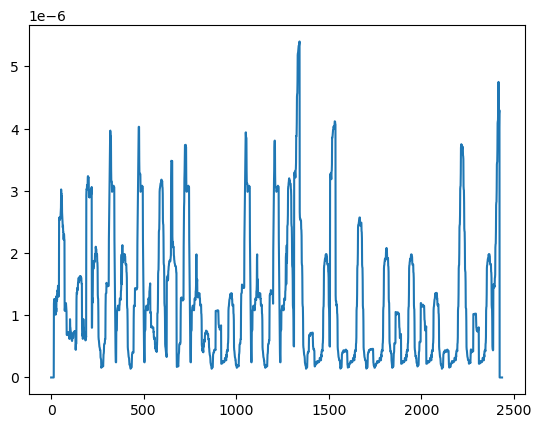

 58%|███████████████████████▊                 | 174/300 [01:55<01:26,  1.46it/s]

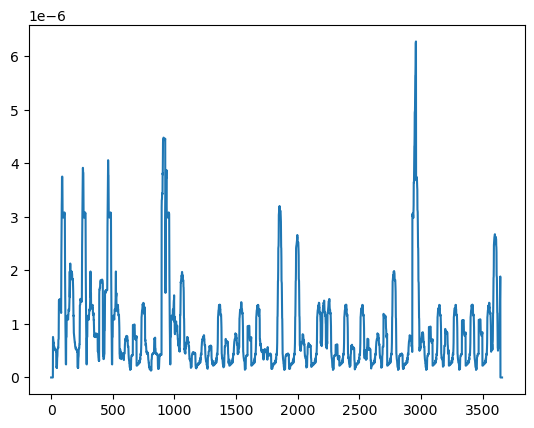

 58%|███████████████████████▉                 | 175/300 [01:55<01:26,  1.44it/s]

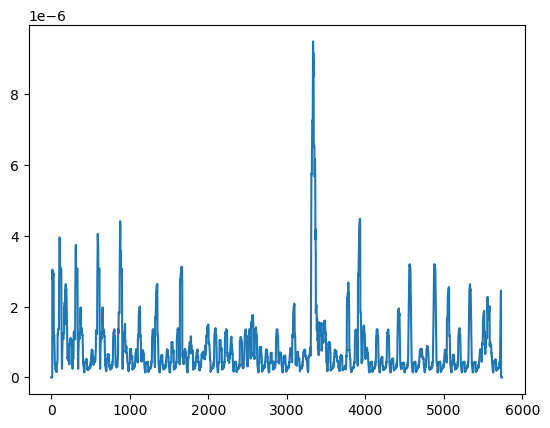

 59%|████████████████████████                 | 176/300 [01:57<01:41,  1.23it/s]

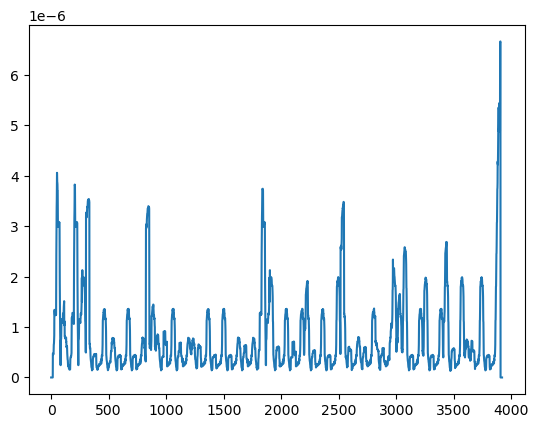

 59%|████████████████████████▏                | 177/300 [01:57<01:42,  1.20it/s]

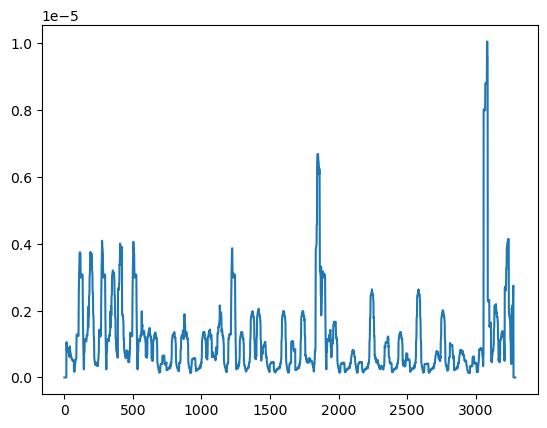

 59%|████████████████████████▎                | 178/300 [01:58<01:36,  1.27it/s]

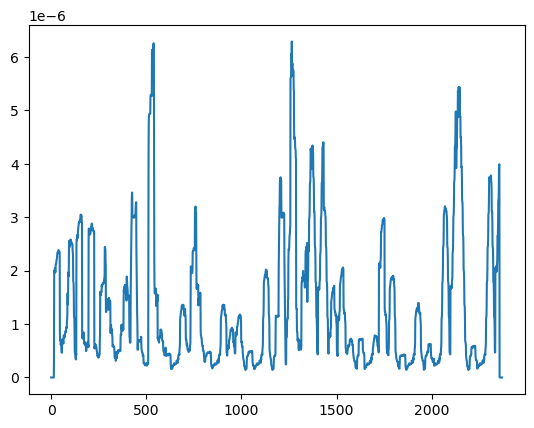

 60%|████████████████████████▍                | 179/300 [01:59<01:28,  1.36it/s]

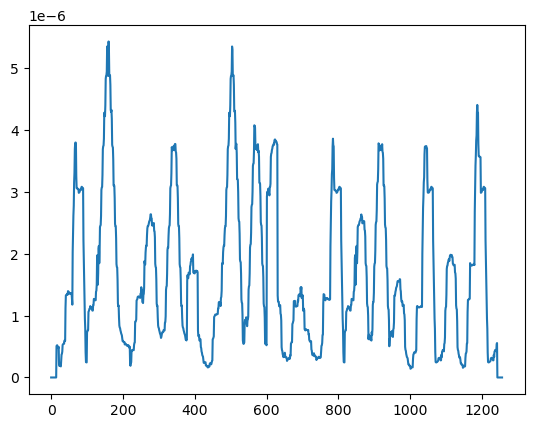

 60%|████████████████████████▌                | 180/300 [01:59<01:13,  1.64it/s]

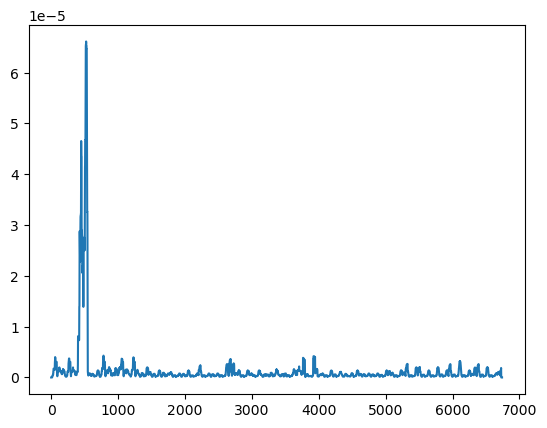

 60%|████████████████████████▋                | 181/300 [02:00<01:35,  1.25it/s]

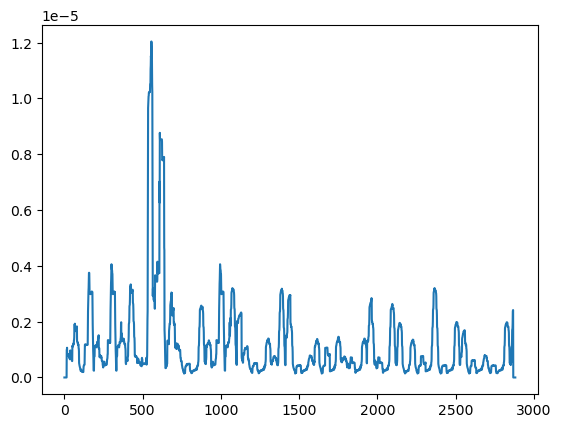

 61%|████████████████████████▊                | 182/300 [02:01<01:29,  1.32it/s]

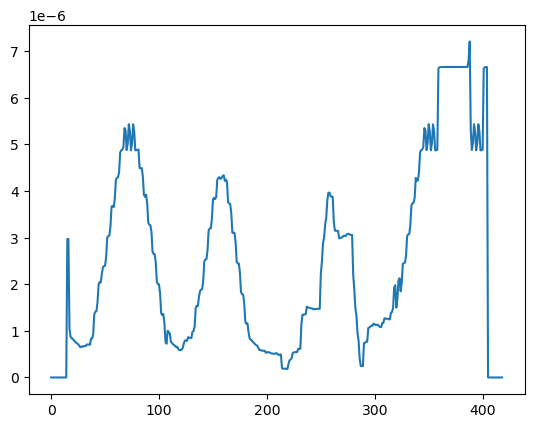

 61%|█████████████████████████                | 183/300 [02:01<01:08,  1.72it/s]

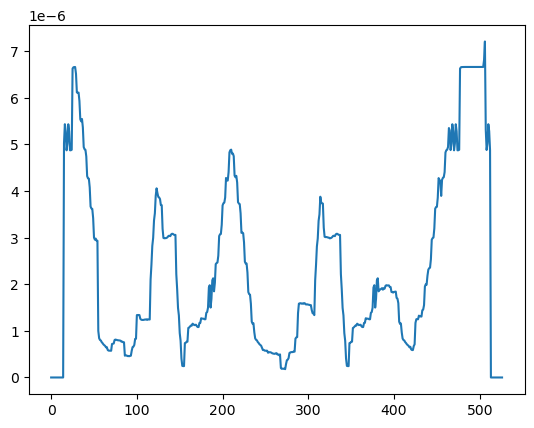

 61%|█████████████████████████▏               | 184/300 [02:01<00:53,  2.16it/s]

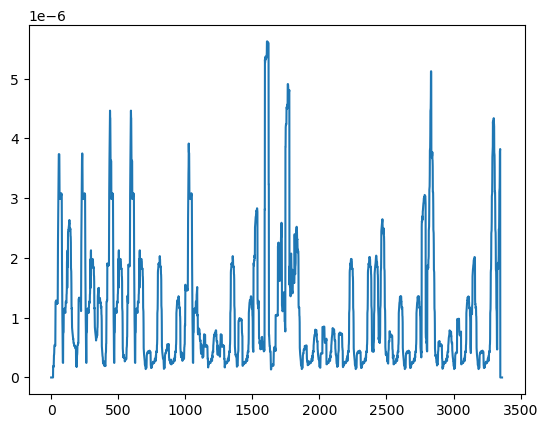

 62%|█████████████████████████▎               | 185/300 [02:02<01:00,  1.89it/s]

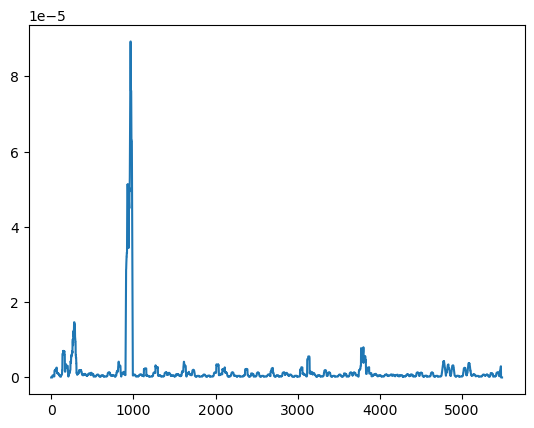

 62%|█████████████████████████▍               | 186/300 [02:03<01:18,  1.46it/s]

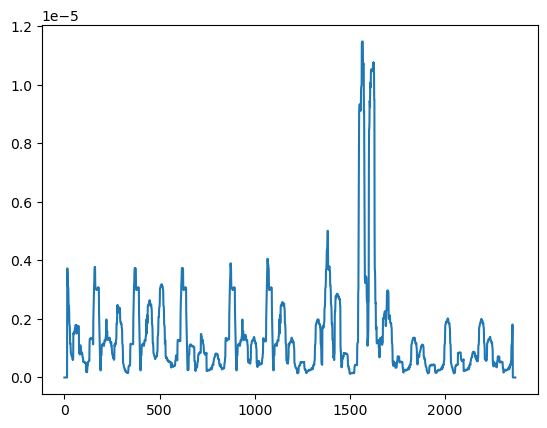

 62%|█████████████████████████▌               | 187/300 [02:04<01:11,  1.59it/s]

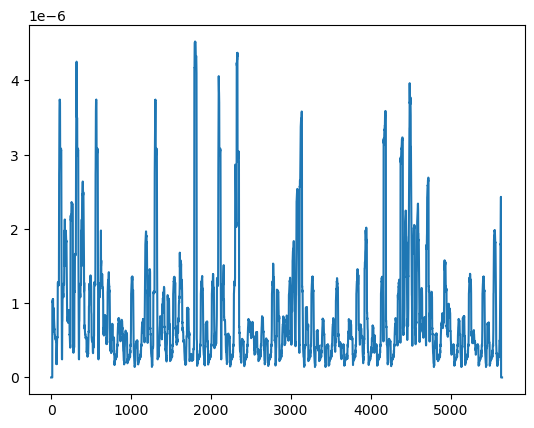

 63%|█████████████████████████▋               | 188/300 [02:05<01:27,  1.27it/s]

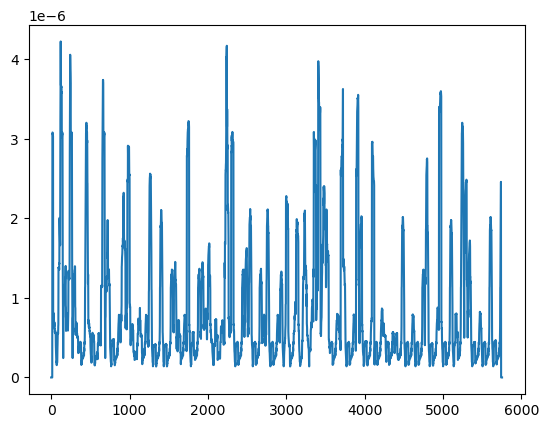

 63%|█████████████████████████▊               | 189/300 [02:06<01:37,  1.14it/s]

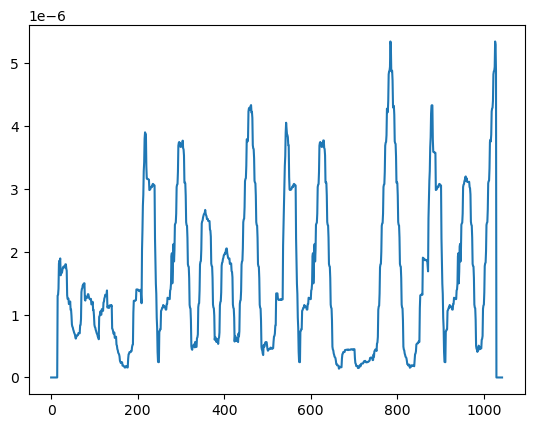

 63%|█████████████████████████▉               | 190/300 [02:06<01:16,  1.43it/s]

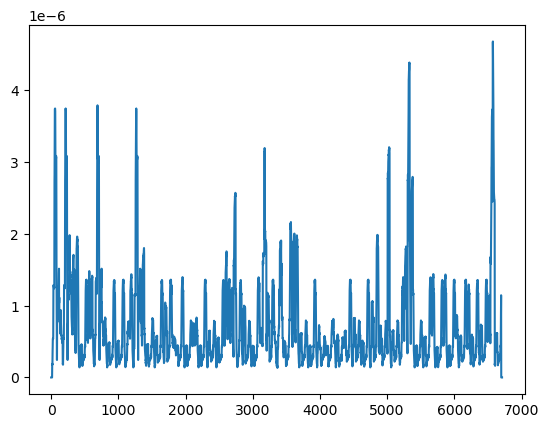

 64%|██████████████████████████               | 191/300 [02:07<01:34,  1.15it/s]

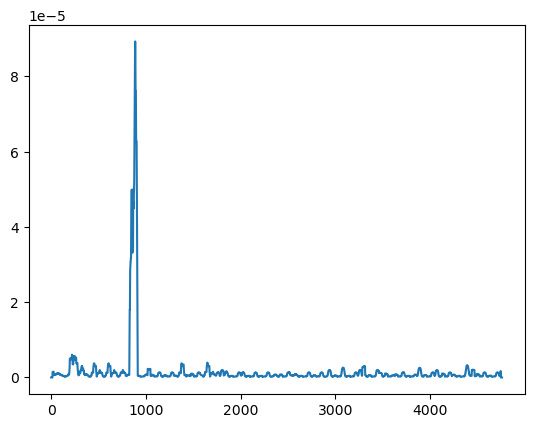

 64%|██████████████████████████▏              | 192/300 [02:08<01:35,  1.13it/s]

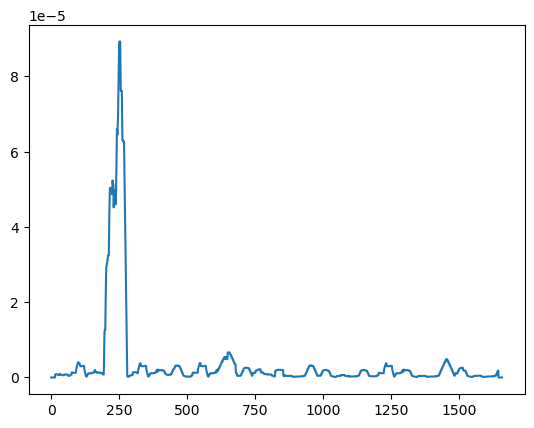

 64%|██████████████████████████▍              | 193/300 [02:09<01:18,  1.37it/s]

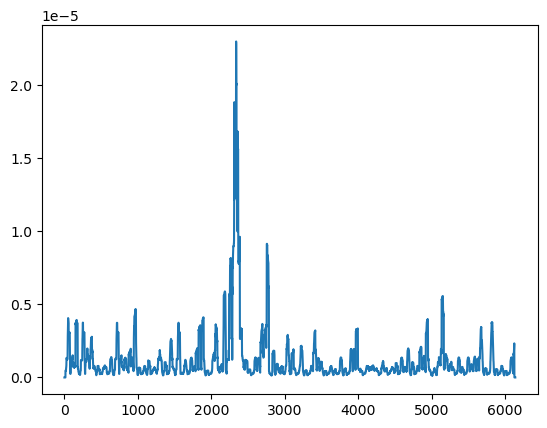

 65%|██████████████████████████▌              | 194/300 [02:10<01:32,  1.15it/s]

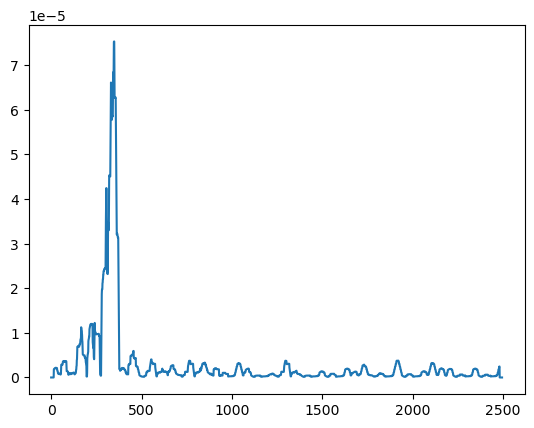

 65%|██████████████████████████▋              | 195/300 [02:10<01:22,  1.27it/s]

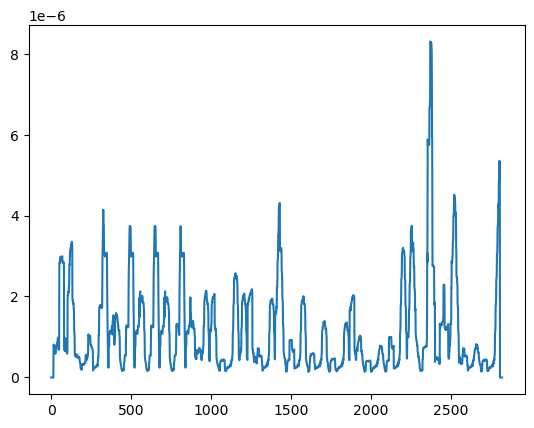

 65%|██████████████████████████▊              | 196/300 [02:11<01:15,  1.38it/s]

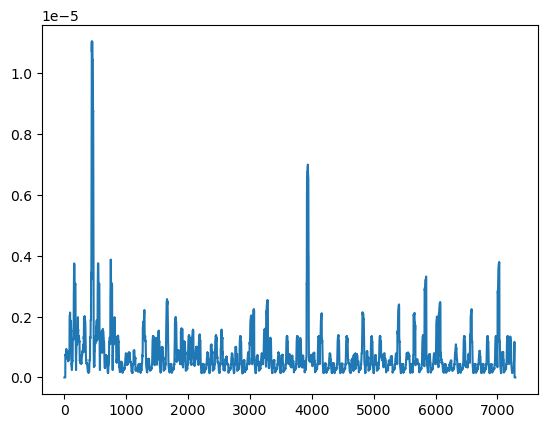

 66%|██████████████████████████▉              | 197/300 [02:12<01:35,  1.08it/s]

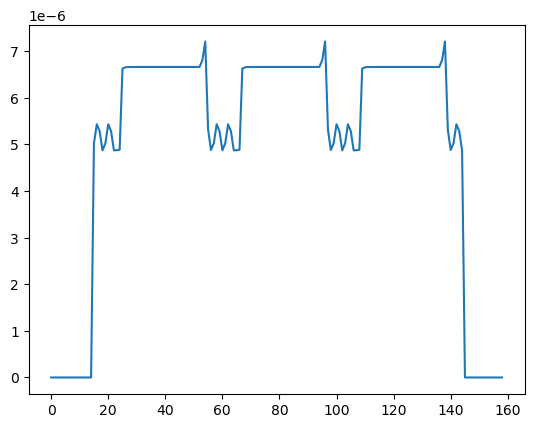

 66%|███████████████████████████              | 198/300 [02:13<01:09,  1.47it/s]

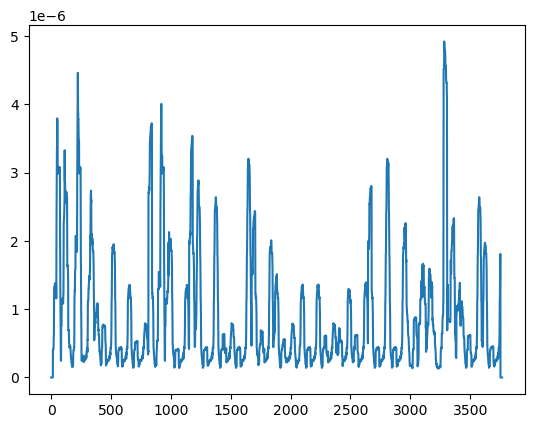

 66%|███████████████████████████▏             | 199/300 [02:13<01:11,  1.42it/s]

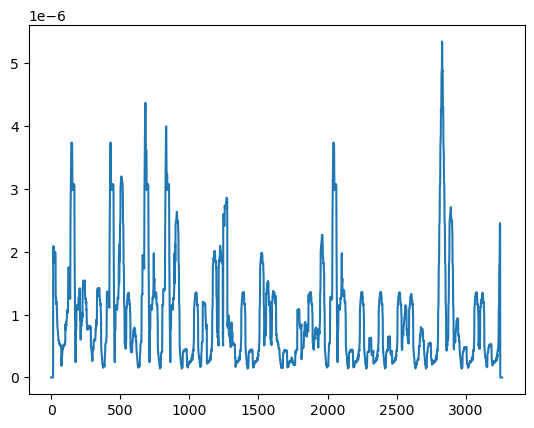

 67%|███████████████████████████▎             | 200/300 [02:14<01:09,  1.44it/s]

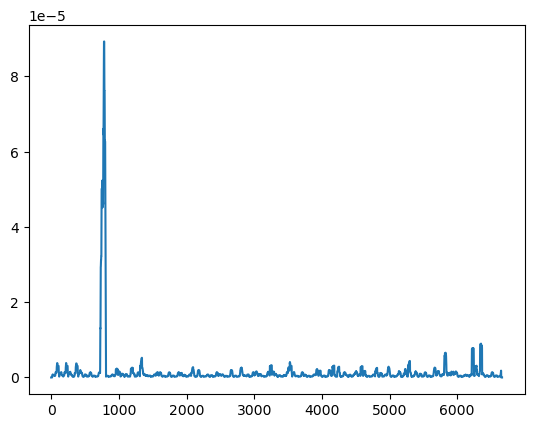

 67%|███████████████████████████▍             | 201/300 [02:15<01:25,  1.16it/s]

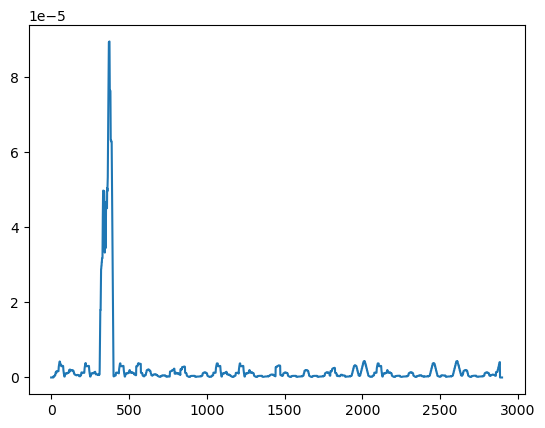

 67%|███████████████████████████▌             | 202/300 [02:16<01:16,  1.28it/s]

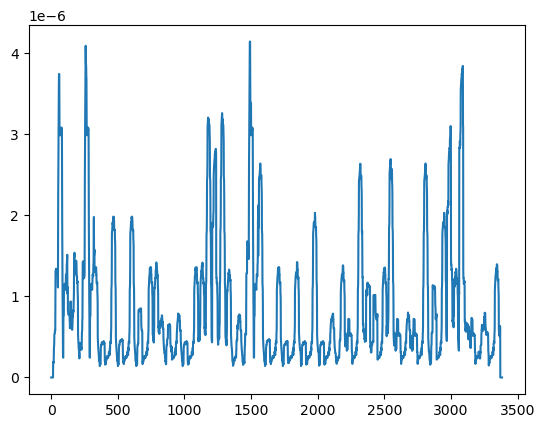

 68%|███████████████████████████▋             | 203/300 [02:17<01:15,  1.29it/s]

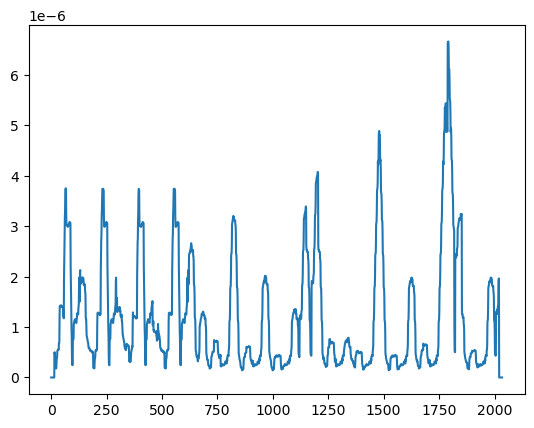

 68%|███████████████████████████▉             | 204/300 [02:17<01:05,  1.48it/s]

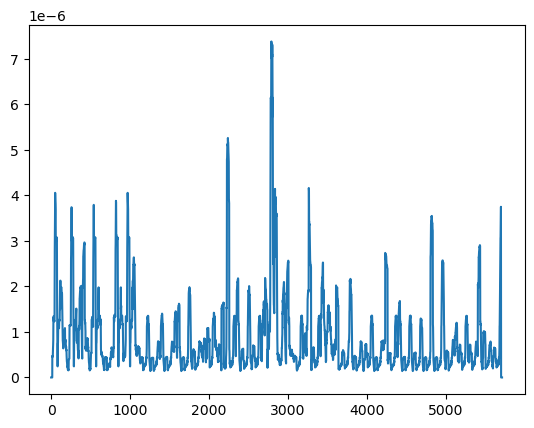

 68%|████████████████████████████             | 205/300 [02:18<01:17,  1.23it/s]

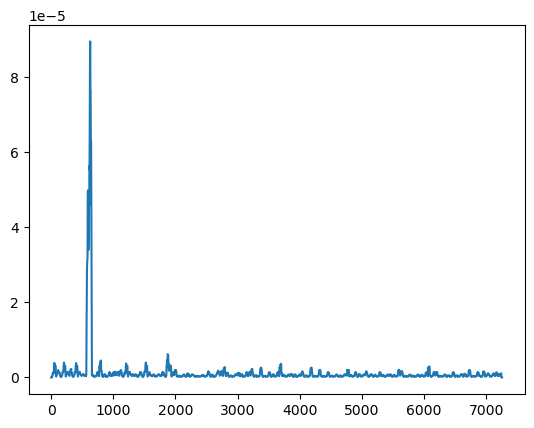

 69%|████████████████████████████▏            | 206/300 [02:19<01:31,  1.02it/s]

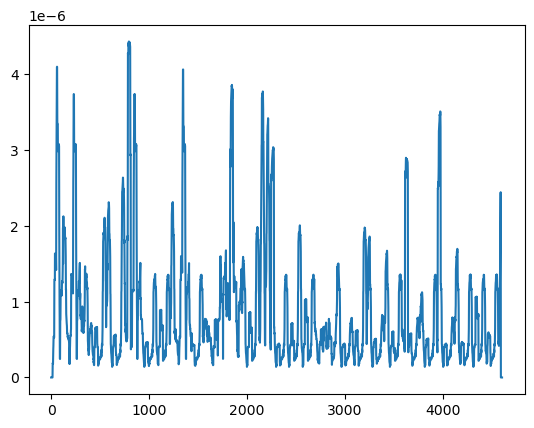

 69%|████████████████████████████▎            | 207/300 [02:20<01:28,  1.05it/s]

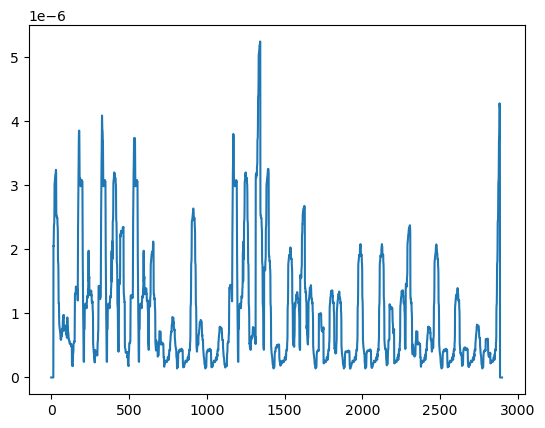

 69%|████████████████████████████▍            | 208/300 [02:21<01:17,  1.19it/s]

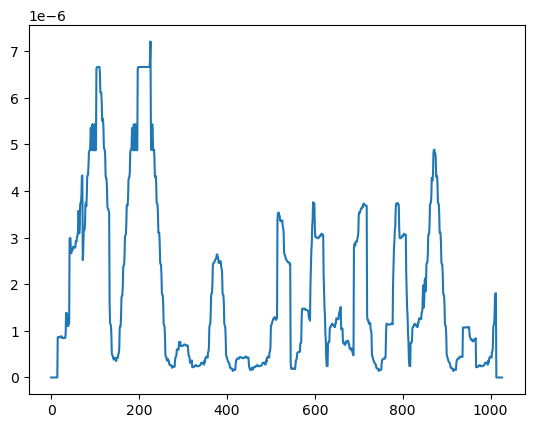

 70%|████████████████████████████▌            | 209/300 [02:21<01:01,  1.47it/s]

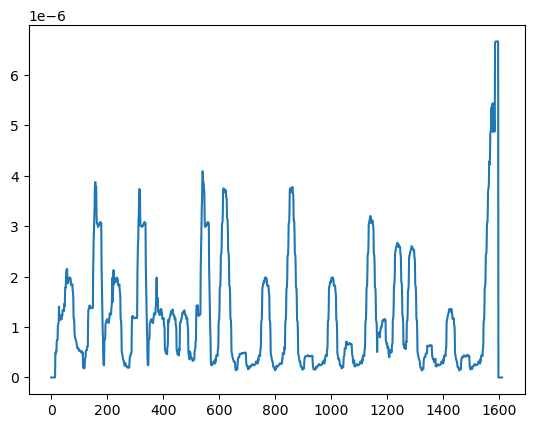

 70%|████████████████████████████▋            | 210/300 [02:22<00:53,  1.69it/s]

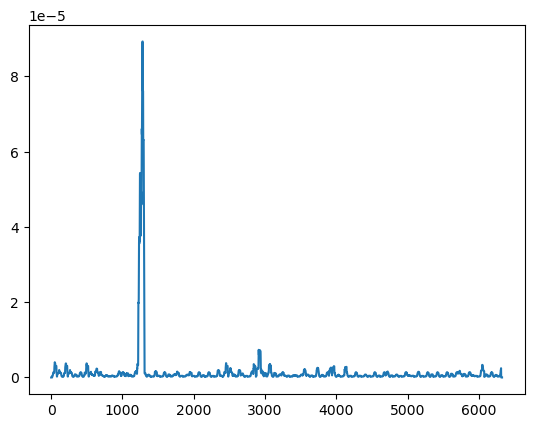

 70%|████████████████████████████▊            | 211/300 [02:23<01:09,  1.28it/s]

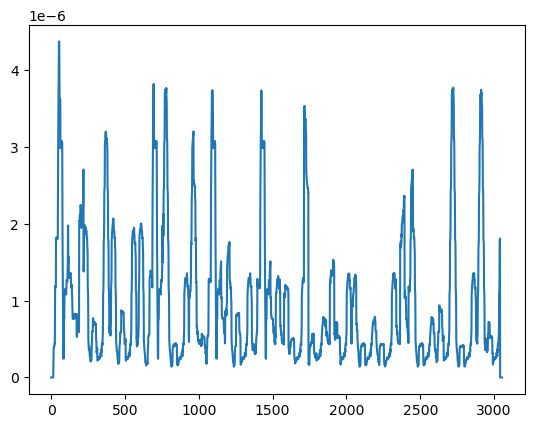

 71%|████████████████████████████▉            | 212/300 [02:24<01:04,  1.36it/s]

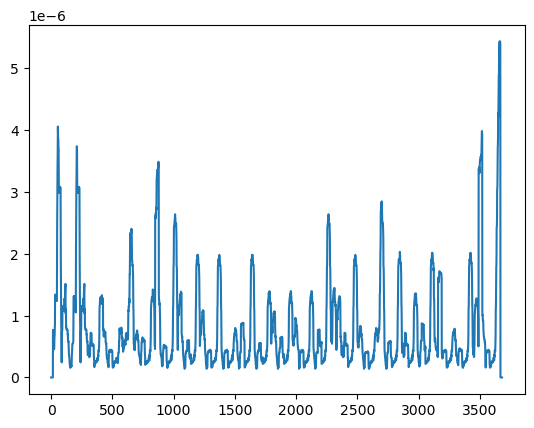

 71%|█████████████████████████████            | 213/300 [02:24<01:04,  1.35it/s]

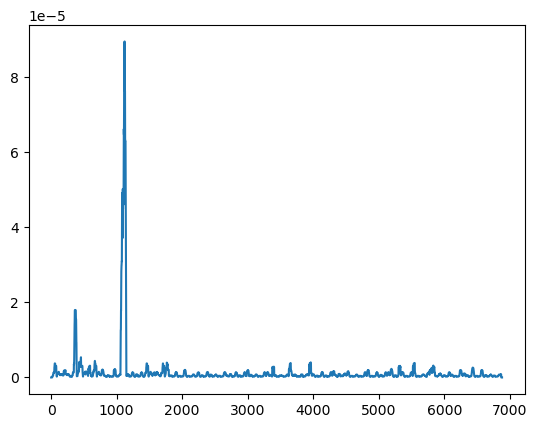

 71%|█████████████████████████████▏           | 214/300 [02:26<01:18,  1.09it/s]

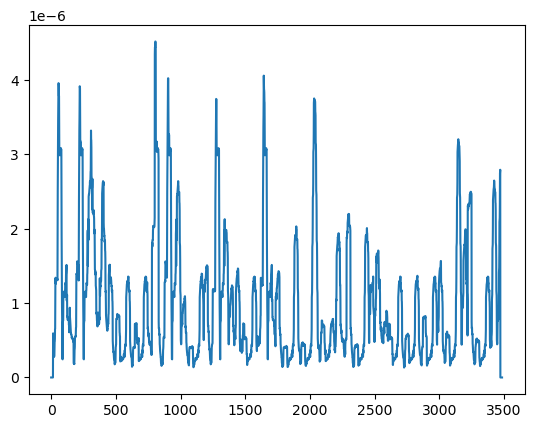

 72%|█████████████████████████████▍           | 215/300 [02:26<01:13,  1.16it/s]

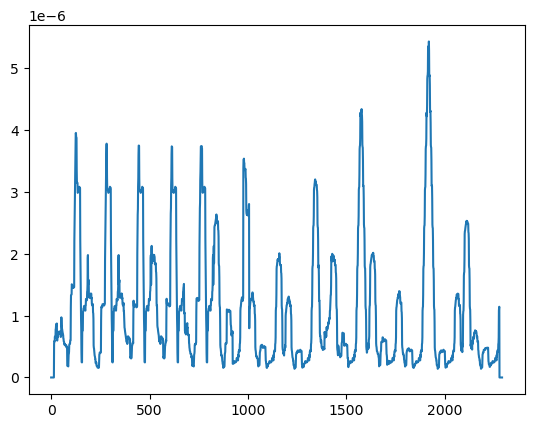

 72%|█████████████████████████████▌           | 216/300 [02:27<01:03,  1.33it/s]

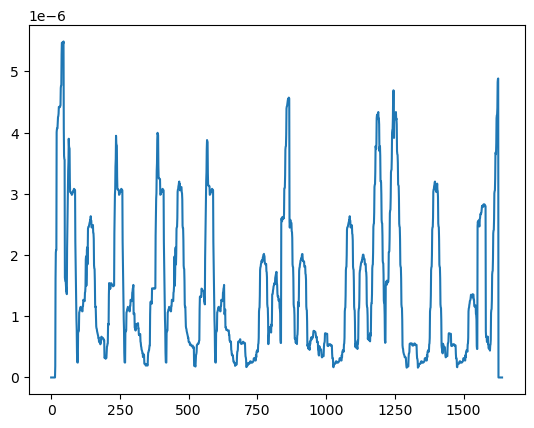

 72%|█████████████████████████████▋           | 217/300 [02:27<00:53,  1.54it/s]

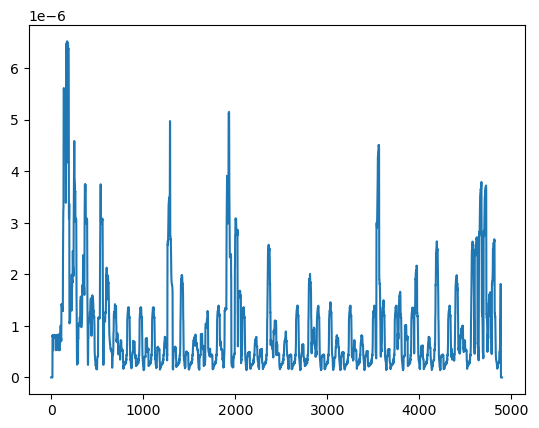

 73%|█████████████████████████████▊           | 218/300 [02:28<01:00,  1.35it/s]

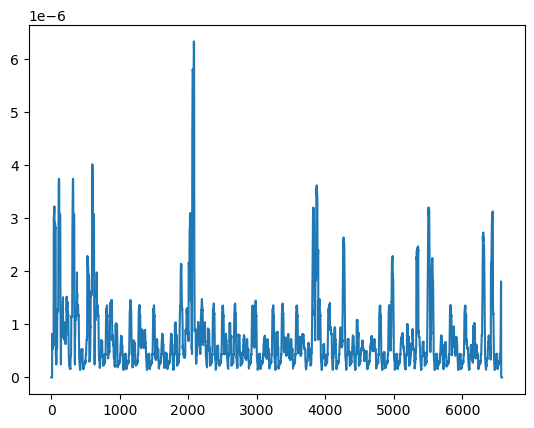

 73%|█████████████████████████████▉           | 219/300 [02:29<01:12,  1.11it/s]

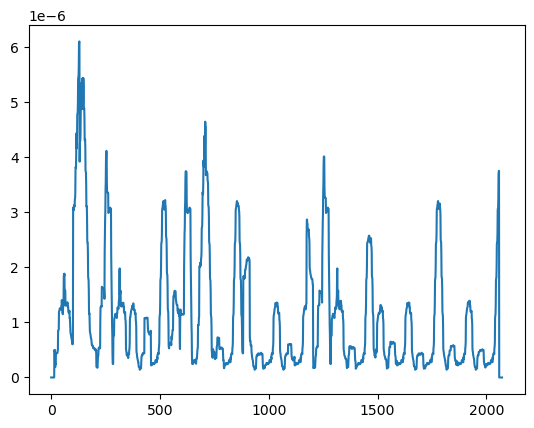

 73%|██████████████████████████████           | 220/300 [02:30<01:01,  1.30it/s]

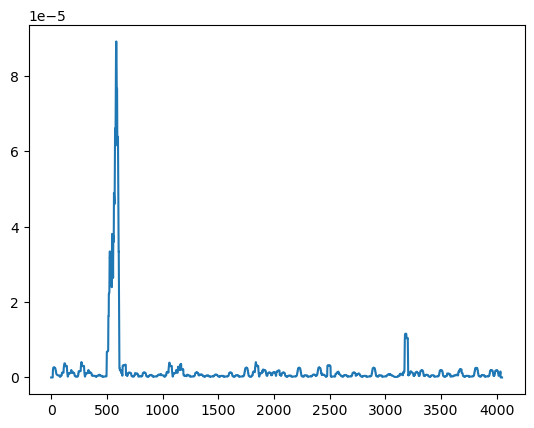

 74%|██████████████████████████████▏          | 221/300 [02:31<01:03,  1.24it/s]

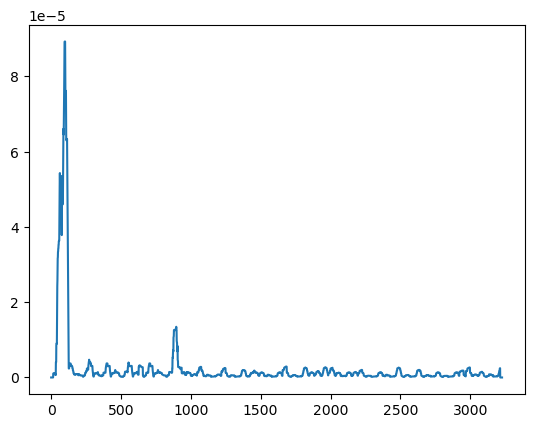

 74%|██████████████████████████████▎          | 222/300 [02:31<00:58,  1.32it/s]

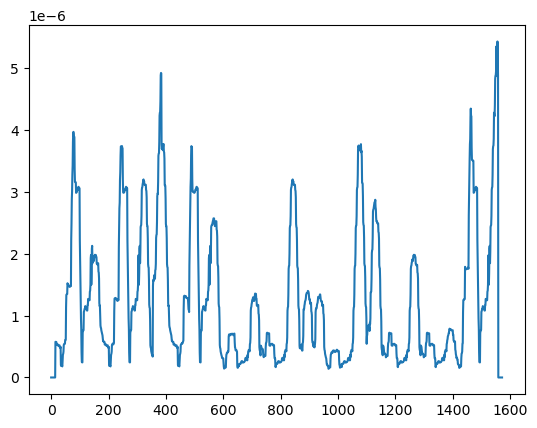

 74%|██████████████████████████████▍          | 223/300 [02:32<00:49,  1.54it/s]

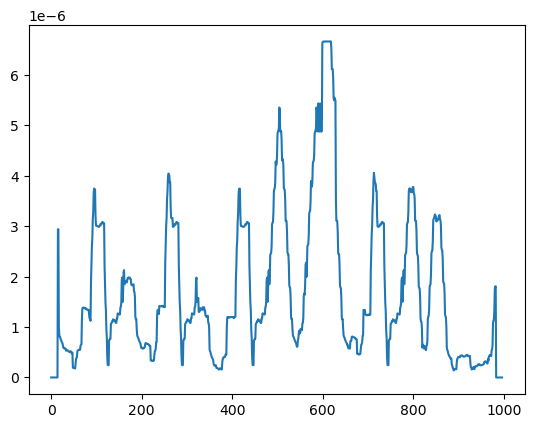

 75%|██████████████████████████████▌          | 224/300 [02:32<00:40,  1.88it/s]

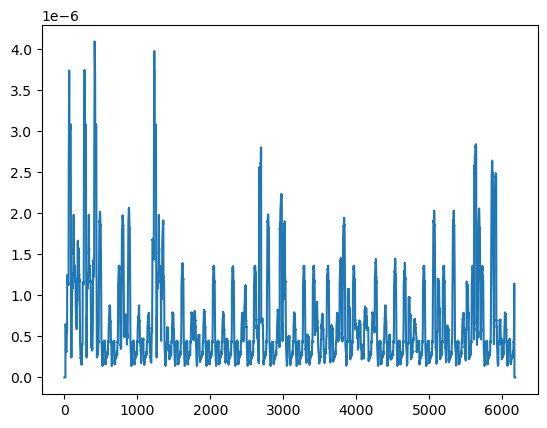

 75%|██████████████████████████████▊          | 225/300 [02:33<00:54,  1.38it/s]

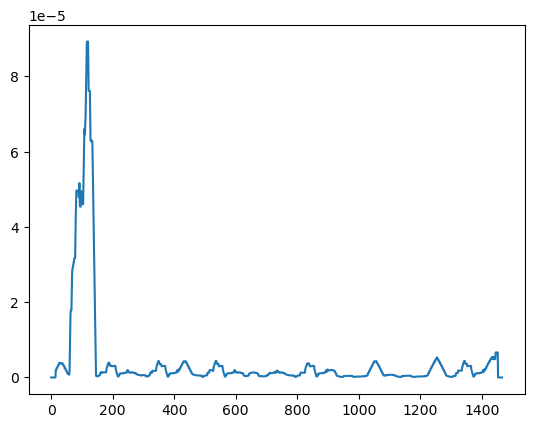

 75%|██████████████████████████████▉          | 226/300 [02:34<00:45,  1.62it/s]

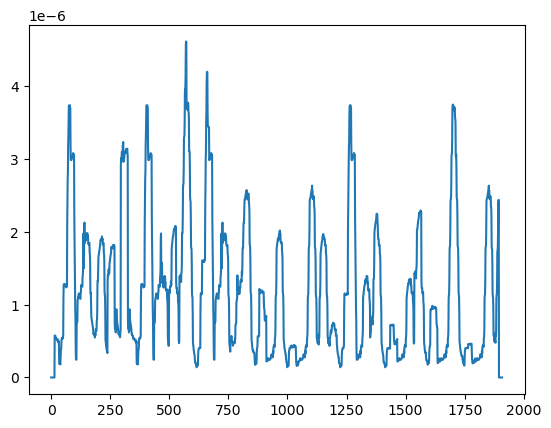

 76%|███████████████████████████████          | 227/300 [02:34<00:40,  1.80it/s]

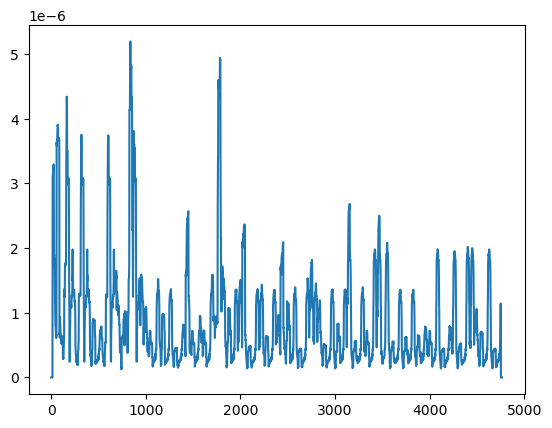

 76%|███████████████████████████████▏         | 228/300 [02:35<00:48,  1.50it/s]

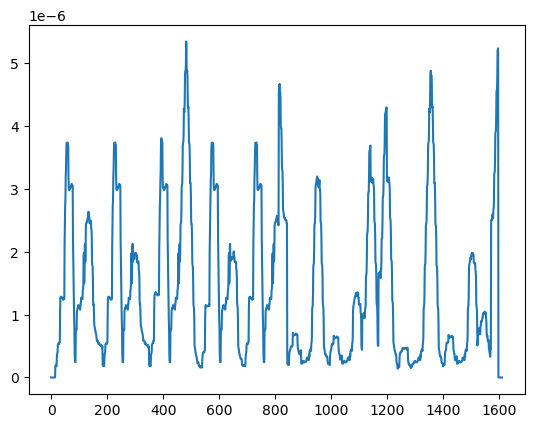

 76%|███████████████████████████████▎         | 229/300 [02:35<00:41,  1.72it/s]

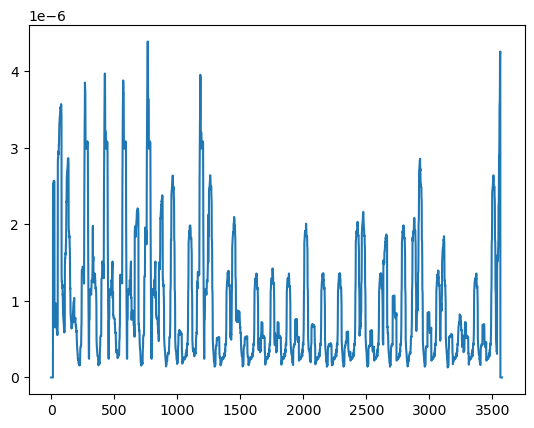

 77%|███████████████████████████████▍         | 230/300 [02:36<00:43,  1.61it/s]

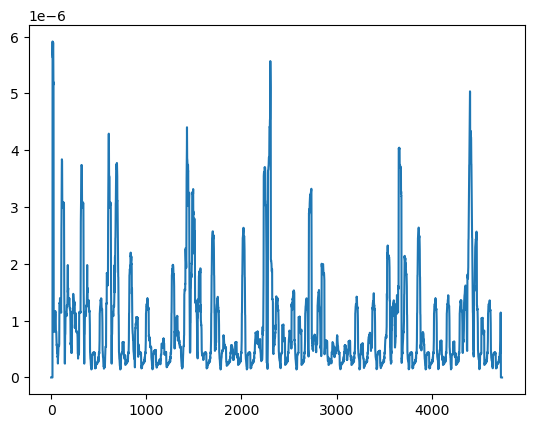

 77%|███████████████████████████████▌         | 231/300 [02:37<00:48,  1.41it/s]

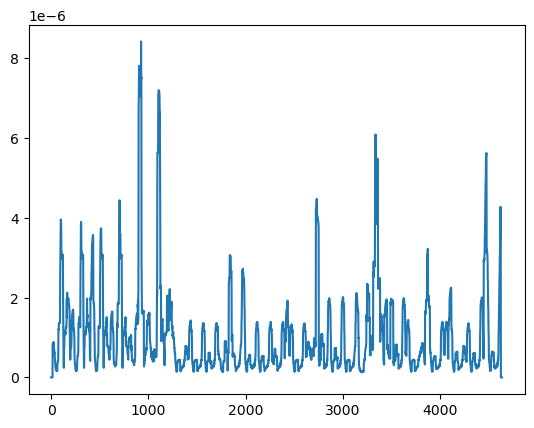

 77%|███████████████████████████████▋         | 232/300 [02:38<00:52,  1.29it/s]

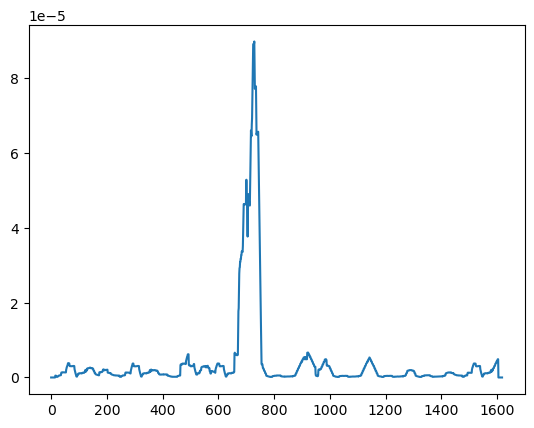

 78%|███████████████████████████████▊         | 233/300 [02:38<00:43,  1.53it/s]

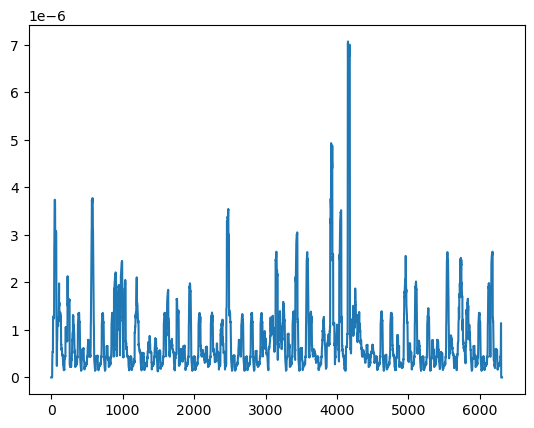

 78%|███████████████████████████████▉         | 234/300 [02:40<00:54,  1.21it/s]

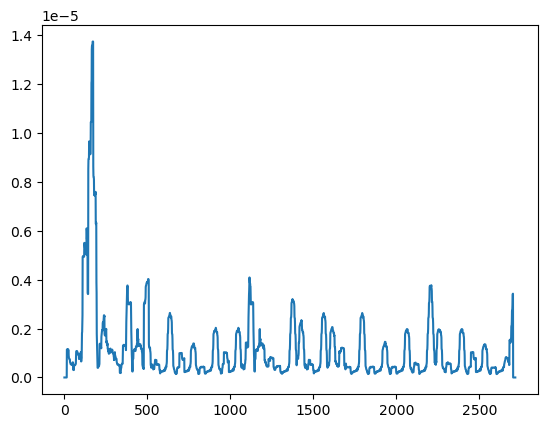

 78%|████████████████████████████████         | 235/300 [02:40<00:48,  1.33it/s]

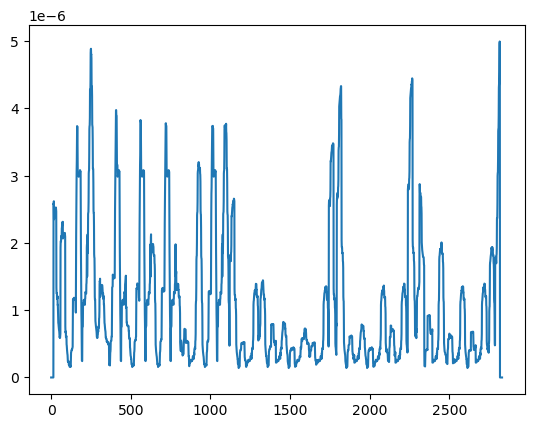

 79%|████████████████████████████████▎        | 236/300 [02:41<00:45,  1.40it/s]

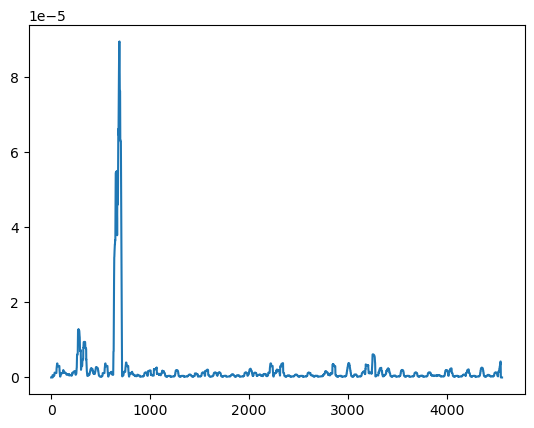

 79%|████████████████████████████████▍        | 237/300 [02:42<00:47,  1.32it/s]

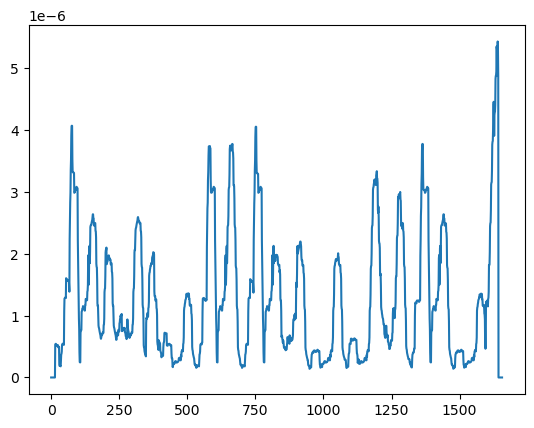

 79%|████████████████████████████████▌        | 238/300 [02:42<00:39,  1.55it/s]

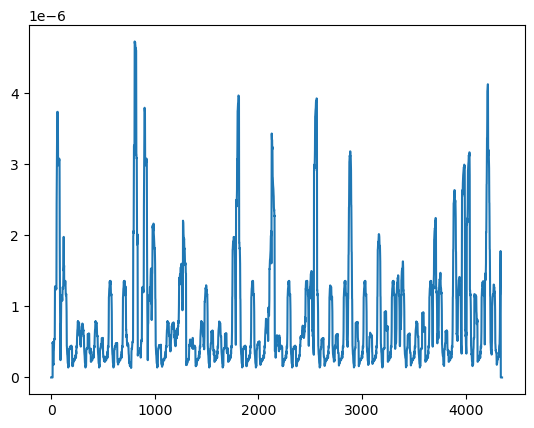

 80%|████████████████████████████████▋        | 239/300 [02:43<00:42,  1.42it/s]

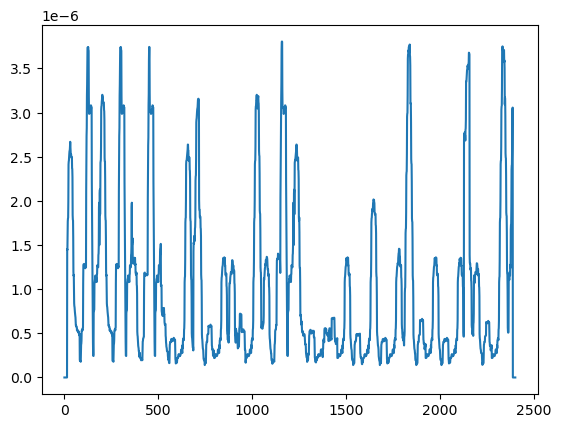

 80%|████████████████████████████████▊        | 240/300 [02:43<00:38,  1.54it/s]

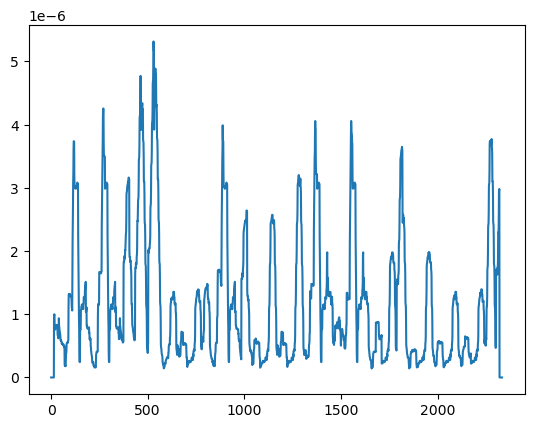

 80%|████████████████████████████████▉        | 241/300 [02:44<00:35,  1.65it/s]

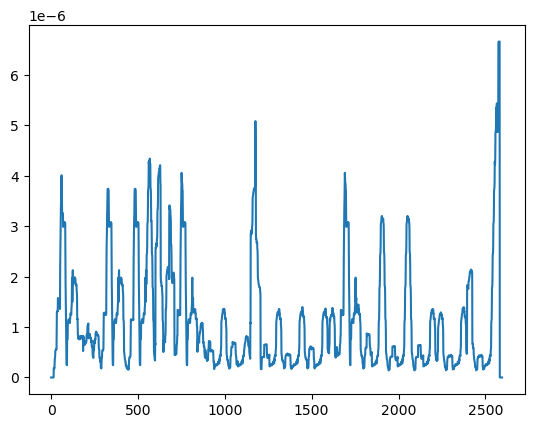

 81%|█████████████████████████████████        | 242/300 [02:44<00:34,  1.70it/s]

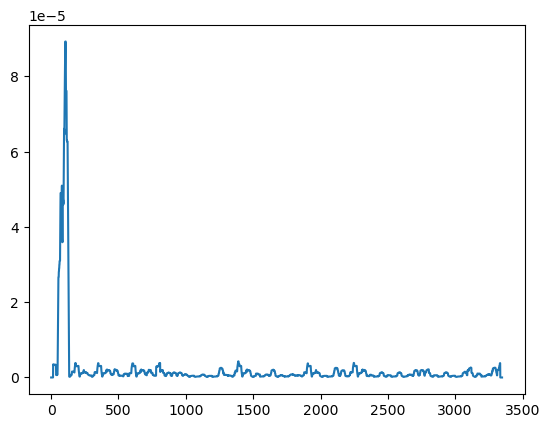

 81%|█████████████████████████████████▏       | 243/300 [02:45<00:35,  1.62it/s]

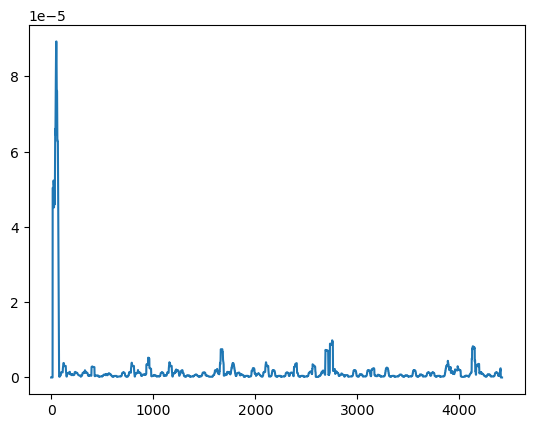

 81%|█████████████████████████████████▎       | 244/300 [02:46<00:38,  1.45it/s]

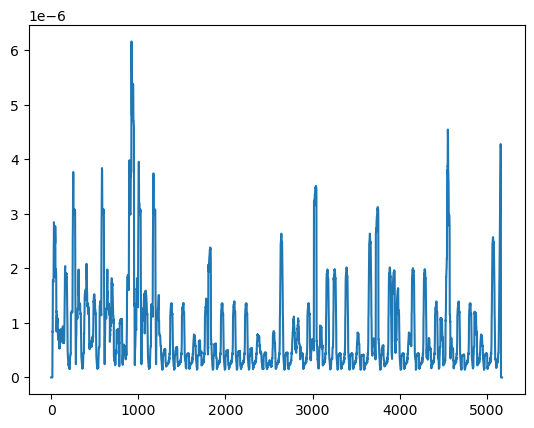

 82%|█████████████████████████████████▍       | 245/300 [02:47<00:42,  1.29it/s]

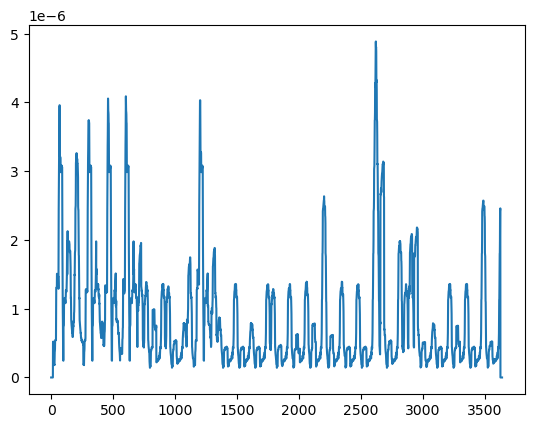

 82%|█████████████████████████████████▌       | 246/300 [02:48<00:41,  1.31it/s]

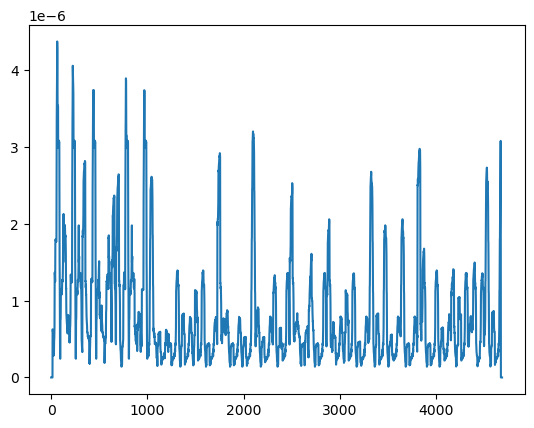

 82%|█████████████████████████████████▊       | 247/300 [02:49<00:42,  1.24it/s]

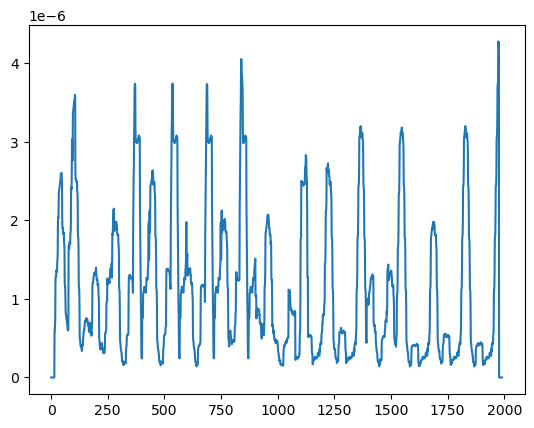

 83%|█████████████████████████████████▉       | 248/300 [02:49<00:36,  1.43it/s]

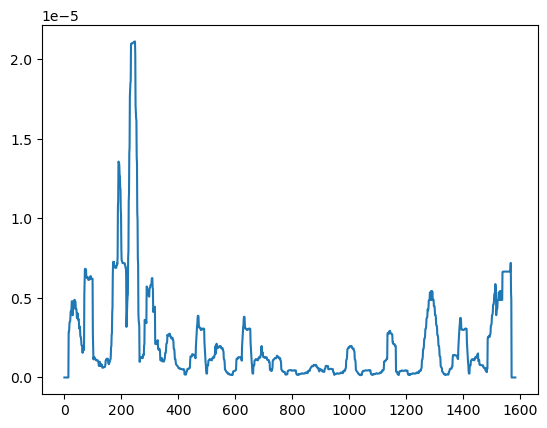

 83%|██████████████████████████████████       | 249/300 [02:49<00:30,  1.66it/s]

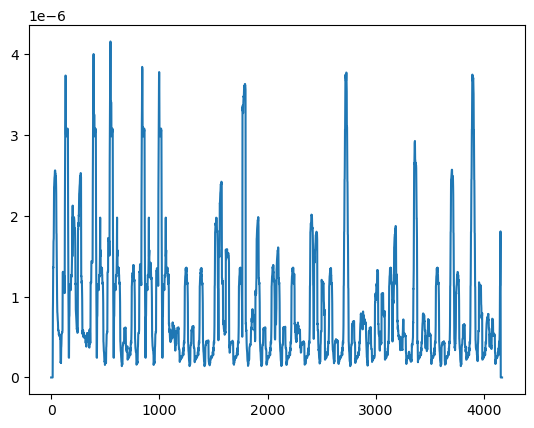

 83%|██████████████████████████████████▏      | 250/300 [02:50<00:33,  1.51it/s]

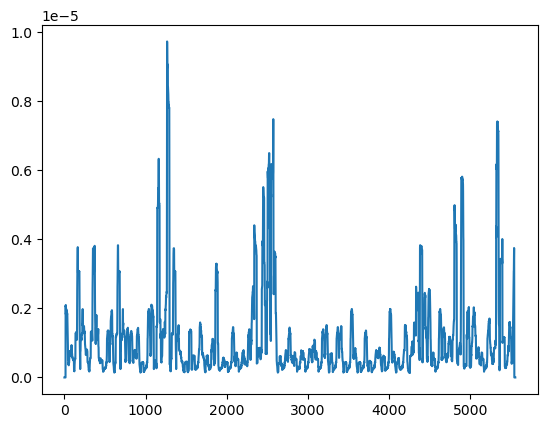

 84%|██████████████████████████████████▎      | 251/300 [02:51<00:38,  1.27it/s]

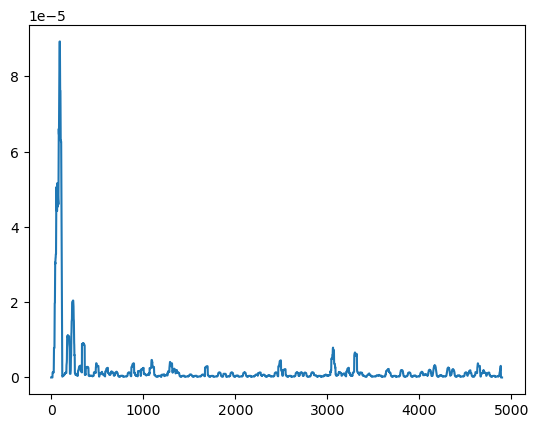

 84%|██████████████████████████████████▍      | 252/300 [02:52<00:39,  1.20it/s]

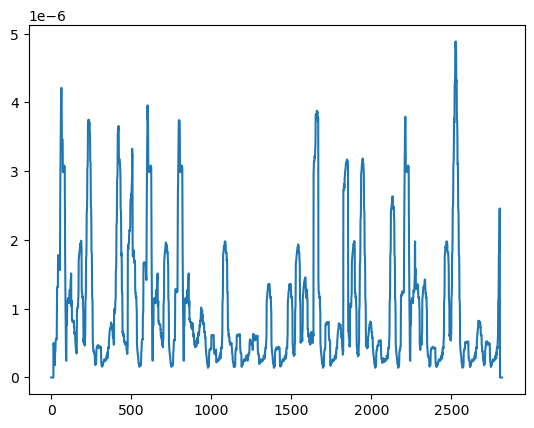

 84%|██████████████████████████████████▌      | 253/300 [02:53<00:35,  1.31it/s]

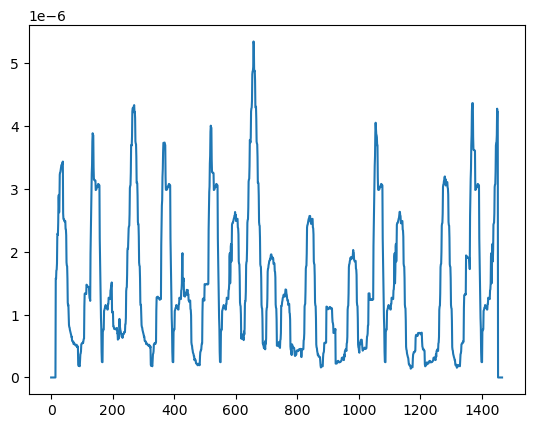

 85%|██████████████████████████████████▋      | 254/300 [02:53<00:30,  1.53it/s]

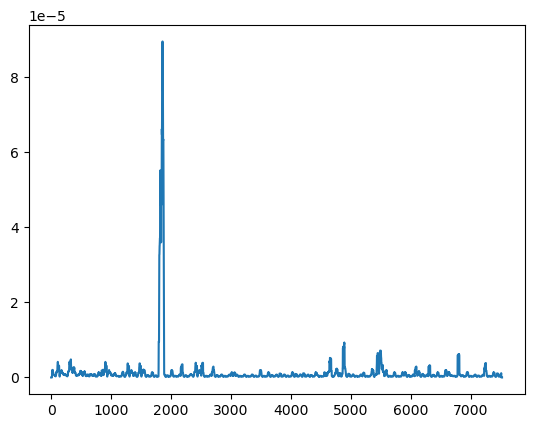

 85%|██████████████████████████████████▊      | 255/300 [02:55<00:39,  1.13it/s]

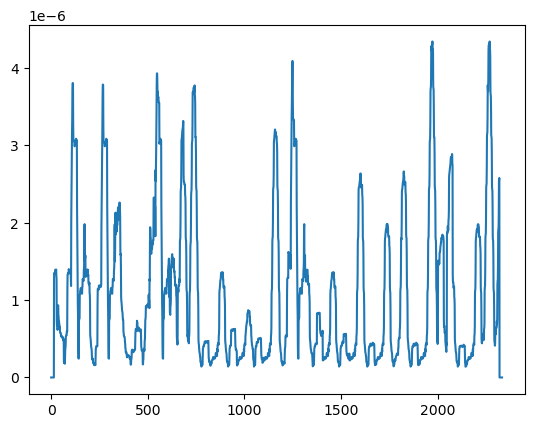

 85%|██████████████████████████████████▉      | 256/300 [02:55<00:33,  1.31it/s]

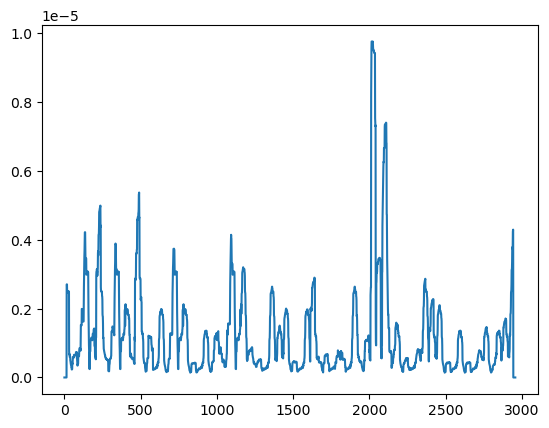

 86%|███████████████████████████████████      | 257/300 [02:56<00:31,  1.39it/s]

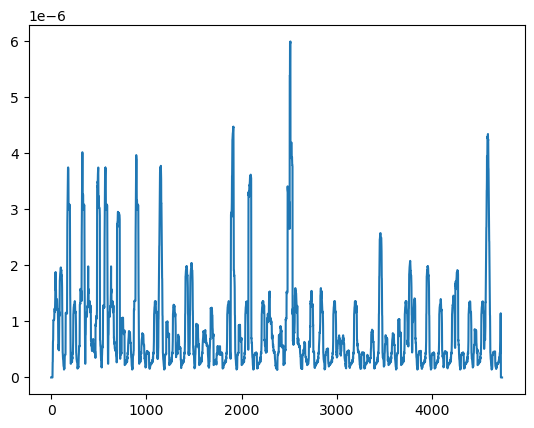

 86%|███████████████████████████████████▎     | 258/300 [02:57<00:33,  1.24it/s]

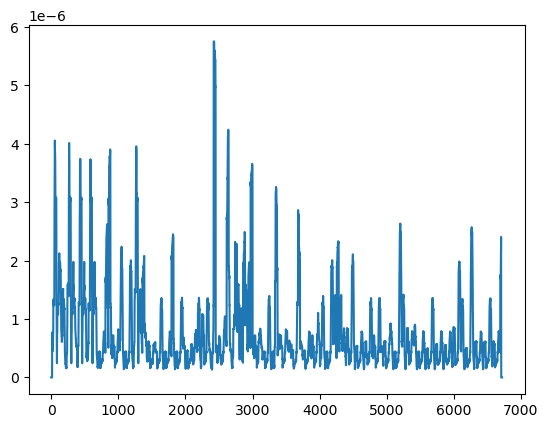

 86%|███████████████████████████████████▍     | 259/300 [02:58<00:38,  1.06it/s]

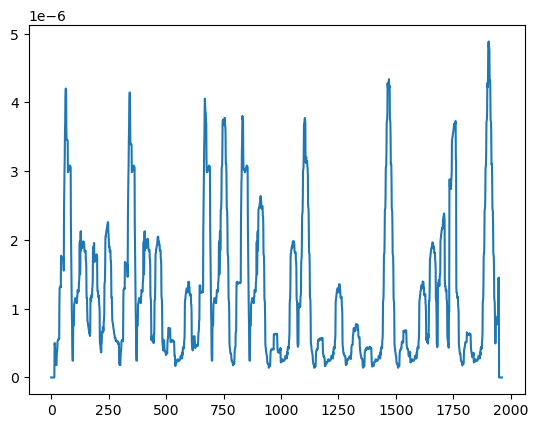

 87%|███████████████████████████████████▌     | 260/300 [02:58<00:31,  1.26it/s]

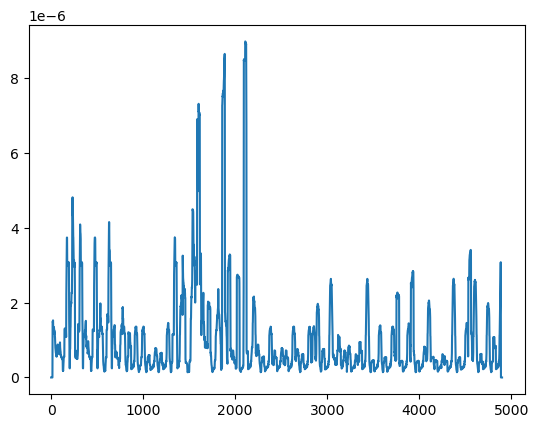

 87%|███████████████████████████████████▋     | 261/300 [02:59<00:32,  1.18it/s]

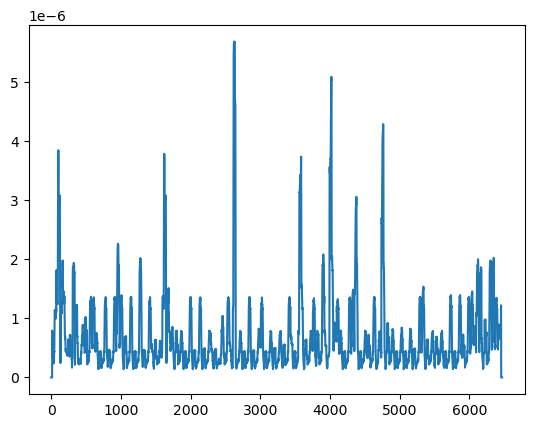

 87%|███████████████████████████████████▊     | 262/300 [03:01<00:36,  1.04it/s]

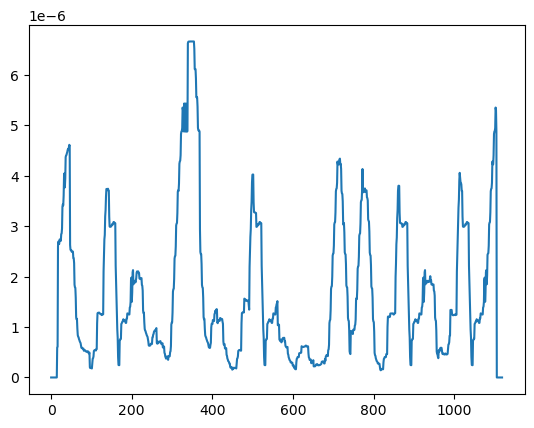

 88%|███████████████████████████████████▉     | 263/300 [03:01<00:28,  1.30it/s]

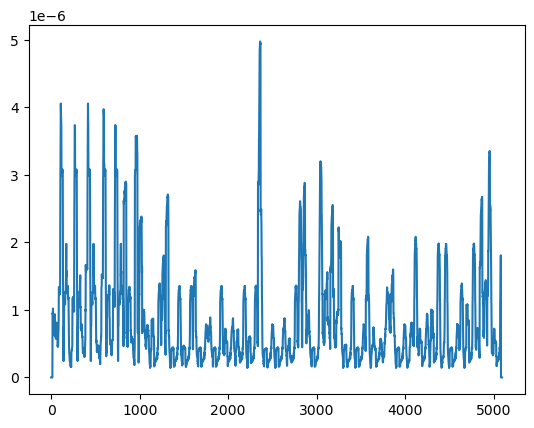

 88%|████████████████████████████████████     | 264/300 [03:02<00:29,  1.20it/s]

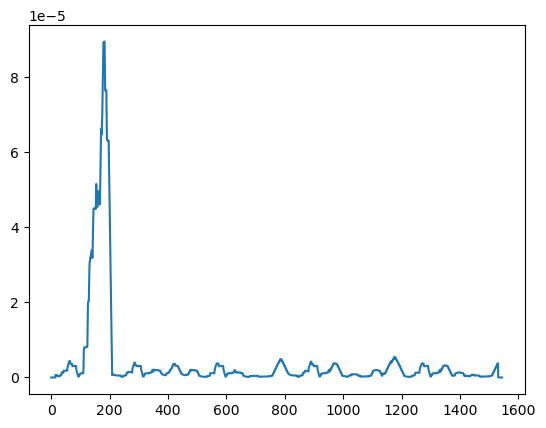

 88%|████████████████████████████████████▏    | 265/300 [03:02<00:24,  1.44it/s]

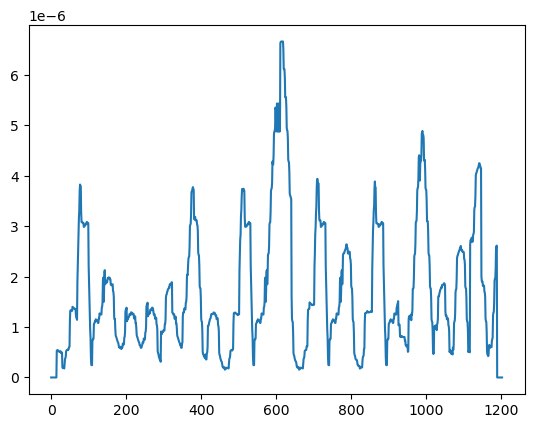

 89%|████████████████████████████████████▎    | 266/300 [03:03<00:19,  1.74it/s]

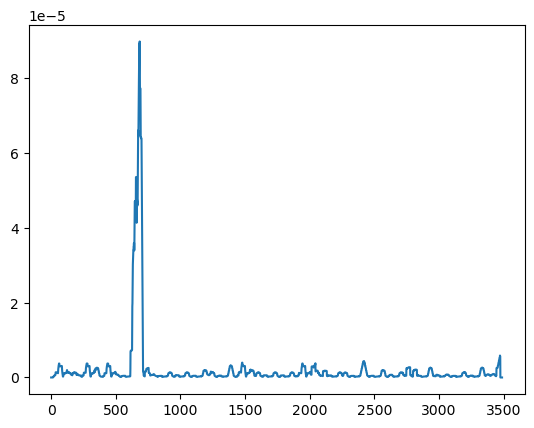

 89%|████████████████████████████████████▍    | 267/300 [03:03<00:19,  1.66it/s]

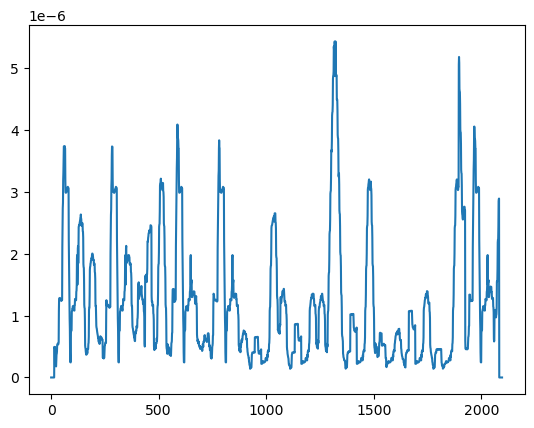

 89%|████████████████████████████████████▋    | 268/300 [03:04<00:17,  1.80it/s]

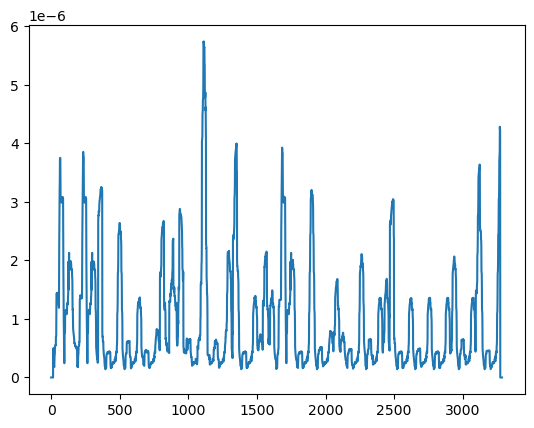

 90%|████████████████████████████████████▊    | 269/300 [03:04<00:18,  1.69it/s]

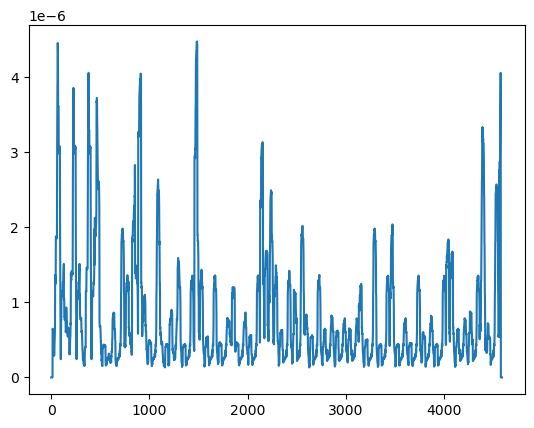

 90%|████████████████████████████████████▉    | 270/300 [03:05<00:20,  1.46it/s]

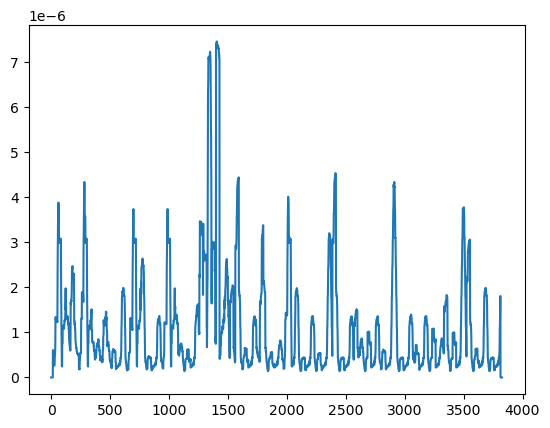

 90%|█████████████████████████████████████    | 271/300 [03:06<00:20,  1.40it/s]

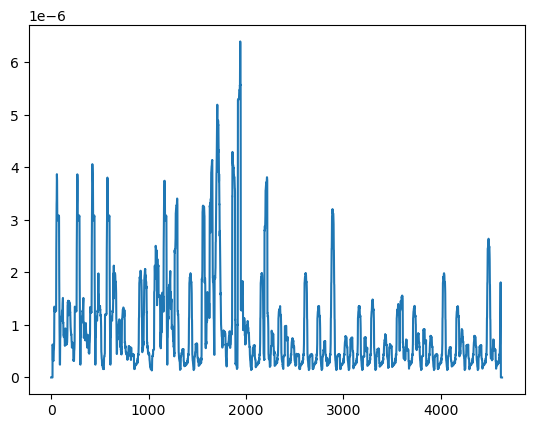

 91%|█████████████████████████████████████▏   | 272/300 [03:07<00:21,  1.30it/s]

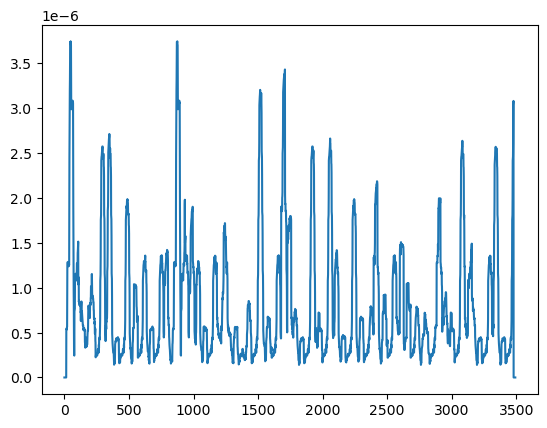

 91%|█████████████████████████████████████▎   | 273/300 [03:08<00:20,  1.32it/s]

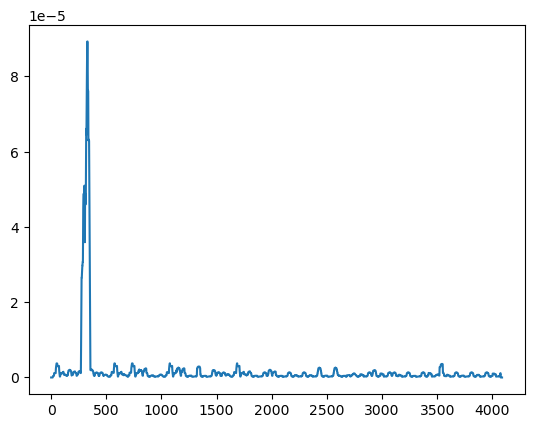

 91%|█████████████████████████████████████▍   | 274/300 [03:08<00:20,  1.30it/s]

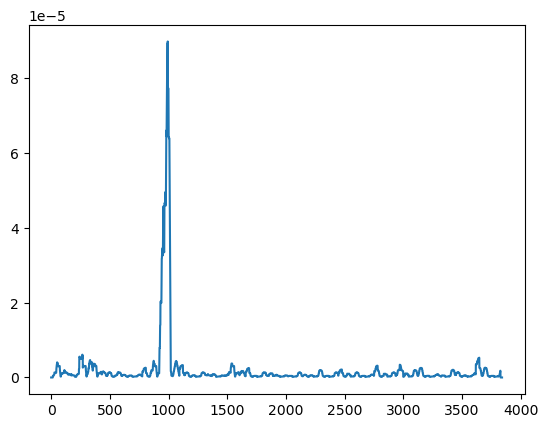

 92%|█████████████████████████████████████▌   | 275/300 [03:09<00:19,  1.29it/s]

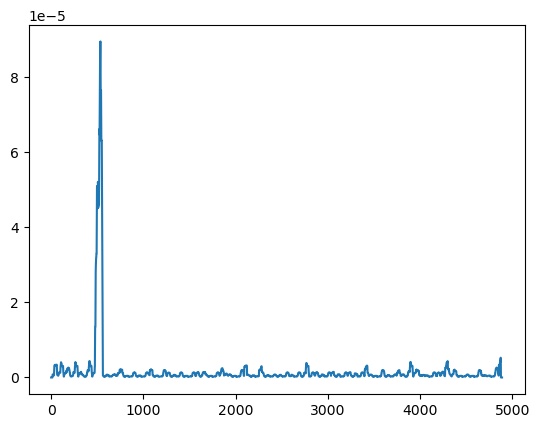

 92%|█████████████████████████████████████▋   | 276/300 [03:10<00:20,  1.19it/s]

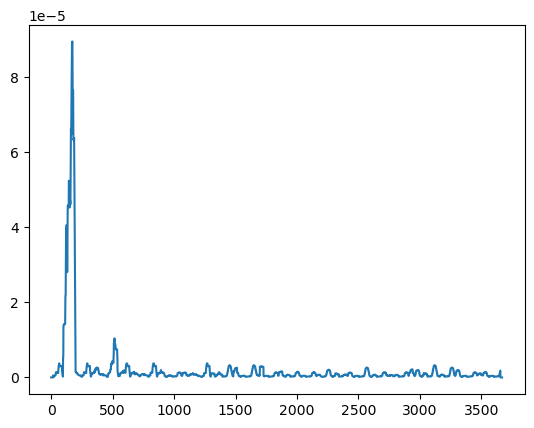

 92%|█████████████████████████████████████▊   | 277/300 [03:11<00:18,  1.24it/s]

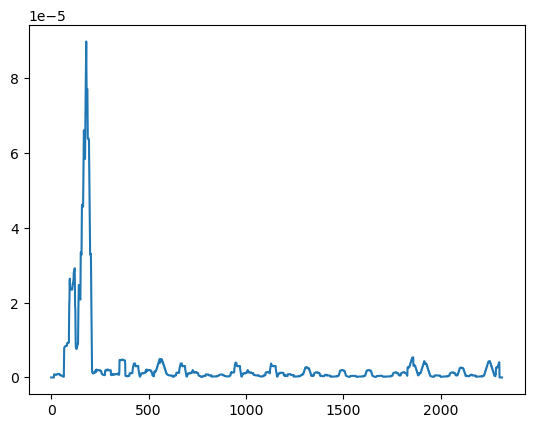

 93%|█████████████████████████████████████▉   | 278/300 [03:11<00:15,  1.40it/s]

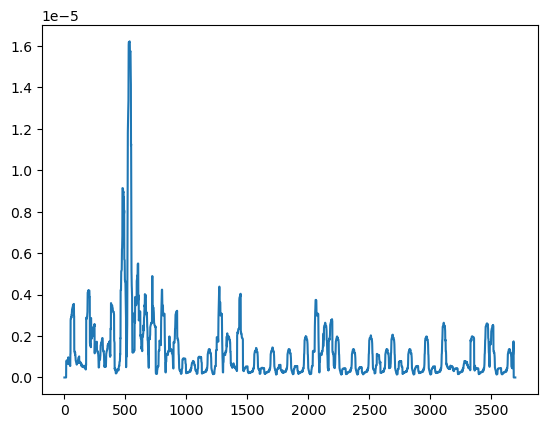

 93%|██████████████████████████████████████▏  | 279/300 [03:12<00:15,  1.37it/s]

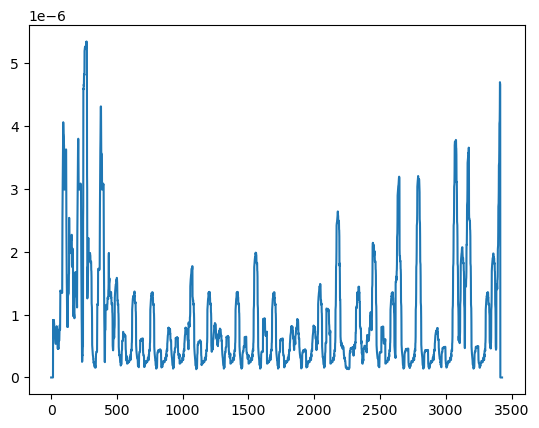

 93%|██████████████████████████████████████▎  | 280/300 [03:13<00:14,  1.40it/s]

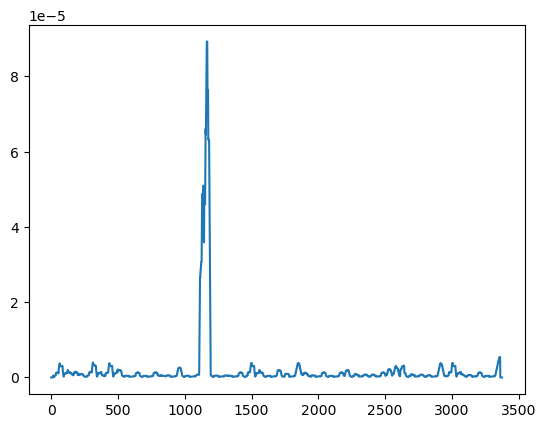

 94%|██████████████████████████████████████▍  | 281/300 [03:14<00:13,  1.43it/s]

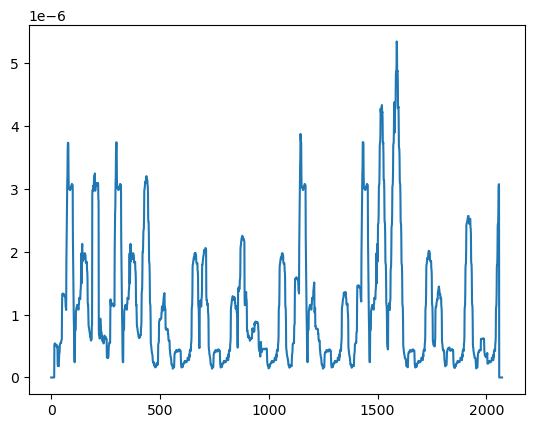

 94%|██████████████████████████████████████▌  | 282/300 [03:14<00:11,  1.60it/s]

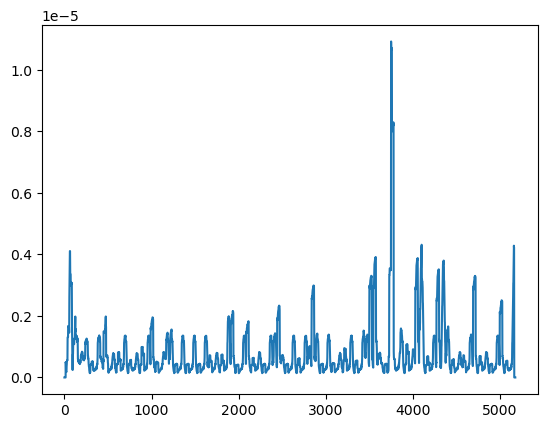

 94%|██████████████████████████████████████▋  | 283/300 [03:15<00:12,  1.36it/s]

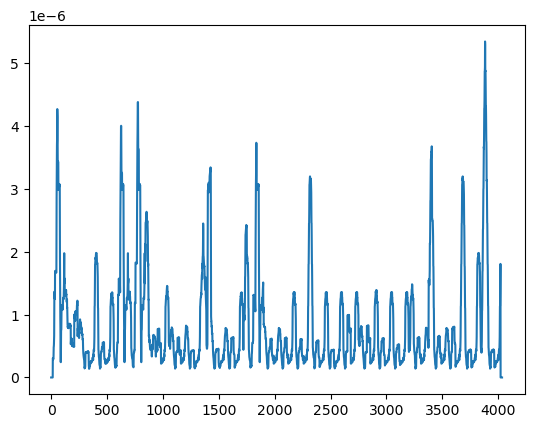

 95%|██████████████████████████████████████▊  | 284/300 [03:16<00:12,  1.32it/s]

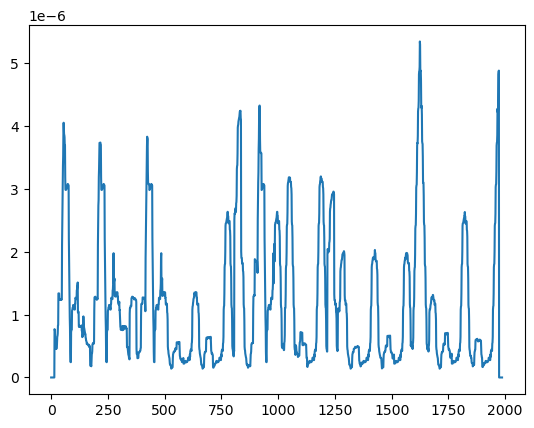

 95%|██████████████████████████████████████▉  | 285/300 [03:16<00:10,  1.50it/s]

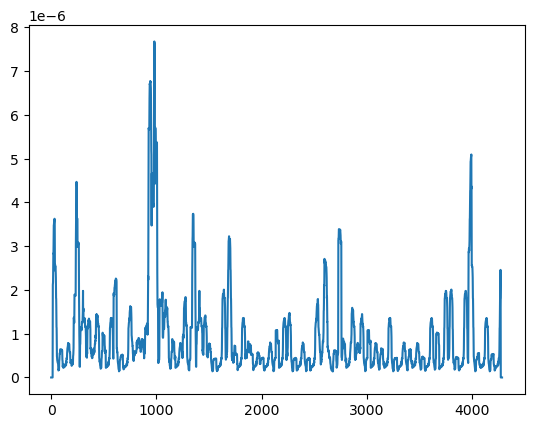

 95%|███████████████████████████████████████  | 286/300 [03:17<00:10,  1.39it/s]

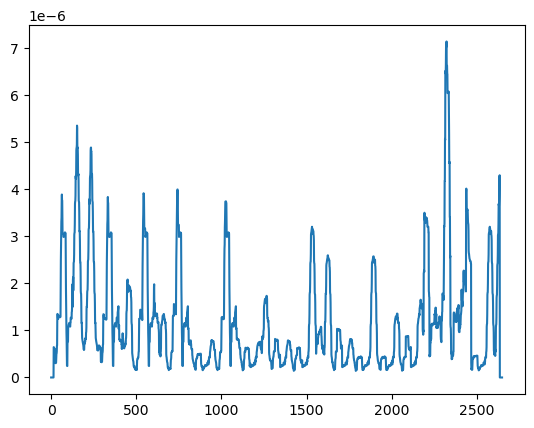

 96%|███████████████████████████████████████▏ | 287/300 [03:18<00:08,  1.50it/s]

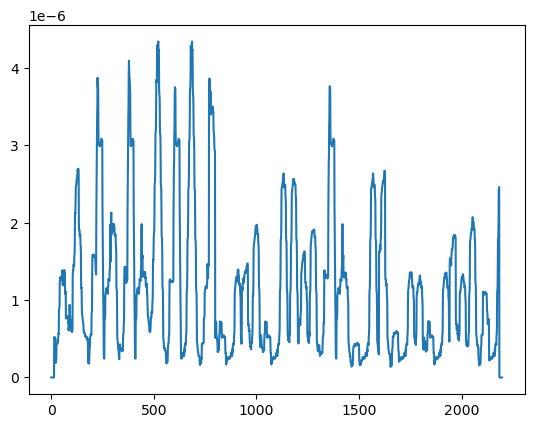

 96%|███████████████████████████████████████▎ | 288/300 [03:18<00:07,  1.64it/s]

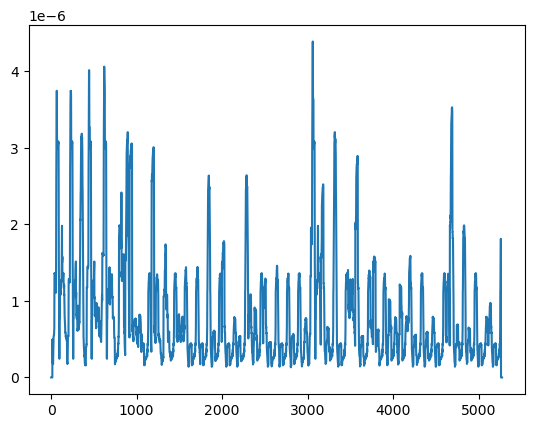

 96%|███████████████████████████████████████▍ | 289/300 [03:19<00:07,  1.38it/s]

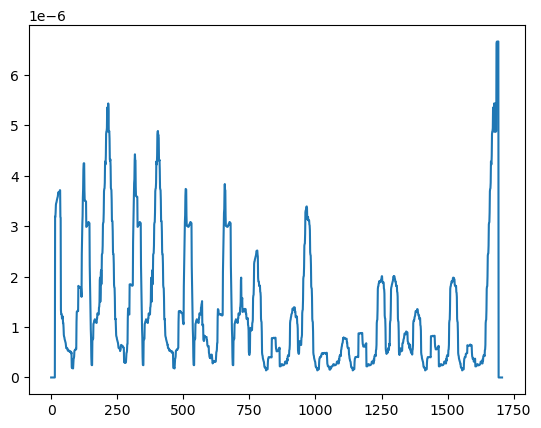

 97%|███████████████████████████████████████▋ | 290/300 [03:20<00:06,  1.59it/s]

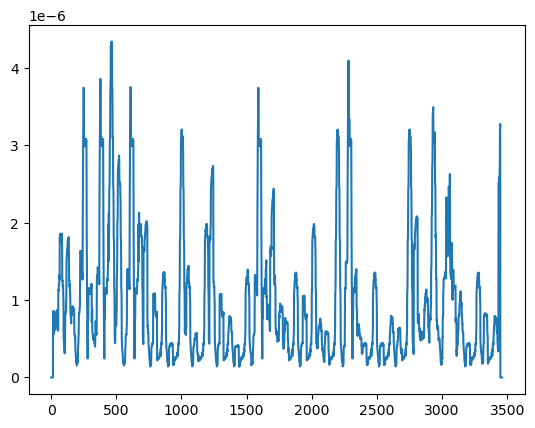

 97%|███████████████████████████████████████▊ | 291/300 [03:20<00:05,  1.55it/s]

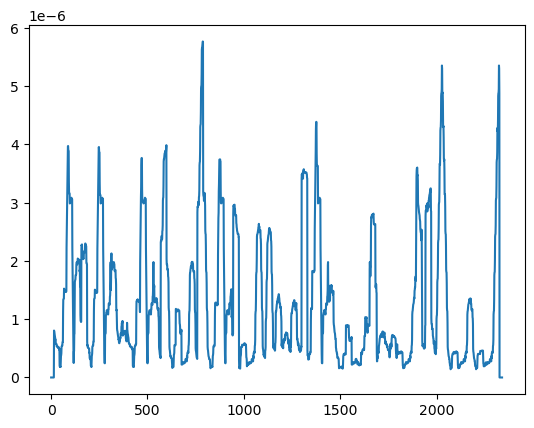

 97%|███████████████████████████████████████▉ | 292/300 [03:21<00:04,  1.65it/s]

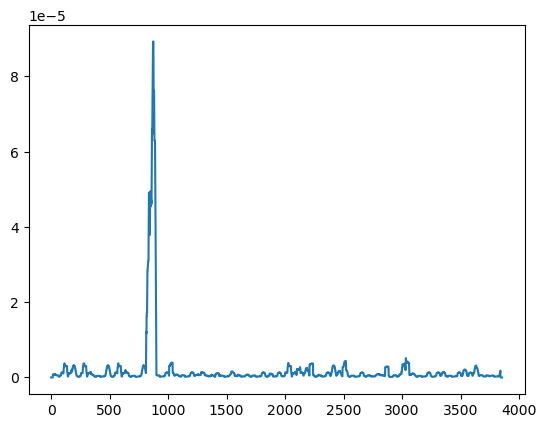

 98%|████████████████████████████████████████ | 293/300 [03:22<00:04,  1.53it/s]

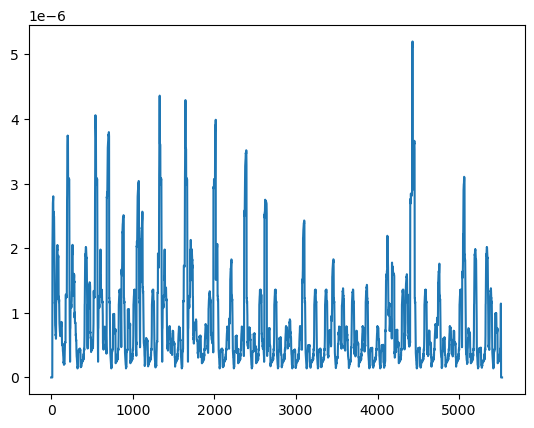

 98%|████████████████████████████████████████▏| 294/300 [03:23<00:04,  1.27it/s]

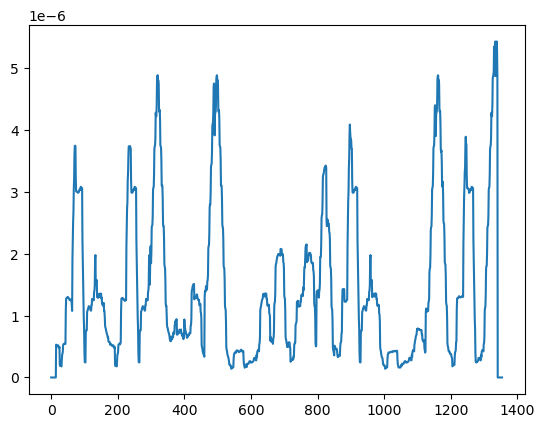

 98%|████████████████████████████████████████▎| 295/300 [03:23<00:03,  1.53it/s]

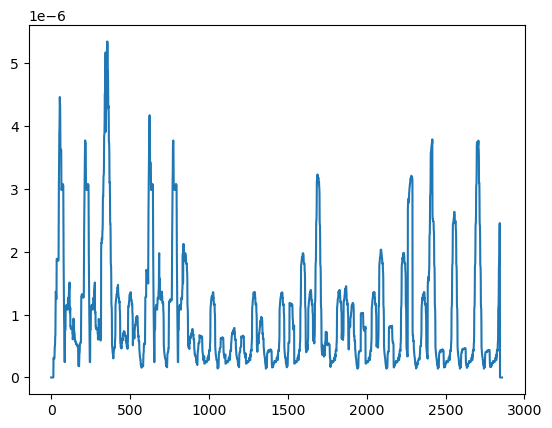

 99%|████████████████████████████████████████▍| 296/300 [03:24<00:02,  1.57it/s]

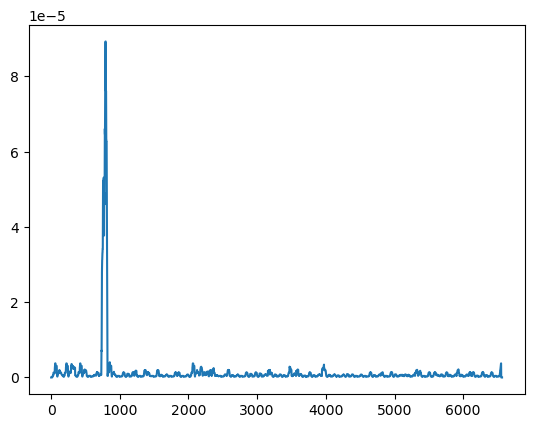

 99%|████████████████████████████████████████▌| 297/300 [03:25<00:02,  1.23it/s]

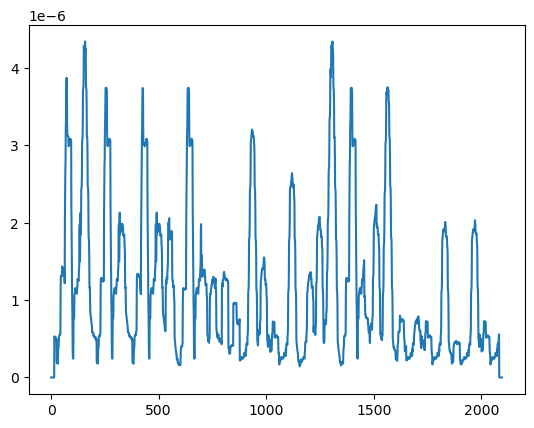

 99%|████████████████████████████████████████▋| 298/300 [03:25<00:01,  1.41it/s]

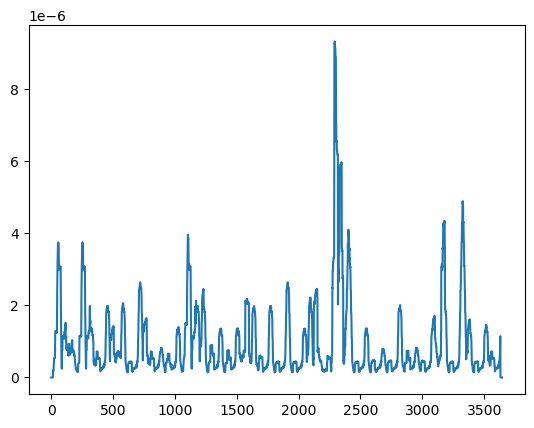

100%|████████████████████████████████████████▊| 299/300 [03:26<00:00,  1.39it/s]

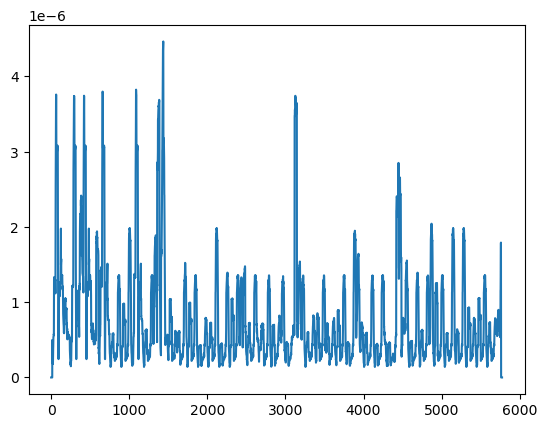

100%|█████████████████████████████████████████| 300/300 [03:27<00:00,  1.45it/s]


CVE-2014-0160


  0%|                                                   | 0/100 [00:00<?, ?it/s]

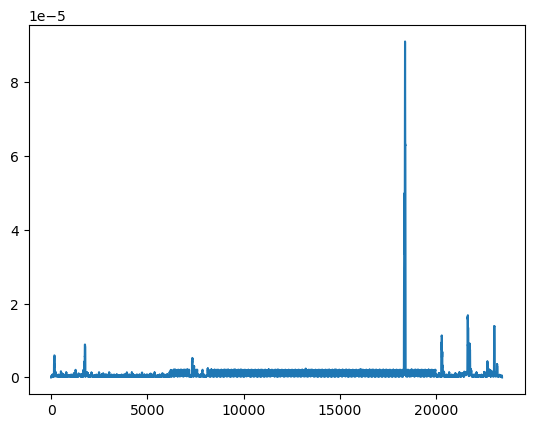

  1%|▍                                          | 1/100 [00:04<07:29,  4.54s/it]

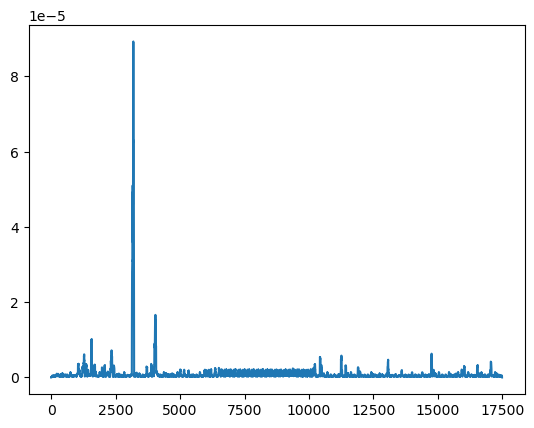

  2%|▊                                          | 2/100 [00:07<06:11,  3.79s/it]

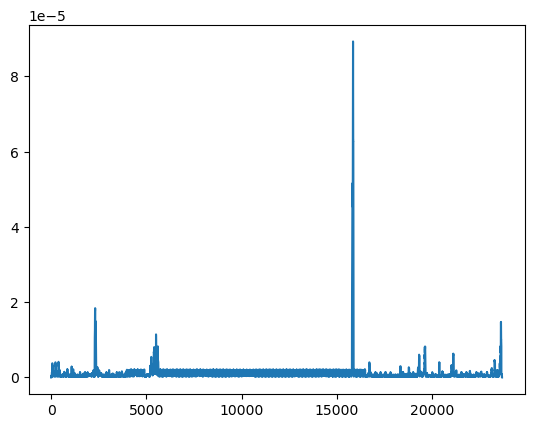

  3%|█▎                                         | 3/100 [00:12<06:42,  4.15s/it]

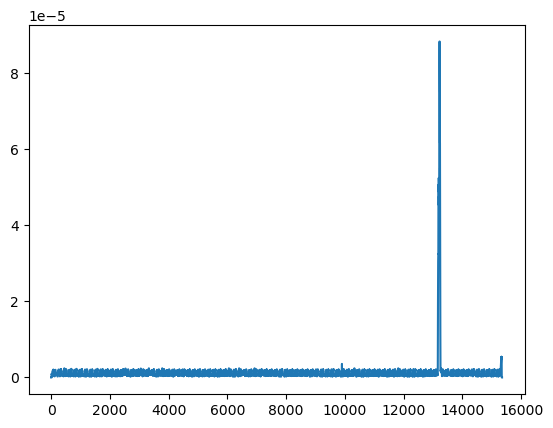

  4%|█▋                                         | 4/100 [00:15<05:51,  3.67s/it]

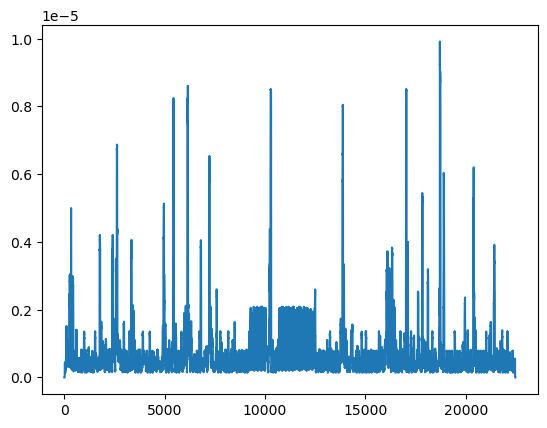

  5%|██▏                                        | 5/100 [00:19<06:11,  3.91s/it]

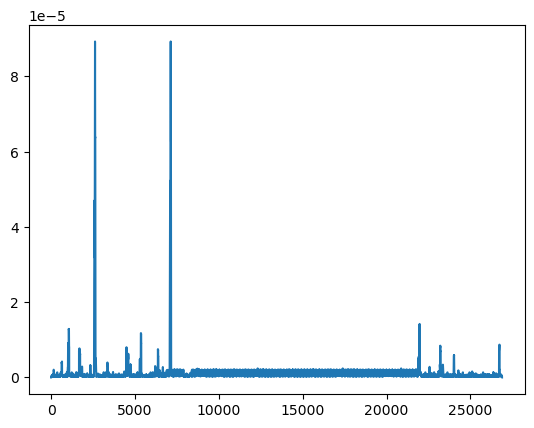

  6%|██▌                                        | 6/100 [00:24<06:46,  4.33s/it]

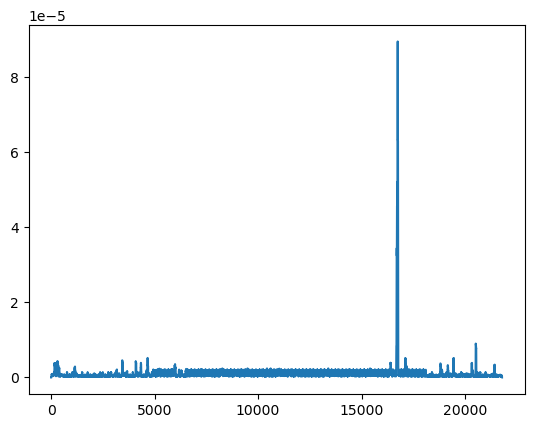

  7%|███                                        | 7/100 [00:28<06:37,  4.28s/it]

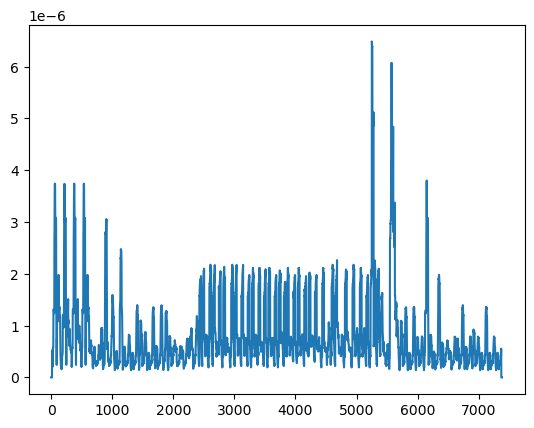

  8%|███▍                                       | 8/100 [00:30<05:12,  3.39s/it]

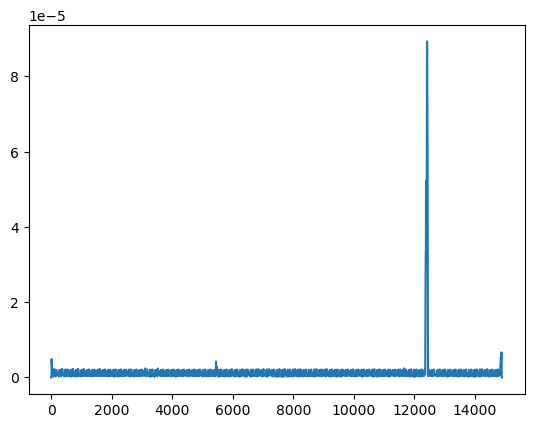

  9%|███▊                                       | 9/100 [00:33<04:51,  3.21s/it]

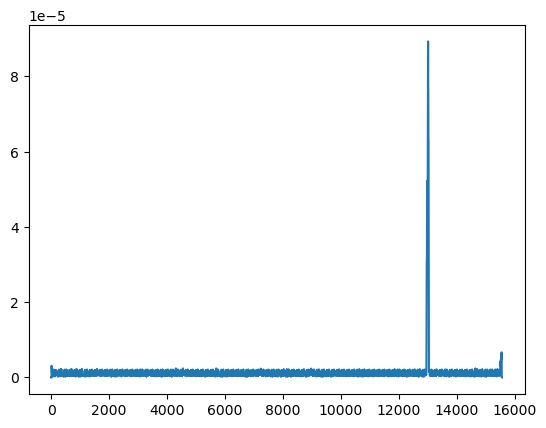

 10%|████▏                                     | 10/100 [00:36<04:43,  3.15s/it]

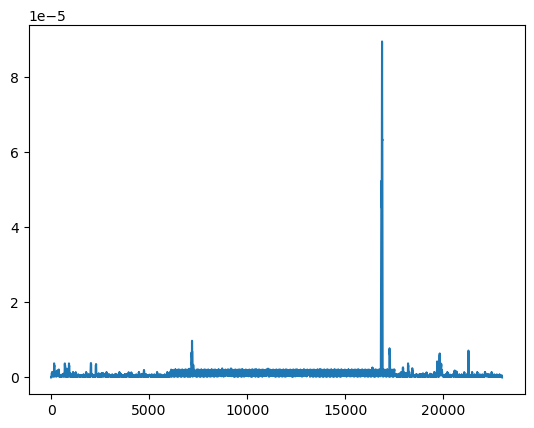

 11%|████▌                                     | 11/100 [00:40<05:13,  3.52s/it]

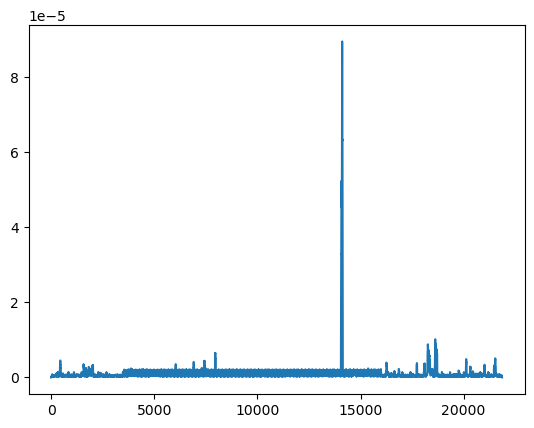

 12%|█████                                     | 12/100 [00:44<05:25,  3.70s/it]

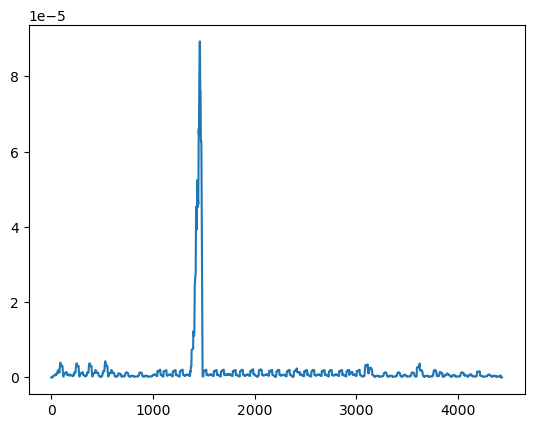

 13%|█████▍                                    | 13/100 [00:45<04:09,  2.87s/it]

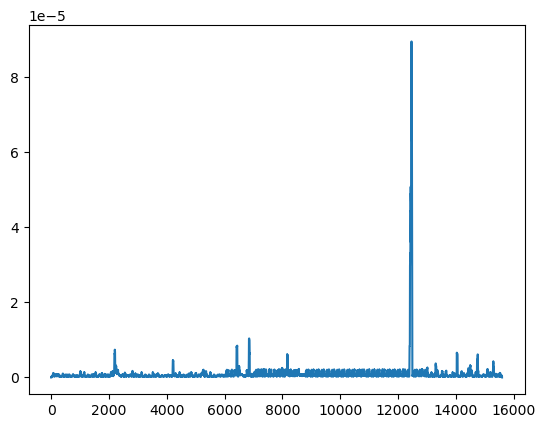

 14%|█████▉                                    | 14/100 [00:48<04:08,  2.89s/it]

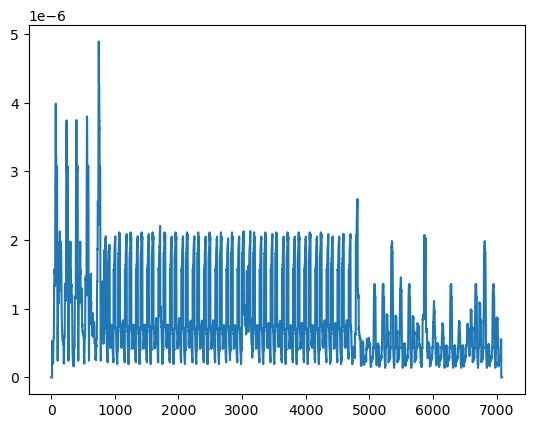

 15%|██████▎                                   | 15/100 [00:50<03:28,  2.45s/it]

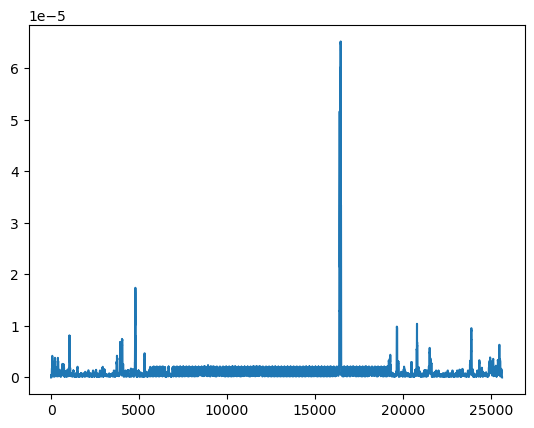

 16%|██████▋                                   | 16/100 [00:55<04:28,  3.19s/it]

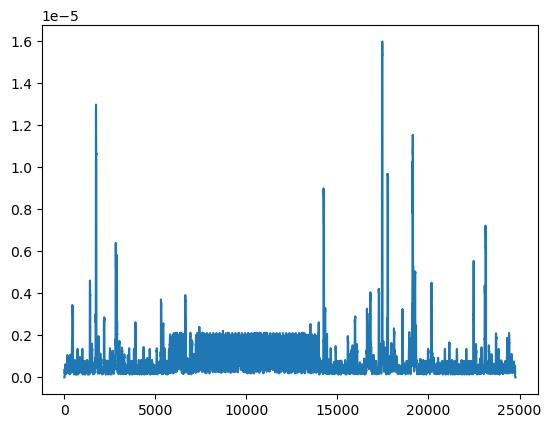

 17%|███████▏                                  | 17/100 [00:59<05:02,  3.64s/it]

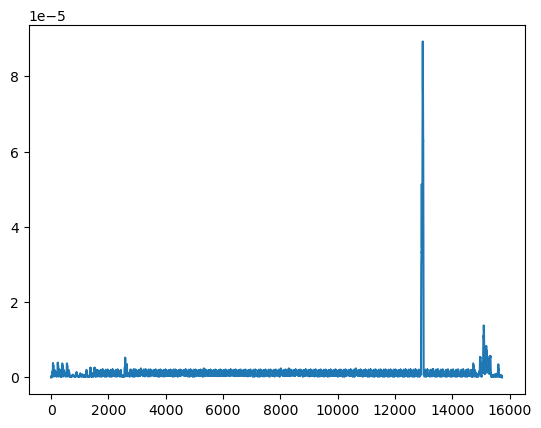

 18%|███████▌                                  | 18/100 [01:02<04:43,  3.45s/it]

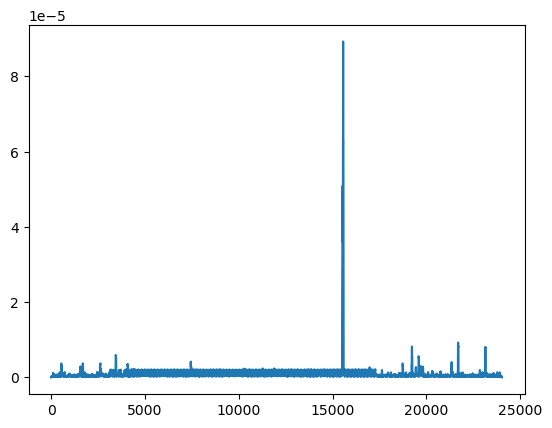

 19%|███████▉                                  | 19/100 [01:07<05:06,  3.78s/it]

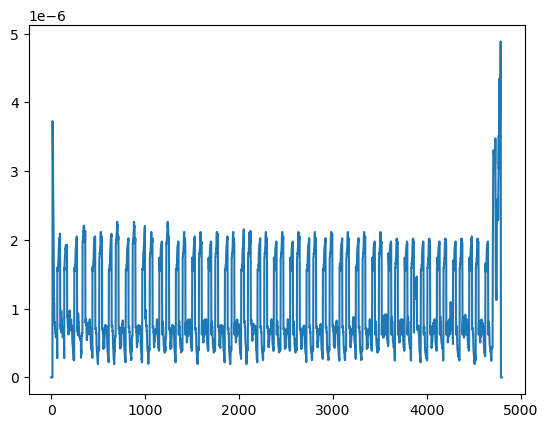

 20%|████████▍                                 | 20/100 [01:08<03:55,  2.95s/it]

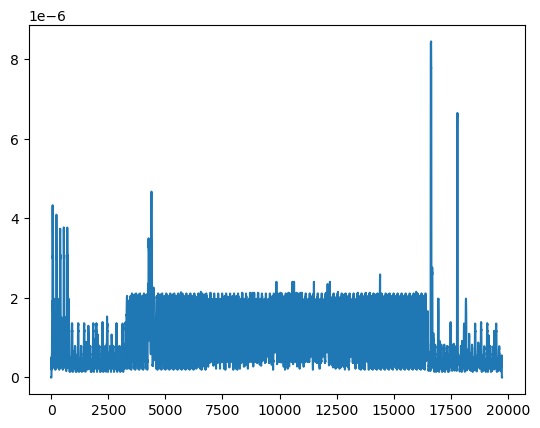

 21%|████████▊                                 | 21/100 [01:11<04:11,  3.18s/it]

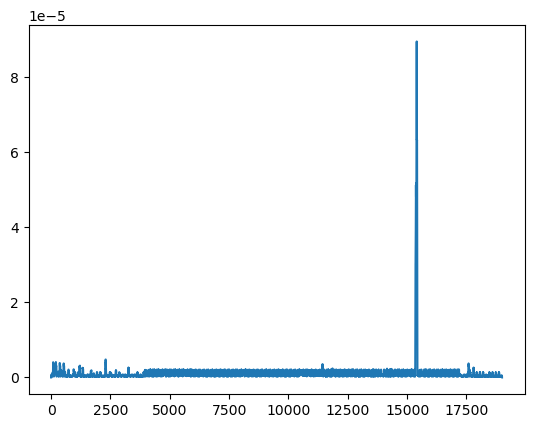

 22%|█████████▏                                | 22/100 [01:15<04:18,  3.32s/it]

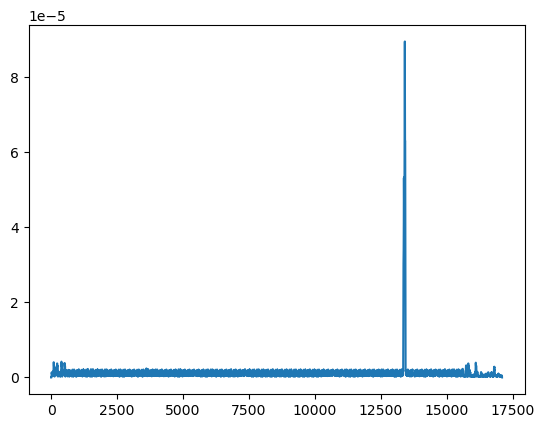

 23%|█████████▋                                | 23/100 [01:18<04:13,  3.29s/it]

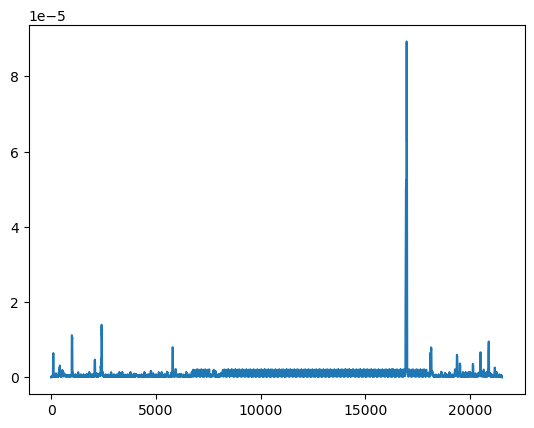

 24%|██████████                                | 24/100 [01:22<04:29,  3.54s/it]

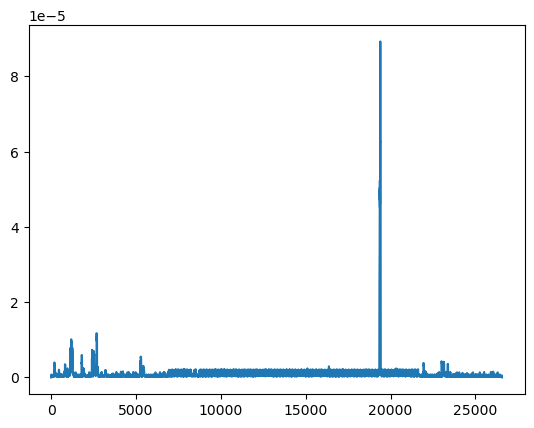

 25%|██████████▌                               | 25/100 [01:28<04:59,  4.00s/it]

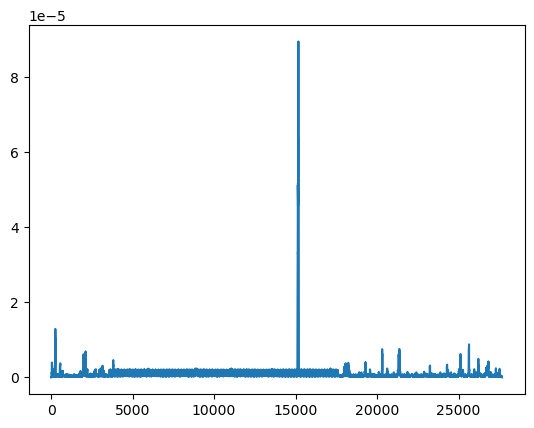

 26%|██████████▉                               | 26/100 [01:33<05:21,  4.35s/it]

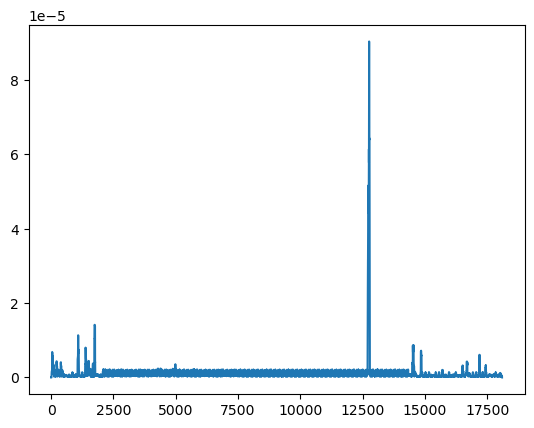

 27%|███████████▎                              | 27/100 [01:36<04:56,  4.06s/it]

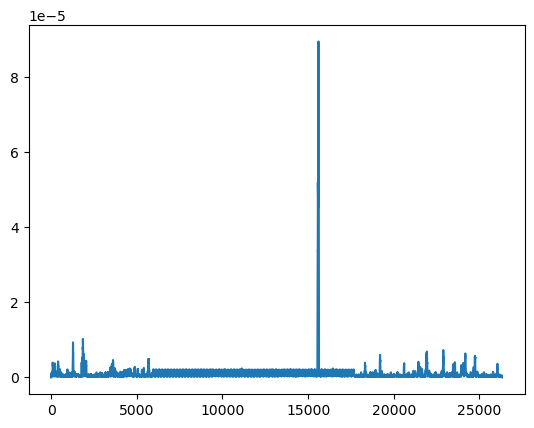

 28%|███████████▊                              | 28/100 [01:41<05:11,  4.33s/it]

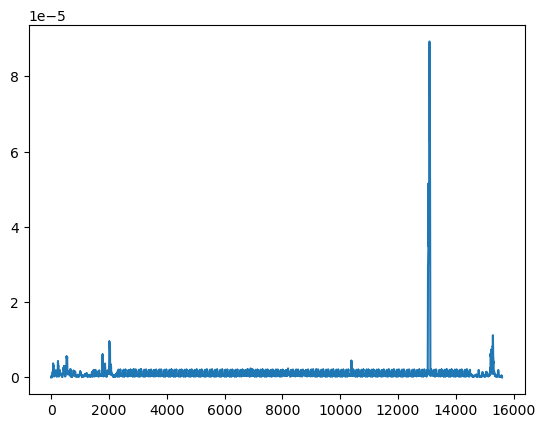

 29%|████████████▏                             | 29/100 [01:44<04:38,  3.92s/it]

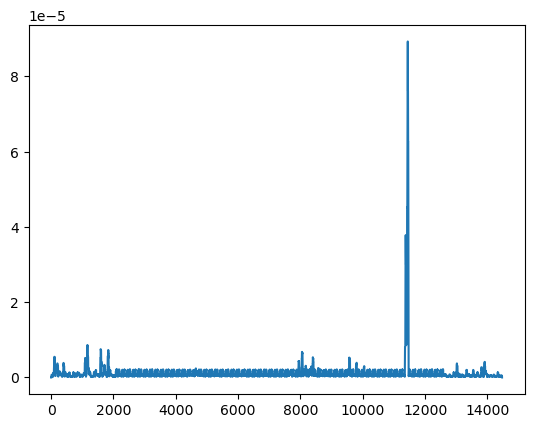

 30%|████████████▌                             | 30/100 [01:47<04:09,  3.57s/it]

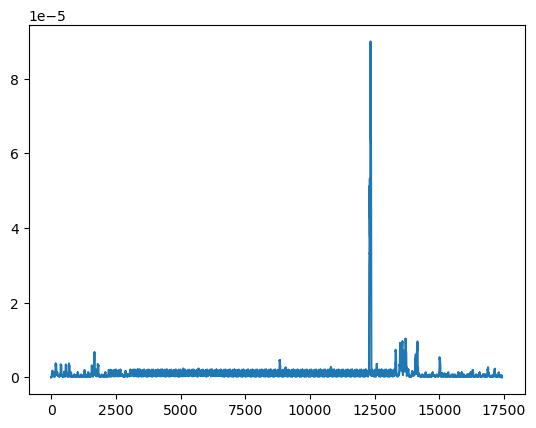

 31%|█████████████                             | 31/100 [01:50<04:03,  3.53s/it]

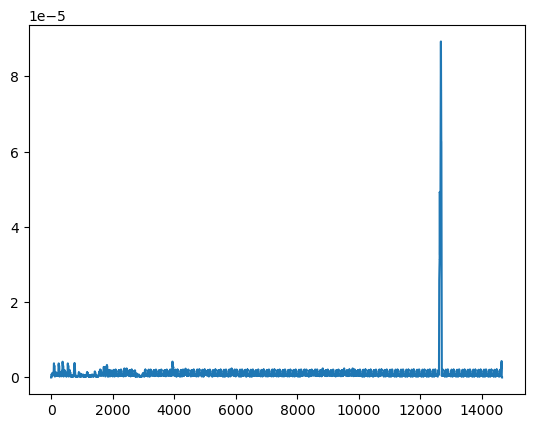

 32%|█████████████▍                            | 32/100 [01:53<03:45,  3.31s/it]

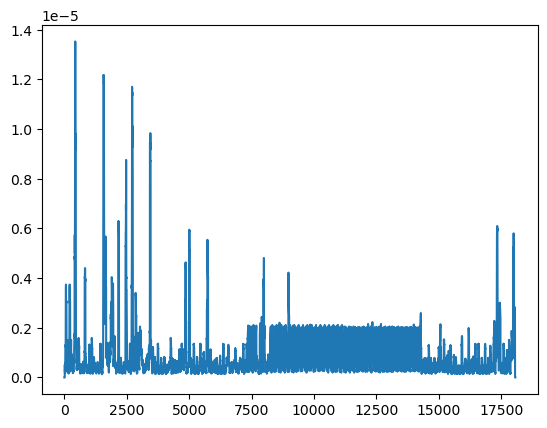

 33%|█████████████▊                            | 33/100 [01:56<03:45,  3.36s/it]

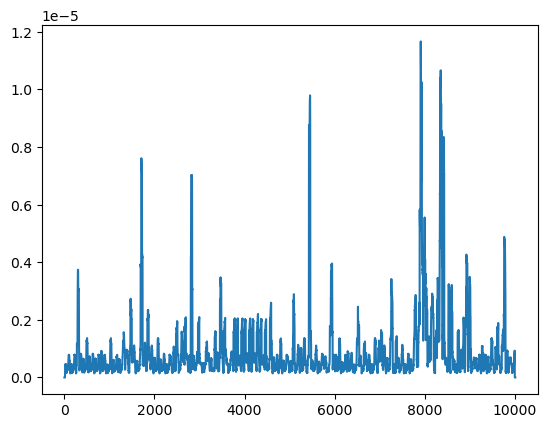

 34%|██████████████▎                           | 34/100 [01:58<03:14,  2.94s/it]

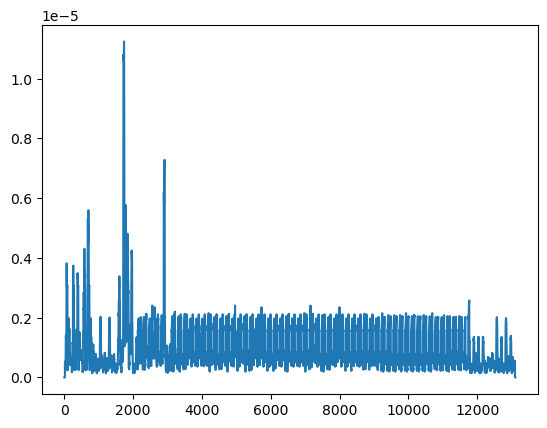

 35%|██████████████▋                           | 35/100 [02:01<03:03,  2.83s/it]

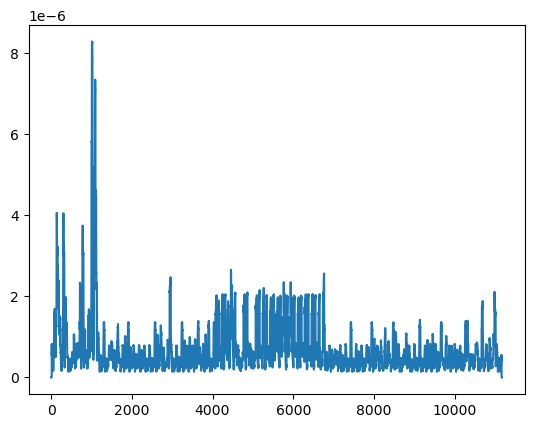

 36%|███████████████                           | 36/100 [02:03<02:47,  2.62s/it]

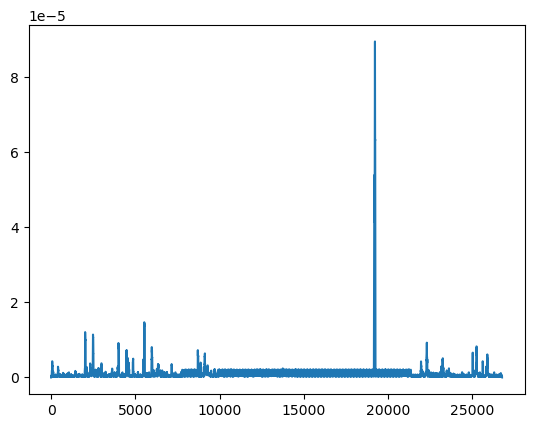

 37%|███████████████▌                          | 37/100 [02:09<03:38,  3.46s/it]

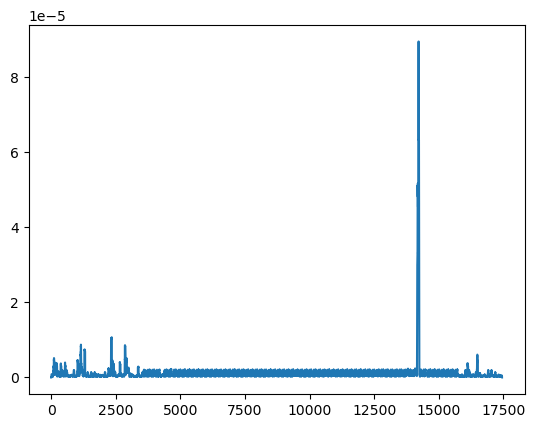

 38%|███████████████▉                          | 38/100 [02:12<03:31,  3.41s/it]

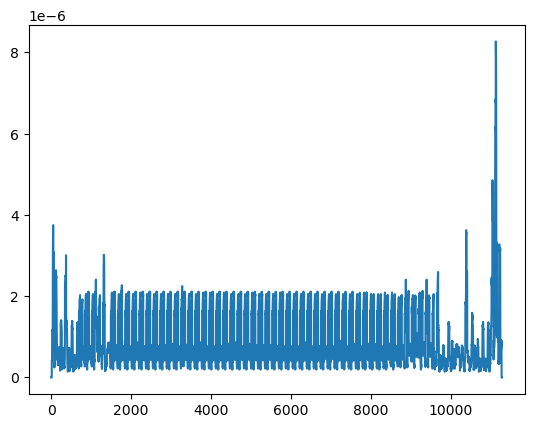

 39%|████████████████▍                         | 39/100 [02:14<03:05,  3.04s/it]

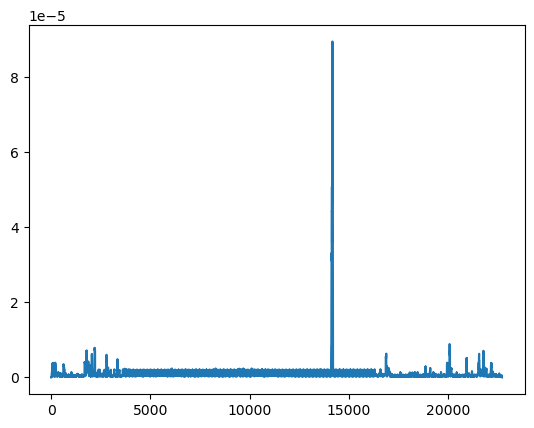

 40%|████████████████▊                         | 40/100 [02:18<03:24,  3.42s/it]

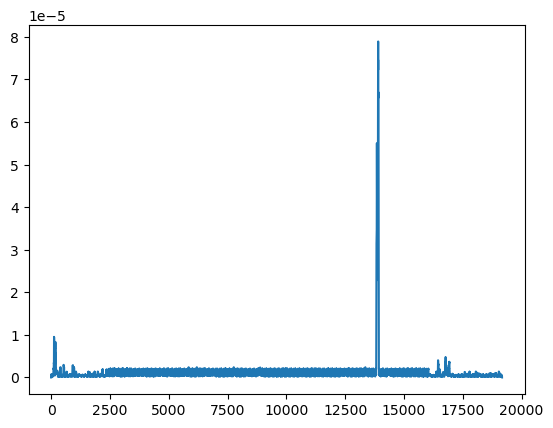

 41%|█████████████████▏                        | 41/100 [02:22<03:25,  3.48s/it]

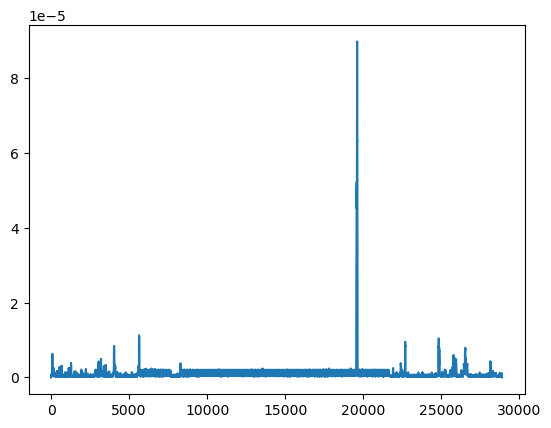

 42%|█████████████████▋                        | 42/100 [02:28<03:59,  4.13s/it]

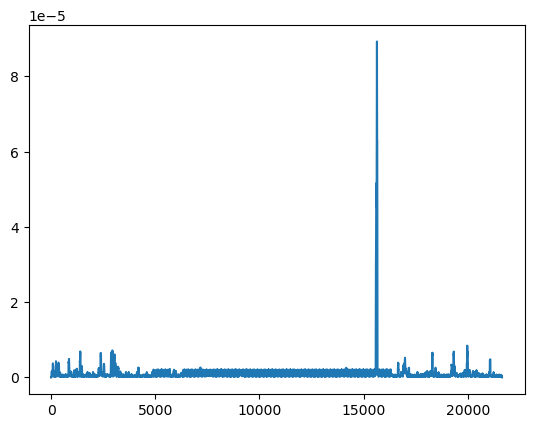

 43%|██████████████████                        | 43/100 [02:32<03:53,  4.09s/it]

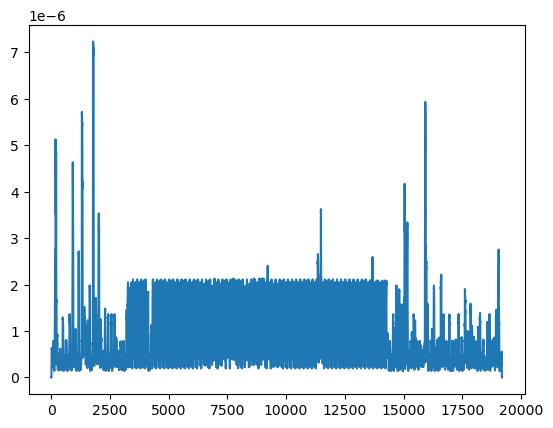

 44%|██████████████████▍                       | 44/100 [02:35<03:44,  4.00s/it]

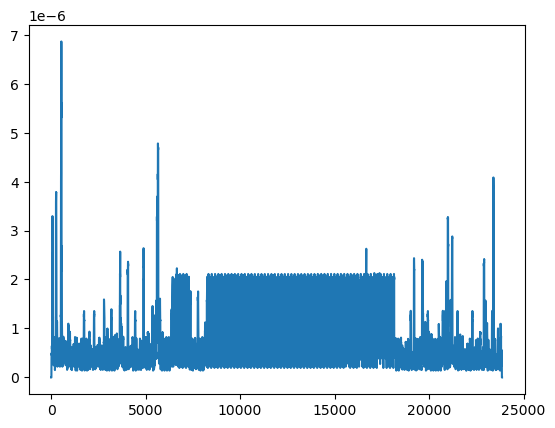

 45%|██████████████████▉                       | 45/100 [02:40<03:49,  4.17s/it]

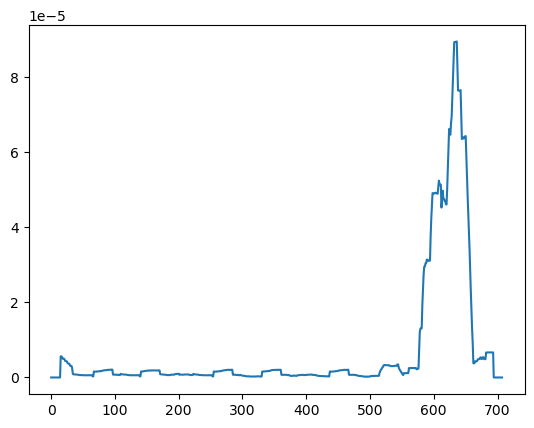

 46%|███████████████████▎                      | 46/100 [02:40<02:42,  3.01s/it]

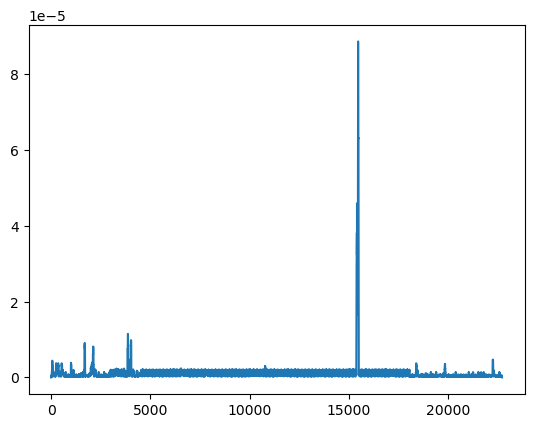

 47%|███████████████████▋                      | 47/100 [02:44<02:58,  3.37s/it]

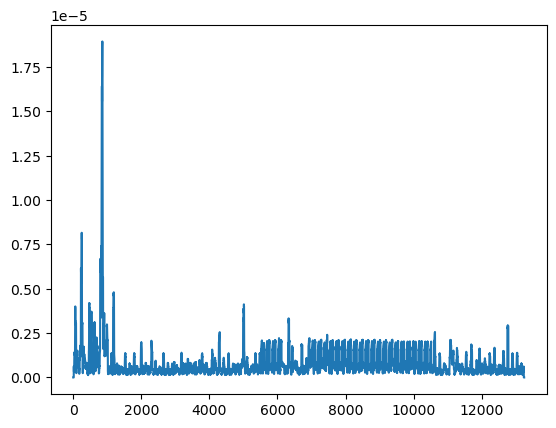

 48%|████████████████████▏                     | 48/100 [02:47<02:41,  3.12s/it]

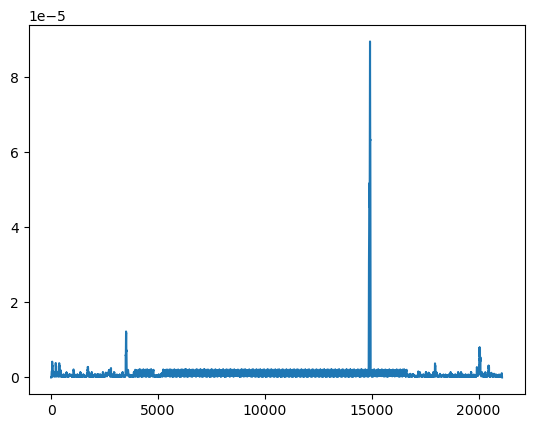

 49%|████████████████████▌                     | 49/100 [02:51<02:51,  3.36s/it]

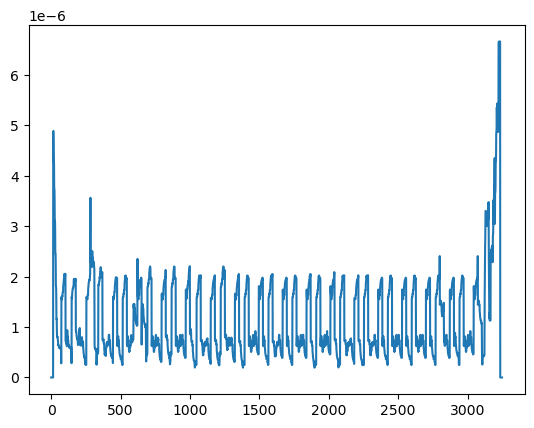

 50%|█████████████████████                     | 50/100 [02:52<02:08,  2.57s/it]

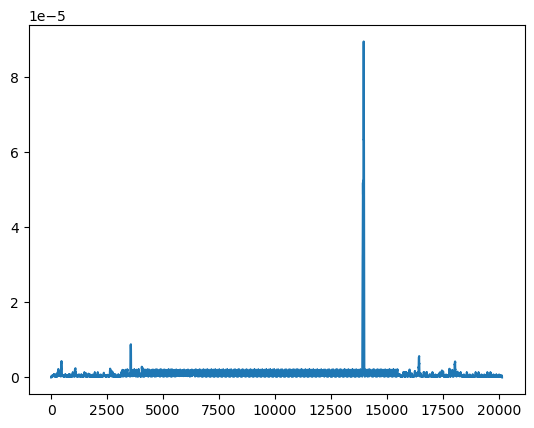

 51%|█████████████████████▍                    | 51/100 [02:55<02:23,  2.93s/it]

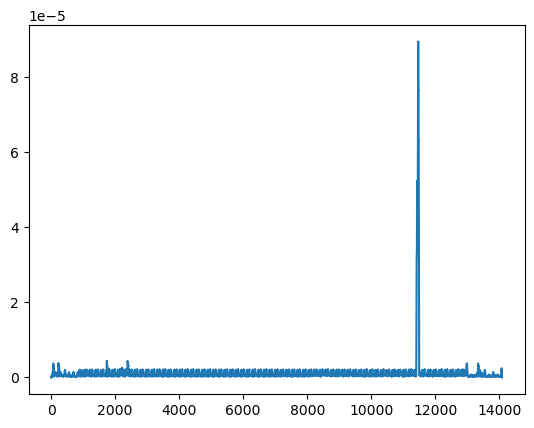

 52%|█████████████████████▊                    | 52/100 [02:58<02:17,  2.85s/it]

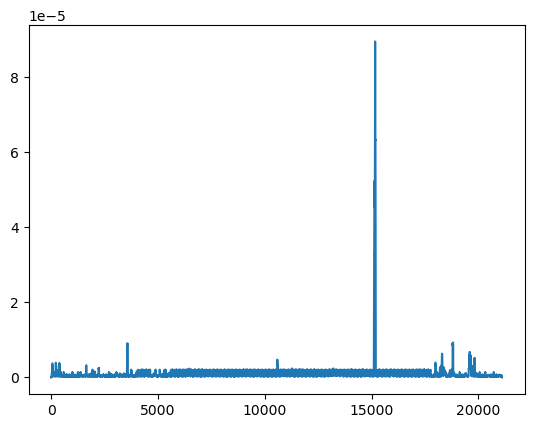

 53%|██████████████████████▎                   | 53/100 [03:02<02:30,  3.19s/it]

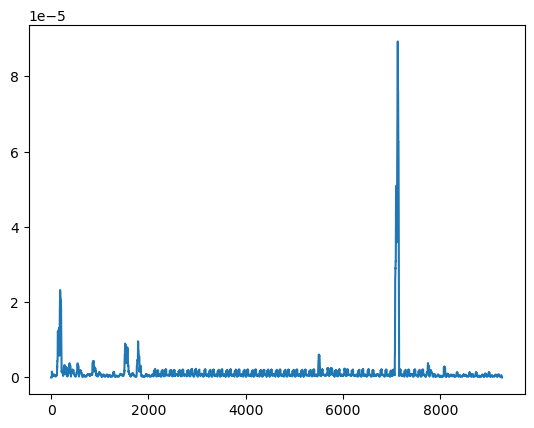

 54%|██████████████████████▋                   | 54/100 [03:04<02:08,  2.79s/it]

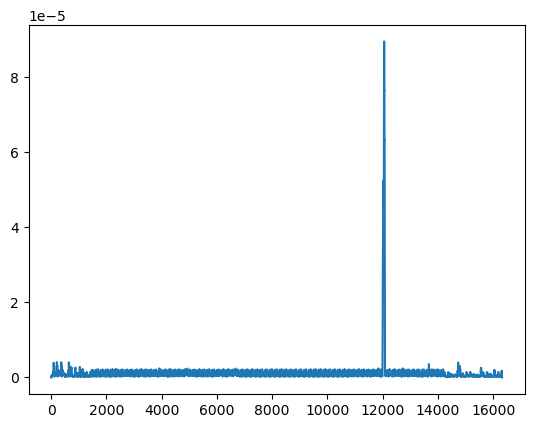

 55%|███████████████████████                   | 55/100 [03:07<02:10,  2.90s/it]

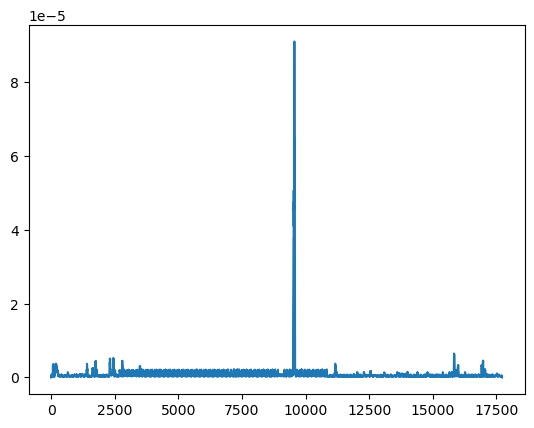

 56%|███████████████████████▌                  | 56/100 [03:11<02:14,  3.05s/it]

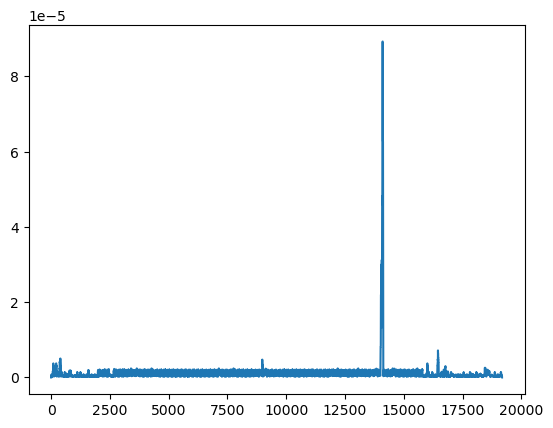

 57%|███████████████████████▉                  | 57/100 [03:14<02:19,  3.24s/it]

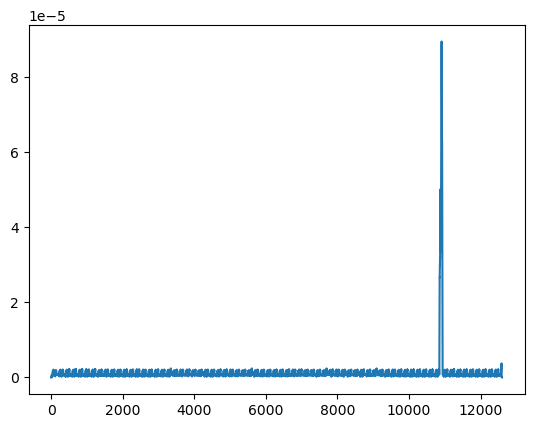

 58%|████████████████████████▎                 | 58/100 [03:17<02:05,  2.99s/it]

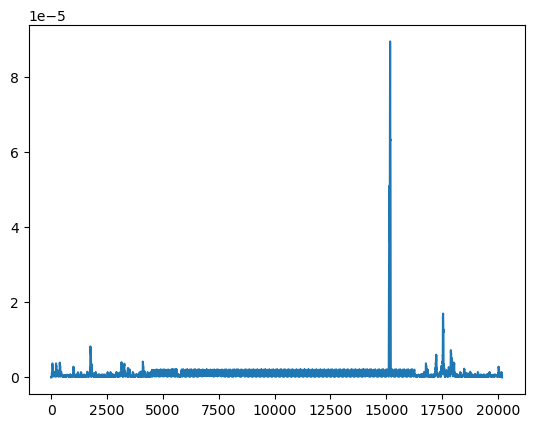

 59%|████████████████████████▊                 | 59/100 [03:20<02:12,  3.24s/it]

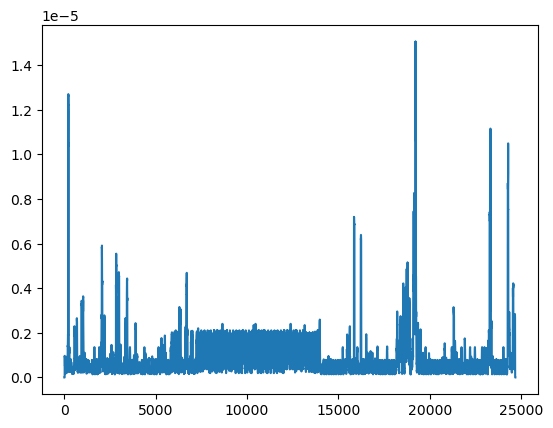

 60%|█████████████████████████▏                | 60/100 [03:25<02:28,  3.72s/it]

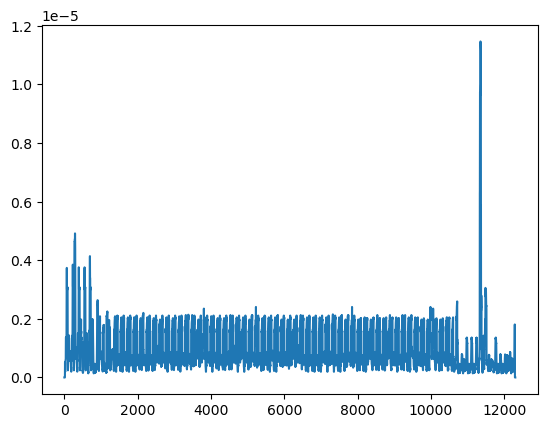

 61%|█████████████████████████▌                | 61/100 [03:28<02:08,  3.31s/it]

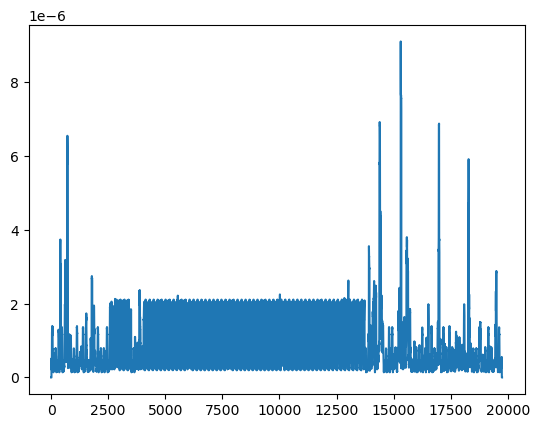

 62%|██████████████████████████                | 62/100 [03:31<02:10,  3.43s/it]

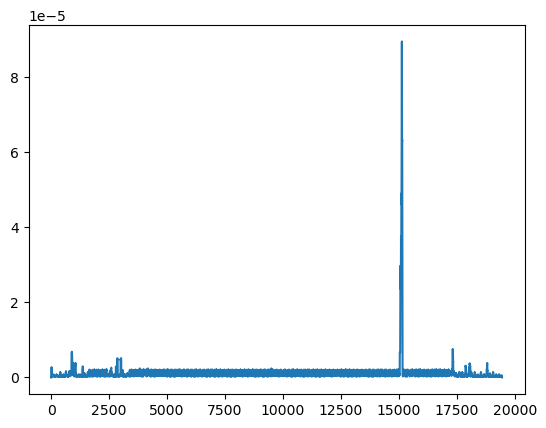

 63%|██████████████████████████▍               | 63/100 [03:35<02:10,  3.52s/it]

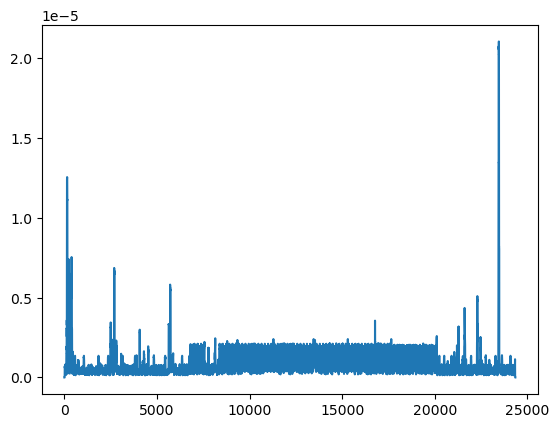

 64%|██████████████████████████▉               | 64/100 [03:40<02:20,  3.89s/it]

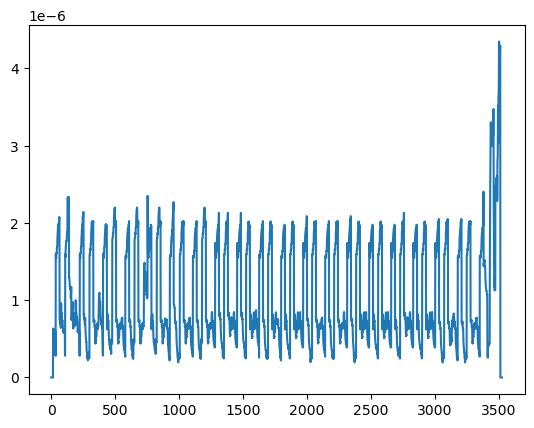

 65%|███████████████████████████▎              | 65/100 [03:41<01:43,  2.96s/it]

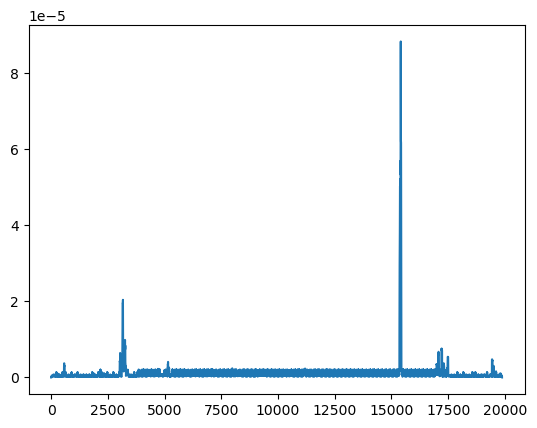

 66%|███████████████████████████▋              | 66/100 [03:44<01:48,  3.18s/it]

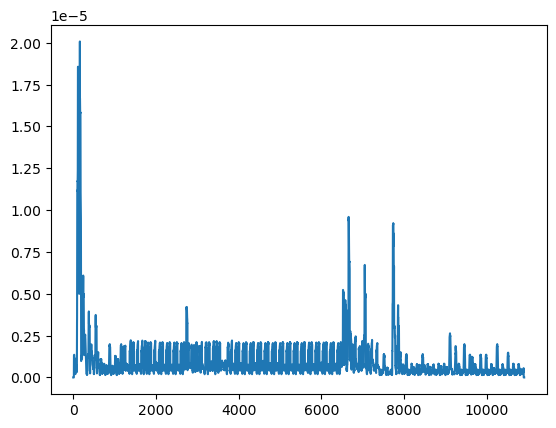

 67%|████████████████████████████▏             | 67/100 [03:46<01:34,  2.85s/it]

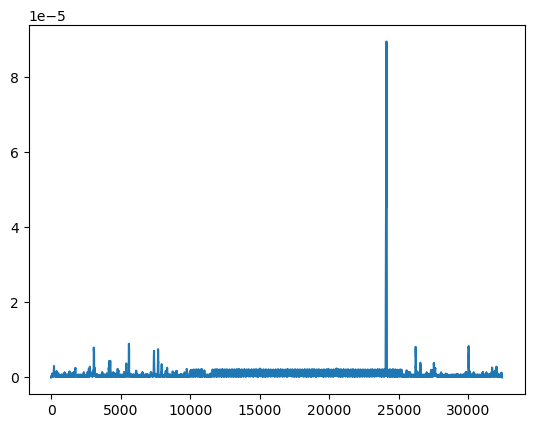

 68%|████████████████████████████▌             | 68/100 [03:53<02:04,  3.88s/it]

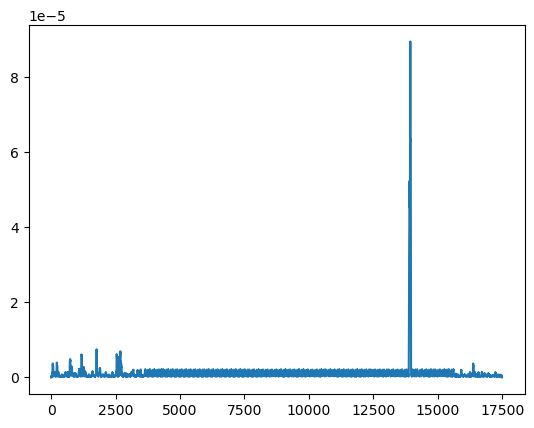

 69%|████████████████████████████▉             | 69/100 [03:56<01:54,  3.68s/it]

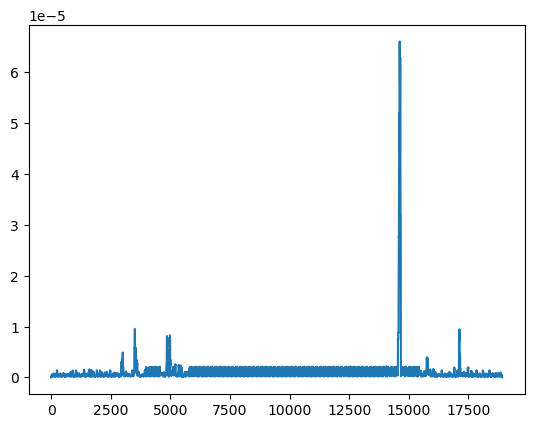

 70%|█████████████████████████████▍            | 70/100 [04:00<01:52,  3.74s/it]

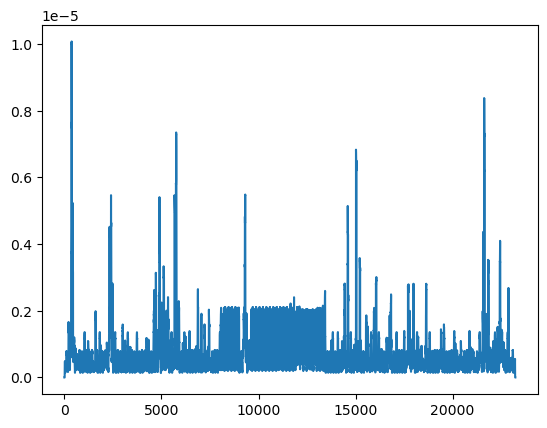

 71%|█████████████████████████████▊            | 71/100 [04:04<01:55,  3.98s/it]

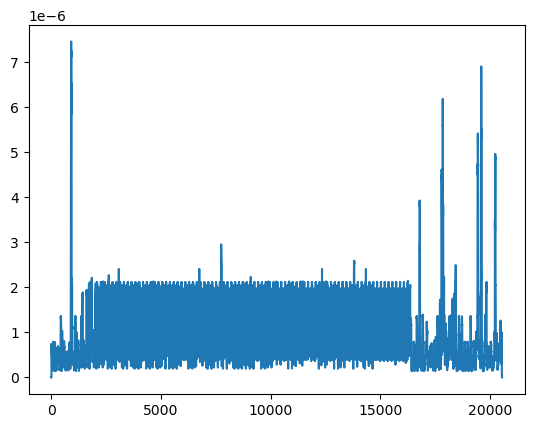

 72%|██████████████████████████████▏           | 72/100 [04:08<01:50,  3.95s/it]

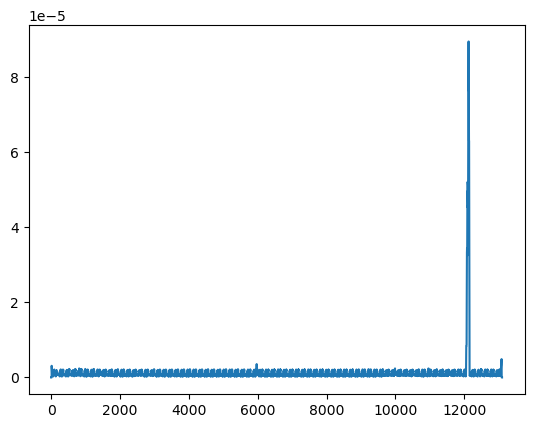

 73%|██████████████████████████████▋           | 73/100 [04:11<01:34,  3.50s/it]

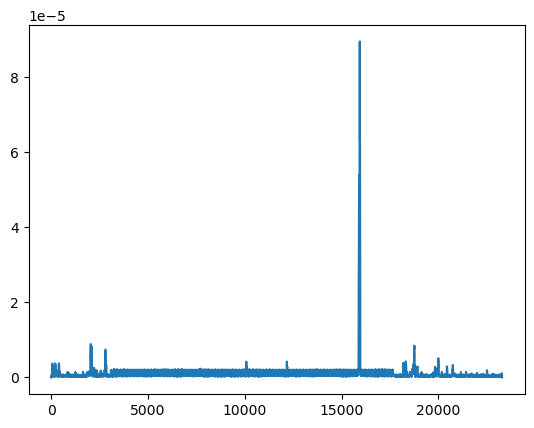

 74%|███████████████████████████████           | 74/100 [04:15<01:38,  3.77s/it]

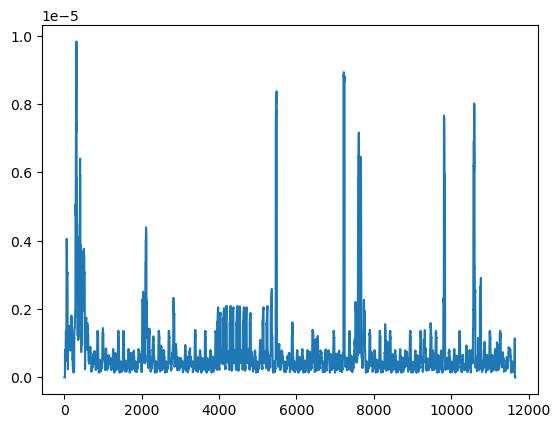

 75%|███████████████████████████████▌          | 75/100 [04:17<01:23,  3.32s/it]

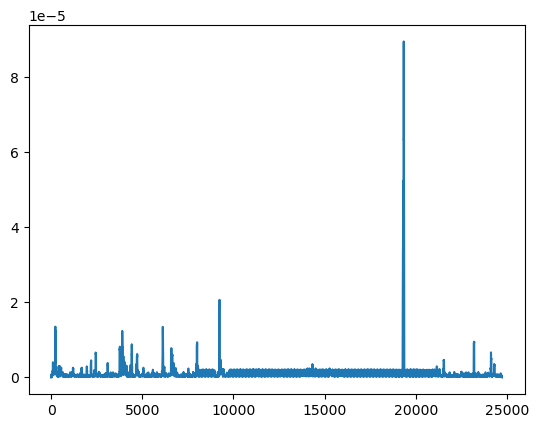

 76%|███████████████████████████████▉          | 76/100 [04:22<01:29,  3.74s/it]

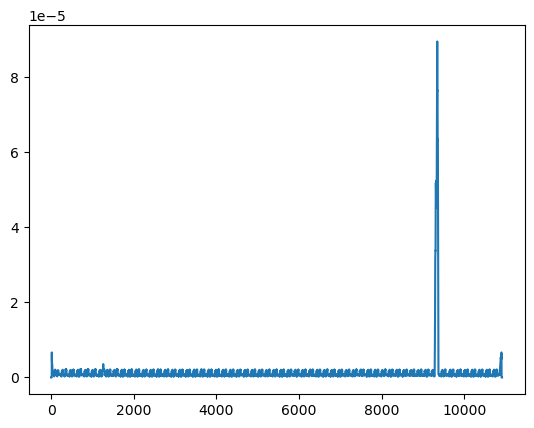

 77%|████████████████████████████████▎         | 77/100 [04:24<01:14,  3.26s/it]

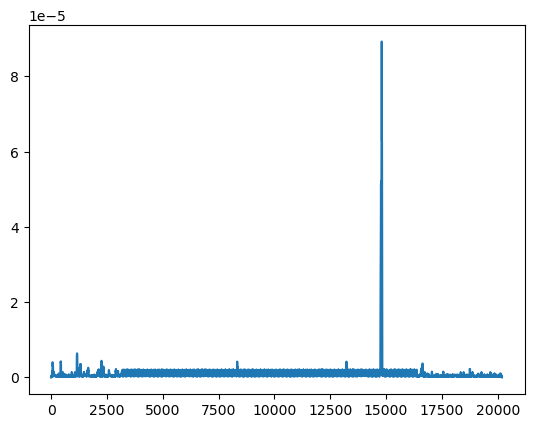

 78%|████████████████████████████████▊         | 78/100 [04:28<01:14,  3.40s/it]

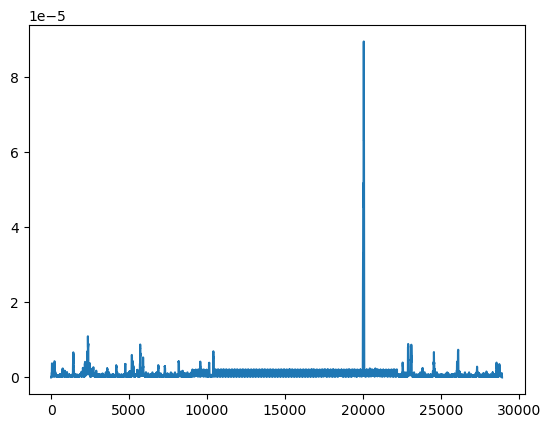

 79%|█████████████████████████████████▏        | 79/100 [04:33<01:24,  4.03s/it]

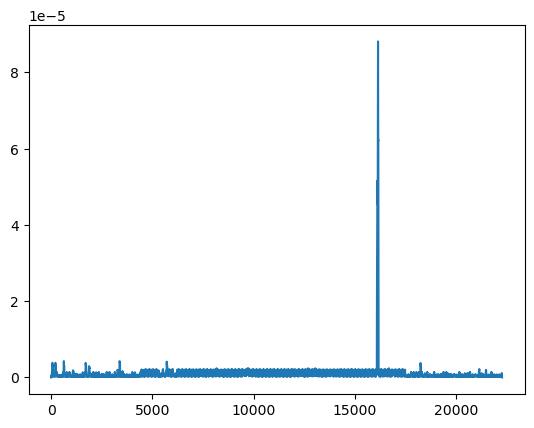

 80%|█████████████████████████████████▌        | 80/100 [04:38<01:21,  4.10s/it]

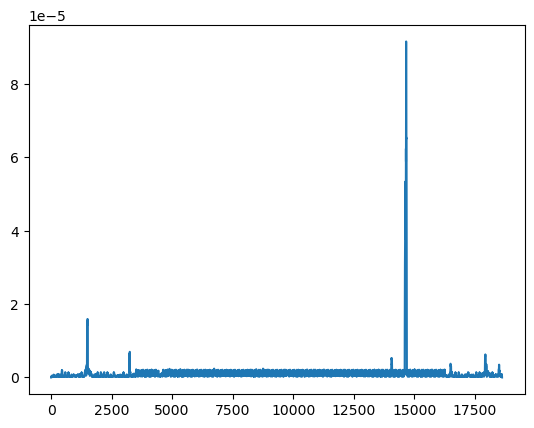

 81%|██████████████████████████████████        | 81/100 [04:41<01:14,  3.92s/it]

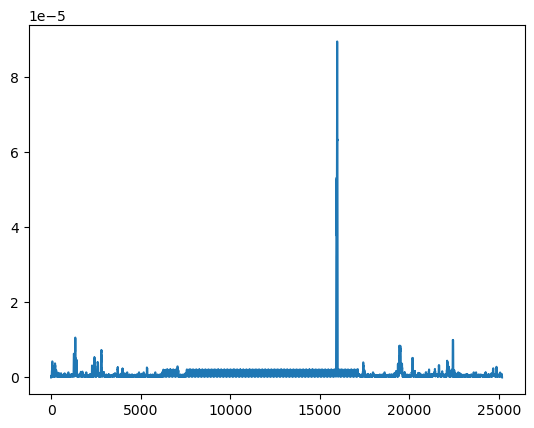

 82%|██████████████████████████████████▍       | 82/100 [04:46<01:15,  4.17s/it]

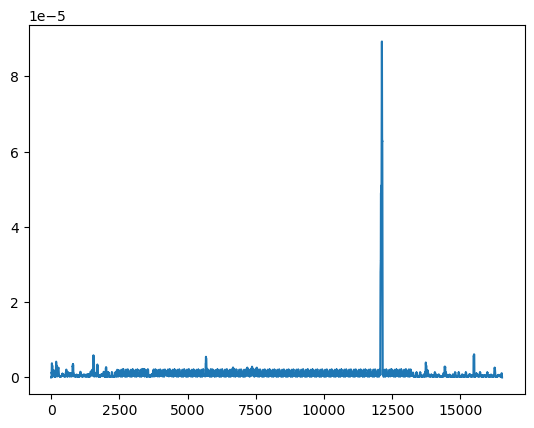

 83%|██████████████████████████████████▊       | 83/100 [04:49<01:05,  3.86s/it]

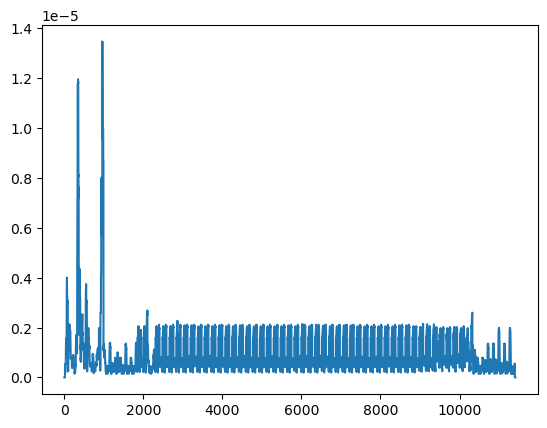

 84%|███████████████████████████████████▎      | 84/100 [04:51<00:53,  3.36s/it]

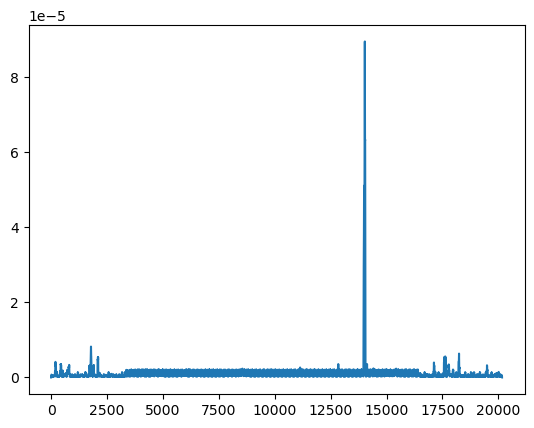

 85%|███████████████████████████████████▋      | 85/100 [04:55<00:52,  3.48s/it]

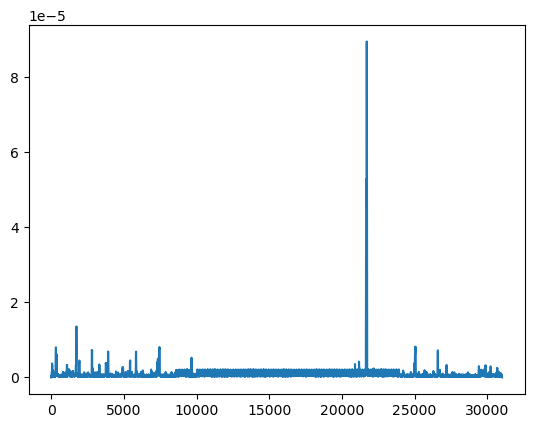

 86%|████████████████████████████████████      | 86/100 [05:01<01:00,  4.29s/it]

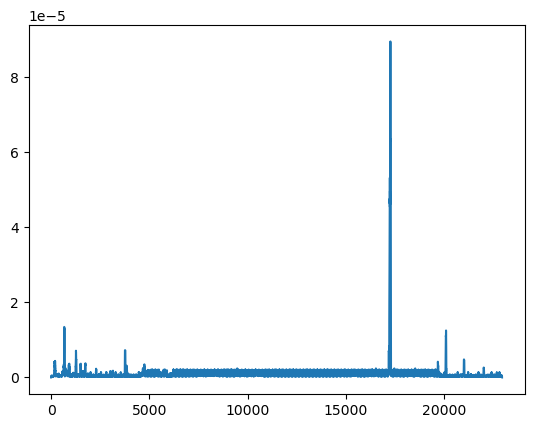

 87%|████████████████████████████████████▌     | 87/100 [05:06<00:56,  4.32s/it]

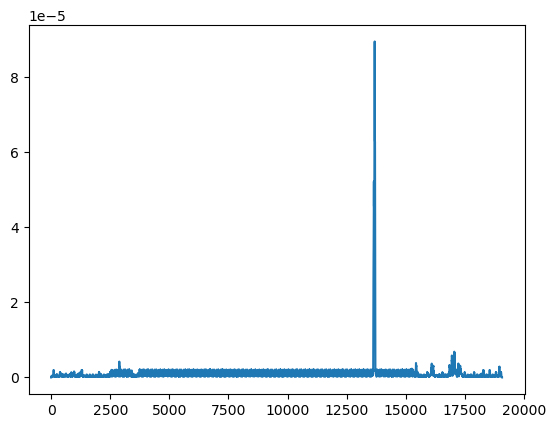

 88%|████████████████████████████████████▉     | 88/100 [05:09<00:49,  4.10s/it]

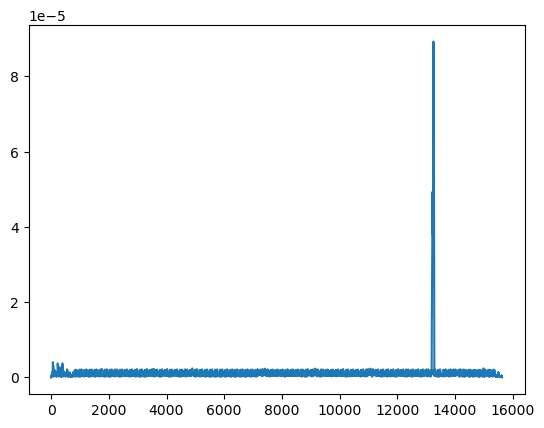

 89%|█████████████████████████████████████▍    | 89/100 [05:12<00:41,  3.77s/it]

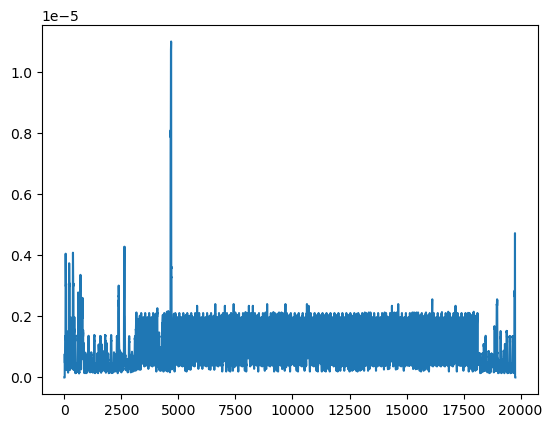

 90%|█████████████████████████████████████▊    | 90/100 [05:16<00:37,  3.74s/it]

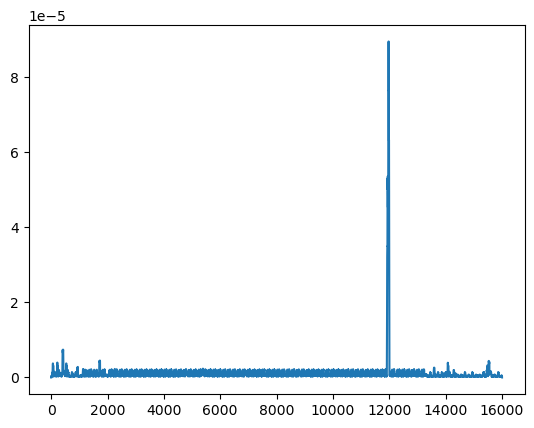

 91%|██████████████████████████████████████▏   | 91/100 [05:19<00:31,  3.53s/it]

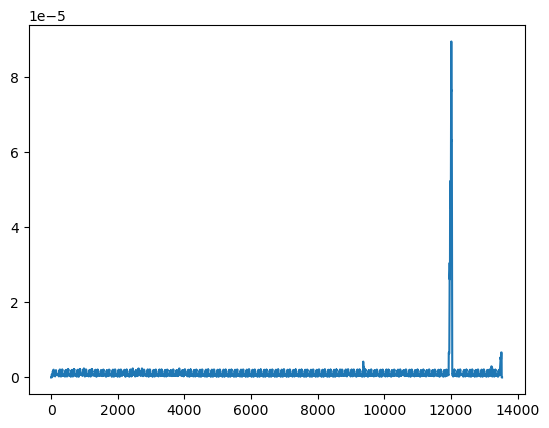

 92%|██████████████████████████████████████▋   | 92/100 [05:21<00:25,  3.24s/it]

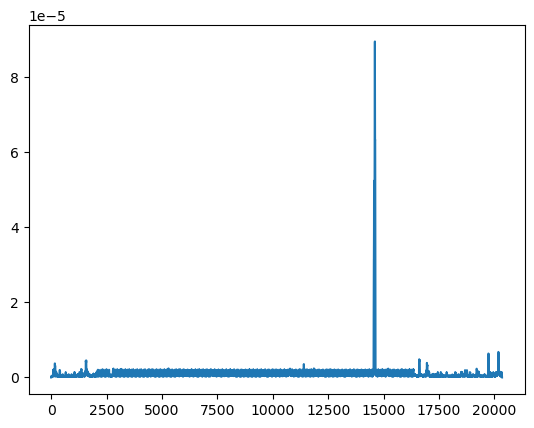

 93%|███████████████████████████████████████   | 93/100 [05:25<00:24,  3.46s/it]

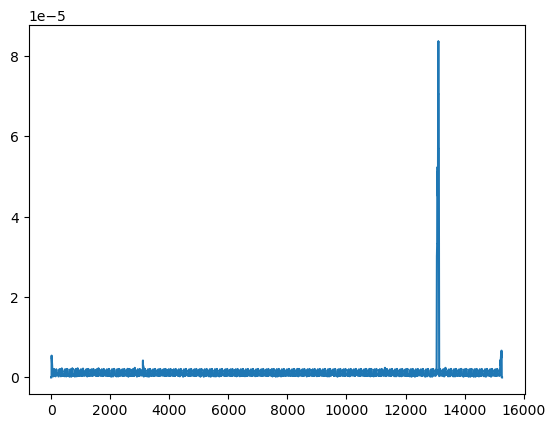

 94%|███████████████████████████████████████▍  | 94/100 [05:28<00:19,  3.30s/it]

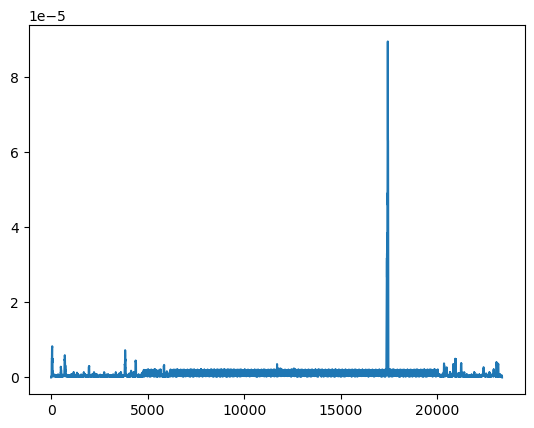

 95%|███████████████████████████████████████▉  | 95/100 [05:33<00:18,  3.66s/it]

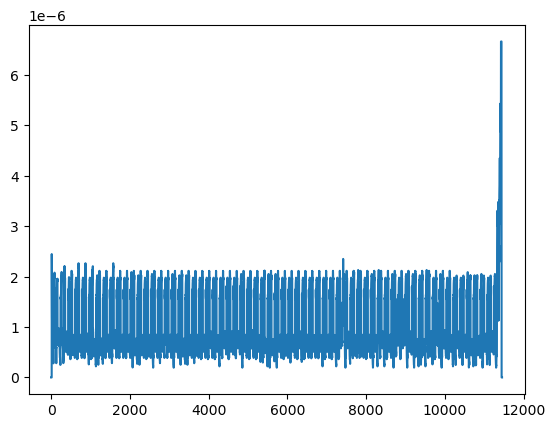

 96%|████████████████████████████████████████▎ | 96/100 [05:35<00:12,  3.22s/it]

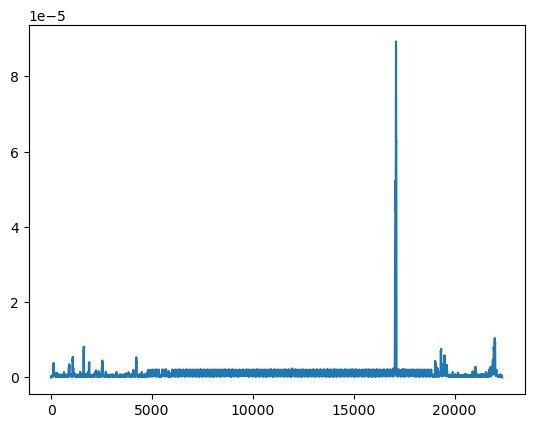

 97%|████████████████████████████████████████▋ | 97/100 [05:39<00:10,  3.54s/it]

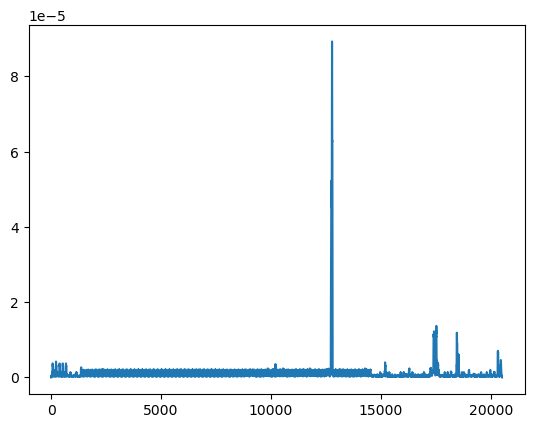

 98%|█████████████████████████████████████████▏| 98/100 [05:43<00:07,  3.64s/it]

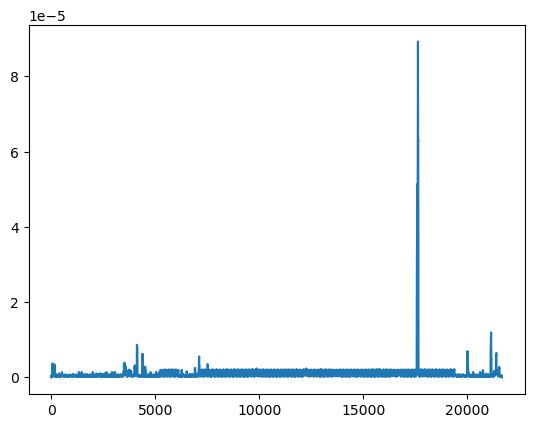

 99%|█████████████████████████████████████████▌| 99/100 [05:48<00:03,  3.86s/it]

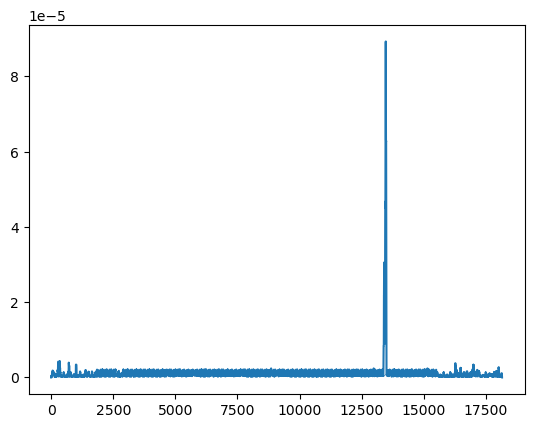

  0%|                                                   | 0/300 [00:00<?, ?it/s]

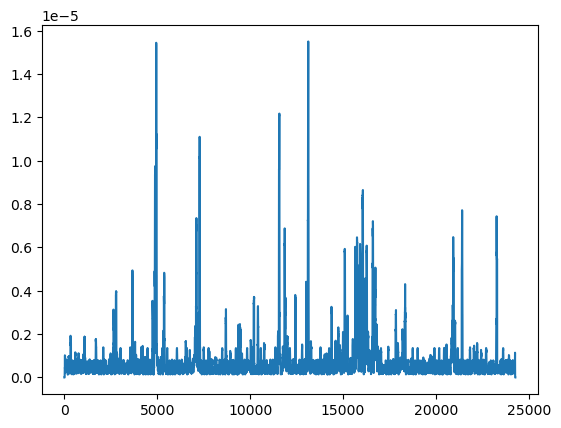

  0%|▏                                          | 1/300 [00:04<22:11,  4.45s/it]

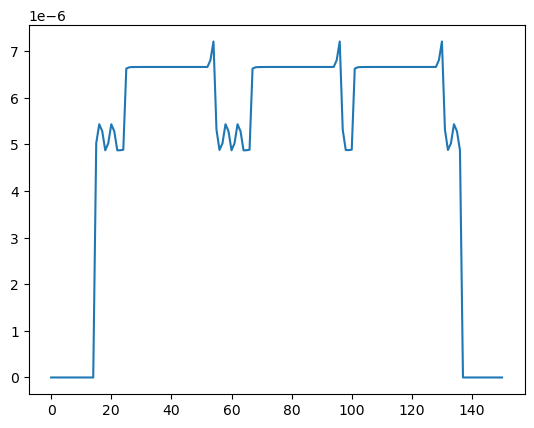

  1%|▎                                          | 2/300 [00:04<09:35,  1.93s/it]

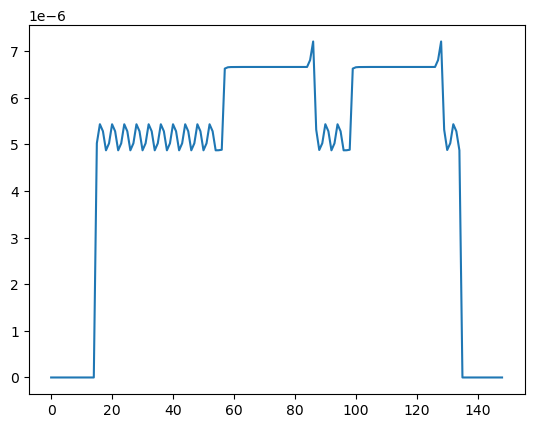

  1%|▍                                          | 3/300 [00:04<05:30,  1.11s/it]

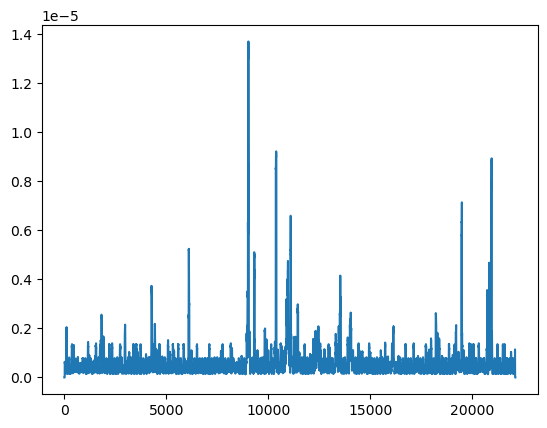

  1%|▌                                          | 4/300 [00:08<11:13,  2.28s/it]

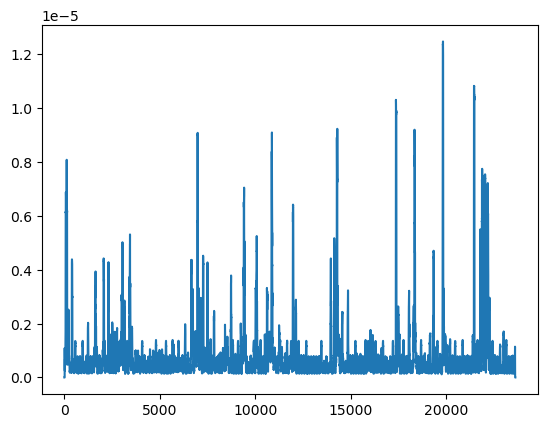

  2%|▋                                          | 5/300 [00:13<15:20,  3.12s/it]

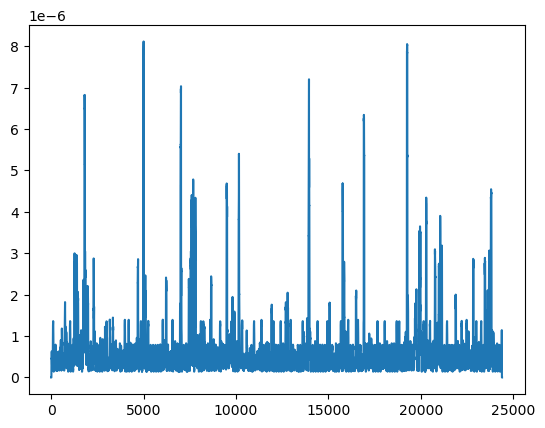

  2%|▊                                          | 6/300 [00:18<18:14,  3.72s/it]

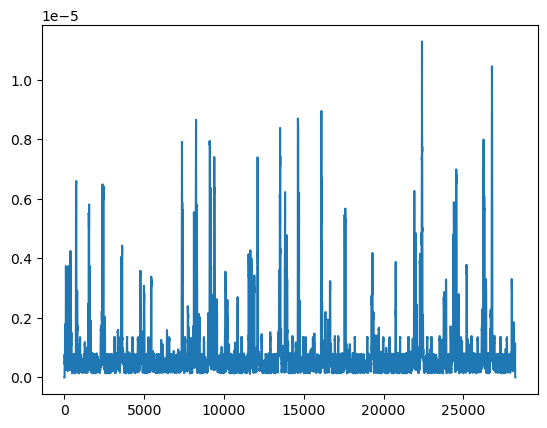

  2%|█                                          | 7/300 [00:23<20:26,  4.18s/it]

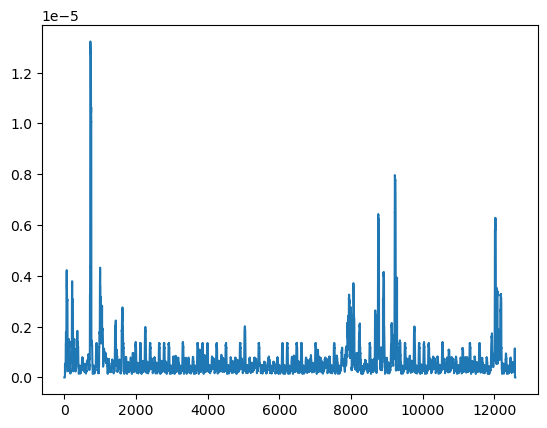

  3%|█▏                                         | 8/300 [00:25<17:30,  3.60s/it]

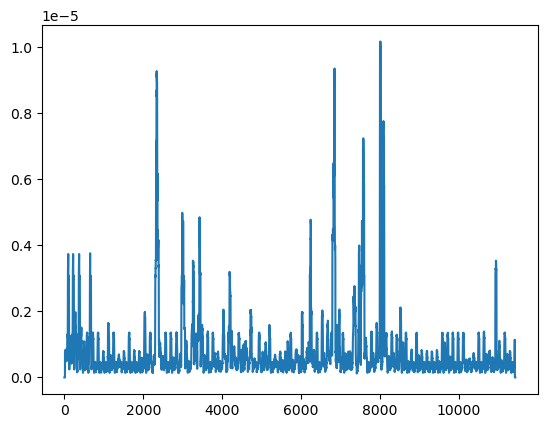

  3%|█▎                                         | 9/300 [00:27<15:11,  3.13s/it]

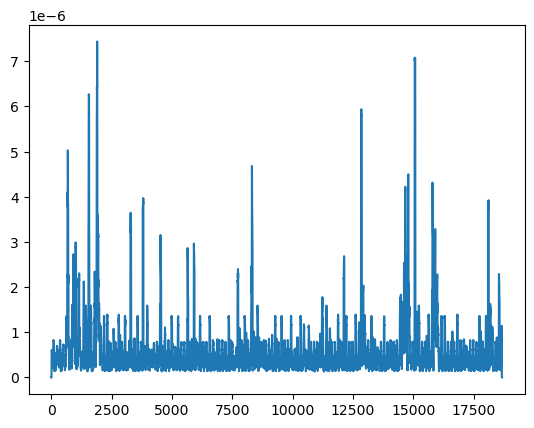

  3%|█▍                                        | 10/300 [00:31<15:33,  3.22s/it]

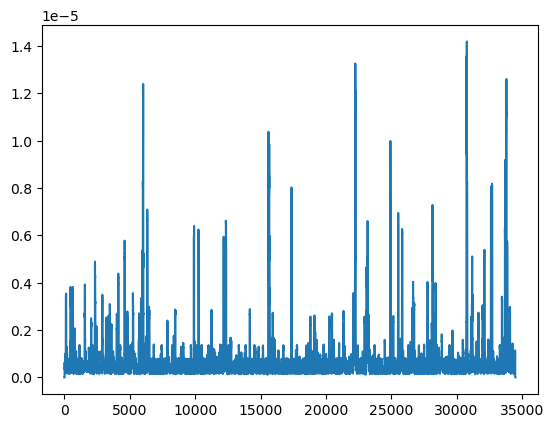

  4%|█▌                                        | 11/300 [00:38<20:40,  4.29s/it]

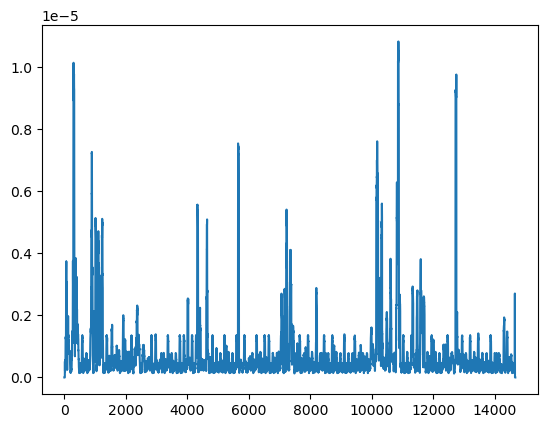

  4%|█▋                                        | 12/300 [00:40<18:18,  3.81s/it]

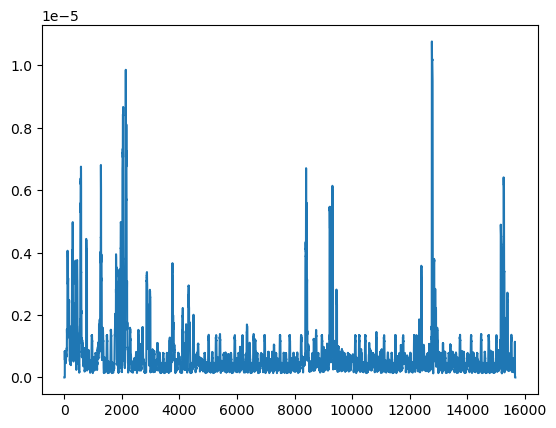

  4%|█▊                                        | 13/300 [00:43<16:55,  3.54s/it]

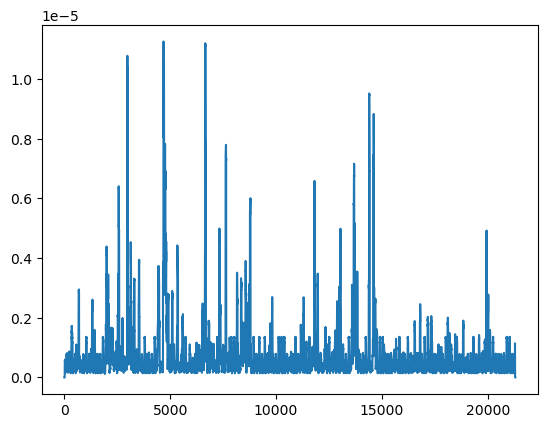

  5%|█▉                                        | 14/300 [00:47<17:36,  3.69s/it]

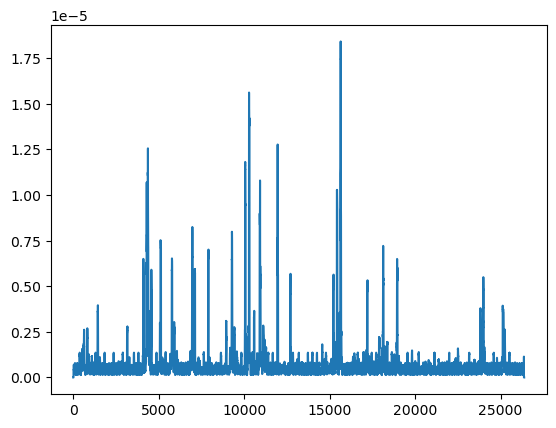

  5%|██                                        | 15/300 [00:52<19:27,  4.10s/it]

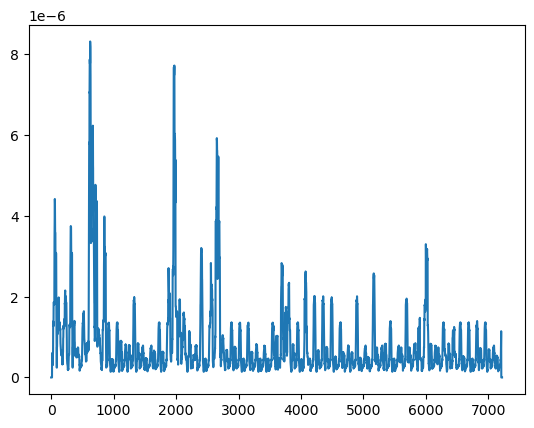

  5%|██▏                                       | 16/300 [00:54<15:30,  3.27s/it]

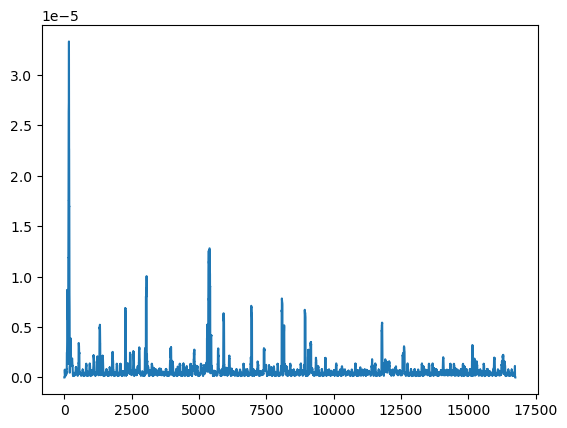

  6%|██▍                                       | 17/300 [00:57<15:08,  3.21s/it]

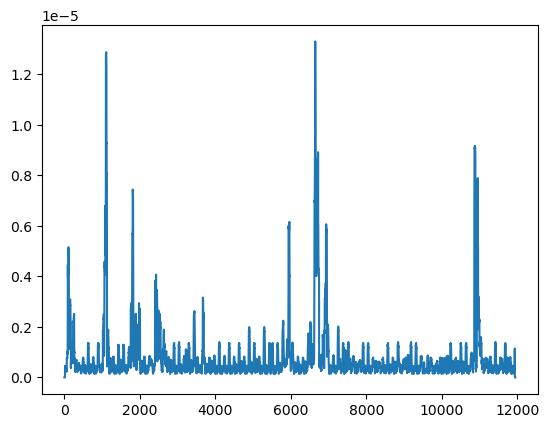

  6%|██▌                                       | 18/300 [00:59<13:41,  2.91s/it]

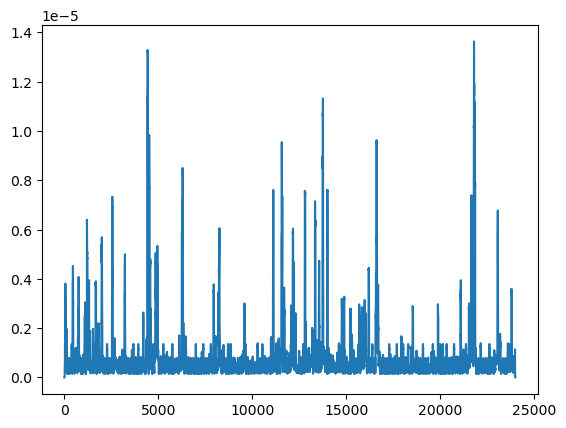

  6%|██▋                                       | 19/300 [01:04<16:38,  3.55s/it]

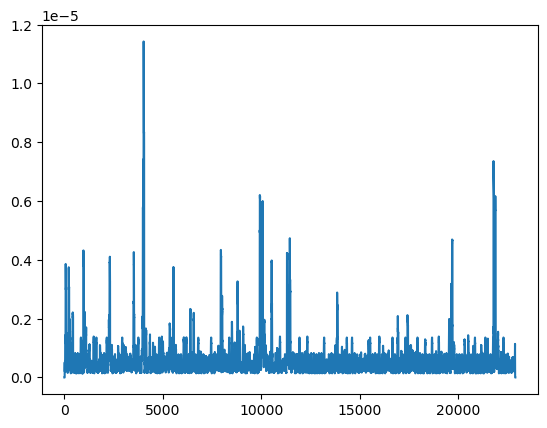

  7%|██▊                                       | 20/300 [01:08<17:45,  3.80s/it]

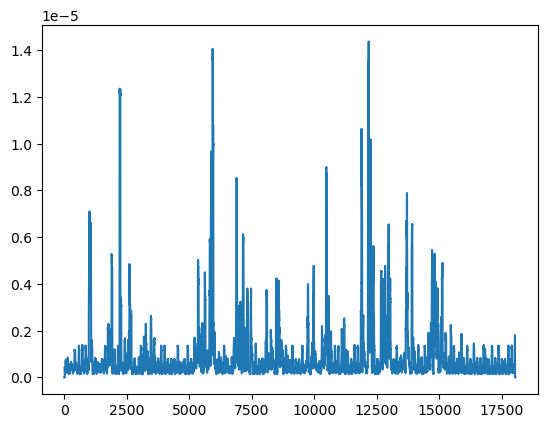

  7%|██▉                                       | 21/300 [01:12<17:02,  3.67s/it]

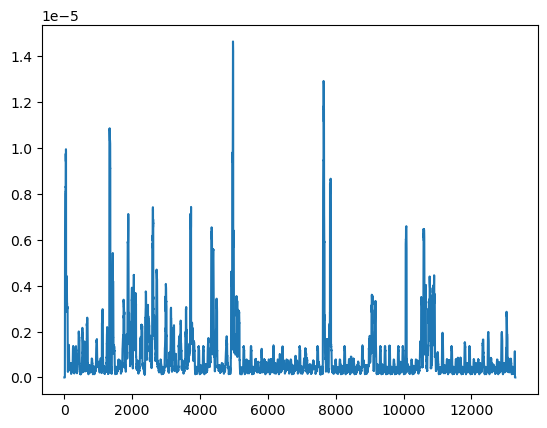

  7%|███                                       | 22/300 [01:14<15:23,  3.32s/it]

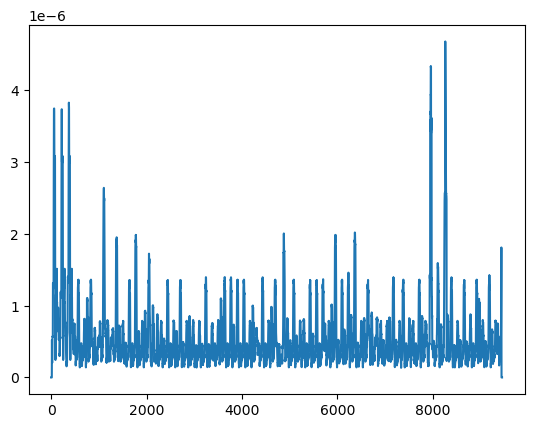

  8%|███▏                                      | 23/300 [01:16<13:15,  2.87s/it]

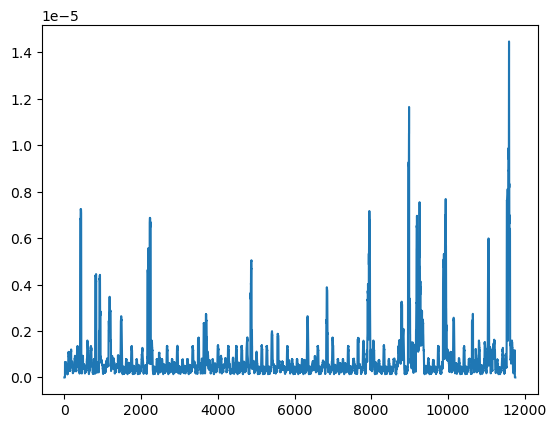

  8%|███▎                                      | 24/300 [01:18<12:24,  2.70s/it]

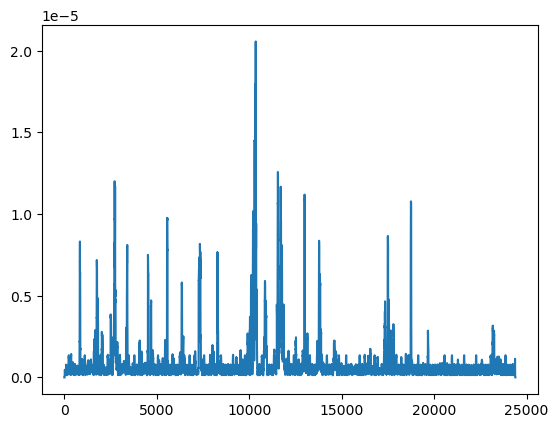

  8%|███▌                                      | 25/300 [01:23<15:14,  3.33s/it]

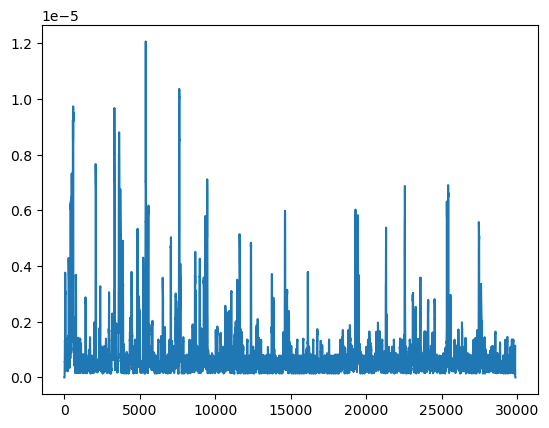

  9%|███▋                                      | 26/300 [01:29<18:44,  4.10s/it]

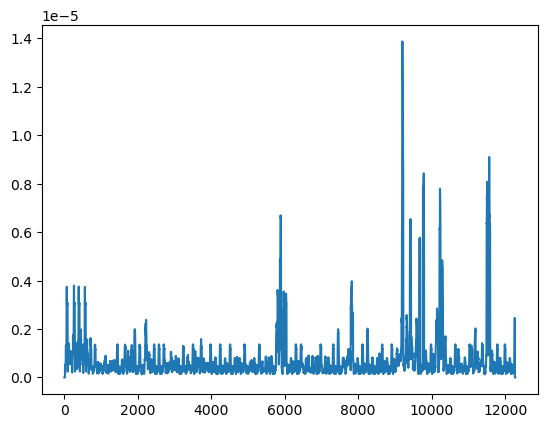

  9%|███▊                                      | 27/300 [01:31<16:17,  3.58s/it]

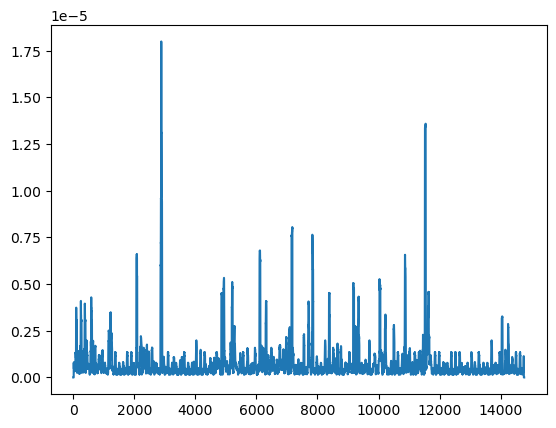

  9%|███▉                                      | 28/300 [01:34<15:08,  3.34s/it]

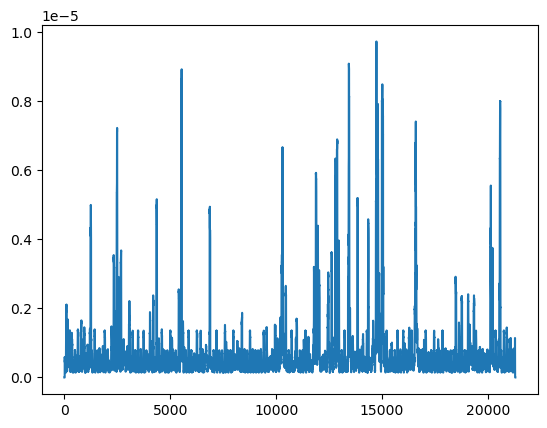

 10%|████                                      | 29/300 [01:38<15:52,  3.51s/it]

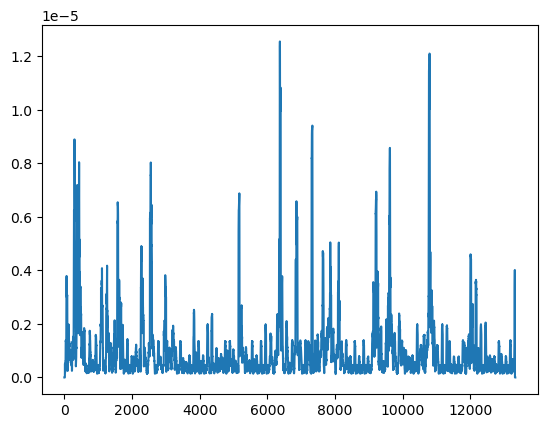

 10%|████▏                                     | 30/300 [01:41<14:30,  3.23s/it]

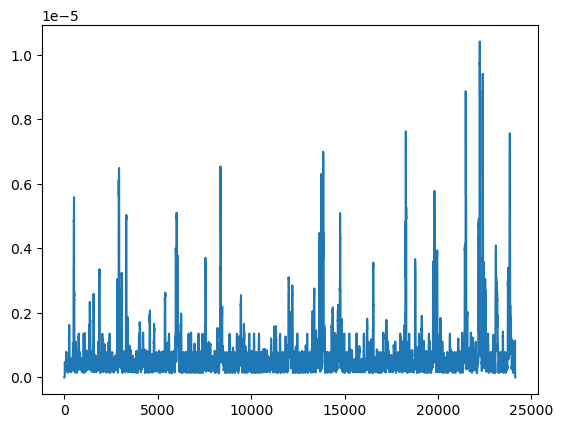

 10%|████▎                                     | 31/300 [01:45<16:18,  3.64s/it]

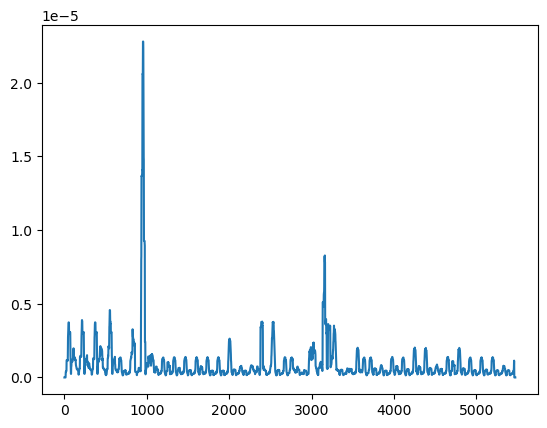

 11%|████▍                                     | 32/300 [01:46<12:51,  2.88s/it]

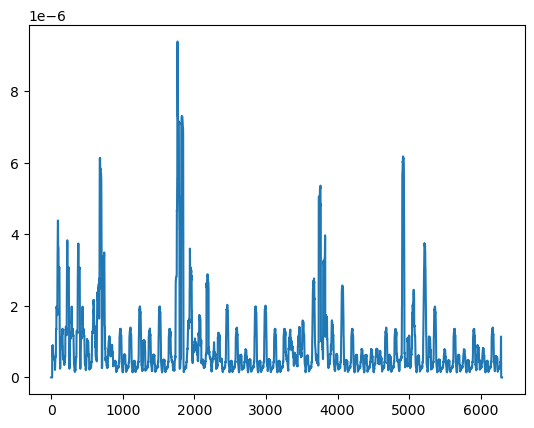

 11%|████▌                                     | 33/300 [01:48<10:35,  2.38s/it]

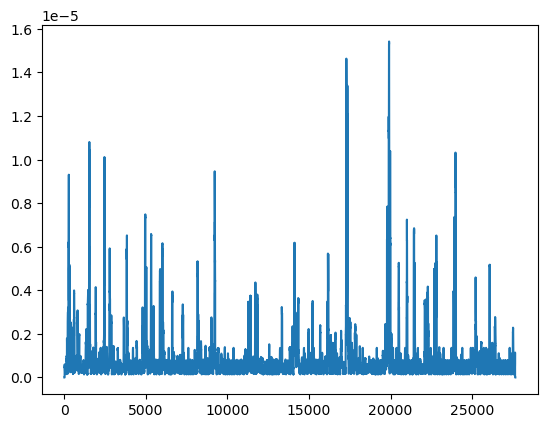

 11%|████▊                                     | 34/300 [01:53<14:25,  3.25s/it]

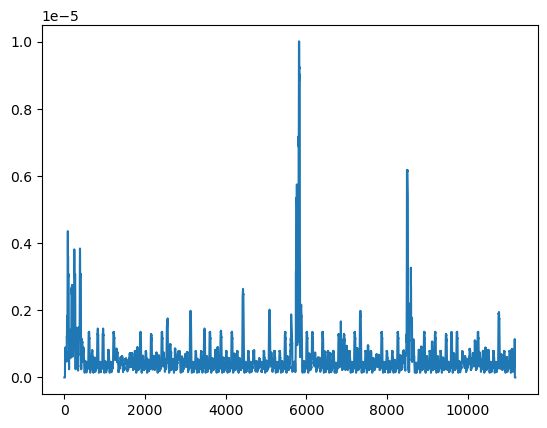

 12%|████▉                                     | 35/300 [01:55<12:47,  2.90s/it]

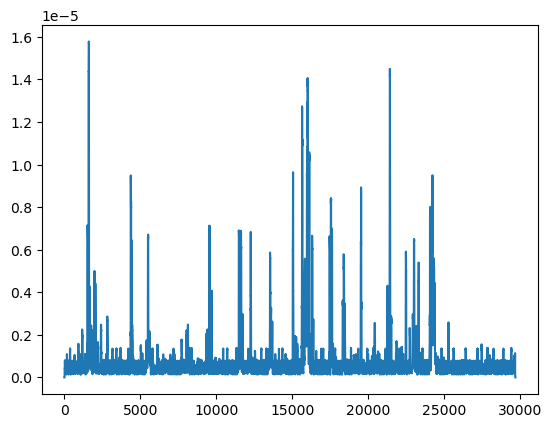

 12%|█████                                     | 36/300 [02:01<16:41,  3.79s/it]

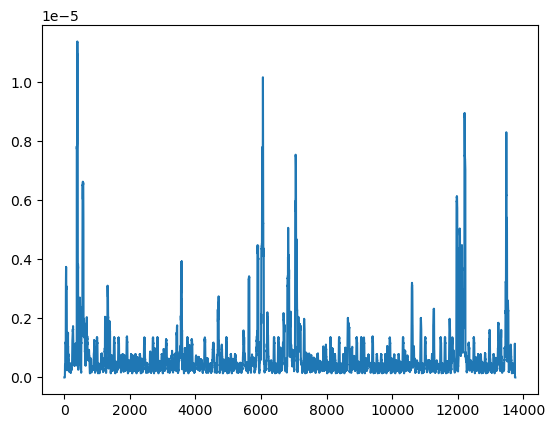

 12%|█████▏                                    | 37/300 [02:06<18:18,  4.18s/it]

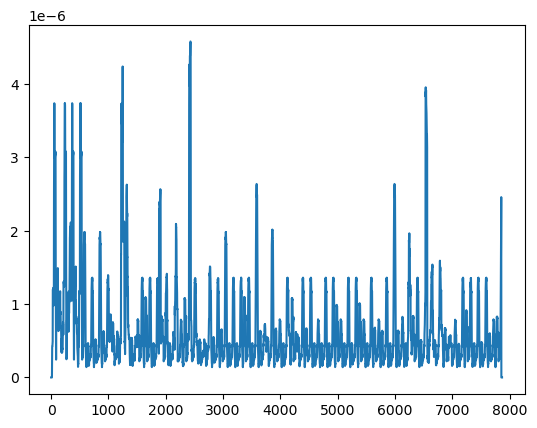

 13%|█████▎                                    | 38/300 [02:07<14:47,  3.39s/it]

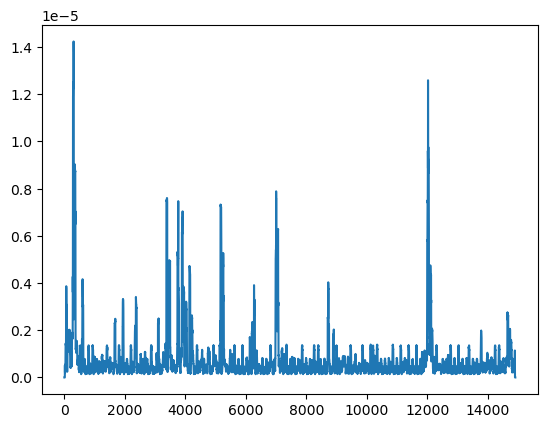

 13%|█████▍                                    | 39/300 [02:10<14:06,  3.24s/it]

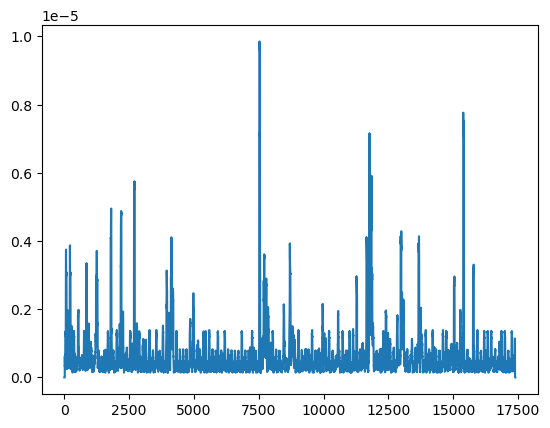

 13%|█████▌                                    | 40/300 [02:14<14:12,  3.28s/it]

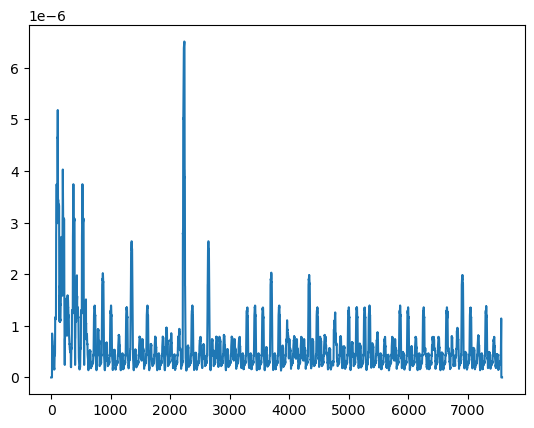

 14%|█████▋                                    | 41/300 [02:15<12:05,  2.80s/it]

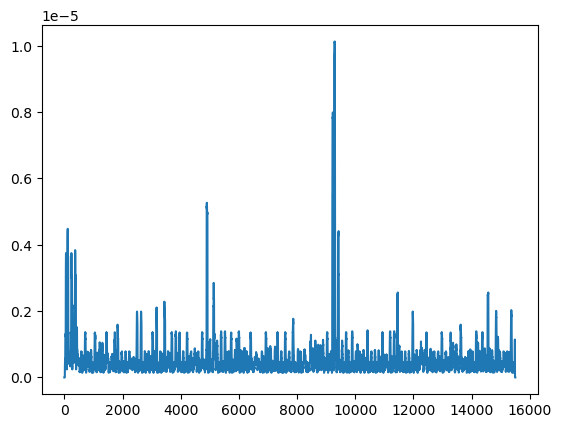

 14%|█████▉                                    | 42/300 [02:18<12:14,  2.85s/it]

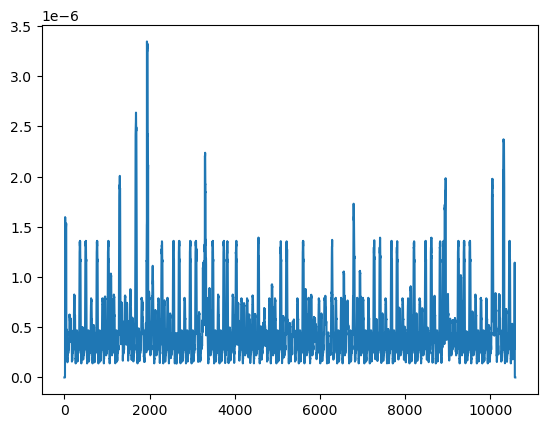

 14%|██████                                    | 43/300 [02:20<11:11,  2.61s/it]

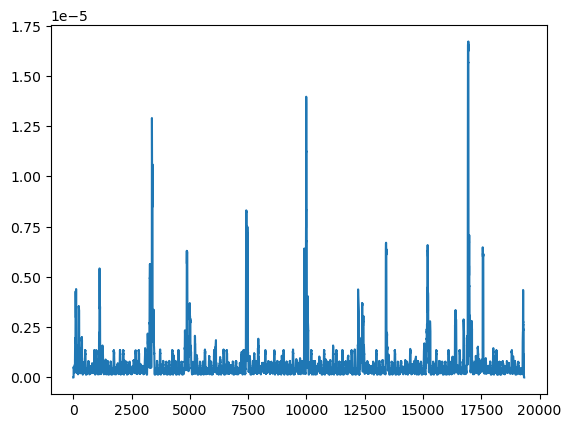

 15%|██████▏                                   | 44/300 [02:24<12:40,  2.97s/it]

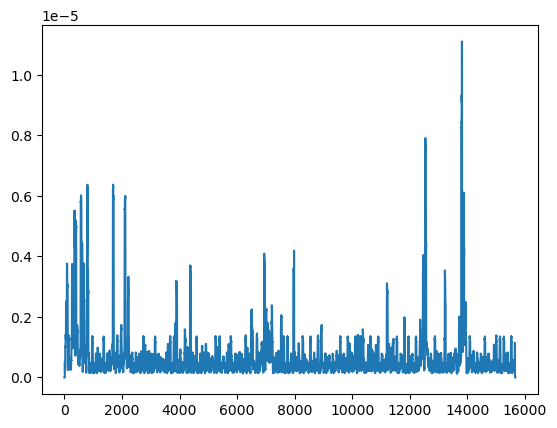

 15%|██████▎                                   | 45/300 [02:27<12:39,  2.98s/it]

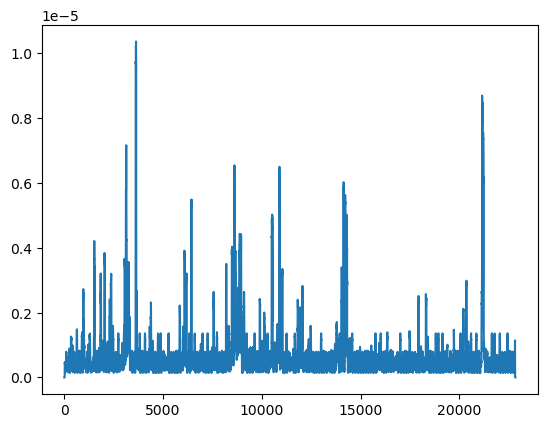

 15%|██████▍                                   | 46/300 [02:32<14:41,  3.47s/it]

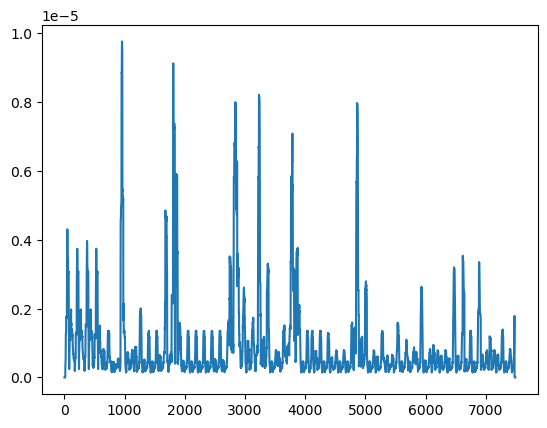

 16%|██████▌                                   | 47/300 [02:33<12:09,  2.88s/it]

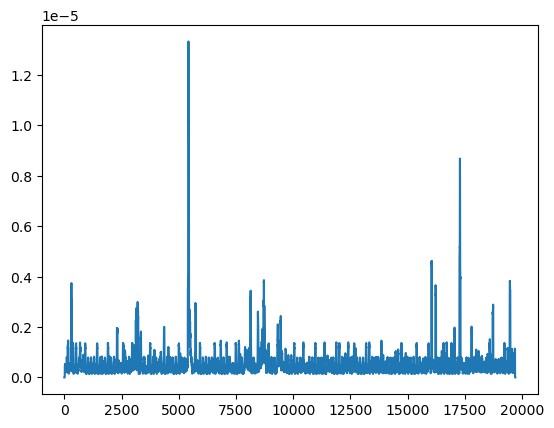

 16%|██████▋                                   | 48/300 [02:37<13:24,  3.19s/it]

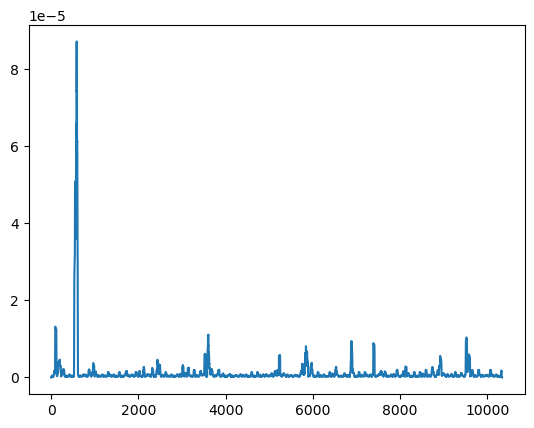

 16%|██████▊                                   | 49/300 [02:39<11:57,  2.86s/it]

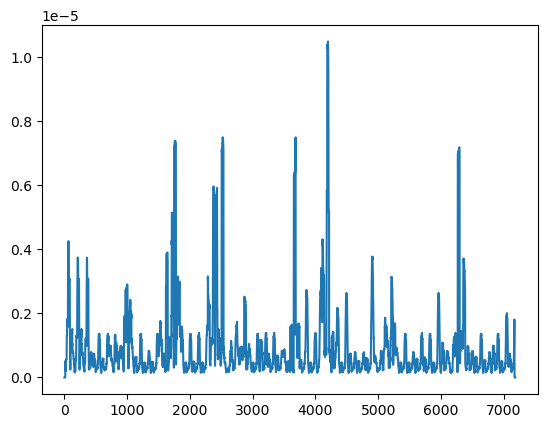

 17%|███████                                   | 50/300 [02:41<10:03,  2.41s/it]

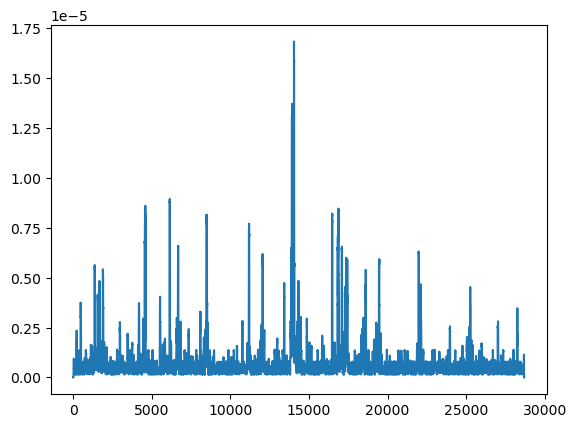

 17%|███████▏                                  | 51/300 [02:46<14:13,  3.43s/it]

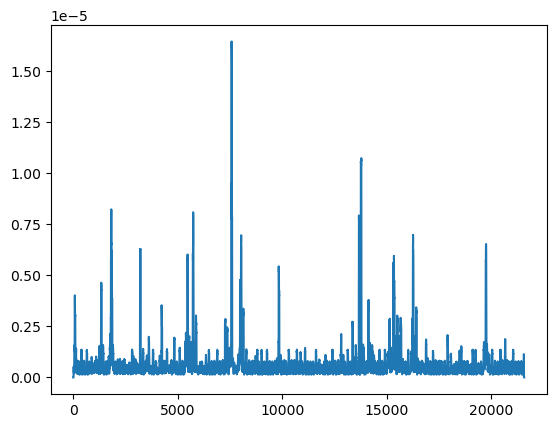

 17%|███████▎                                  | 52/300 [02:51<14:56,  3.62s/it]

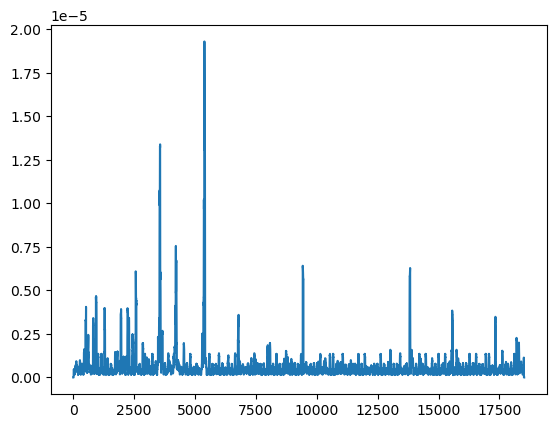

 18%|███████▍                                  | 53/300 [02:54<14:45,  3.58s/it]

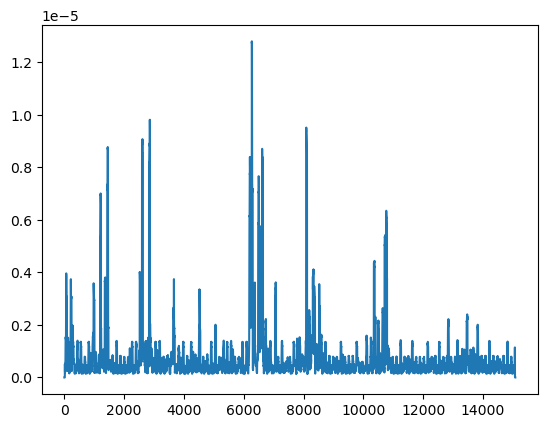

 18%|███████▌                                  | 54/300 [02:57<13:42,  3.34s/it]

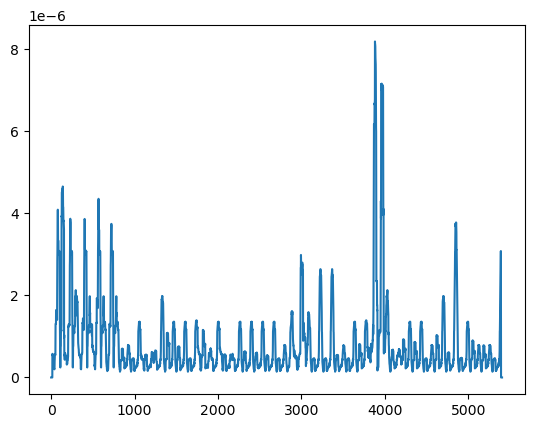

 18%|███████▋                                  | 55/300 [02:58<10:51,  2.66s/it]

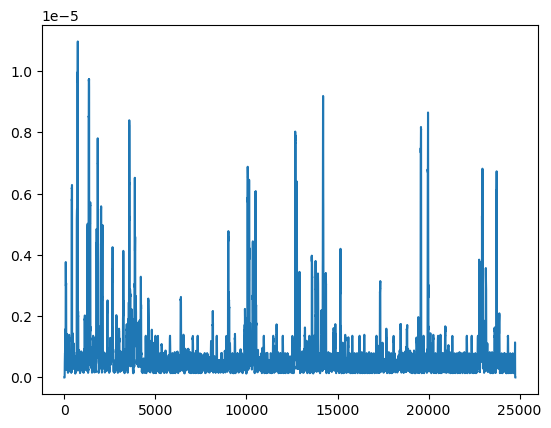

 19%|███████▊                                  | 56/300 [03:03<13:24,  3.30s/it]

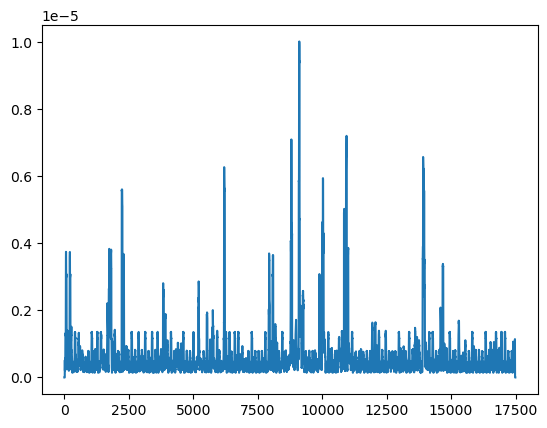

 19%|███████▉                                  | 57/300 [03:06<13:17,  3.28s/it]

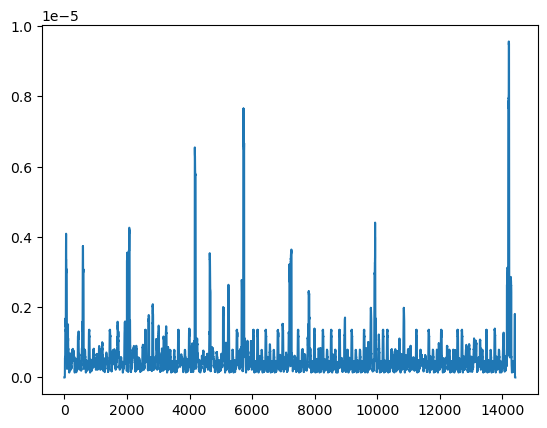

 19%|████████                                  | 58/300 [03:09<12:29,  3.10s/it]

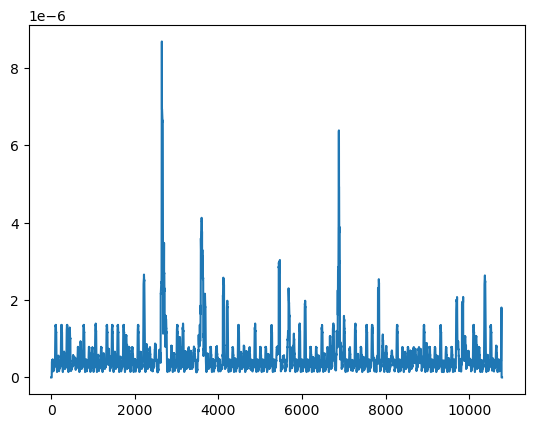

 20%|████████▎                                 | 59/300 [03:11<11:18,  2.82s/it]

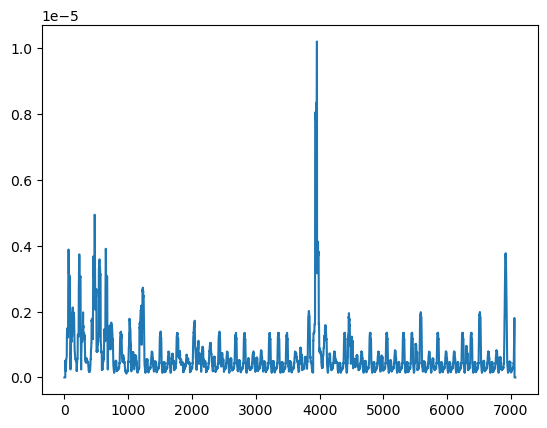

 20%|████████▍                                 | 60/300 [03:12<09:28,  2.37s/it]

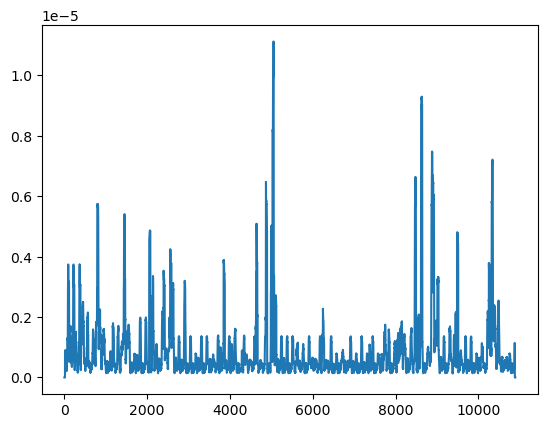

 20%|████████▌                                 | 61/300 [03:14<09:04,  2.28s/it]

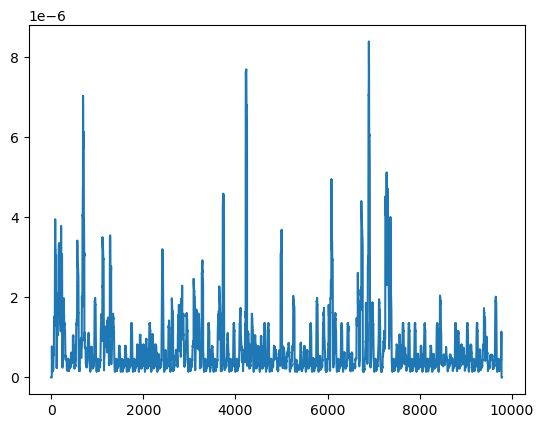

 21%|████████▋                                 | 62/300 [03:16<08:34,  2.16s/it]

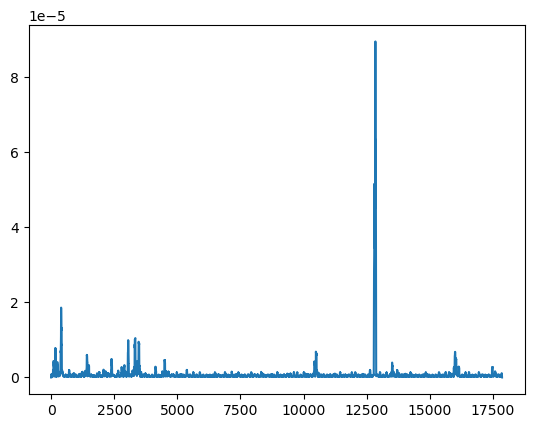

 21%|████████▊                                 | 63/300 [03:20<10:08,  2.57s/it]

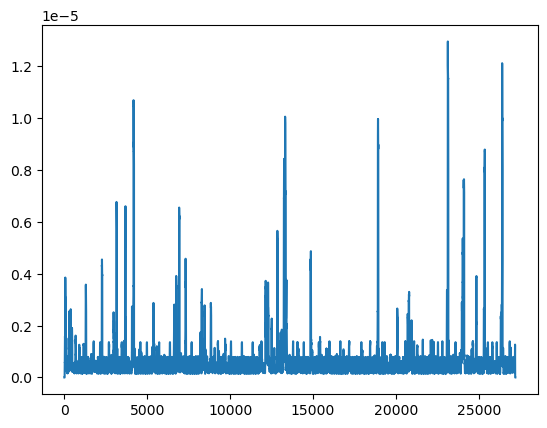

 21%|████████▉                                 | 64/300 [03:25<13:15,  3.37s/it]

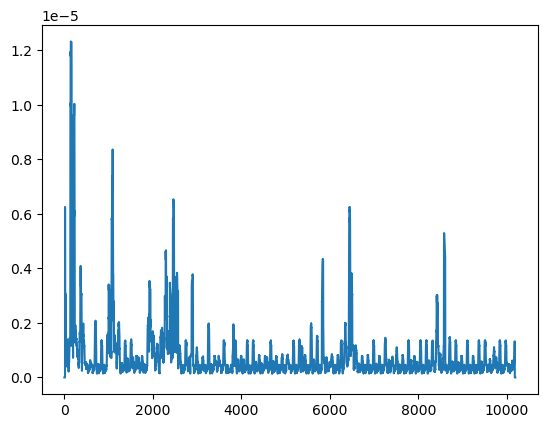

 22%|█████████                                 | 65/300 [03:27<11:29,  2.93s/it]

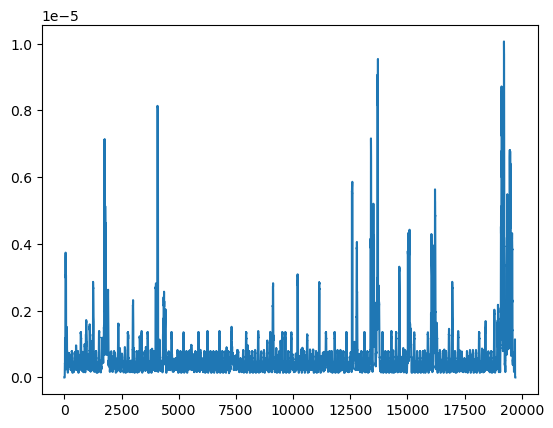

 22%|█████████▏                                | 66/300 [03:30<12:15,  3.14s/it]

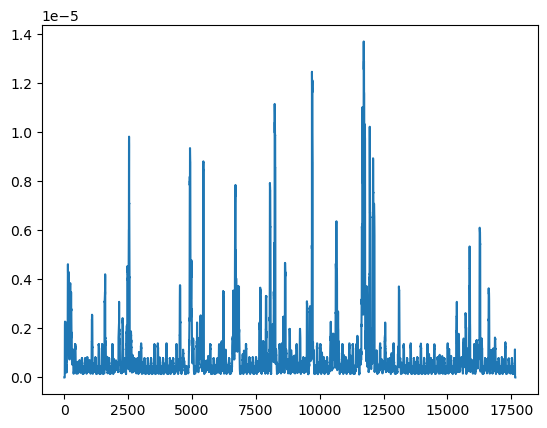

 22%|█████████▍                                | 67/300 [03:34<12:21,  3.18s/it]

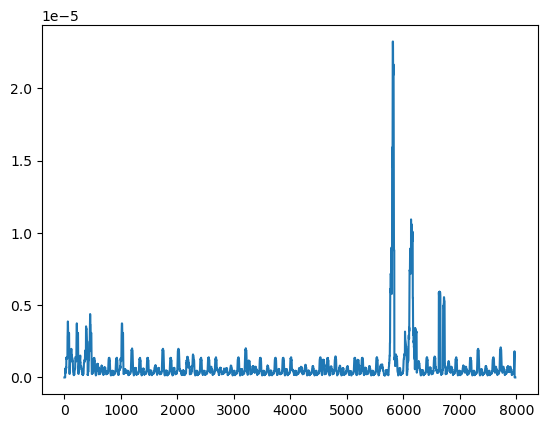

 23%|█████████▌                                | 68/300 [03:35<10:23,  2.69s/it]

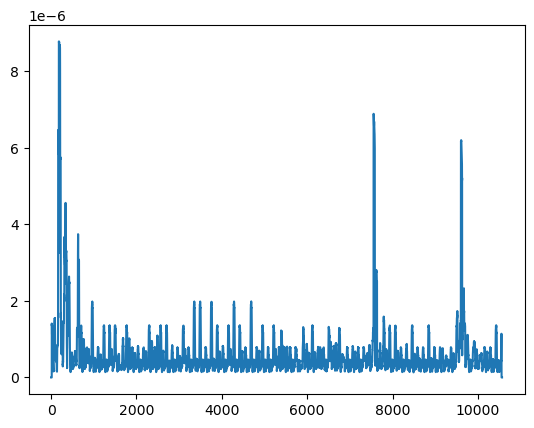

 23%|█████████▋                                | 69/300 [03:37<09:34,  2.49s/it]

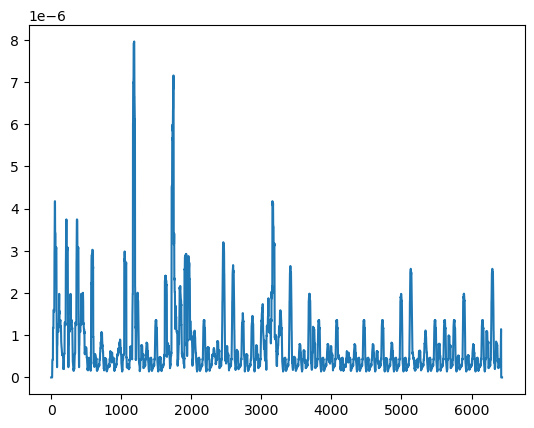

 23%|█████████▊                                | 70/300 [03:38<08:10,  2.13s/it]

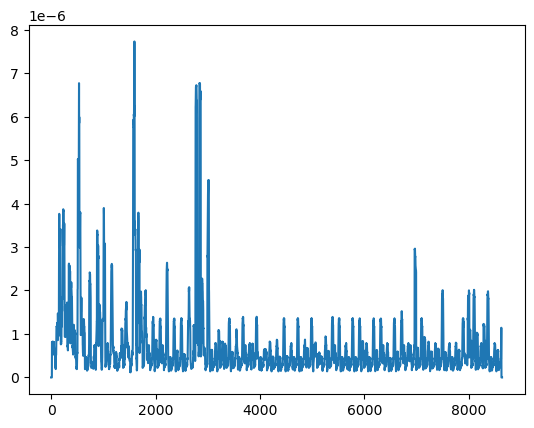

 24%|█████████▉                                | 71/300 [03:40<07:38,  2.00s/it]

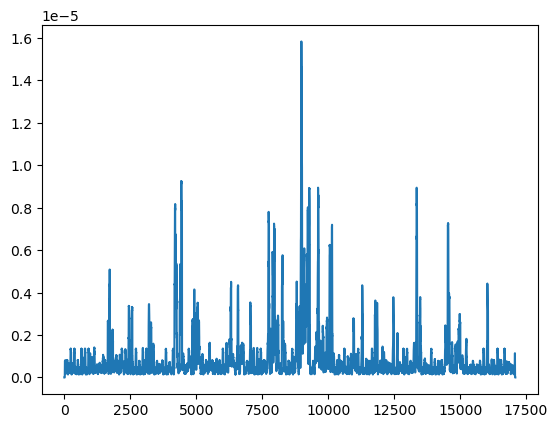

 24%|██████████                                | 72/300 [03:43<08:57,  2.36s/it]

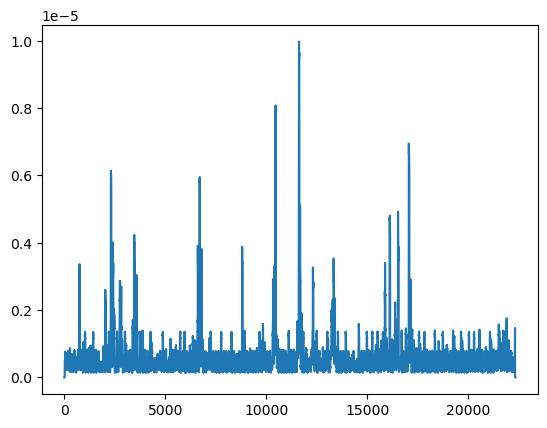

 24%|██████████▏                               | 73/300 [03:48<11:00,  2.91s/it]

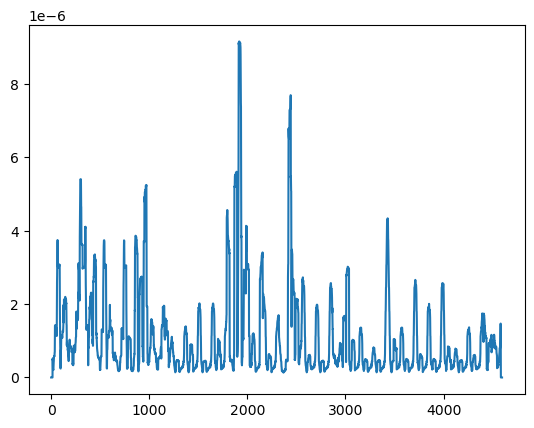

 25%|██████████▎                               | 74/300 [03:48<08:42,  2.31s/it]

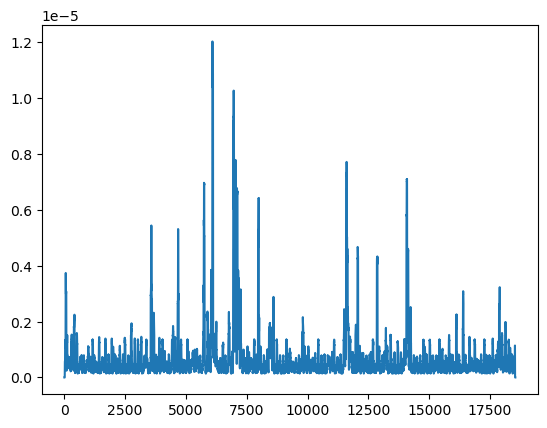

 25%|██████████▌                               | 75/300 [03:52<10:00,  2.67s/it]

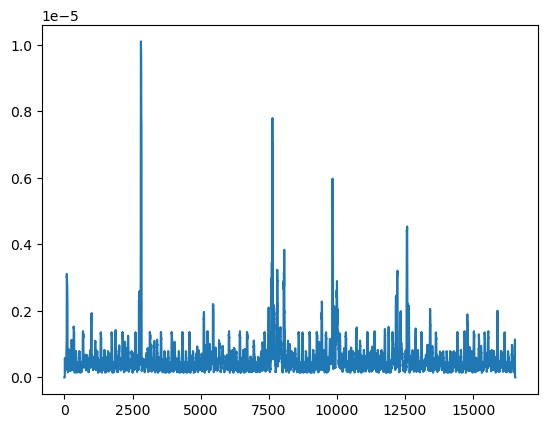

 25%|██████████▋                               | 76/300 [03:55<10:27,  2.80s/it]

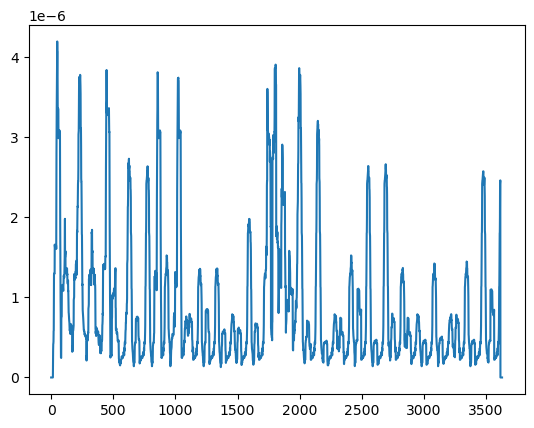

 26%|██████████▊                               | 77/300 [03:56<08:09,  2.20s/it]

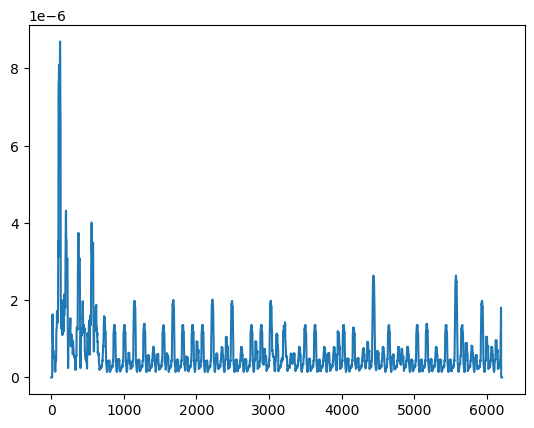

 26%|██████████▉                               | 78/300 [03:57<06:59,  1.89s/it]

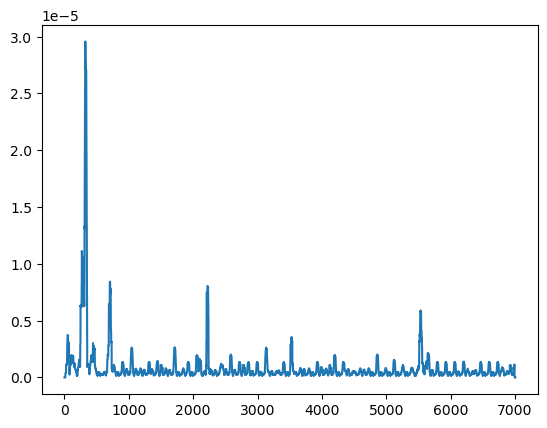

 26%|███████████                               | 79/300 [03:58<06:25,  1.74s/it]

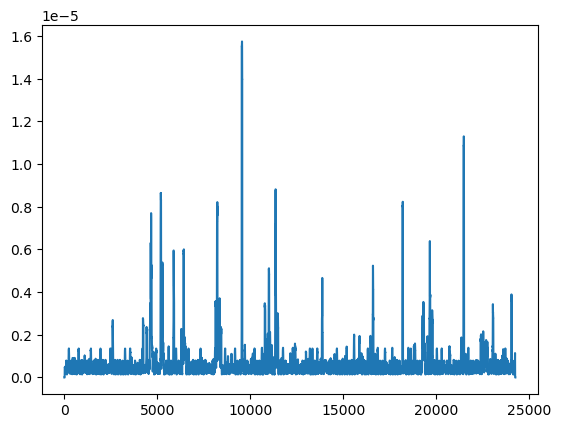

 27%|███████████▏                              | 80/300 [04:03<09:40,  2.64s/it]

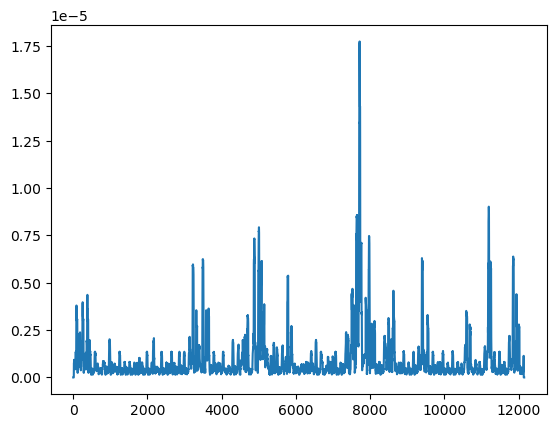

 27%|███████████▎                              | 81/300 [04:05<09:12,  2.52s/it]

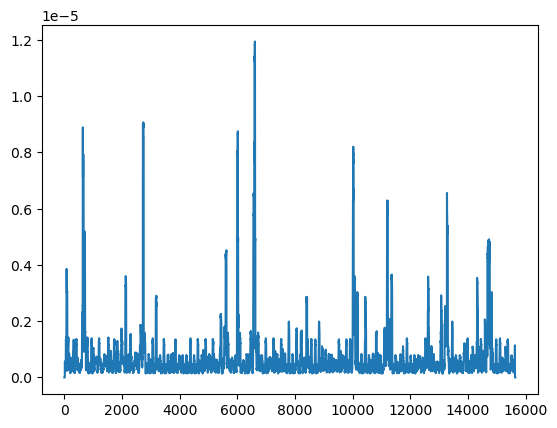

 27%|███████████▍                              | 82/300 [04:08<09:38,  2.66s/it]

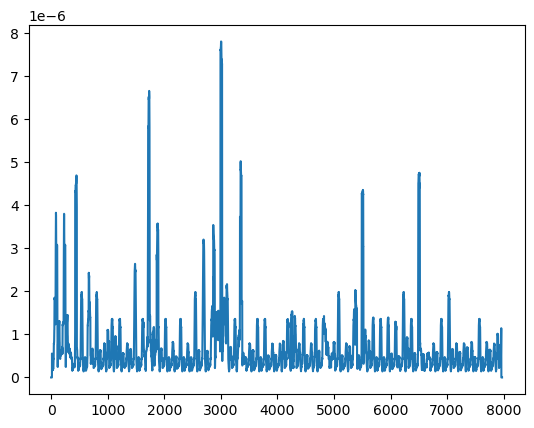

 28%|███████████▌                              | 83/300 [04:10<08:24,  2.32s/it]

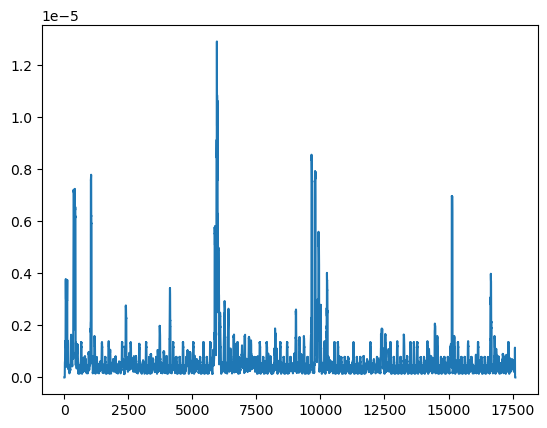

 28%|███████████▊                              | 84/300 [04:13<09:28,  2.63s/it]

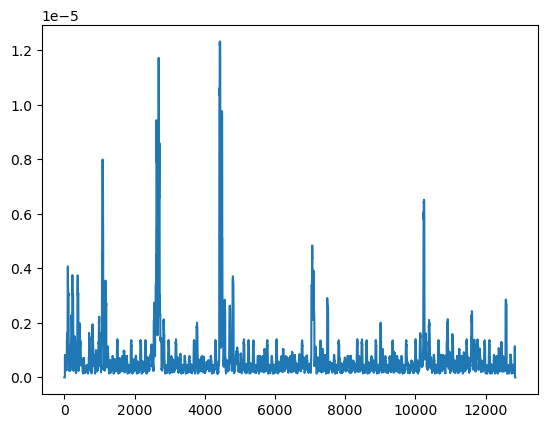

 28%|███████████▉                              | 85/300 [04:16<09:32,  2.66s/it]

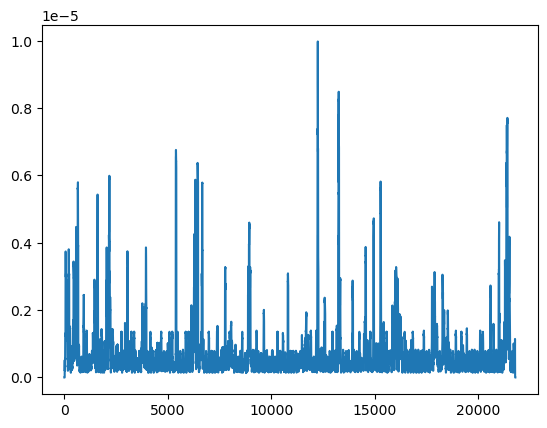

 29%|████████████                              | 86/300 [04:20<11:05,  3.11s/it]

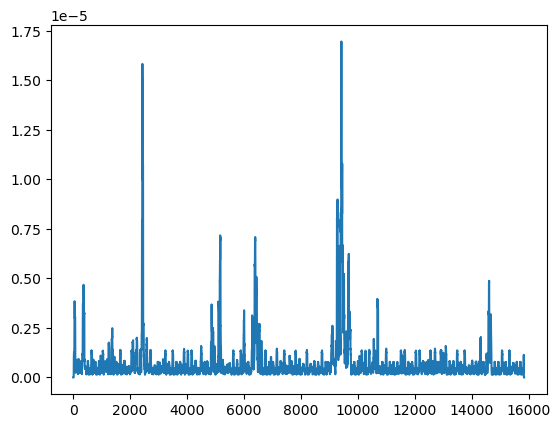

 29%|████████████▏                             | 87/300 [04:23<10:55,  3.08s/it]

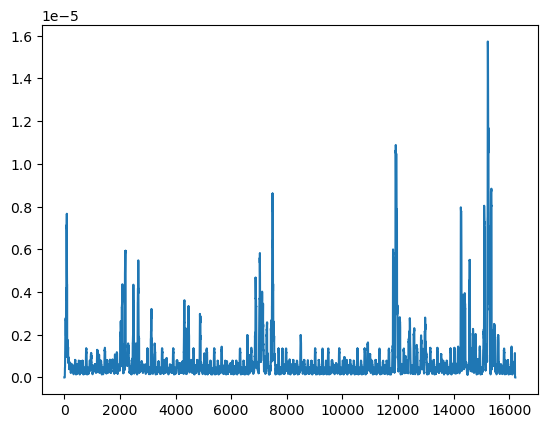

 29%|████████████▎                             | 88/300 [04:26<10:50,  3.07s/it]

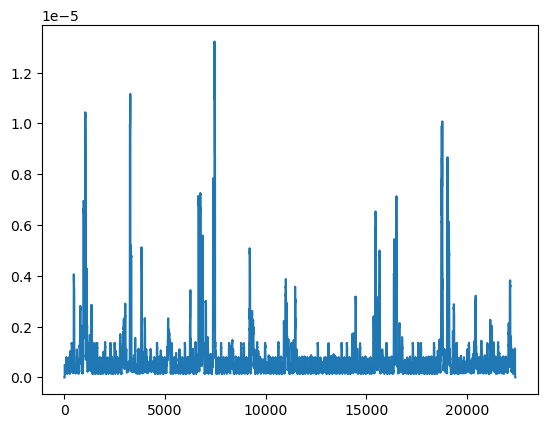

 30%|████████████▍                             | 89/300 [04:30<12:03,  3.43s/it]

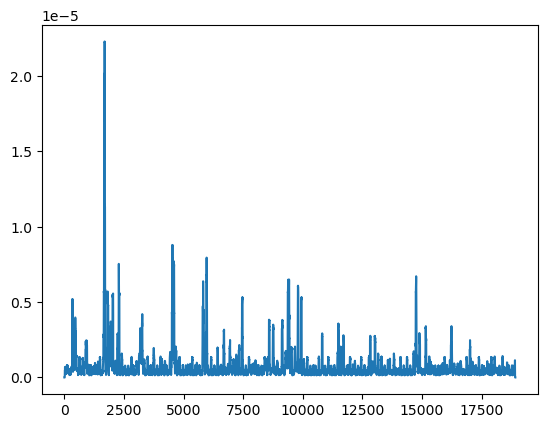

 30%|████████████▌                             | 90/300 [04:34<12:09,  3.48s/it]

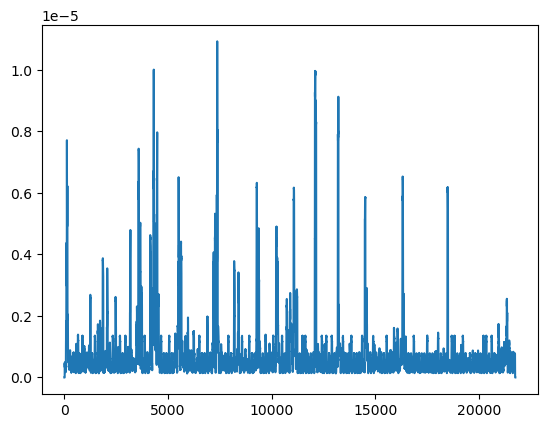

 30%|████████████▋                             | 91/300 [04:38<12:55,  3.71s/it]

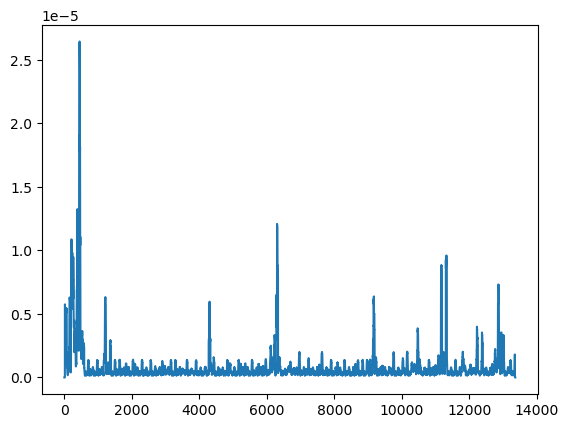

 31%|████████████▉                             | 92/300 [04:41<11:39,  3.36s/it]

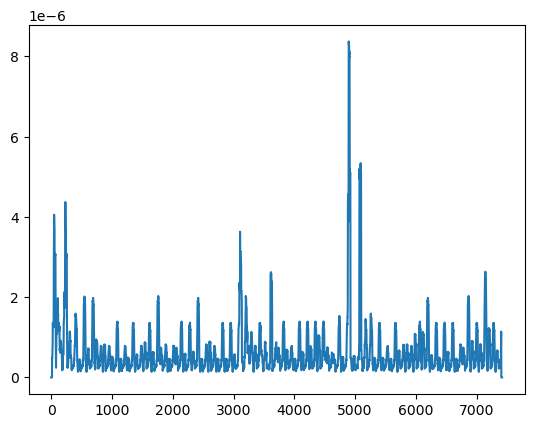

 31%|█████████████                             | 93/300 [04:43<09:47,  2.84s/it]

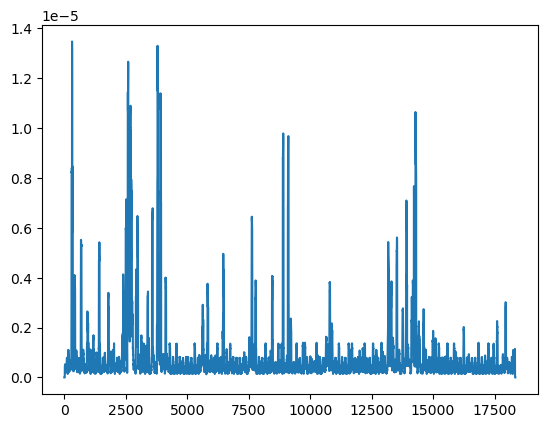

 31%|█████████████▏                            | 94/300 [04:46<10:24,  3.03s/it]

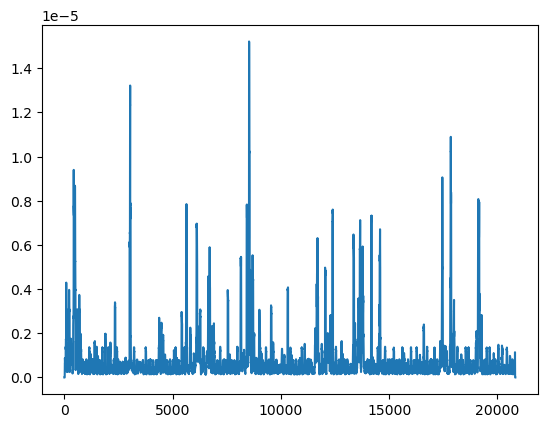

 32%|█████████████▎                            | 95/300 [04:50<11:18,  3.31s/it]

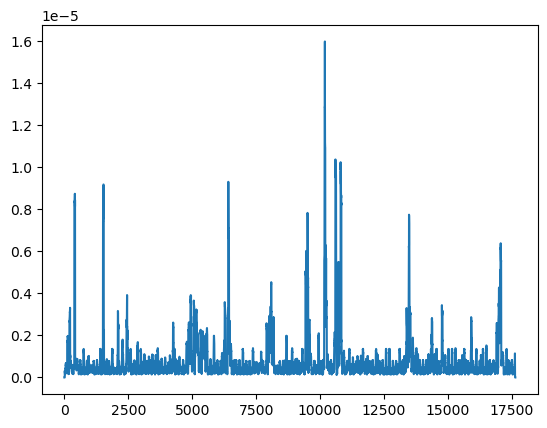

 32%|█████████████▍                            | 96/300 [04:53<11:15,  3.31s/it]

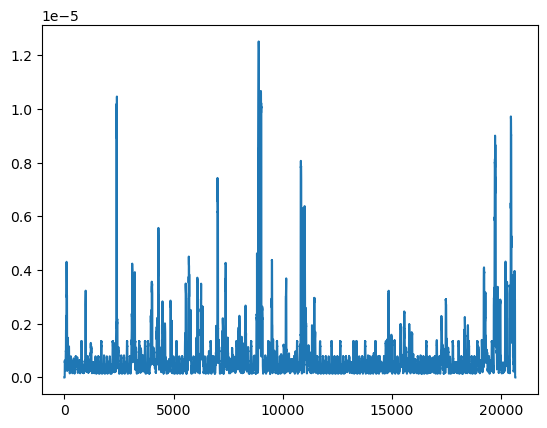

 32%|█████████████▌                            | 97/300 [04:57<11:47,  3.49s/it]

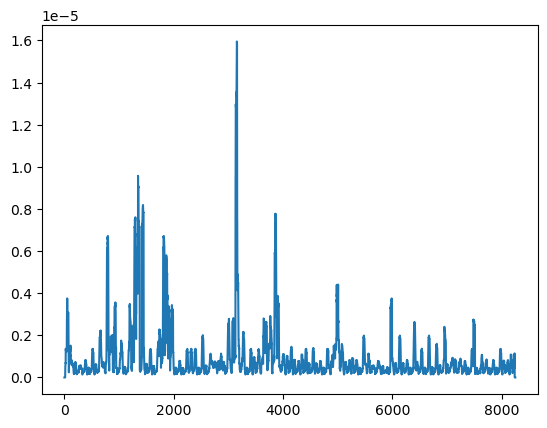

 33%|█████████████▋                            | 98/300 [04:59<09:49,  2.92s/it]

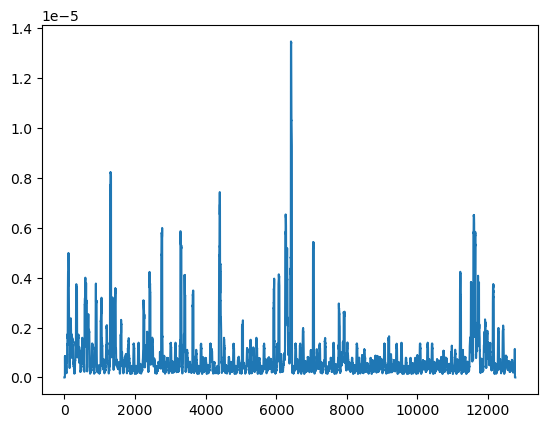

 33%|█████████████▊                            | 99/300 [05:01<09:19,  2.78s/it]

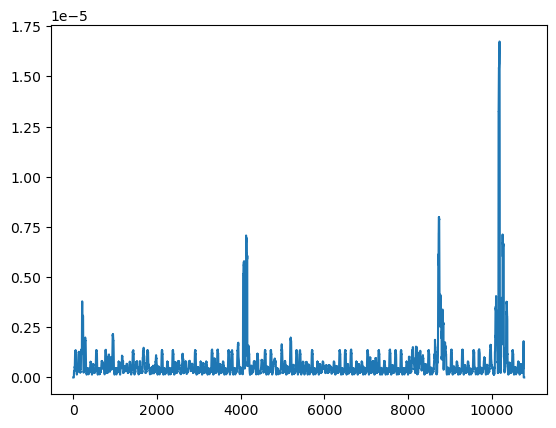

 33%|█████████████▋                           | 100/300 [05:03<08:29,  2.55s/it]

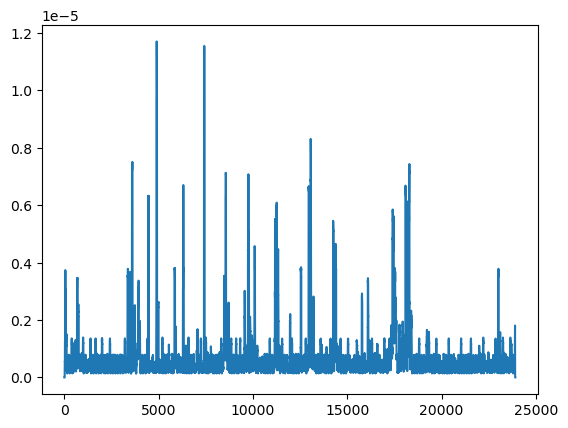

 34%|█████████████▊                           | 101/300 [05:08<10:33,  3.18s/it]

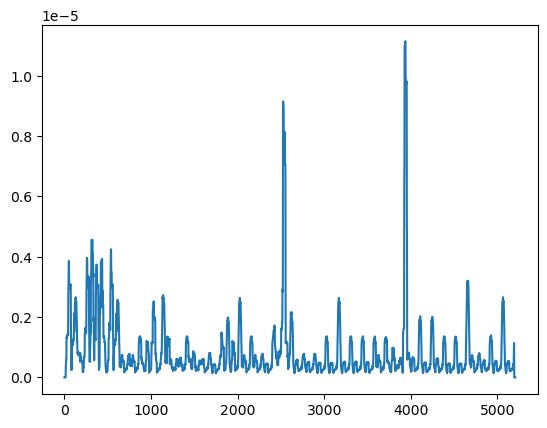

 34%|█████████████▉                           | 102/300 [05:09<08:22,  2.54s/it]

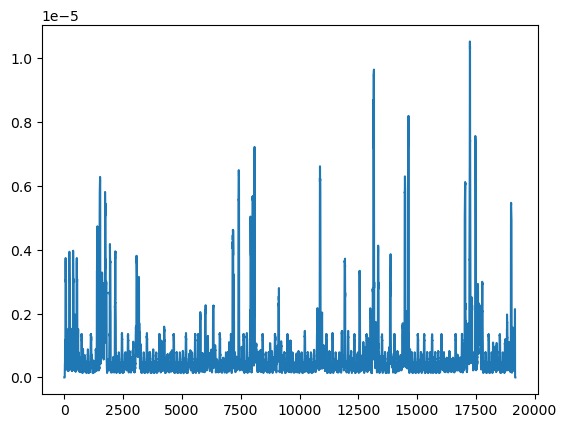

 34%|██████████████                           | 103/300 [05:13<09:27,  2.88s/it]

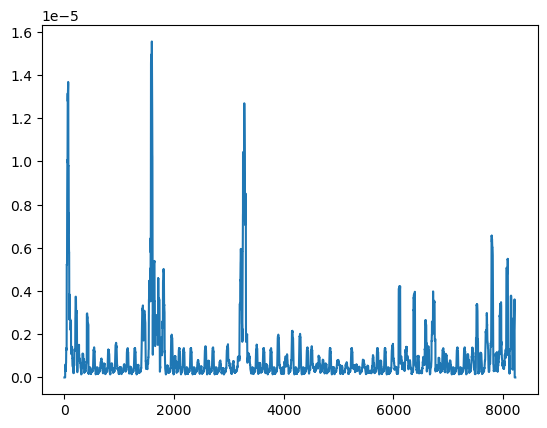

 35%|██████████████▏                          | 104/300 [05:14<08:07,  2.49s/it]

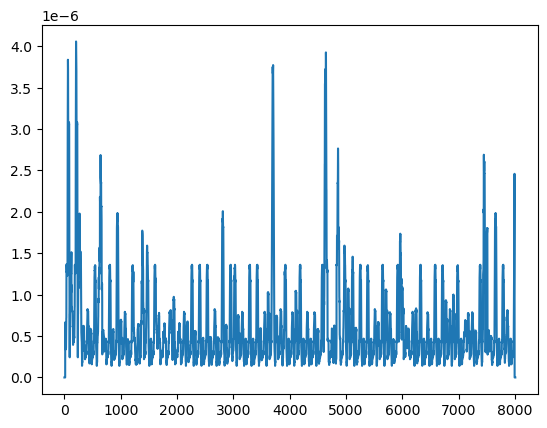

 35%|██████████████▎                          | 105/300 [05:16<07:10,  2.21s/it]

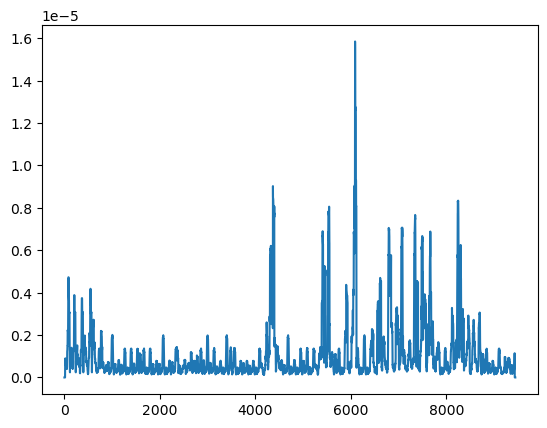

 35%|██████████████▍                          | 106/300 [05:18<06:43,  2.08s/it]

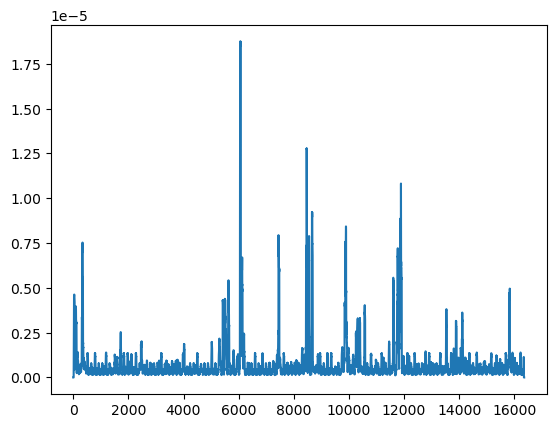

 36%|██████████████▌                          | 107/300 [05:21<07:45,  2.41s/it]

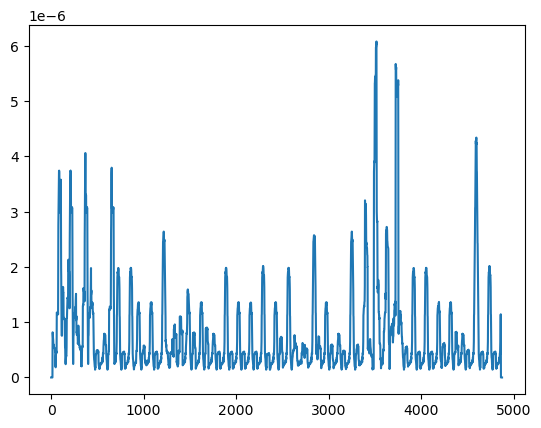

 36%|██████████████▊                          | 108/300 [05:22<06:21,  1.99s/it]

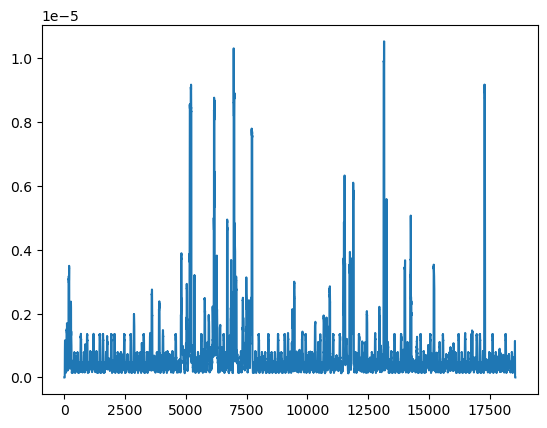

 36%|██████████████▉                          | 109/300 [05:25<07:52,  2.47s/it]

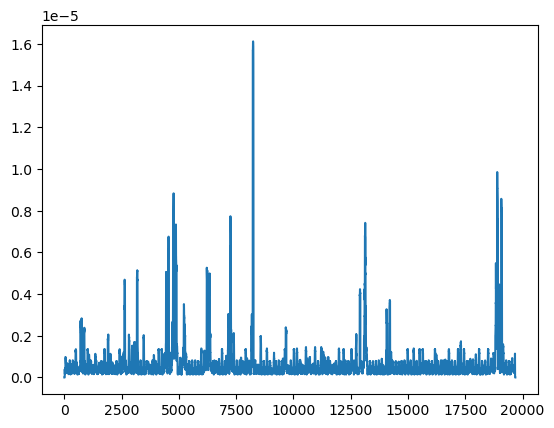

 37%|███████████████                          | 110/300 [05:29<09:03,  2.86s/it]

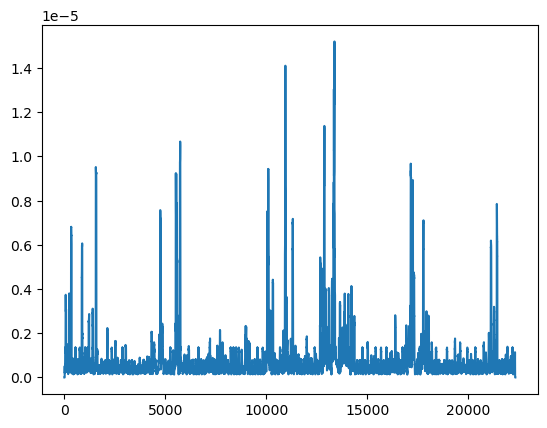

 37%|███████████████▏                         | 111/300 [05:33<10:25,  3.31s/it]

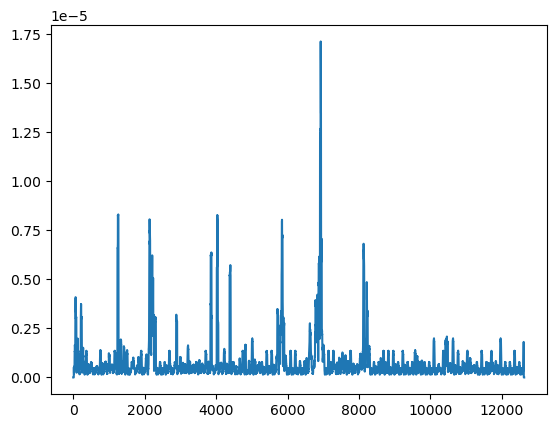

 37%|███████████████▎                         | 112/300 [05:36<09:29,  3.03s/it]

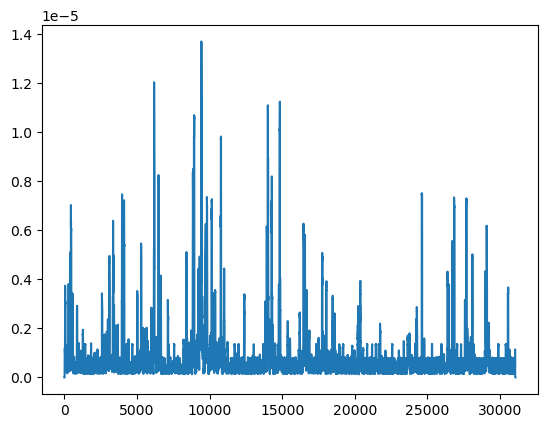

 38%|███████████████▍                         | 113/300 [05:42<12:20,  3.96s/it]

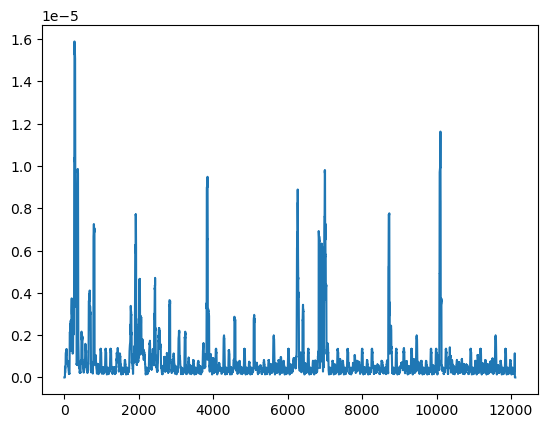

 38%|███████████████▌                         | 114/300 [05:44<10:43,  3.46s/it]

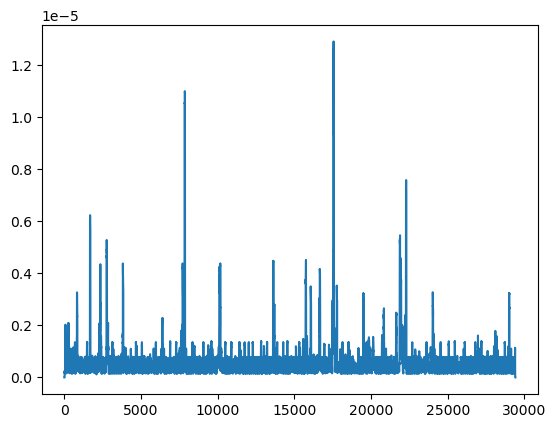

 38%|███████████████▋                         | 115/300 [05:50<12:35,  4.09s/it]

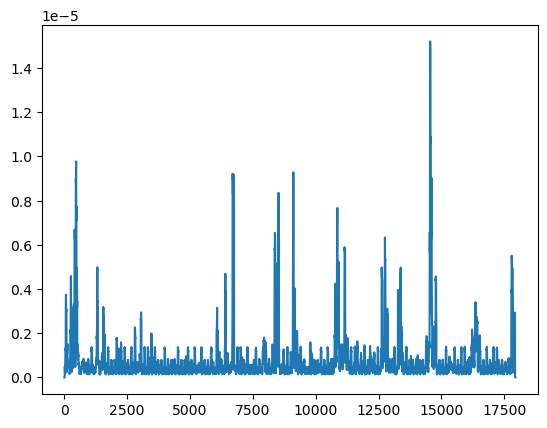

 39%|███████████████▊                         | 116/300 [05:53<11:52,  3.87s/it]

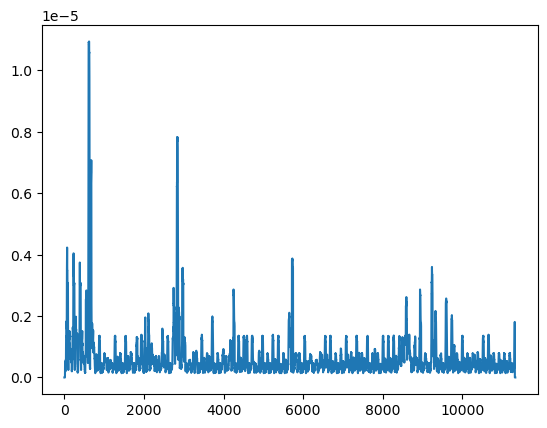

 39%|███████████████▉                         | 117/300 [05:55<10:15,  3.36s/it]

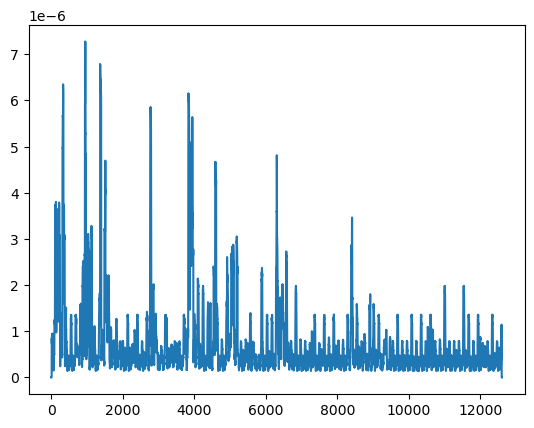

 39%|████████████████▏                        | 118/300 [05:58<09:19,  3.07s/it]

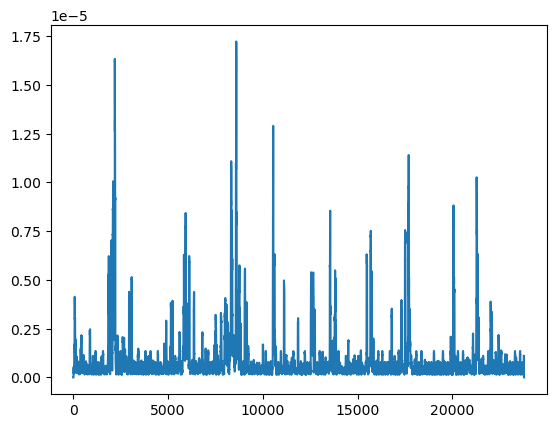

 40%|████████████████▎                        | 119/300 [06:02<10:42,  3.55s/it]

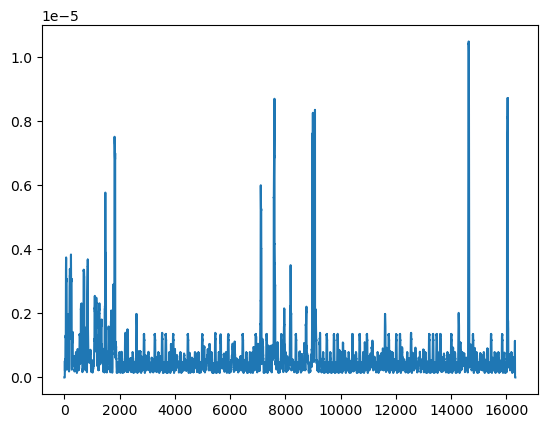

 40%|████████████████▍                        | 120/300 [06:05<10:14,  3.41s/it]

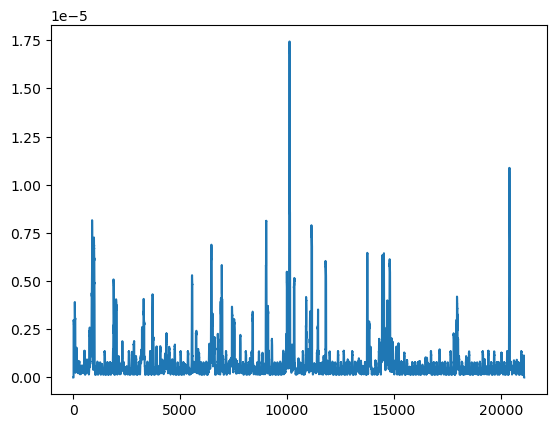

 40%|████████████████▌                        | 121/300 [06:10<10:51,  3.64s/it]

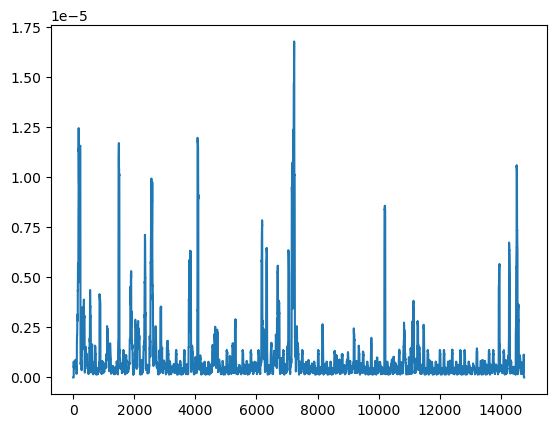

 41%|████████████████▋                        | 122/300 [06:13<10:11,  3.44s/it]

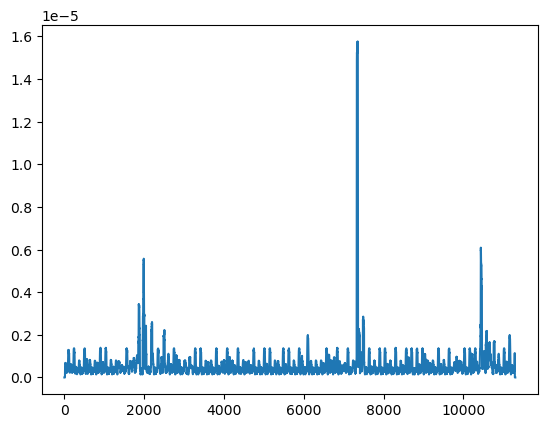

 41%|████████████████▊                        | 123/300 [06:15<09:00,  3.06s/it]

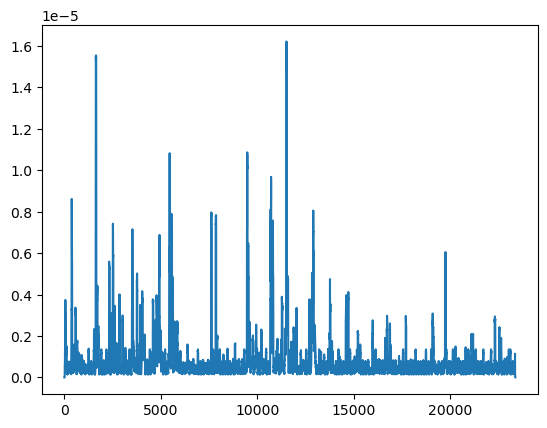

 41%|████████████████▉                        | 124/300 [06:19<10:11,  3.47s/it]

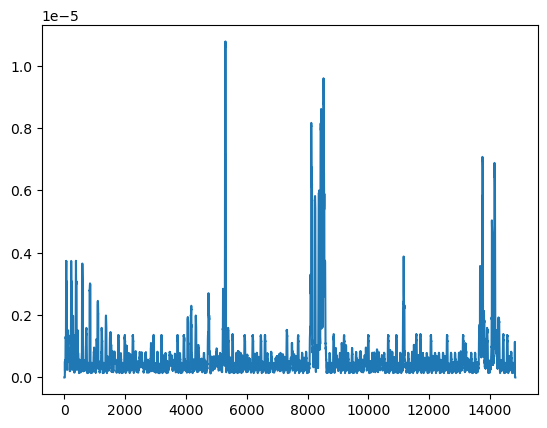

 42%|█████████████████                        | 125/300 [06:22<09:32,  3.27s/it]

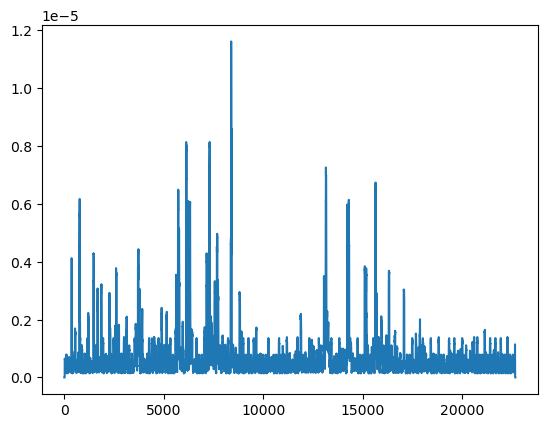

 42%|█████████████████▏                       | 126/300 [06:26<10:21,  3.57s/it]

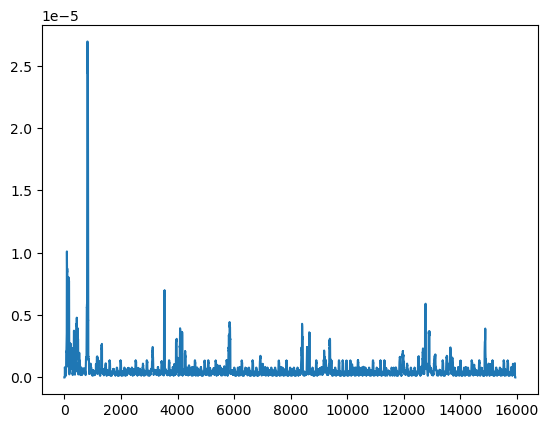

 42%|█████████████████▎                       | 127/300 [06:29<09:47,  3.39s/it]

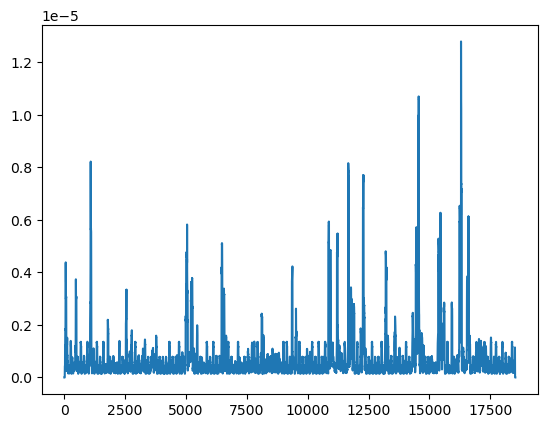

 43%|█████████████████▍                       | 128/300 [06:33<09:47,  3.41s/it]

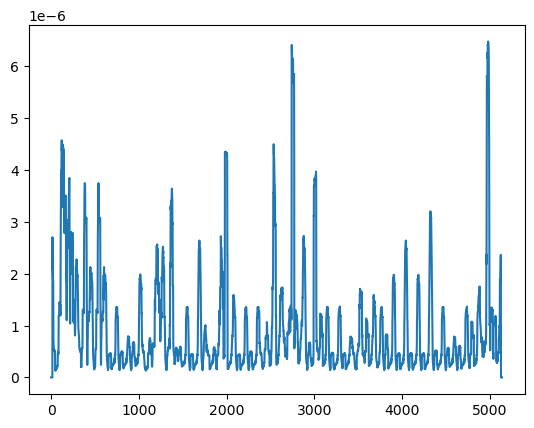

 43%|█████████████████▋                       | 129/300 [06:34<07:40,  2.69s/it]

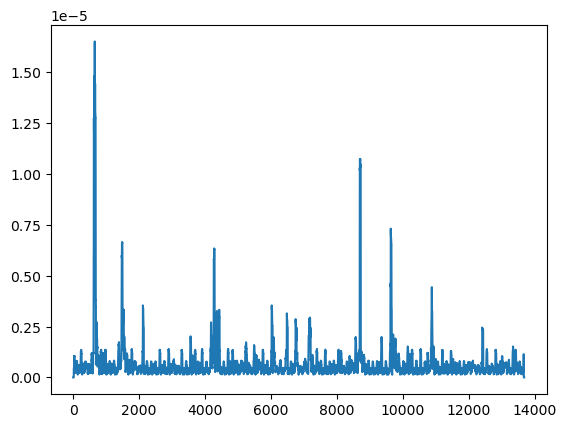

 43%|█████████████████▊                       | 130/300 [06:36<07:33,  2.67s/it]

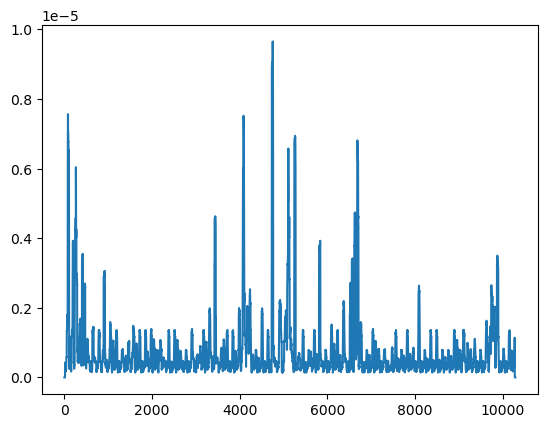

 44%|█████████████████▉                       | 131/300 [06:38<06:53,  2.45s/it]

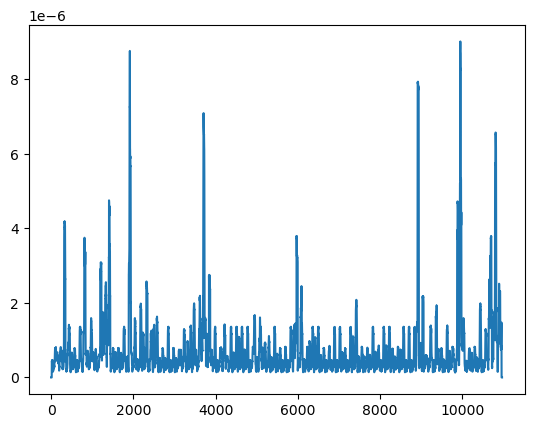

 44%|██████████████████                       | 132/300 [06:40<06:33,  2.34s/it]

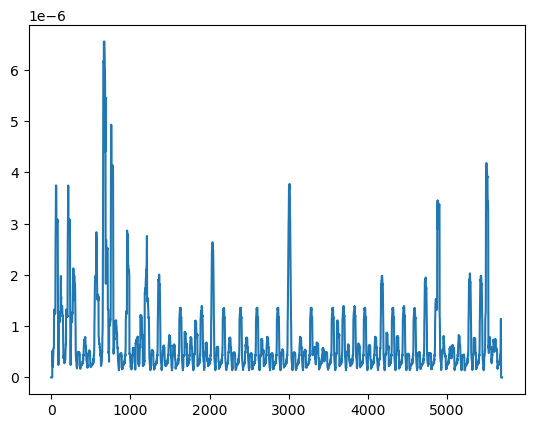

 44%|██████████████████▏                      | 133/300 [06:41<05:30,  1.98s/it]

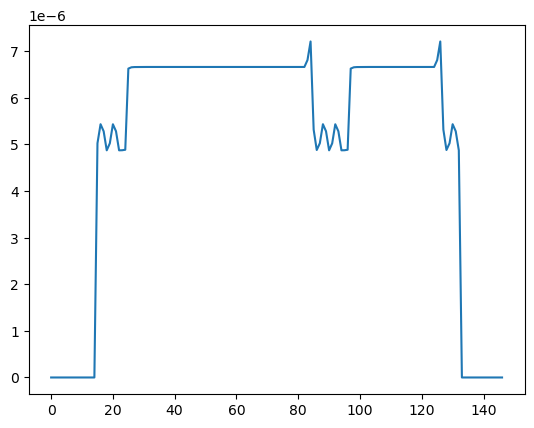

 45%|██████████████████▎                      | 134/300 [06:42<03:56,  1.42s/it]

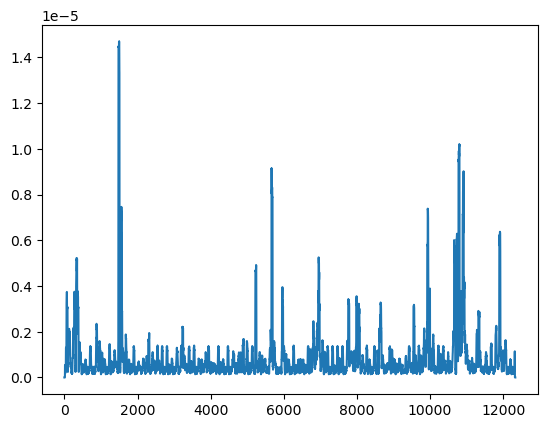

 45%|██████████████████▍                      | 135/300 [06:44<04:39,  1.69s/it]

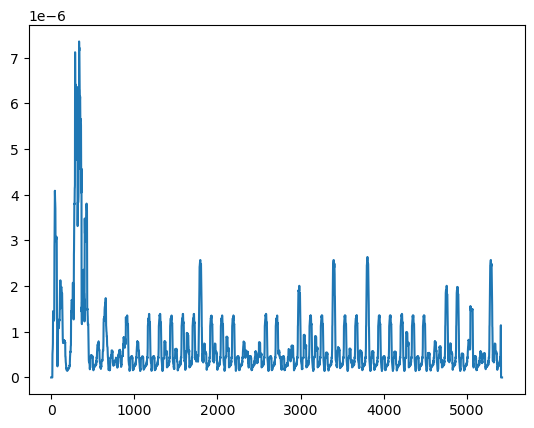

 45%|██████████████████▌                      | 136/300 [06:45<04:10,  1.52s/it]

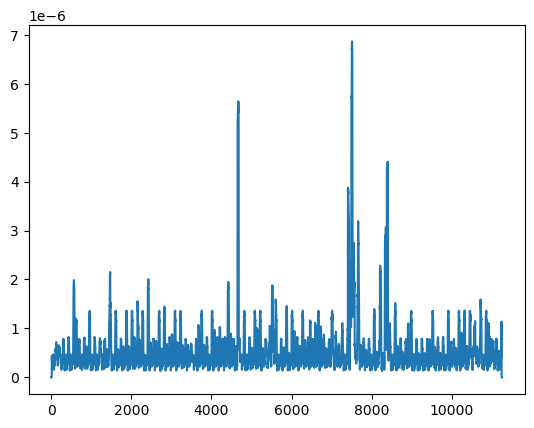

 46%|██████████████████▋                      | 137/300 [06:47<04:39,  1.72s/it]

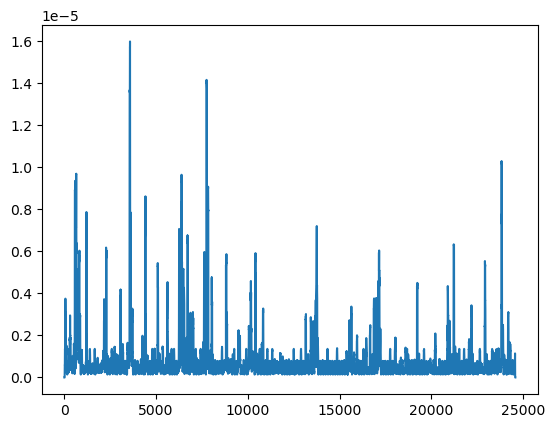

 46%|██████████████████▊                      | 138/300 [06:52<07:24,  2.74s/it]

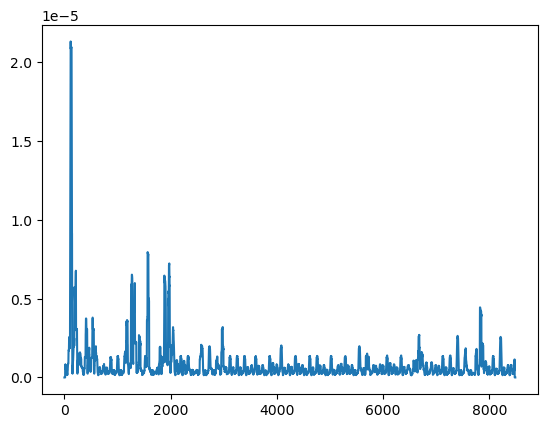

 46%|██████████████████▉                      | 139/300 [06:54<06:30,  2.43s/it]

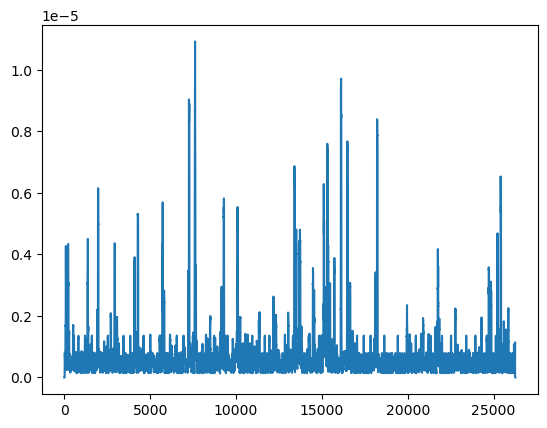

 47%|███████████████████▏                     | 140/300 [06:59<08:35,  3.22s/it]

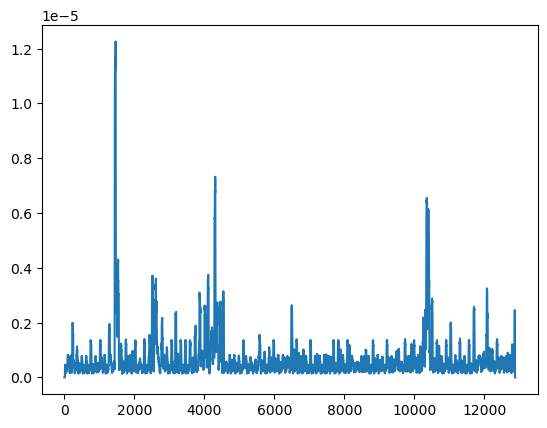

 47%|███████████████████▎                     | 141/300 [07:02<07:59,  3.02s/it]

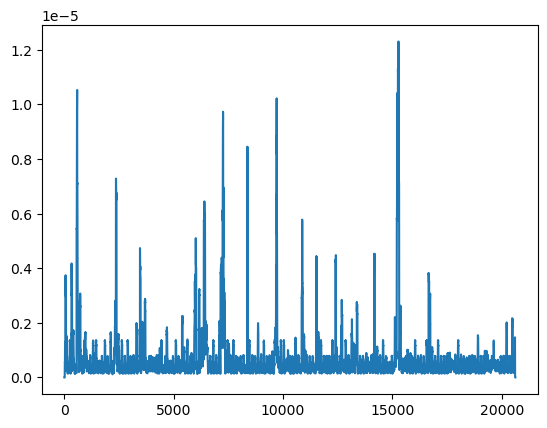

 47%|███████████████████▍                     | 142/300 [07:06<09:16,  3.52s/it]

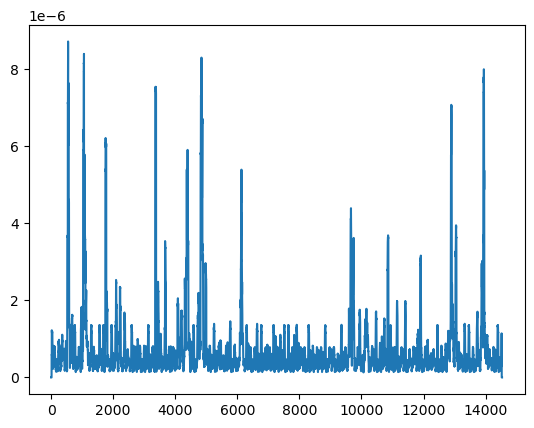

 48%|███████████████████▌                     | 143/300 [07:09<08:38,  3.30s/it]

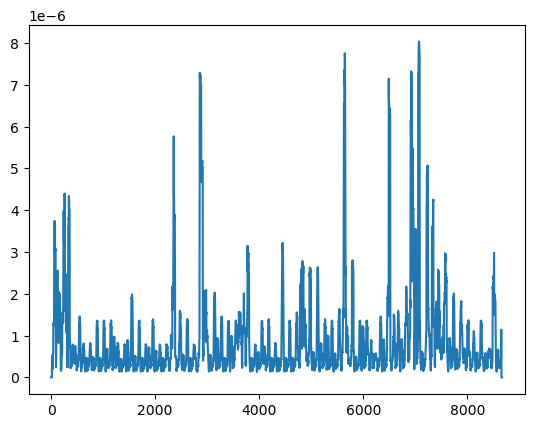

 48%|███████████████████▋                     | 144/300 [07:11<07:27,  2.87s/it]

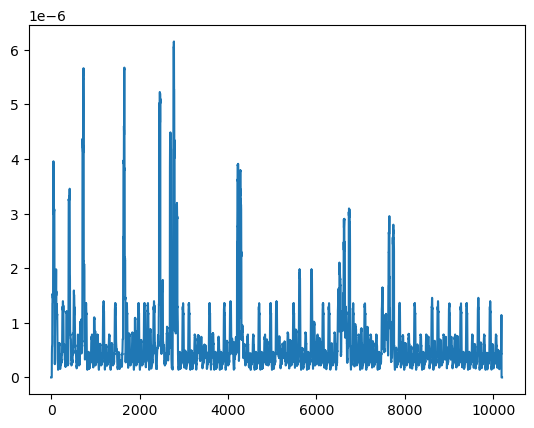

 48%|███████████████████▊                     | 145/300 [07:13<06:40,  2.59s/it]

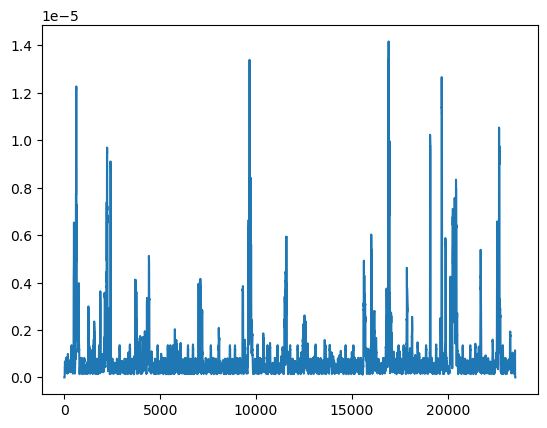

 49%|███████████████████▉                     | 146/300 [07:18<08:14,  3.21s/it]

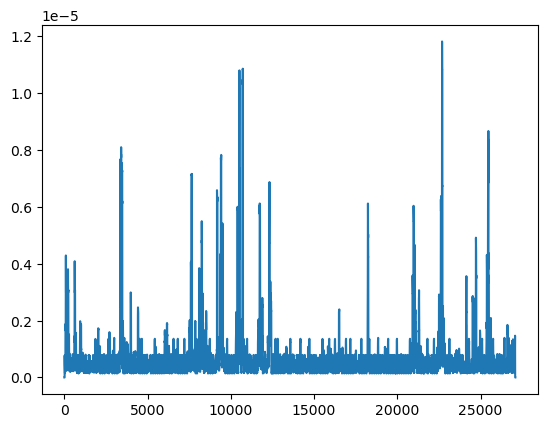

 49%|████████████████████                     | 147/300 [07:23<09:39,  3.79s/it]

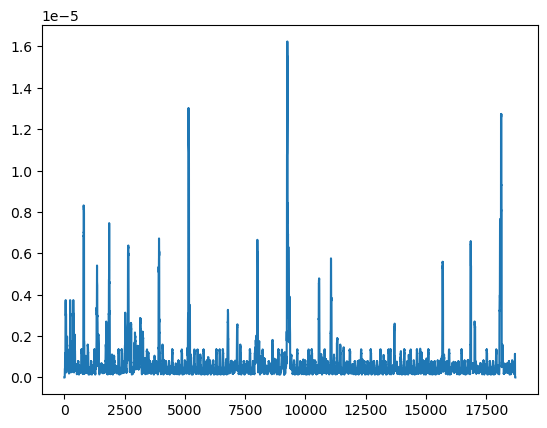

 49%|████████████████████▏                    | 148/300 [07:26<09:26,  3.72s/it]

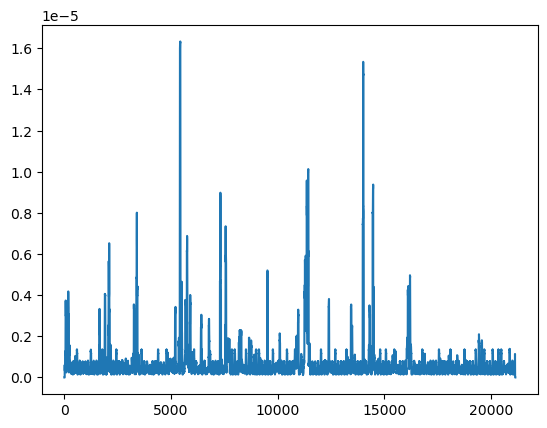

 50%|████████████████████▎                    | 149/300 [07:31<09:45,  3.87s/it]

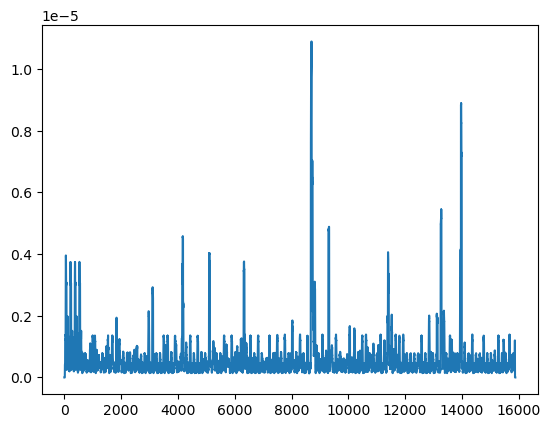

 50%|████████████████████▌                    | 150/300 [07:34<08:59,  3.60s/it]

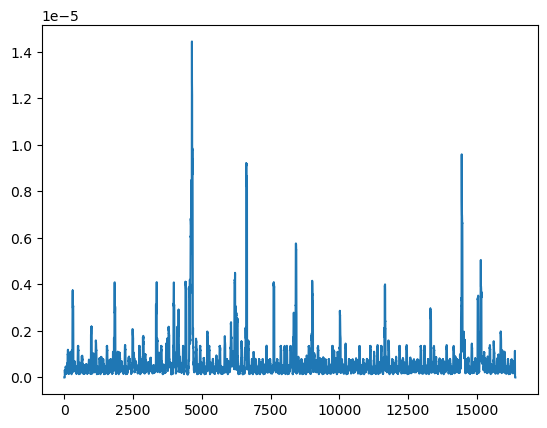

 50%|████████████████████▋                    | 151/300 [07:37<08:35,  3.46s/it]

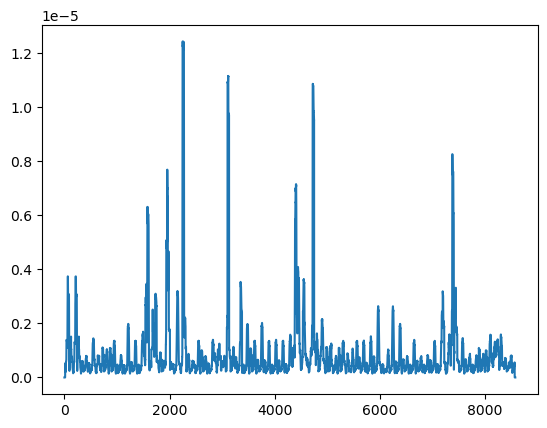

 51%|████████████████████▊                    | 152/300 [07:38<07:13,  2.93s/it]

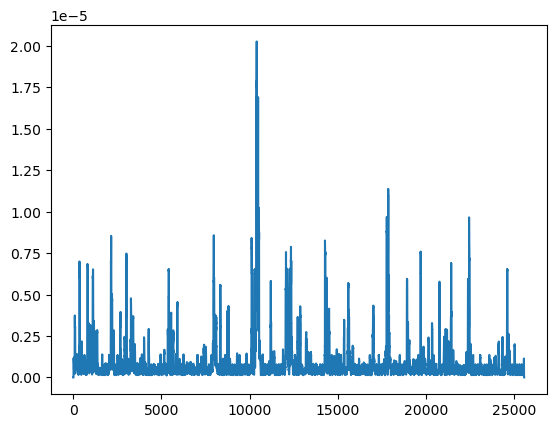

 51%|████████████████████▉                    | 153/300 [07:43<08:40,  3.54s/it]

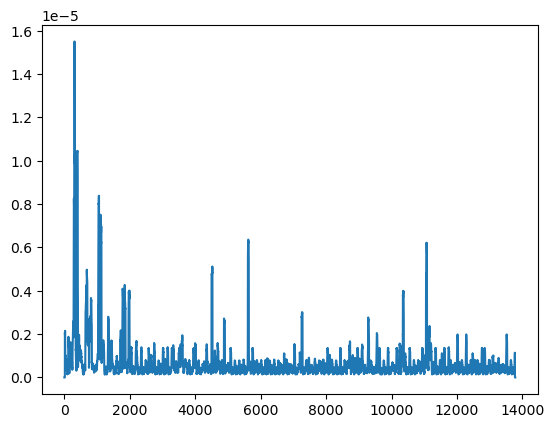

 51%|█████████████████████                    | 154/300 [07:46<07:57,  3.27s/it]

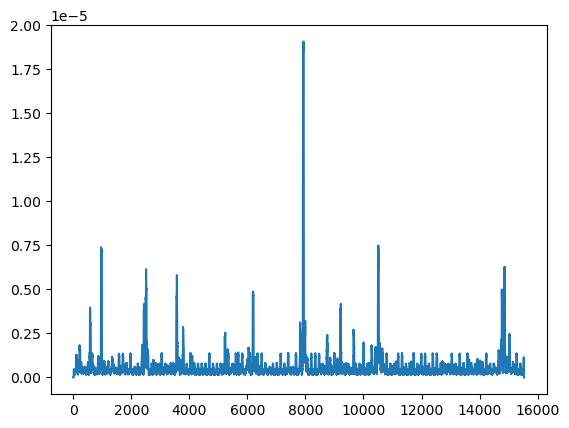

 52%|█████████████████████▏                   | 155/300 [07:49<07:38,  3.16s/it]

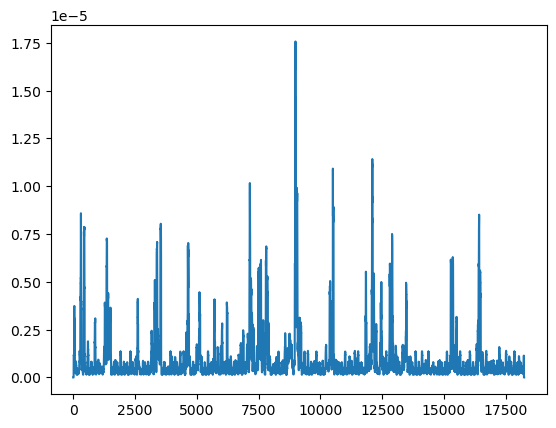

 52%|█████████████████████▎                   | 156/300 [07:52<07:52,  3.28s/it]

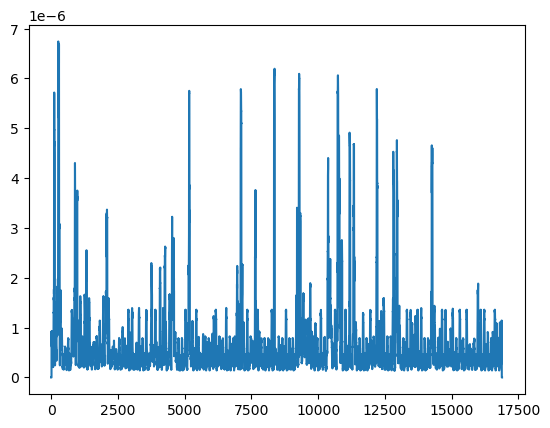

 52%|█████████████████████▍                   | 157/300 [07:56<07:48,  3.28s/it]

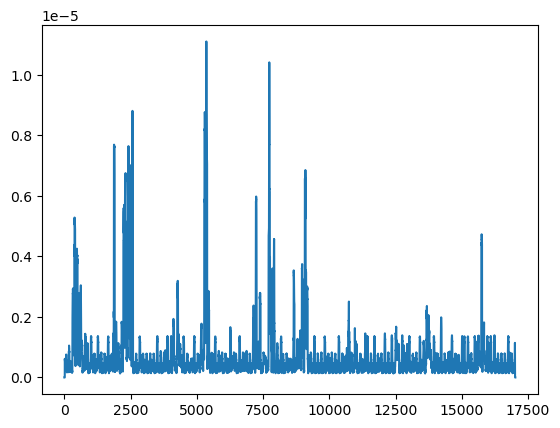

 53%|█████████████████████▌                   | 158/300 [07:59<07:53,  3.34s/it]

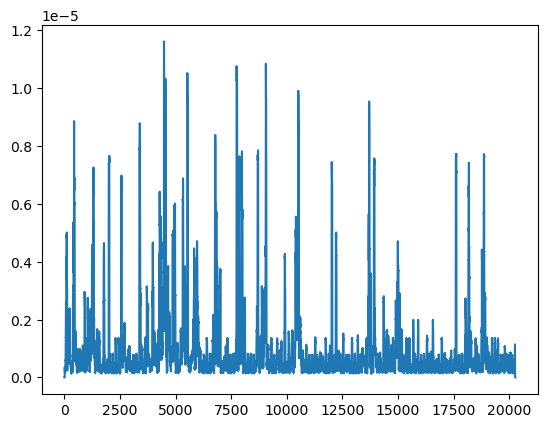

 53%|█████████████████████▋                   | 159/300 [08:03<08:25,  3.59s/it]

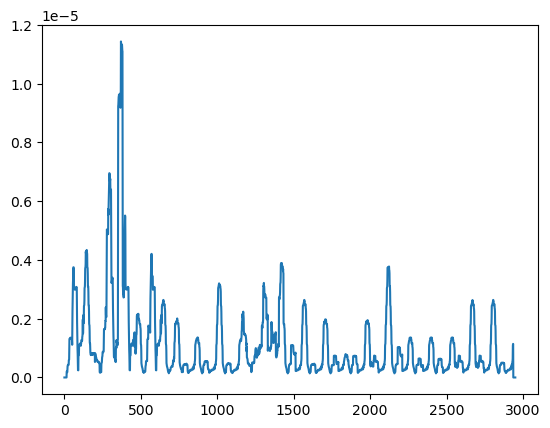

 53%|█████████████████████▊                   | 160/300 [08:04<06:19,  2.71s/it]

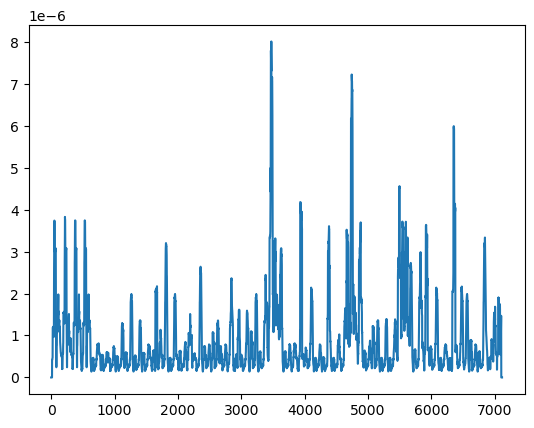

 54%|██████████████████████                   | 161/300 [08:05<05:22,  2.32s/it]

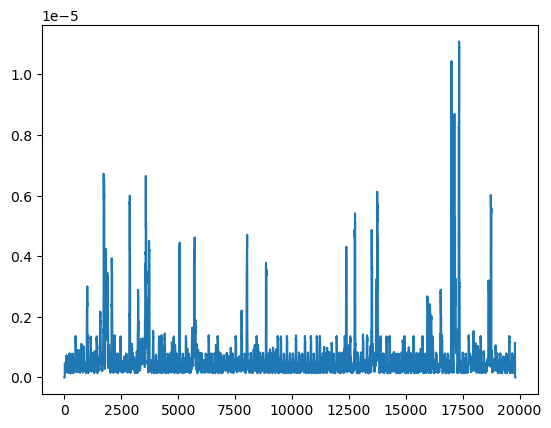

 54%|██████████████████████▏                  | 162/300 [08:09<06:28,  2.81s/it]

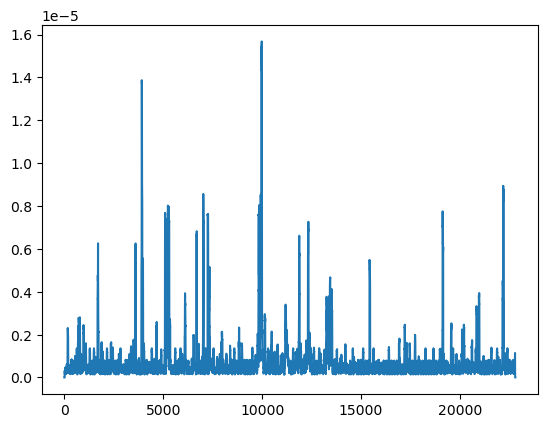

 54%|██████████████████████▎                  | 163/300 [08:14<07:54,  3.46s/it]

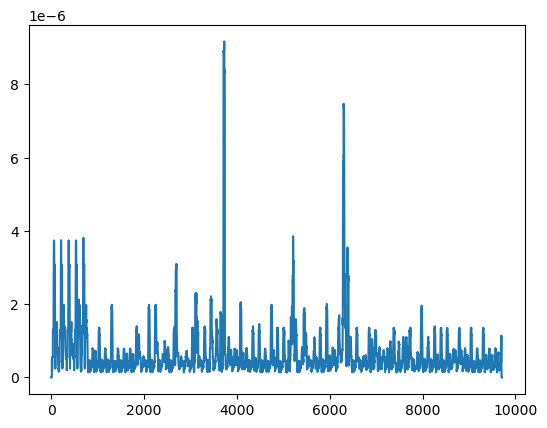

 55%|██████████████████████▍                  | 164/300 [08:16<06:48,  3.00s/it]

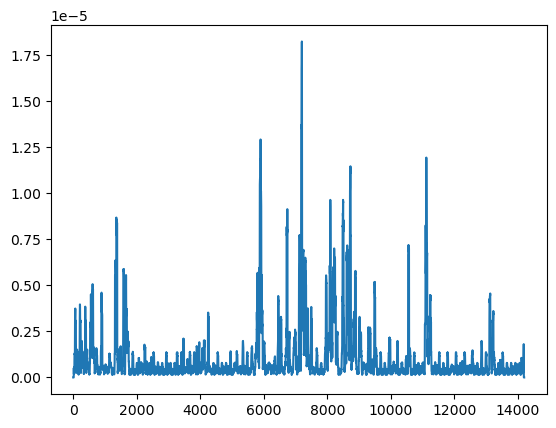

 55%|██████████████████████▌                  | 165/300 [08:19<06:32,  2.91s/it]

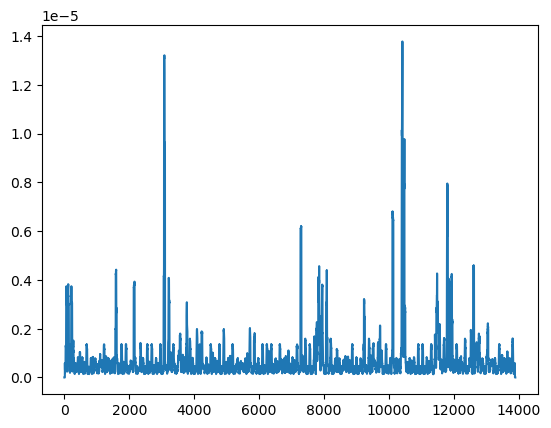

 55%|██████████████████████▋                  | 166/300 [08:22<06:19,  2.84s/it]

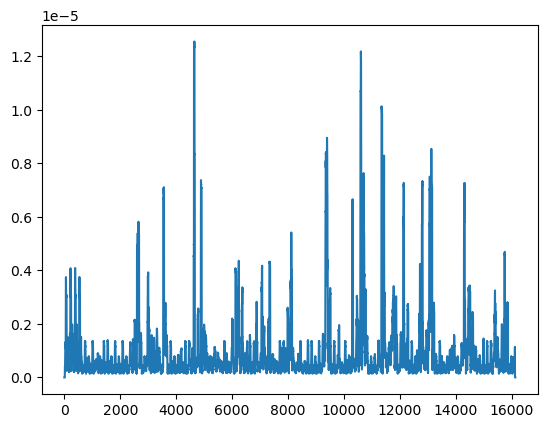

 56%|██████████████████████▊                  | 167/300 [08:25<06:40,  3.01s/it]

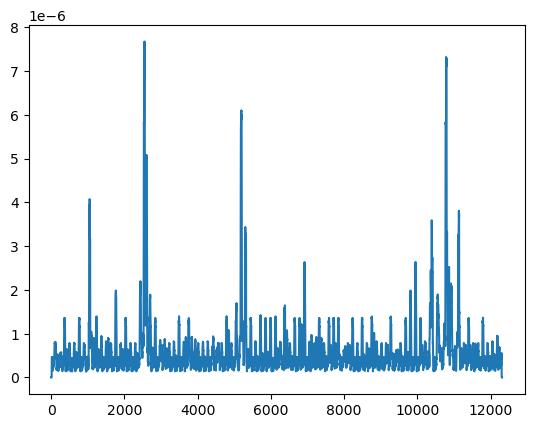

 56%|██████████████████████▉                  | 168/300 [08:27<06:12,  2.82s/it]

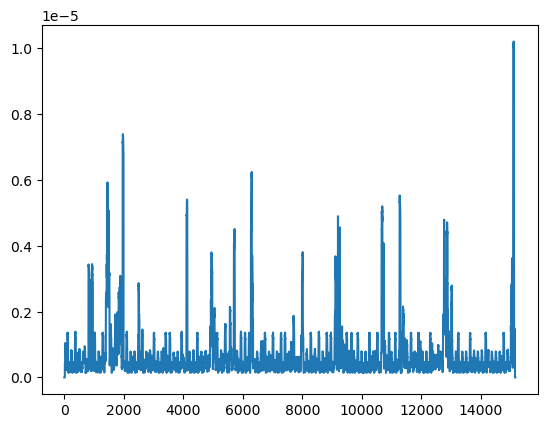

 56%|███████████████████████                  | 169/300 [08:30<06:11,  2.84s/it]

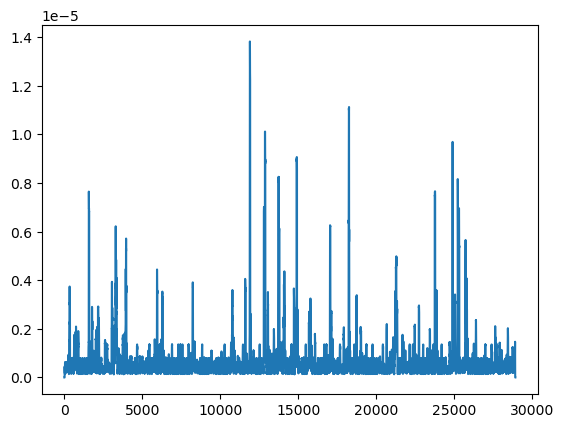

 57%|███████████████████████▏                 | 170/300 [08:36<07:55,  3.66s/it]

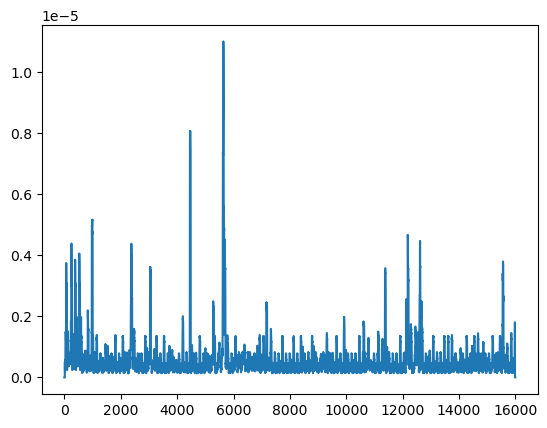

 57%|███████████████████████▎                 | 171/300 [08:39<07:28,  3.48s/it]

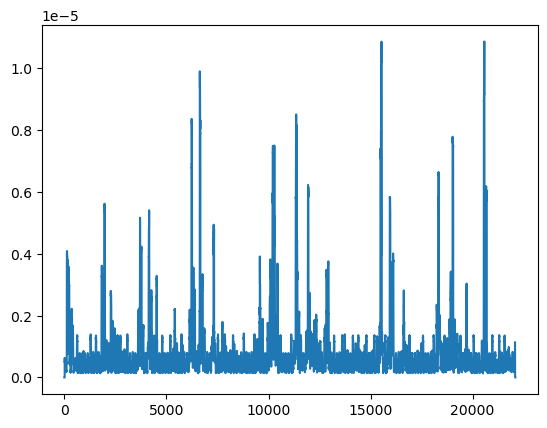

 57%|███████████████████████▌                 | 172/300 [08:43<08:02,  3.77s/it]

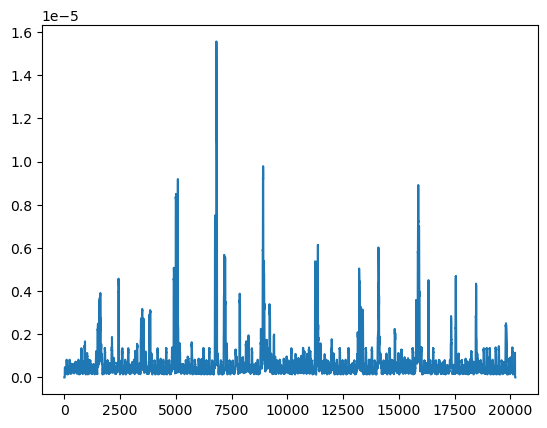

 58%|███████████████████████▋                 | 173/300 [08:47<08:04,  3.82s/it]

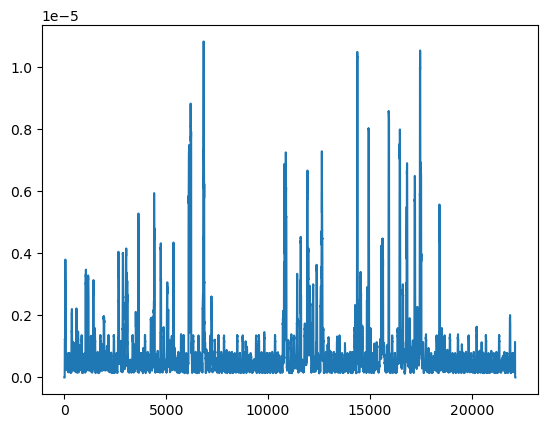

 58%|███████████████████████▊                 | 174/300 [08:52<08:20,  3.97s/it]

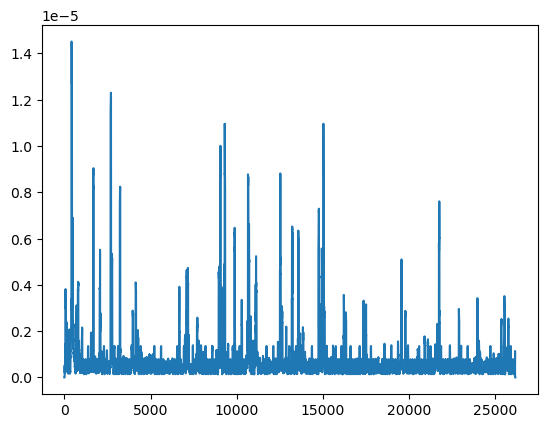

 58%|███████████████████████▉                 | 175/300 [08:57<08:55,  4.29s/it]

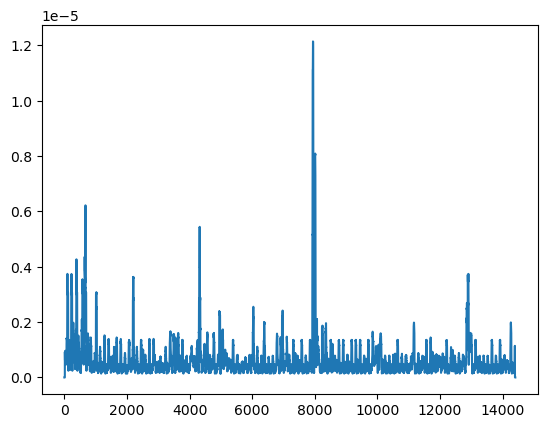

 59%|████████████████████████                 | 176/300 [08:59<07:50,  3.80s/it]

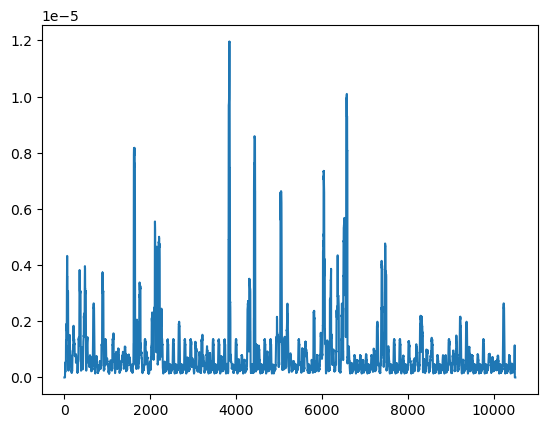

 59%|████████████████████████▏                | 177/300 [09:01<06:41,  3.27s/it]

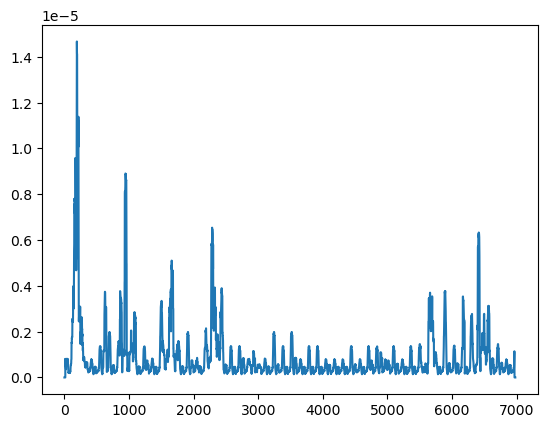

 59%|████████████████████████▎                | 178/300 [09:03<05:28,  2.69s/it]

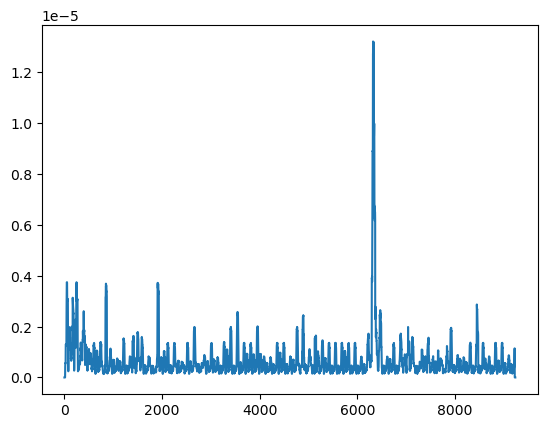

 60%|████████████████████████▍                | 179/300 [09:04<04:51,  2.41s/it]

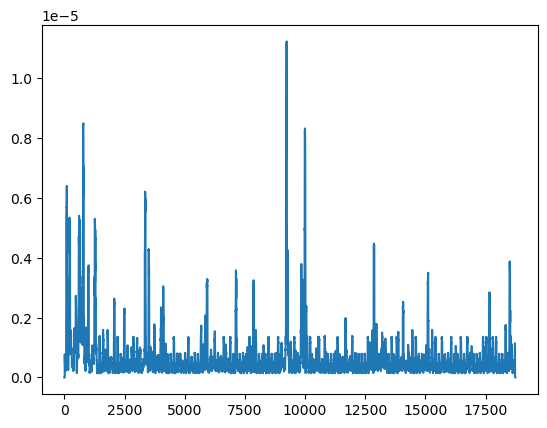

 60%|████████████████████████▌                | 180/300 [09:08<05:32,  2.77s/it]

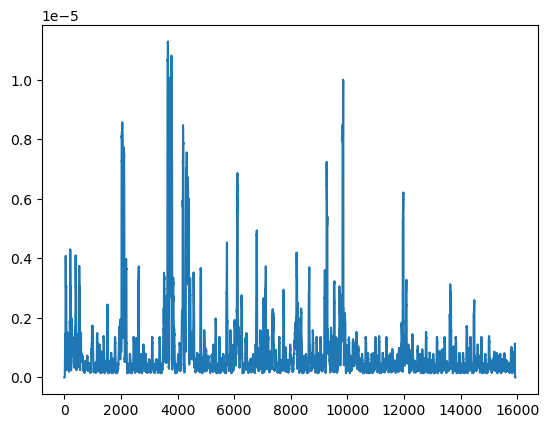

 60%|████████████████████████▋                | 181/300 [09:11<05:42,  2.88s/it]

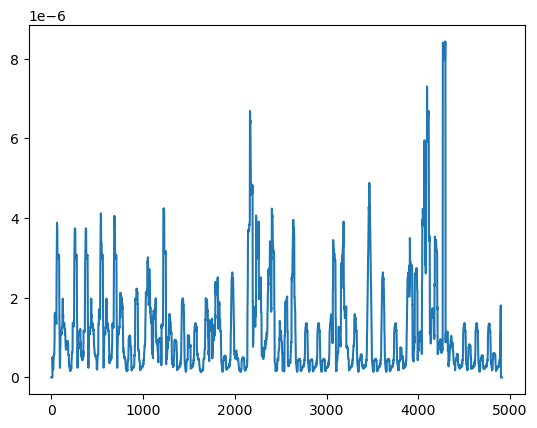

 61%|████████████████████████▊                | 182/300 [09:12<04:33,  2.32s/it]

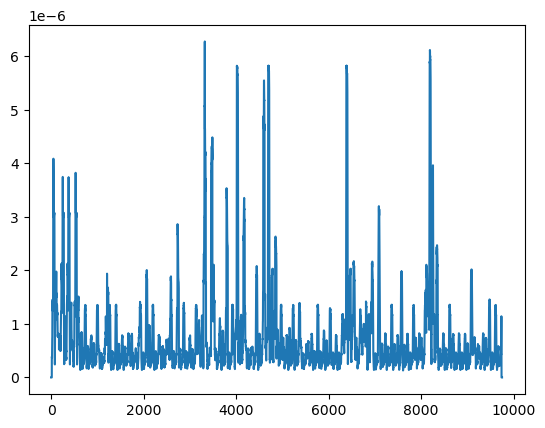

 61%|█████████████████████████                | 183/300 [09:14<04:16,  2.19s/it]

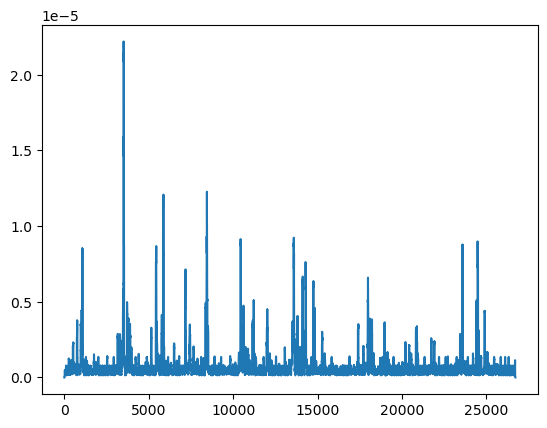

 61%|█████████████████████████▏               | 184/300 [09:19<06:01,  3.12s/it]

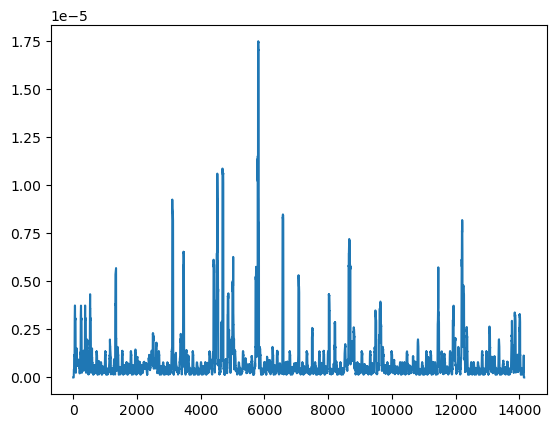

 62%|█████████████████████████▎               | 185/300 [09:22<05:42,  2.98s/it]

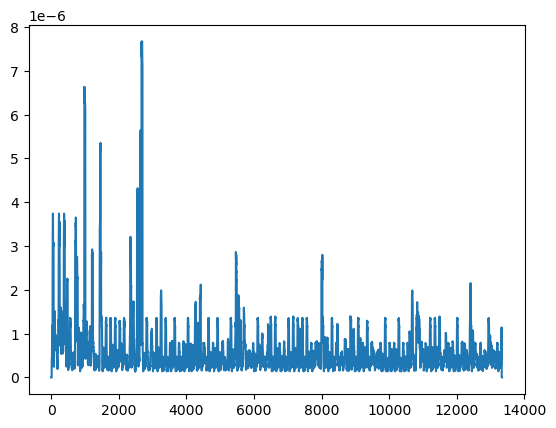

 62%|█████████████████████████▍               | 186/300 [09:25<05:23,  2.84s/it]

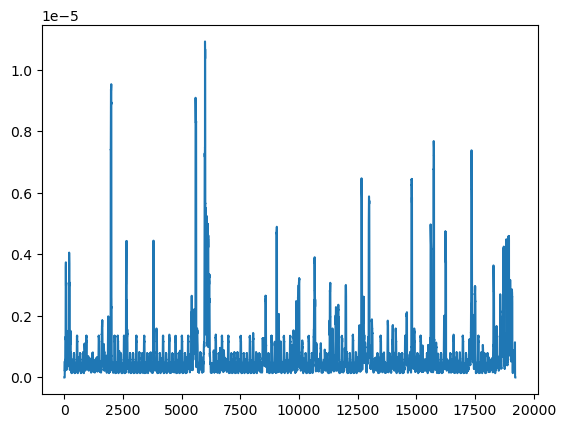

 62%|█████████████████████████▌               | 187/300 [09:28<05:53,  3.13s/it]

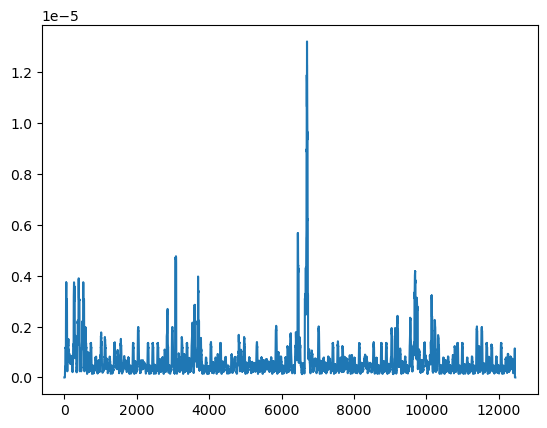

 63%|█████████████████████████▋               | 188/300 [09:31<05:25,  2.90s/it]

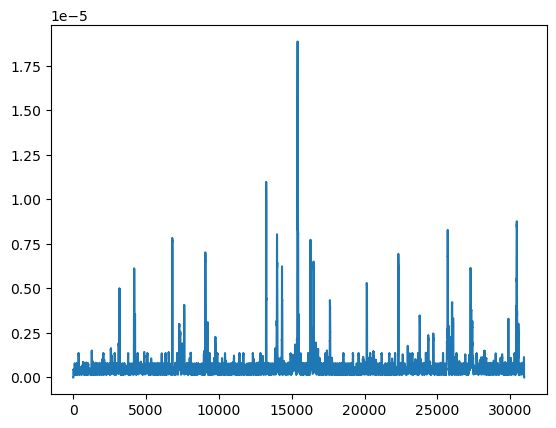

 63%|█████████████████████████▊               | 189/300 [09:37<07:18,  3.95s/it]

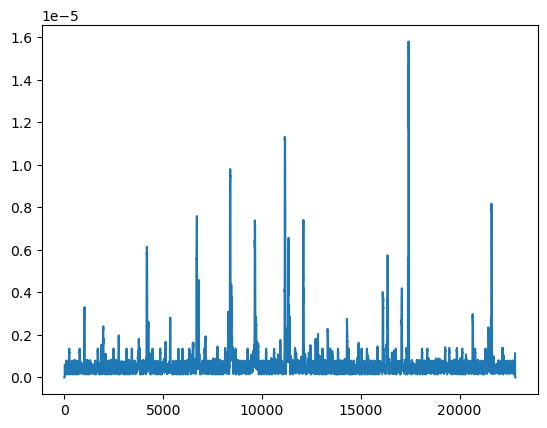

 63%|█████████████████████████▉               | 190/300 [09:41<07:23,  4.03s/it]

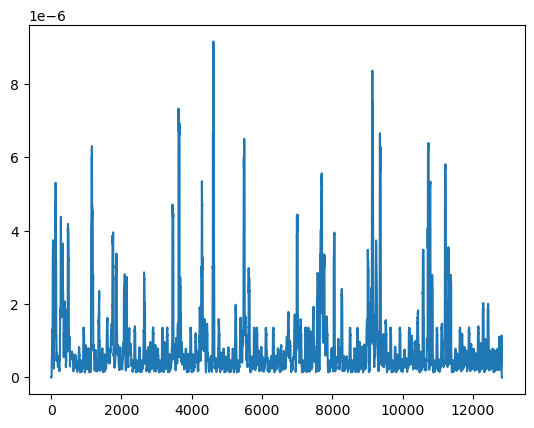

 64%|██████████████████████████               | 191/300 [09:44<06:27,  3.55s/it]

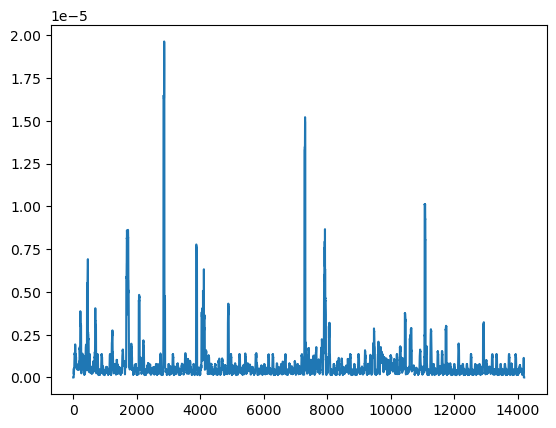

 64%|██████████████████████████▏              | 192/300 [09:46<05:53,  3.28s/it]

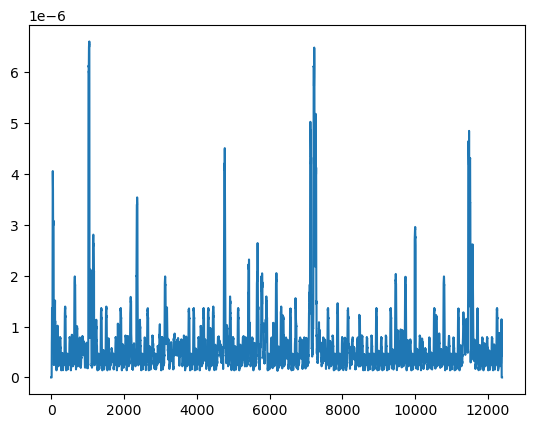

 64%|██████████████████████████▍              | 193/300 [09:49<05:20,  2.99s/it]

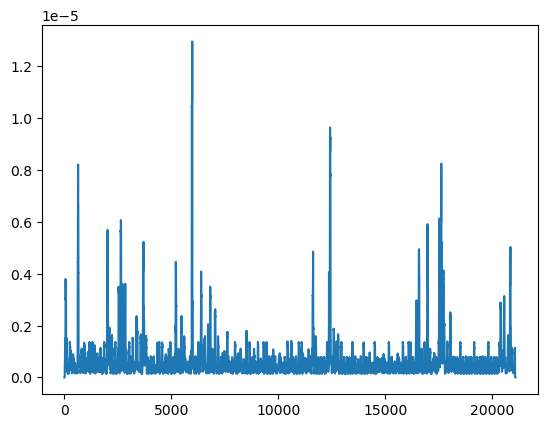

 65%|██████████████████████████▌              | 194/300 [09:53<05:51,  3.32s/it]

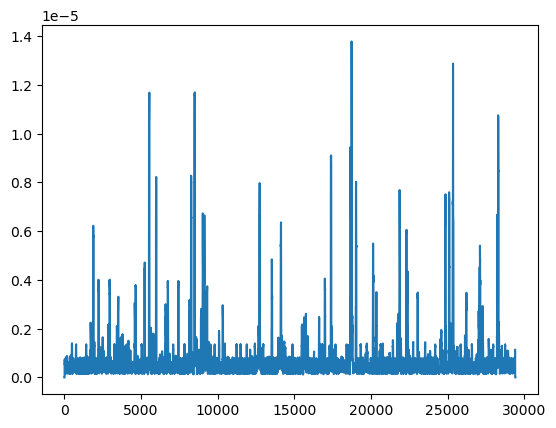

 65%|██████████████████████████▋              | 195/300 [09:59<07:03,  4.04s/it]

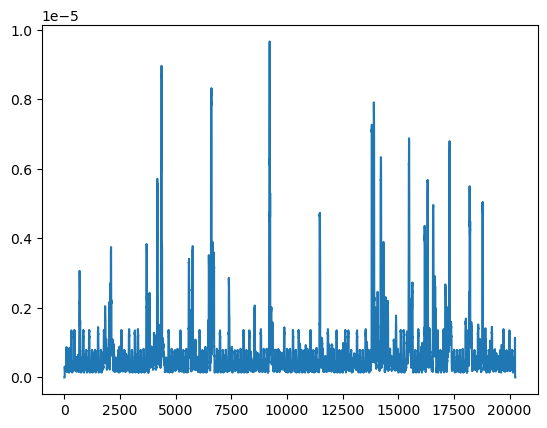

 65%|██████████████████████████▊              | 196/300 [10:02<06:50,  3.95s/it]

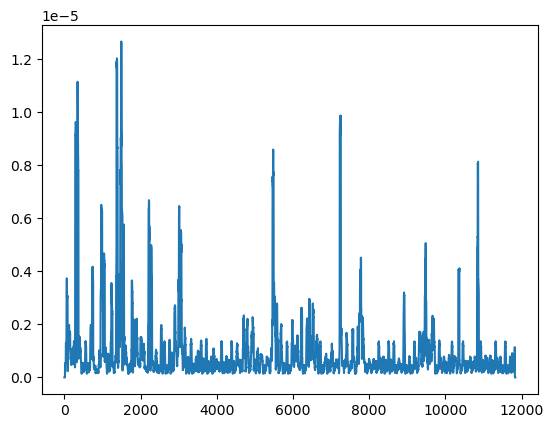

 66%|██████████████████████████▉              | 197/300 [10:04<05:53,  3.43s/it]

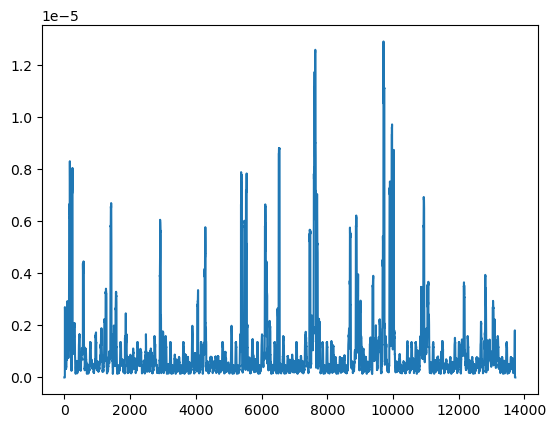

 66%|███████████████████████████              | 198/300 [10:07<05:31,  3.25s/it]

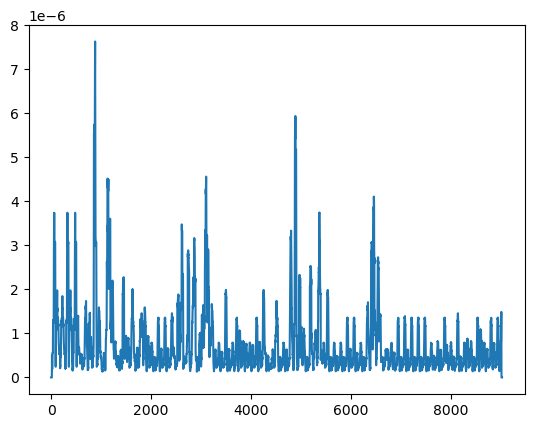

 66%|███████████████████████████▏             | 199/300 [10:09<04:43,  2.80s/it]

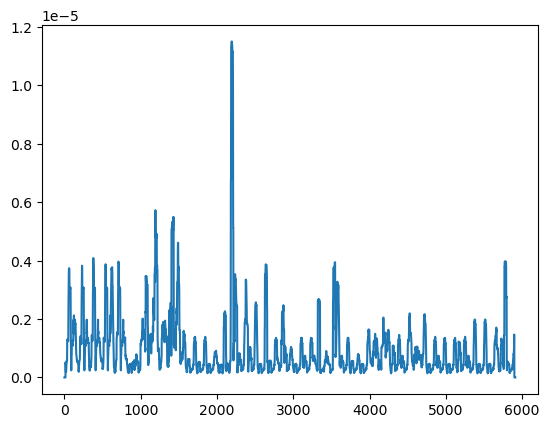

 67%|███████████████████████████▎             | 200/300 [10:10<03:51,  2.31s/it]

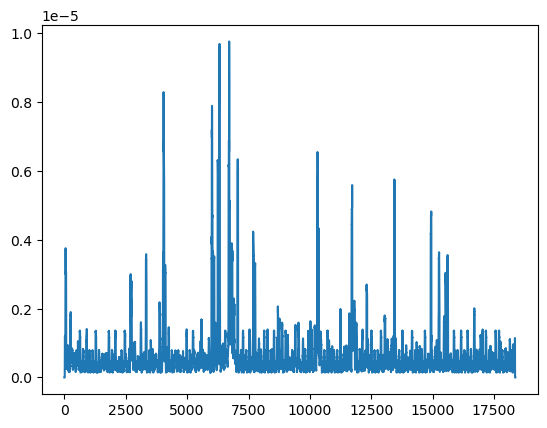

 67%|███████████████████████████▍             | 201/300 [10:14<04:29,  2.73s/it]

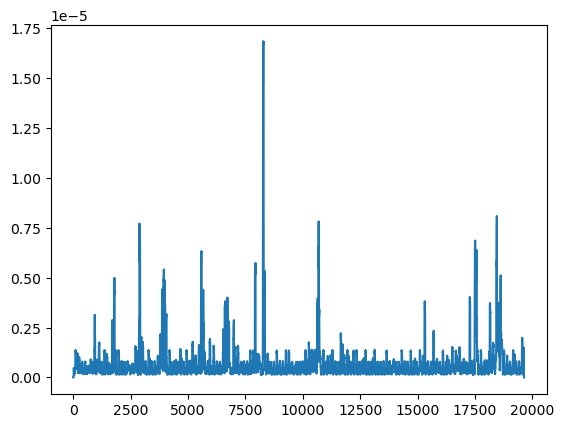

 67%|███████████████████████████▌             | 202/300 [10:18<04:56,  3.03s/it]

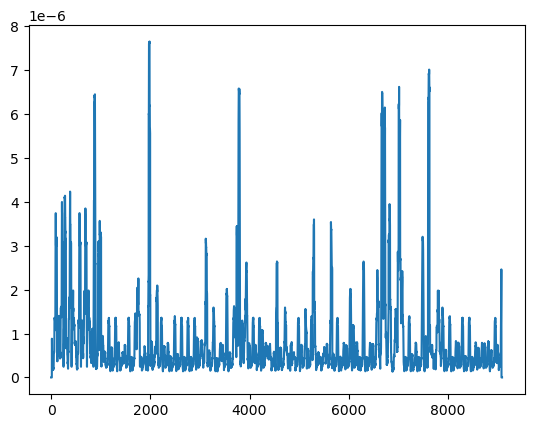

 68%|███████████████████████████▋             | 203/300 [10:19<04:16,  2.64s/it]

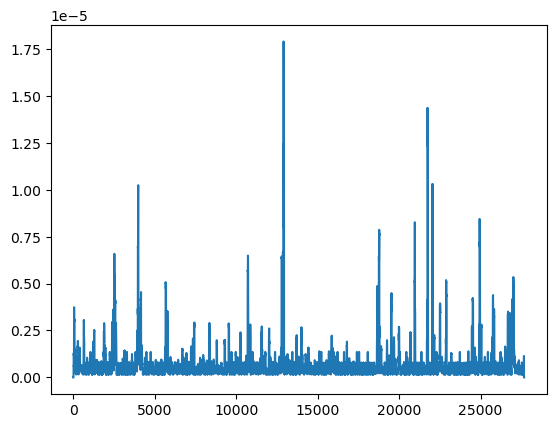

 68%|███████████████████████████▉             | 204/300 [10:25<05:34,  3.48s/it]

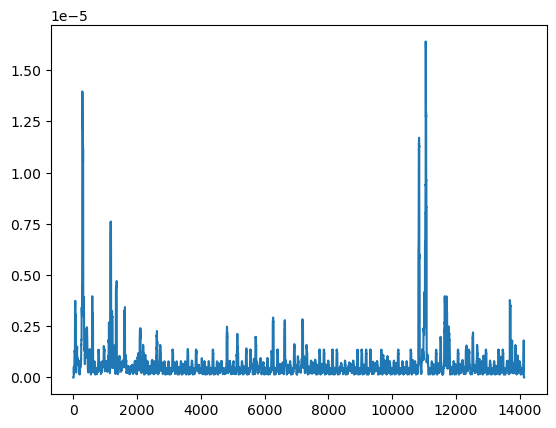

 68%|████████████████████████████             | 205/300 [10:27<05:07,  3.23s/it]

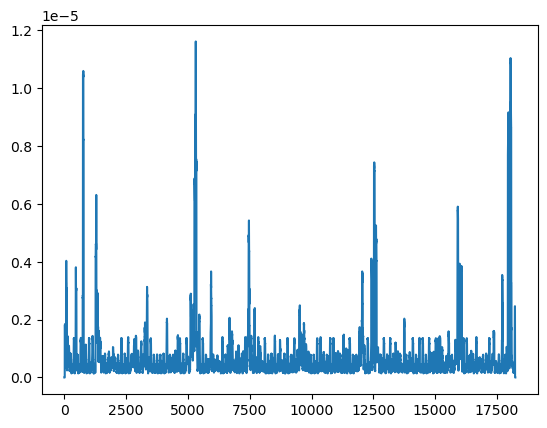

 69%|████████████████████████████▏            | 206/300 [10:31<05:09,  3.30s/it]

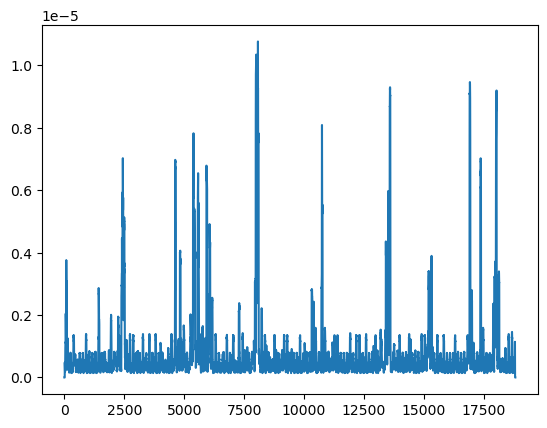

 69%|████████████████████████████▎            | 207/300 [10:35<05:20,  3.44s/it]

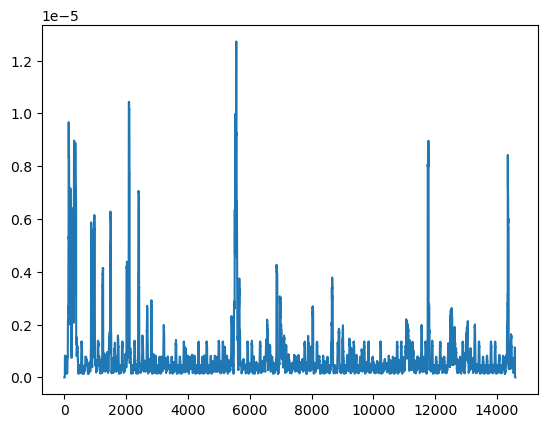

 69%|████████████████████████████▍            | 208/300 [10:37<04:57,  3.24s/it]

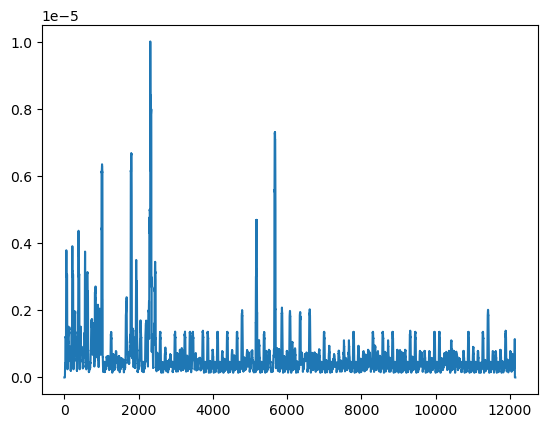

 70%|████████████████████████████▌            | 209/300 [10:40<04:28,  2.95s/it]

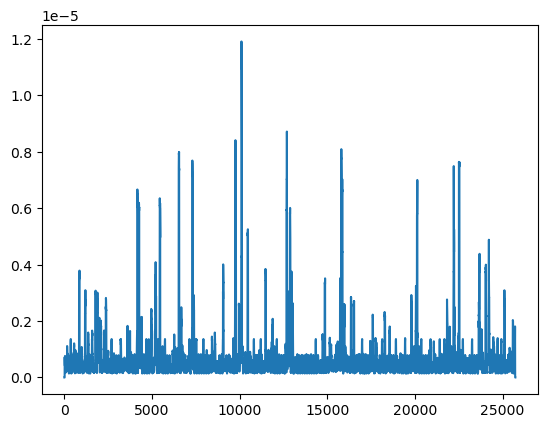

 70%|████████████████████████████▋            | 210/300 [10:45<05:21,  3.58s/it]

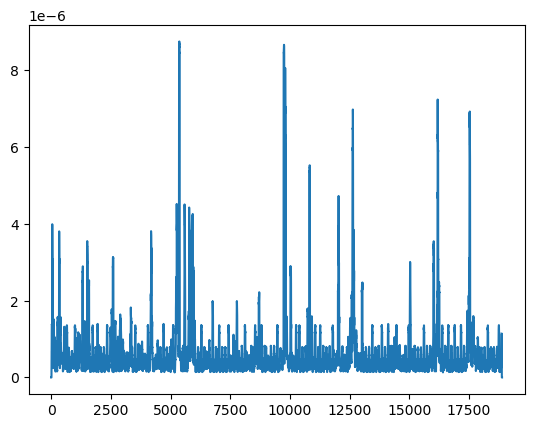

 70%|████████████████████████████▊            | 211/300 [10:48<05:18,  3.58s/it]

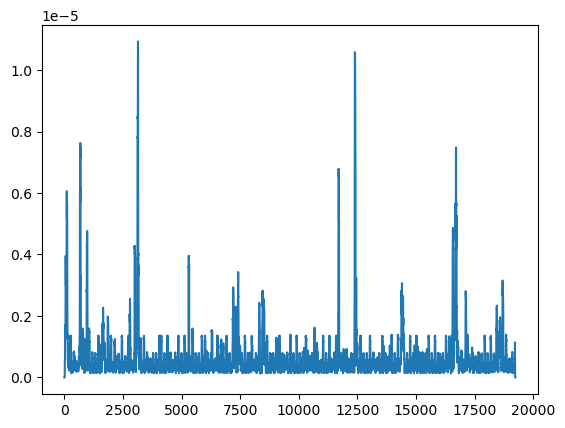

 71%|████████████████████████████▉            | 212/300 [10:52<05:15,  3.59s/it]

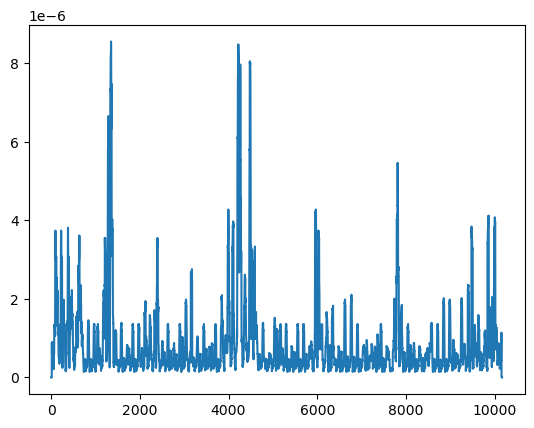

 71%|█████████████████████████████            | 213/300 [10:54<04:30,  3.11s/it]

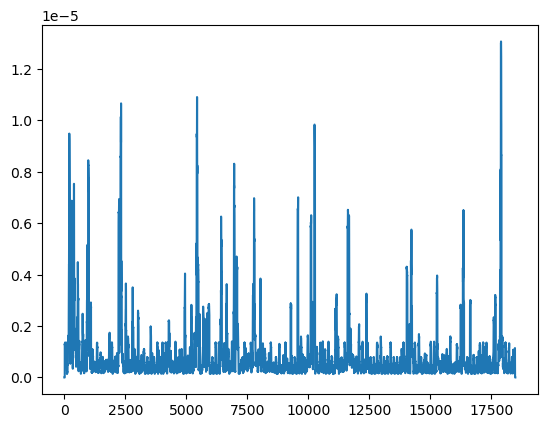

 71%|█████████████████████████████▏           | 214/300 [10:57<04:36,  3.22s/it]

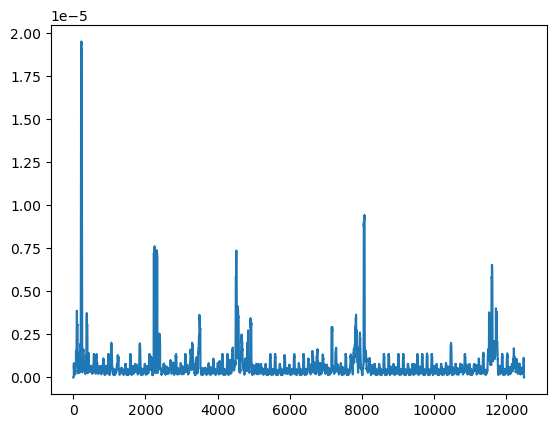

 72%|█████████████████████████████▍           | 215/300 [11:00<04:13,  2.98s/it]

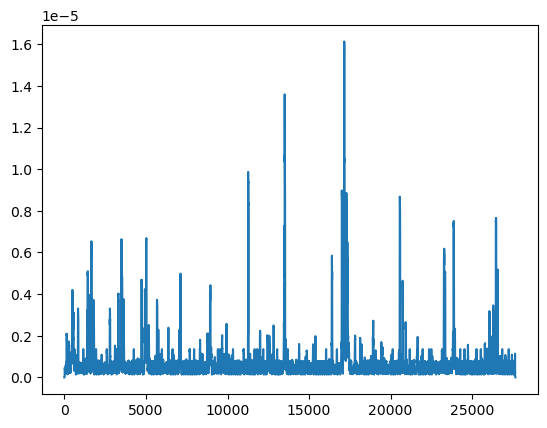

 72%|█████████████████████████████▌           | 216/300 [11:05<05:09,  3.69s/it]

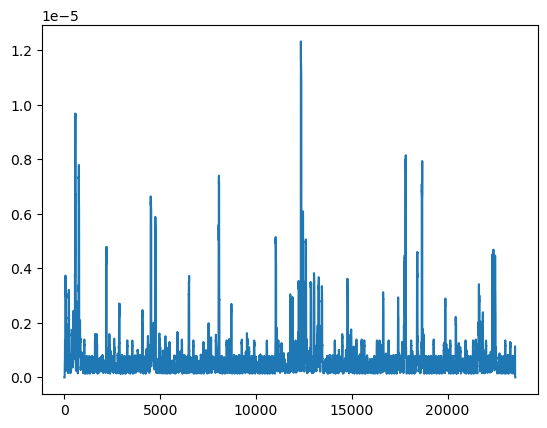

 72%|█████████████████████████████▋           | 217/300 [11:10<05:23,  3.90s/it]

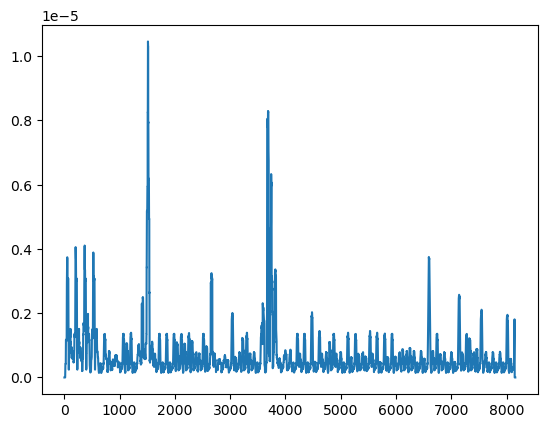

 73%|█████████████████████████████▊           | 218/300 [11:11<04:23,  3.21s/it]

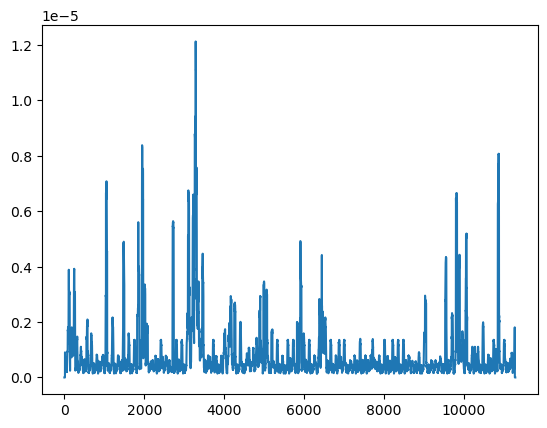

 73%|█████████████████████████████▉           | 219/300 [11:13<03:53,  2.89s/it]

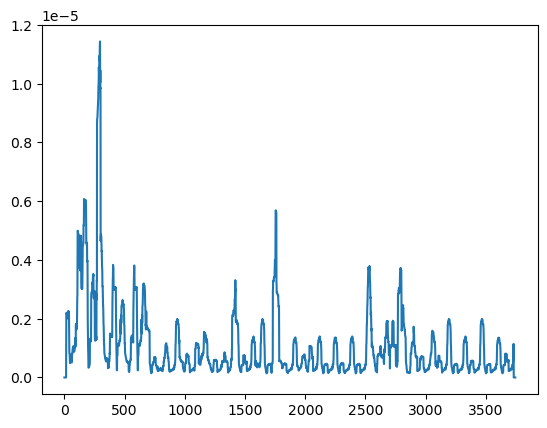

 73%|██████████████████████████████           | 220/300 [11:14<03:00,  2.25s/it]

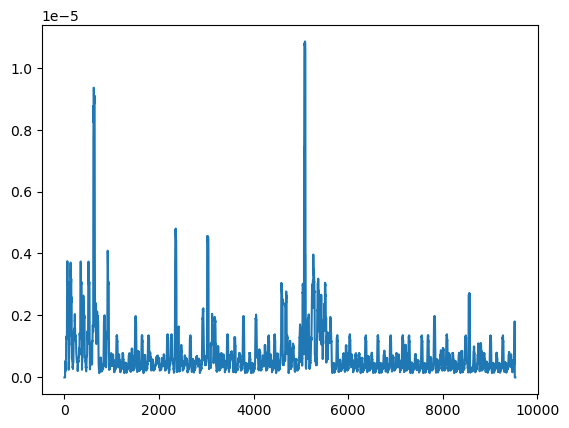

 74%|██████████████████████████████▏          | 221/300 [11:16<02:48,  2.13s/it]

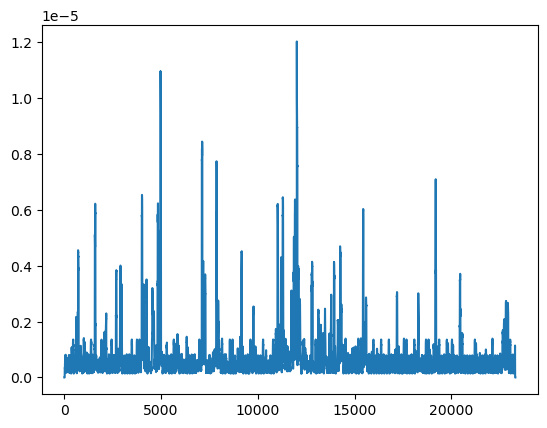

 74%|██████████████████████████████▎          | 222/300 [11:21<03:46,  2.90s/it]

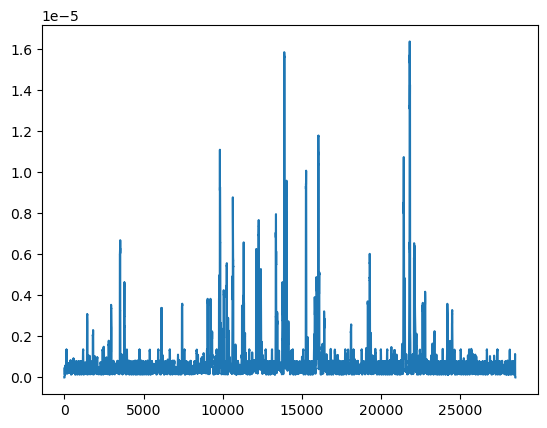

 74%|██████████████████████████████▍          | 223/300 [11:27<04:52,  3.80s/it]

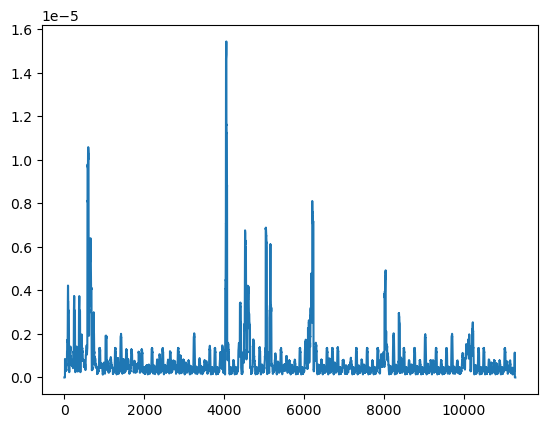

 75%|██████████████████████████████▌          | 224/300 [11:29<04:12,  3.32s/it]

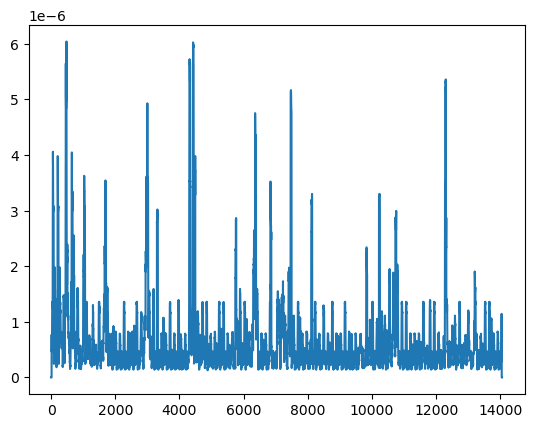

 75%|██████████████████████████████▊          | 225/300 [11:31<03:53,  3.11s/it]

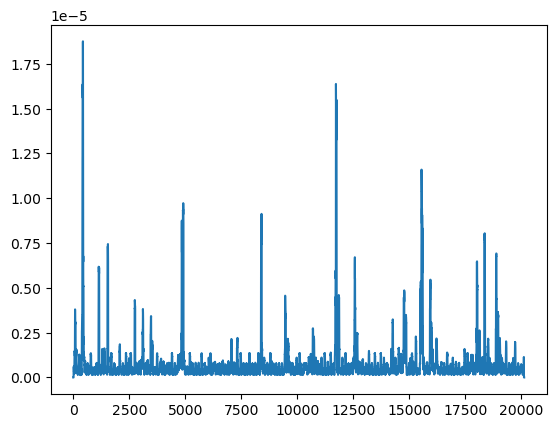

 75%|██████████████████████████████▉          | 226/300 [11:35<04:07,  3.34s/it]

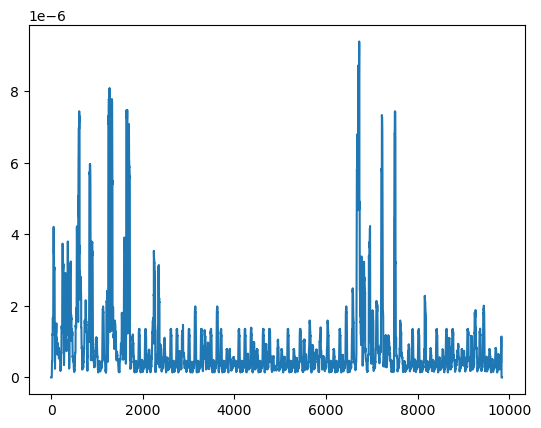

 76%|███████████████████████████████          | 227/300 [11:37<03:32,  2.91s/it]

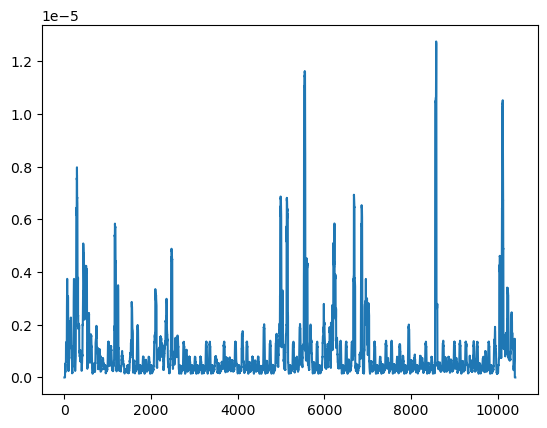

 76%|███████████████████████████████▏         | 228/300 [11:39<03:10,  2.65s/it]

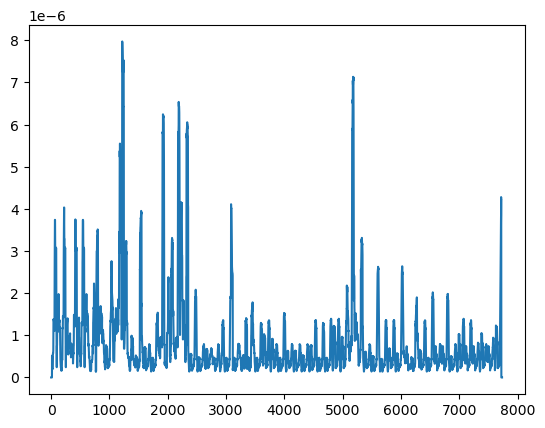

 76%|███████████████████████████████▎         | 229/300 [11:41<02:43,  2.30s/it]

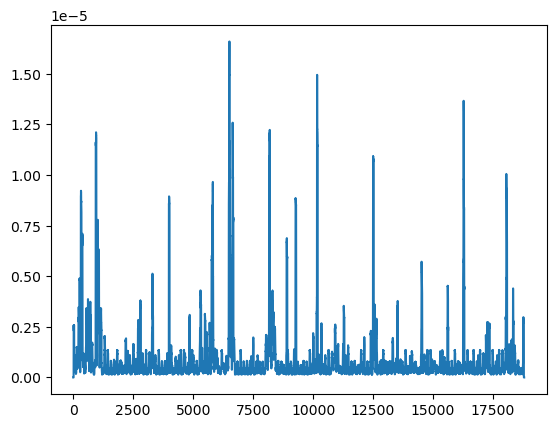

 77%|███████████████████████████████▍         | 230/300 [11:44<03:09,  2.71s/it]

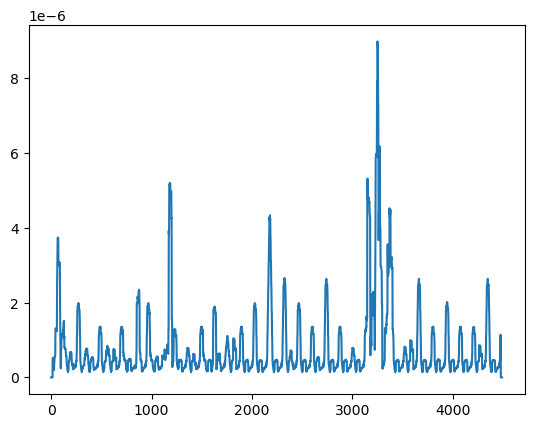

 77%|███████████████████████████████▌         | 231/300 [11:45<02:28,  2.16s/it]

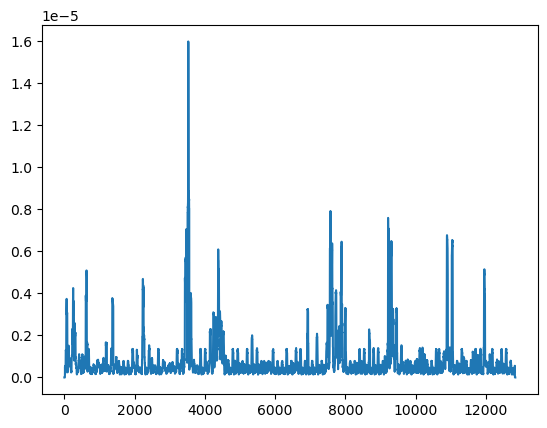

 77%|███████████████████████████████▋         | 232/300 [11:48<02:35,  2.28s/it]

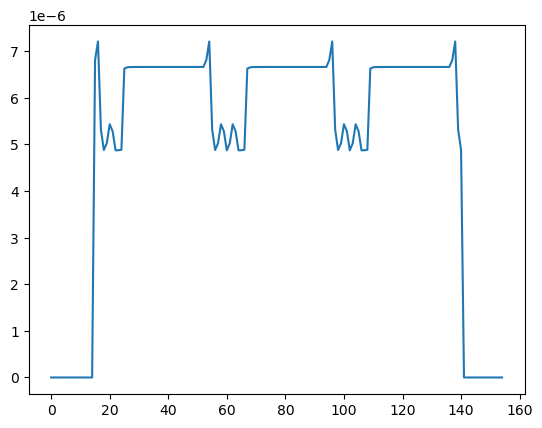

 78%|███████████████████████████████▊         | 233/300 [11:48<01:50,  1.64s/it]

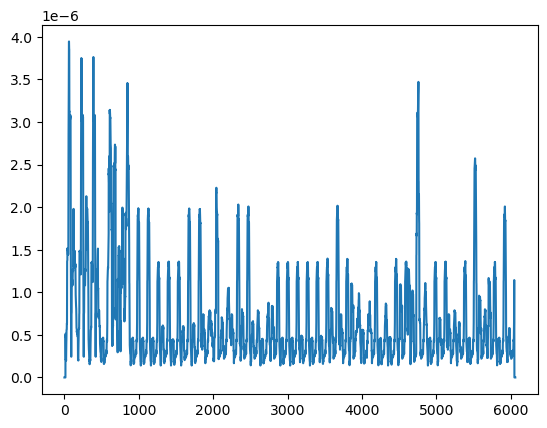

 78%|███████████████████████████████▉         | 234/300 [11:49<01:39,  1.50s/it]

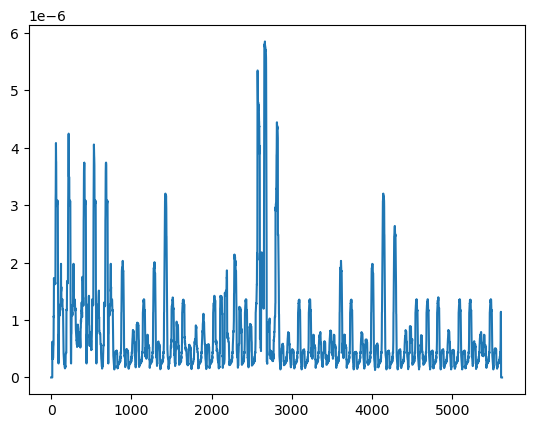

 78%|████████████████████████████████         | 235/300 [11:50<01:30,  1.40s/it]

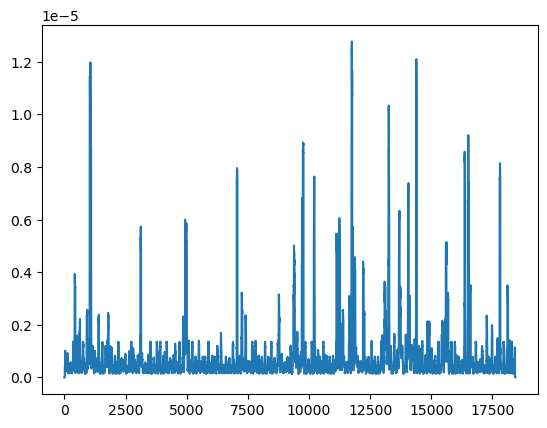

 79%|████████████████████████████████▎        | 236/300 [11:54<02:12,  2.07s/it]

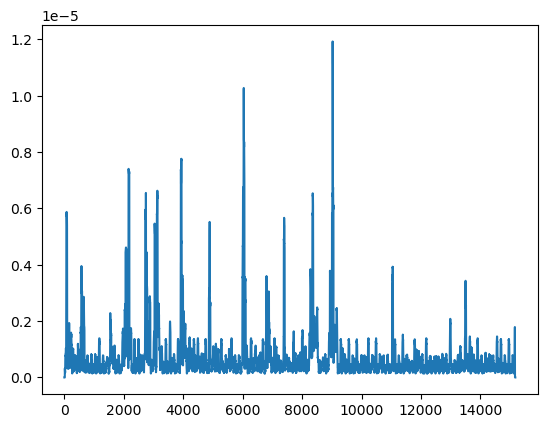

 79%|████████████████████████████████▍        | 237/300 [11:57<02:27,  2.34s/it]

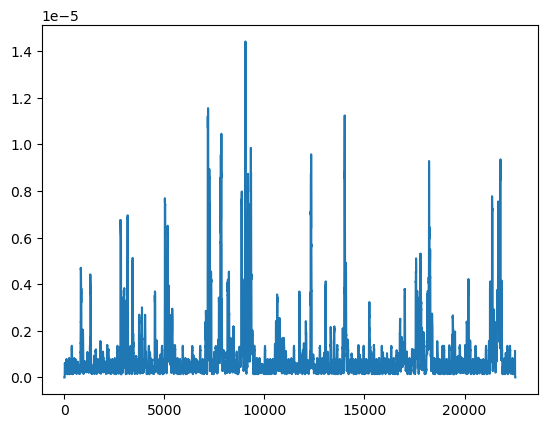

 79%|████████████████████████████████▌        | 238/300 [12:01<03:02,  2.95s/it]

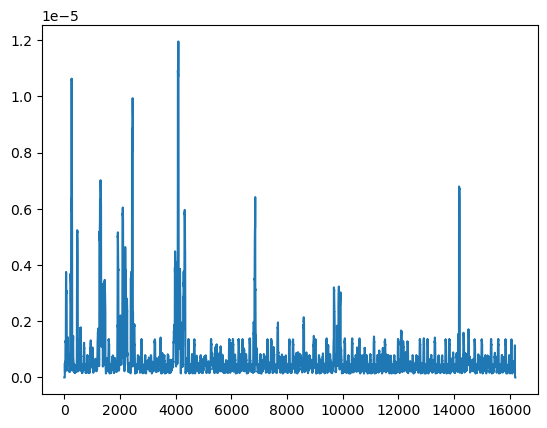

 80%|████████████████████████████████▋        | 239/300 [12:04<03:01,  2.97s/it]

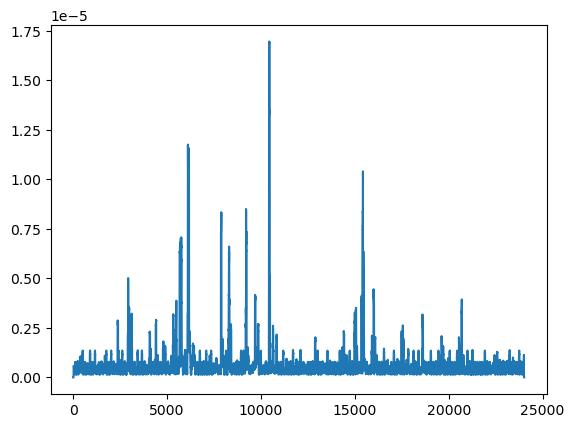

 80%|████████████████████████████████▊        | 240/300 [12:09<03:30,  3.52s/it]

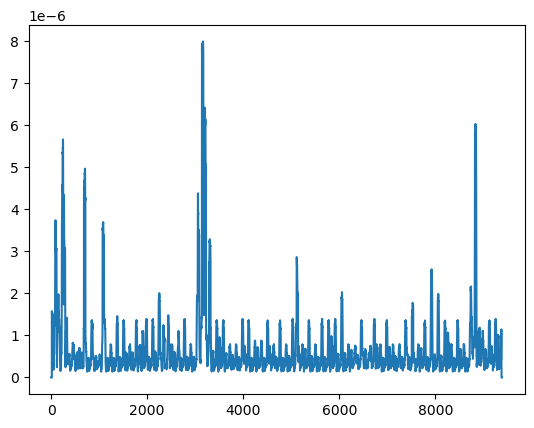

 80%|████████████████████████████████▉        | 241/300 [12:11<02:57,  3.00s/it]

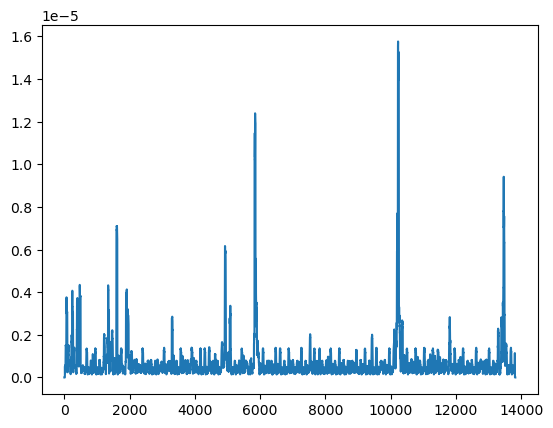

 81%|█████████████████████████████████        | 242/300 [12:14<02:49,  2.92s/it]

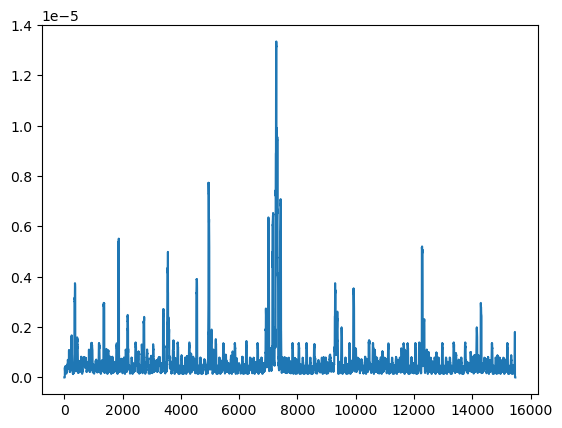

 81%|█████████████████████████████████▏       | 243/300 [12:17<02:53,  3.05s/it]

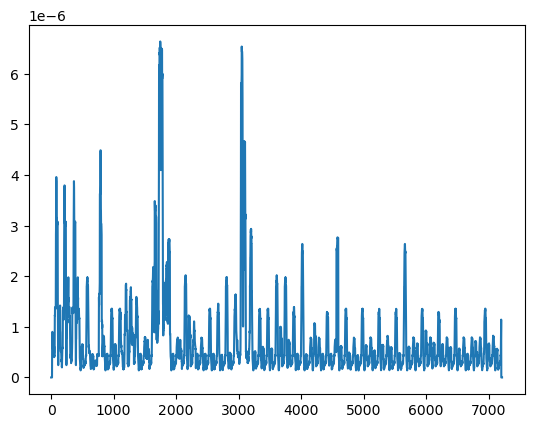

 81%|█████████████████████████████████▎       | 244/300 [12:18<02:23,  2.57s/it]

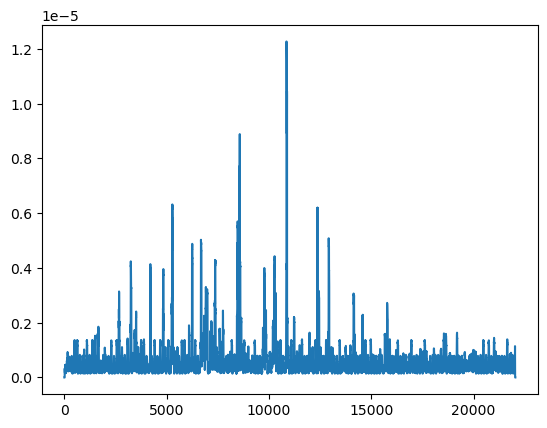

 82%|█████████████████████████████████▍       | 245/300 [12:23<02:50,  3.10s/it]

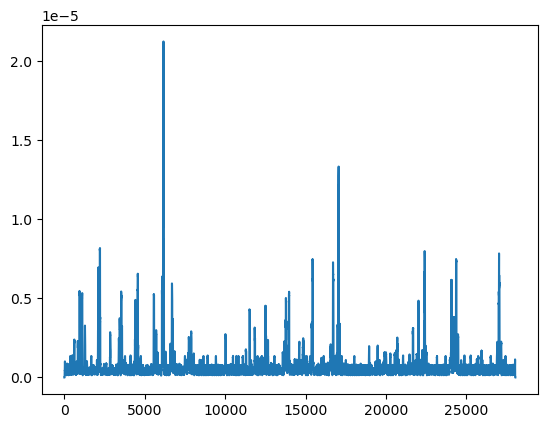

 82%|█████████████████████████████████▌       | 246/300 [12:28<03:23,  3.78s/it]

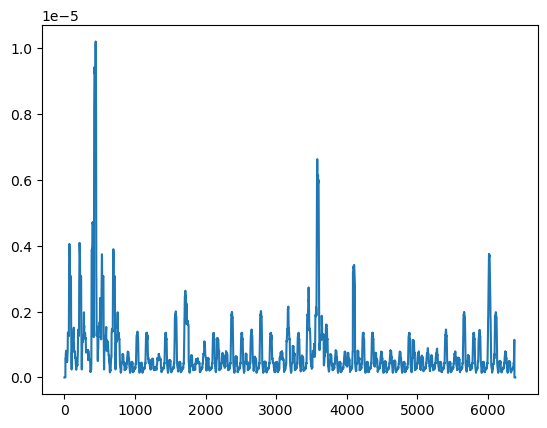

 82%|█████████████████████████████████▊       | 247/300 [12:29<02:40,  3.03s/it]

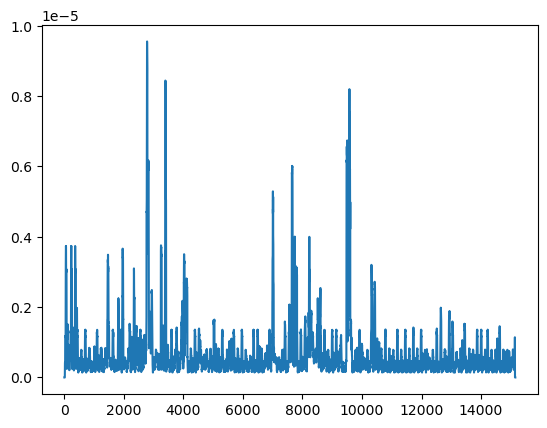

 83%|█████████████████████████████████▉       | 248/300 [12:32<02:34,  2.97s/it]

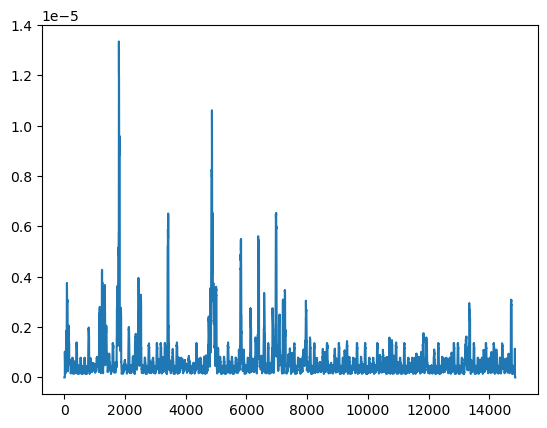

 83%|██████████████████████████████████       | 249/300 [12:35<02:29,  2.94s/it]

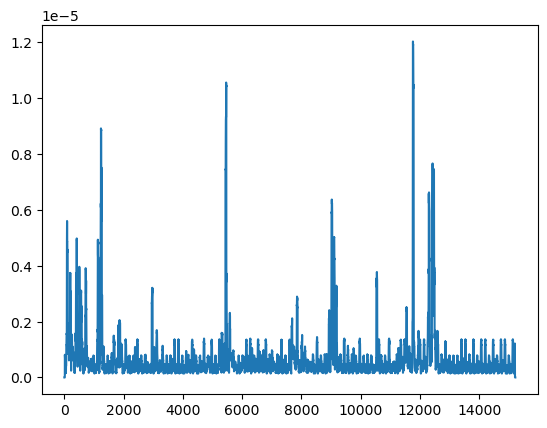

 83%|██████████████████████████████████▏      | 250/300 [12:38<02:27,  2.94s/it]

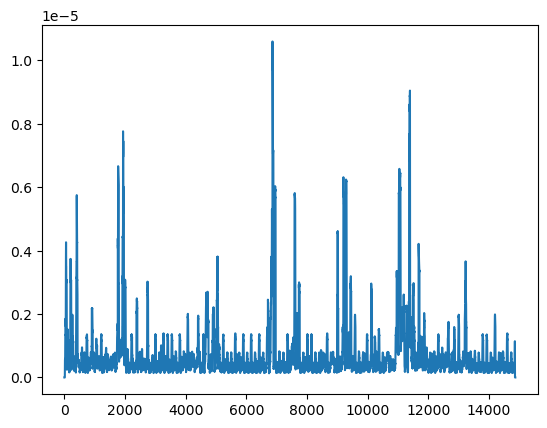

 84%|██████████████████████████████████▎      | 251/300 [12:41<02:22,  2.90s/it]

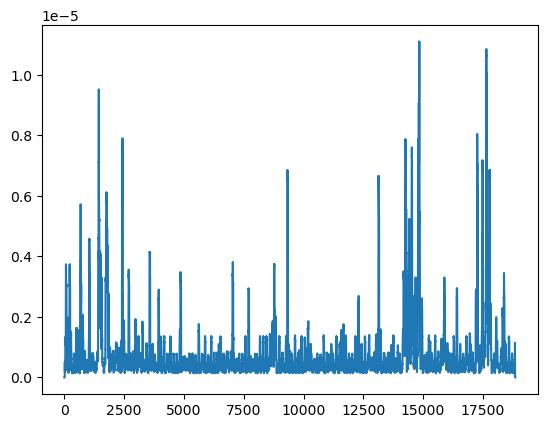

 84%|██████████████████████████████████▍      | 252/300 [12:45<02:33,  3.19s/it]

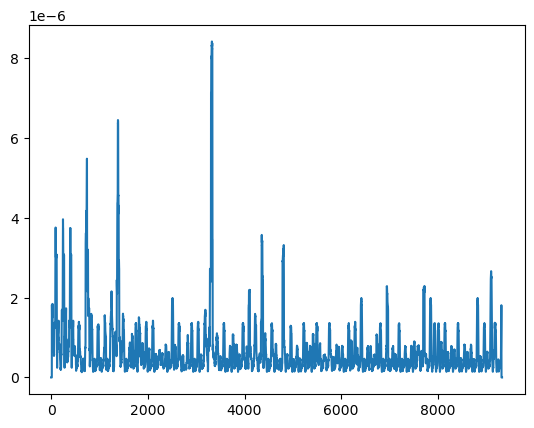

 84%|██████████████████████████████████▌      | 253/300 [12:47<02:10,  2.78s/it]

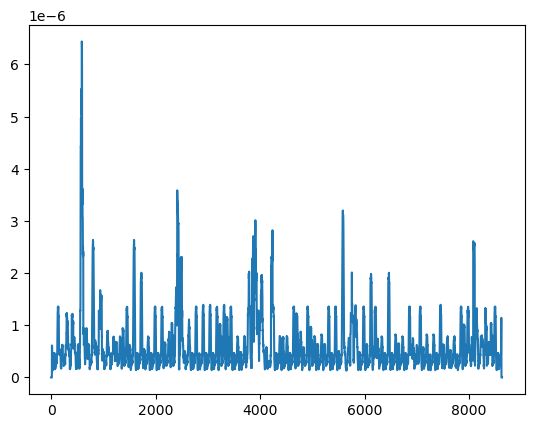

 85%|██████████████████████████████████▋      | 254/300 [12:48<01:52,  2.44s/it]

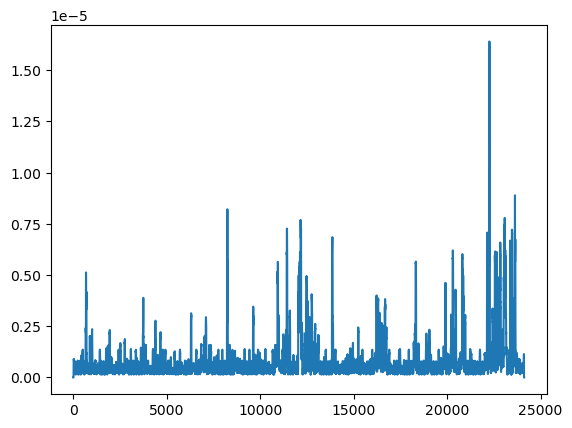

 85%|██████████████████████████████████▊      | 255/300 [12:53<02:19,  3.10s/it]

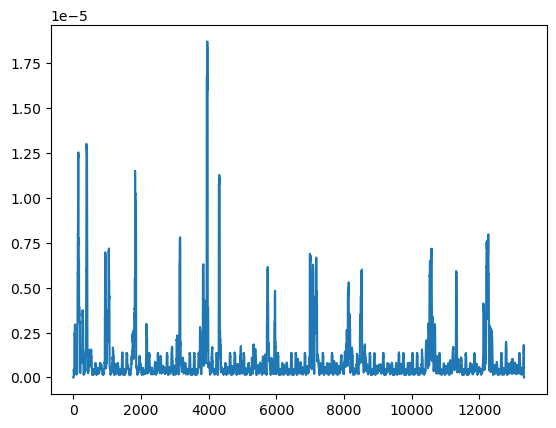

 85%|██████████████████████████████████▉      | 256/300 [12:55<02:08,  2.92s/it]

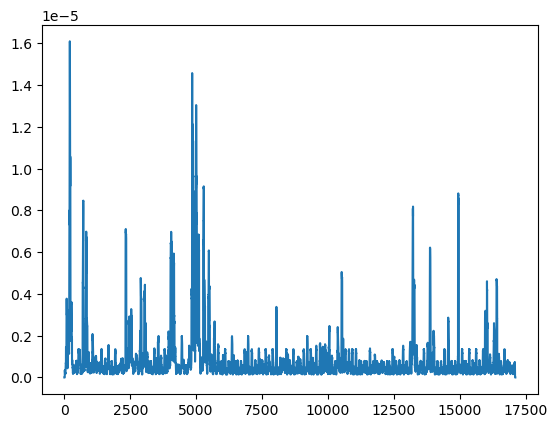

 86%|███████████████████████████████████      | 257/300 [12:58<02:09,  3.00s/it]

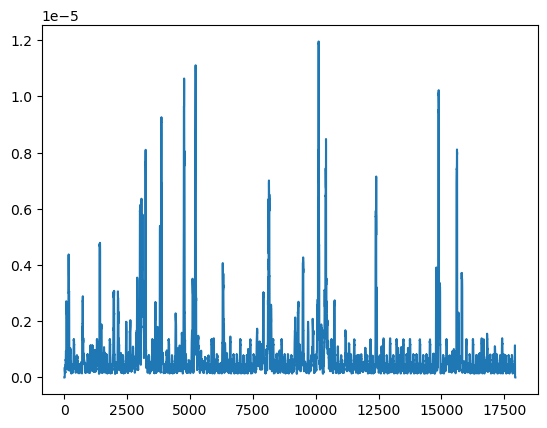

 86%|███████████████████████████████████▎     | 258/300 [13:02<02:10,  3.12s/it]

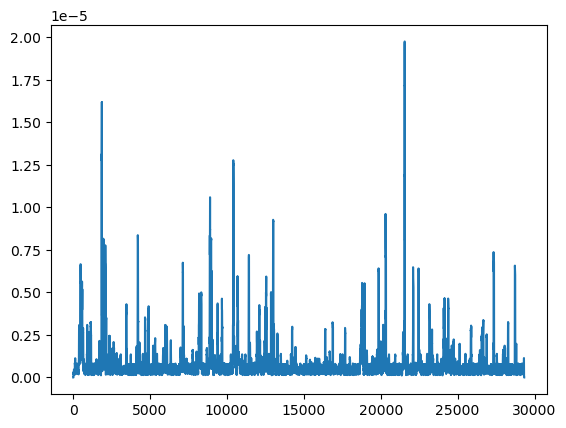

 86%|███████████████████████████████████▍     | 259/300 [13:08<02:42,  3.96s/it]

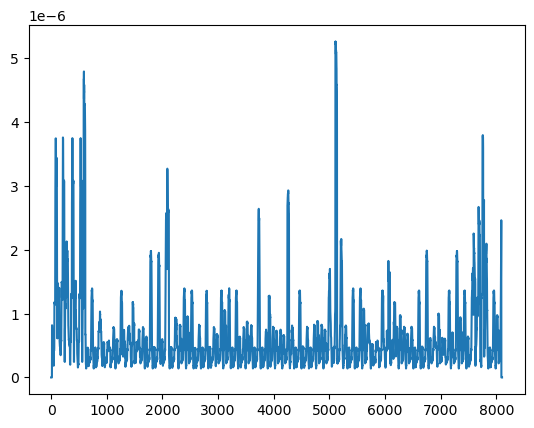

 87%|███████████████████████████████████▌     | 260/300 [13:09<02:09,  3.25s/it]

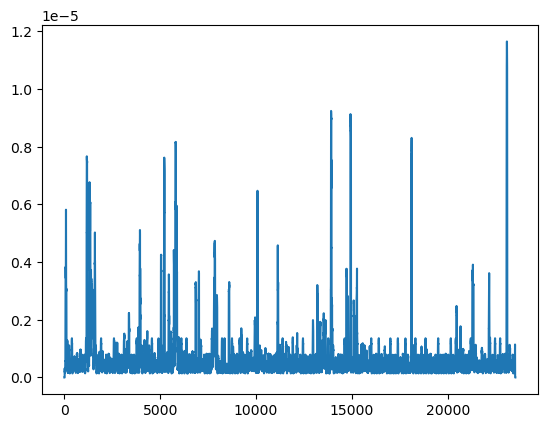

 87%|███████████████████████████████████▋     | 261/300 [13:14<02:21,  3.64s/it]

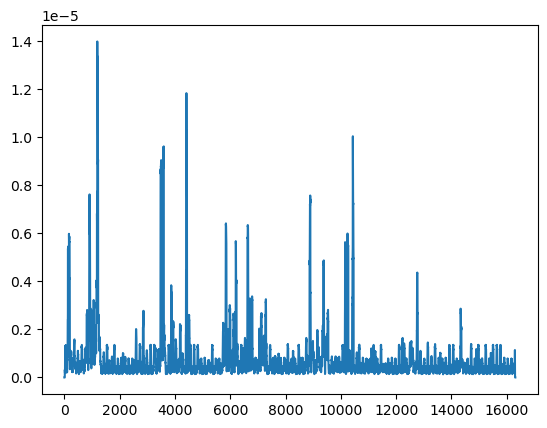

 87%|███████████████████████████████████▊     | 262/300 [13:17<02:13,  3.52s/it]

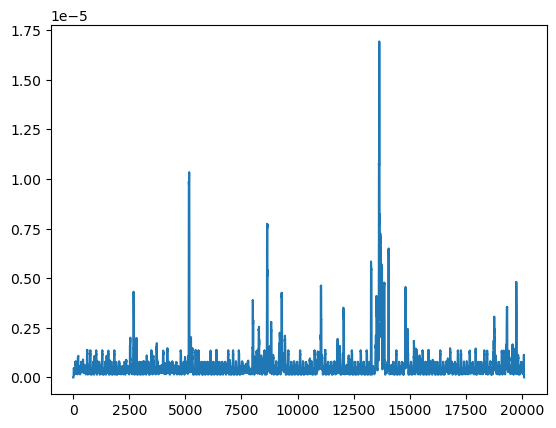

 88%|███████████████████████████████████▉     | 263/300 [13:21<02:13,  3.61s/it]

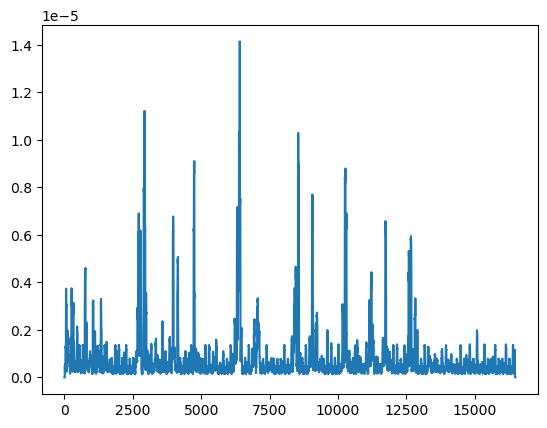

 88%|████████████████████████████████████     | 264/300 [13:24<02:06,  3.51s/it]

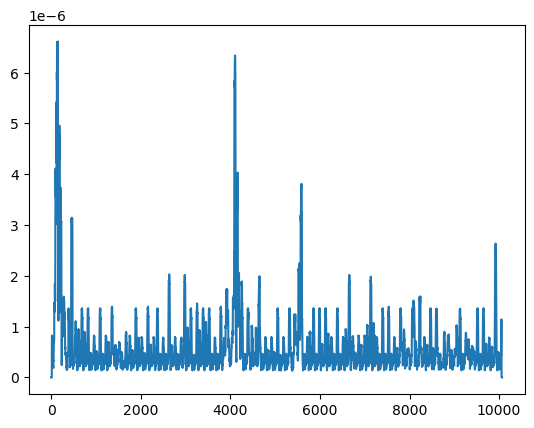

 88%|████████████████████████████████████▏    | 265/300 [13:26<01:46,  3.03s/it]

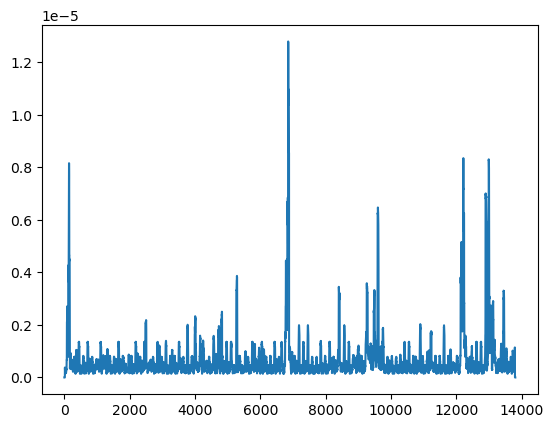

 89%|████████████████████████████████████▎    | 266/300 [13:29<01:39,  2.92s/it]

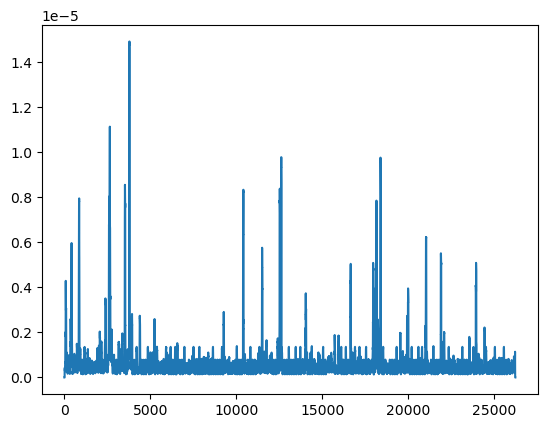

 89%|████████████████████████████████████▍    | 267/300 [13:34<01:58,  3.58s/it]

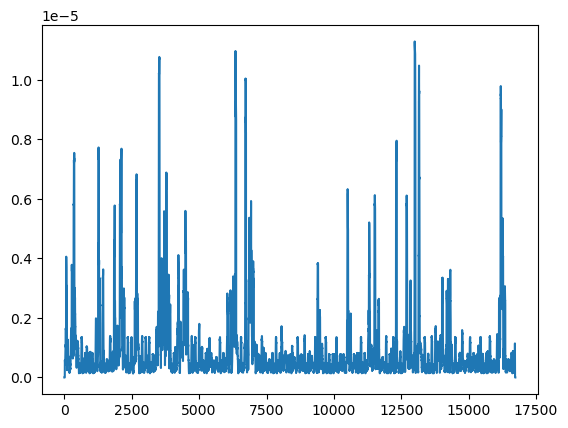

 89%|████████████████████████████████████▋    | 268/300 [13:37<01:50,  3.44s/it]

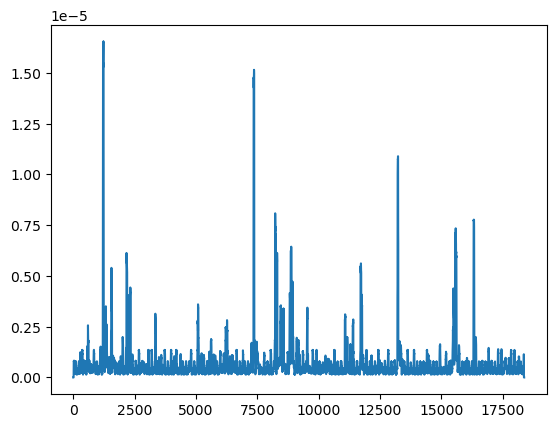

 90%|████████████████████████████████████▊    | 269/300 [13:41<01:46,  3.43s/it]

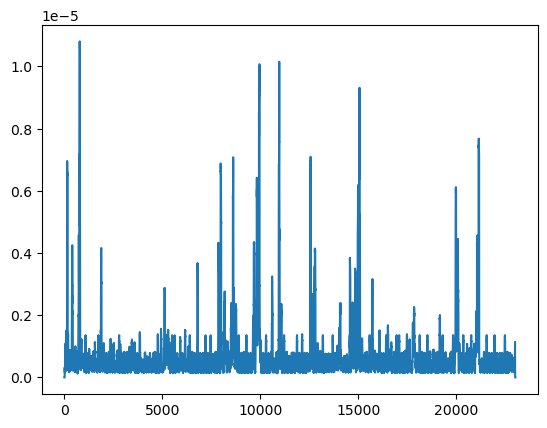

 90%|████████████████████████████████████▉    | 270/300 [13:45<01:53,  3.78s/it]

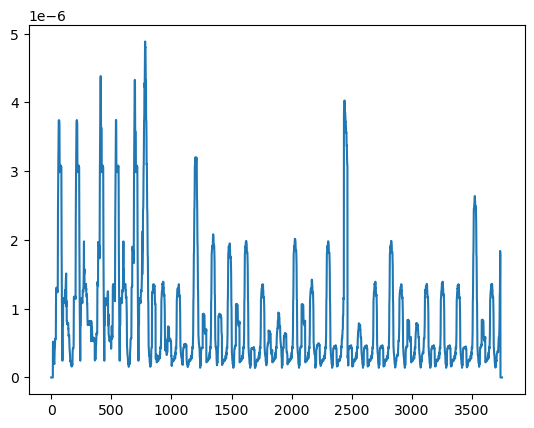

 90%|█████████████████████████████████████    | 271/300 [13:46<01:23,  2.89s/it]

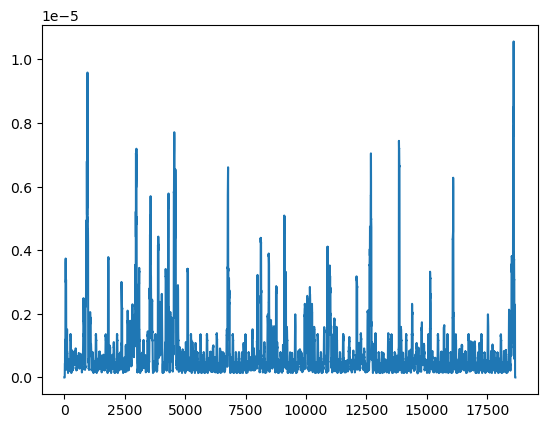

 91%|█████████████████████████████████████▏   | 272/300 [13:49<01:25,  3.07s/it]

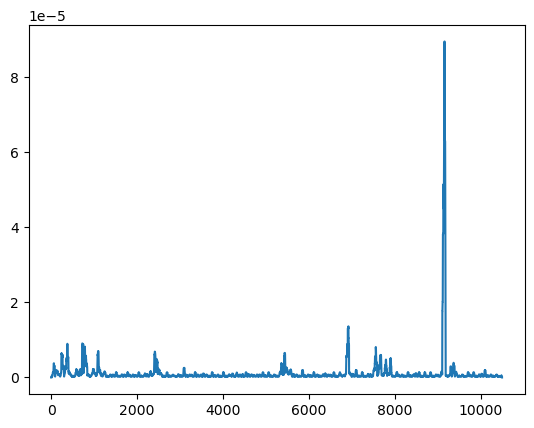

 91%|█████████████████████████████████████▎   | 273/300 [13:51<01:14,  2.74s/it]

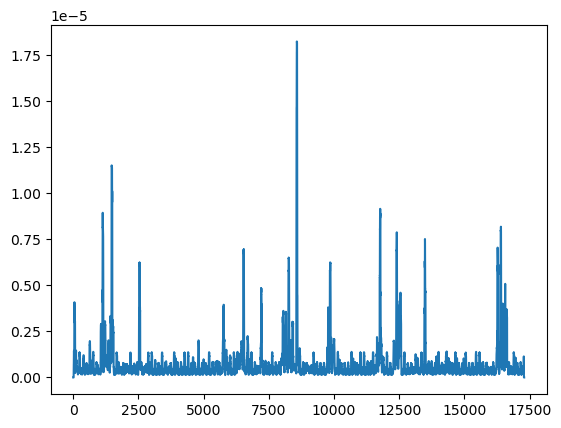

 91%|█████████████████████████████████████▍   | 274/300 [13:55<01:15,  2.91s/it]

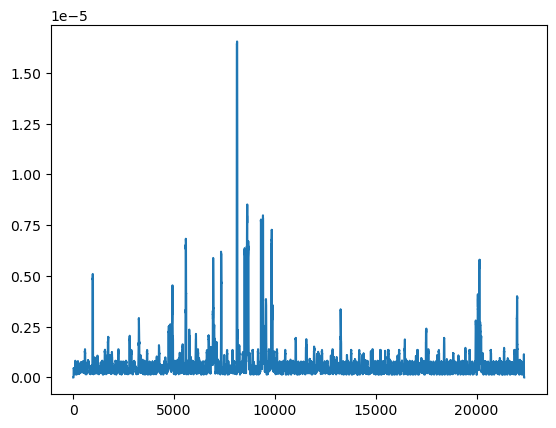

 92%|█████████████████████████████████████▌   | 275/300 [13:59<01:23,  3.34s/it]

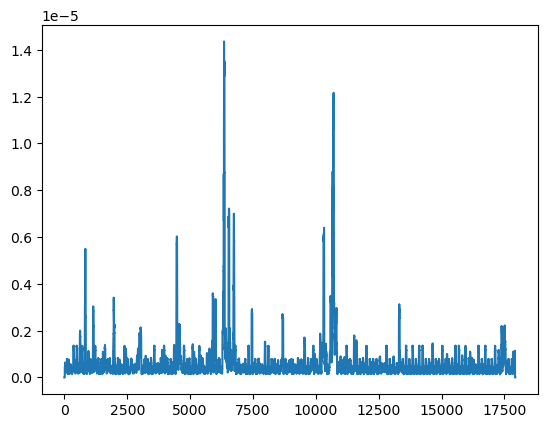

 92%|█████████████████████████████████████▋   | 276/300 [14:02<01:19,  3.33s/it]

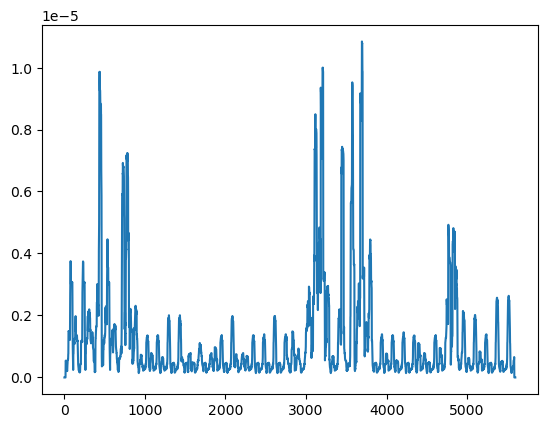

 92%|█████████████████████████████████████▊   | 277/300 [14:03<01:01,  2.66s/it]

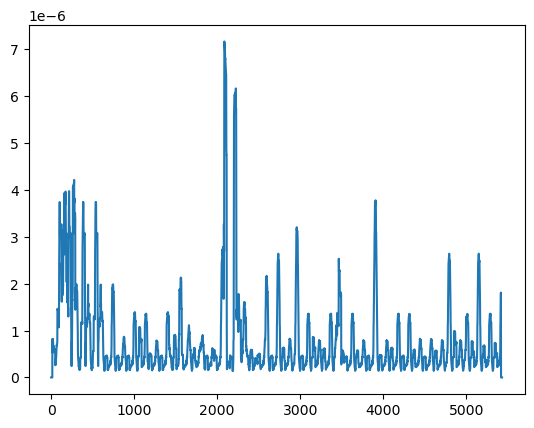

 93%|█████████████████████████████████████▉   | 278/300 [14:04<00:47,  2.18s/it]

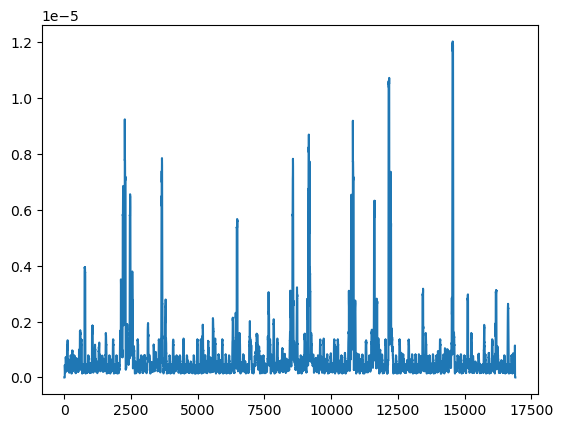

 93%|██████████████████████████████████████▏  | 279/300 [14:08<00:52,  2.51s/it]

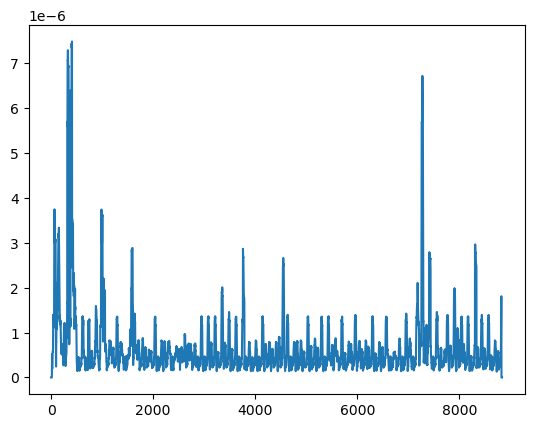

 93%|██████████████████████████████████████▎  | 280/300 [14:09<00:45,  2.26s/it]

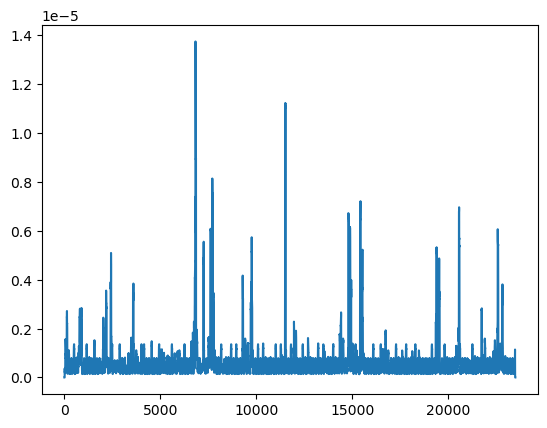

 94%|██████████████████████████████████████▍  | 281/300 [14:14<00:56,  2.99s/it]

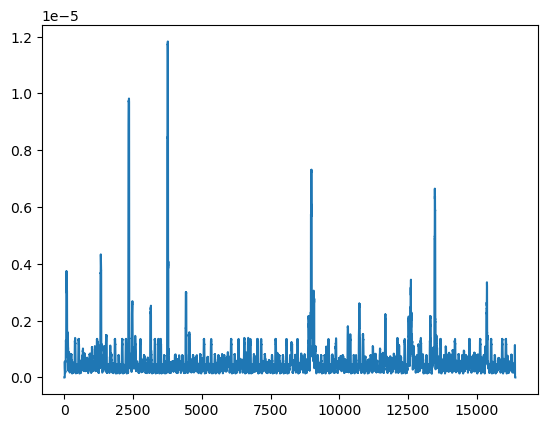

 94%|██████████████████████████████████████▌  | 282/300 [14:17<00:54,  3.00s/it]

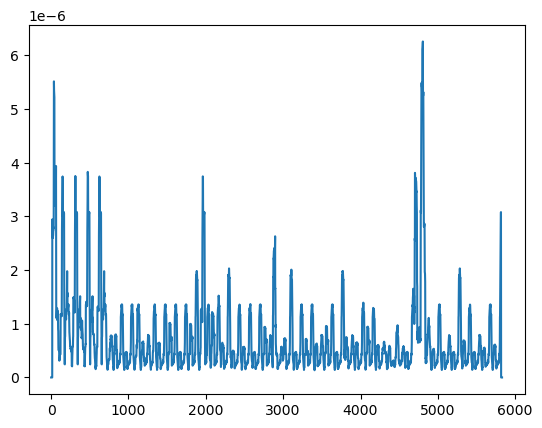

 94%|██████████████████████████████████████▋  | 283/300 [14:18<00:41,  2.45s/it]

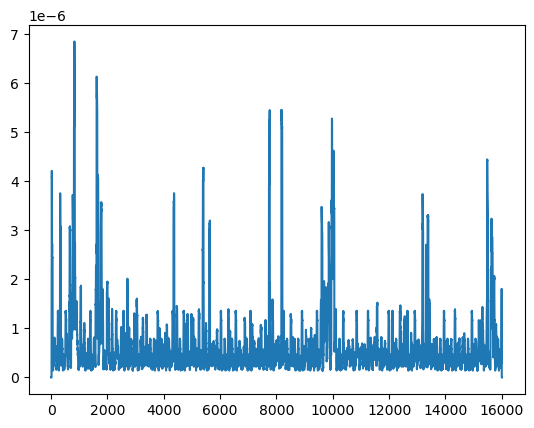

 95%|██████████████████████████████████████▊  | 284/300 [14:22<00:42,  2.67s/it]

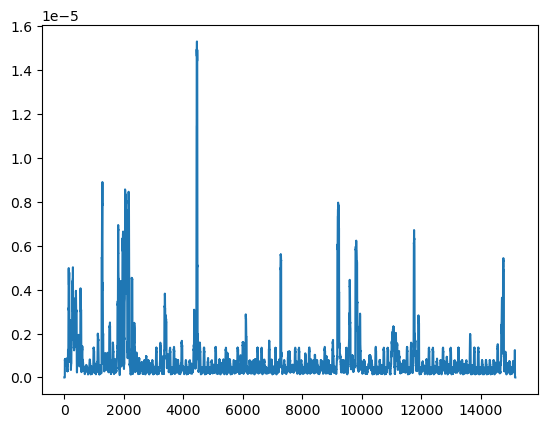

 95%|██████████████████████████████████████▉  | 285/300 [14:24<00:40,  2.71s/it]

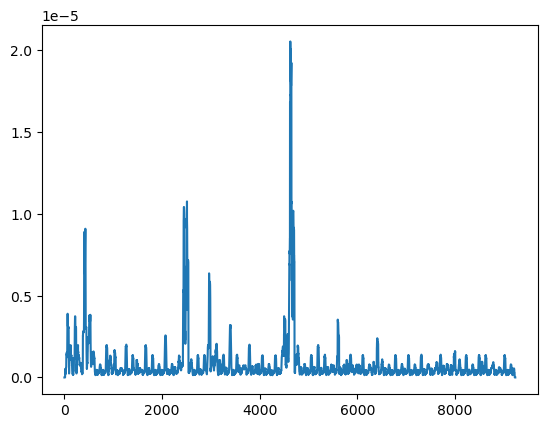

 95%|███████████████████████████████████████  | 286/300 [14:26<00:34,  2.45s/it]

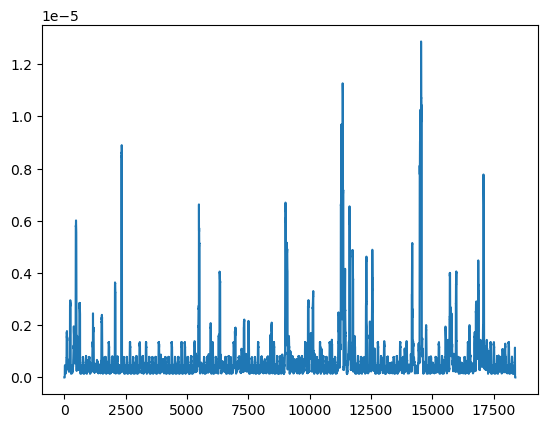

 96%|███████████████████████████████████████▏ | 287/300 [14:30<00:35,  2.75s/it]

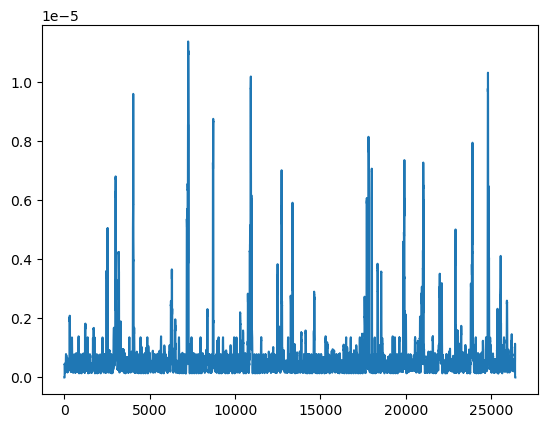

 96%|███████████████████████████████████████▎ | 288/300 [14:35<00:42,  3.53s/it]

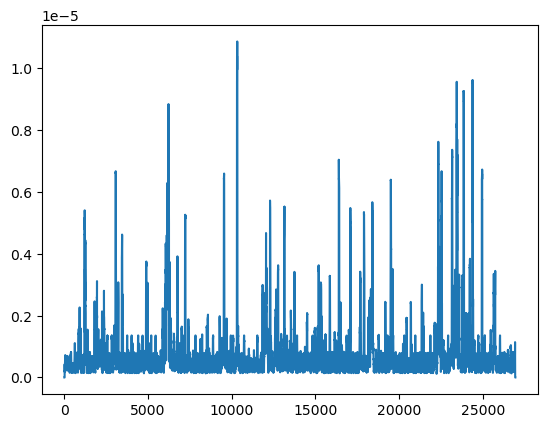

 96%|███████████████████████████████████████▍ | 289/300 [14:40<00:44,  4.05s/it]

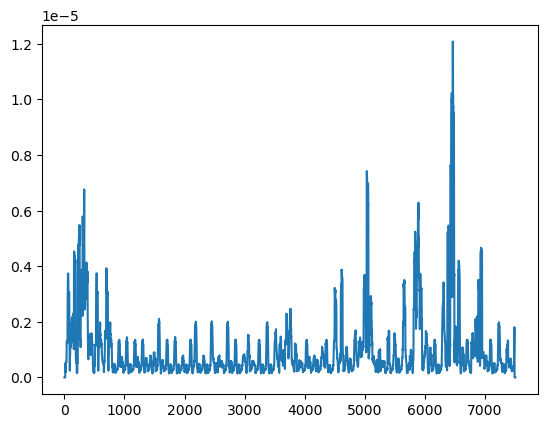

 97%|███████████████████████████████████████▋ | 290/300 [14:42<00:32,  3.27s/it]

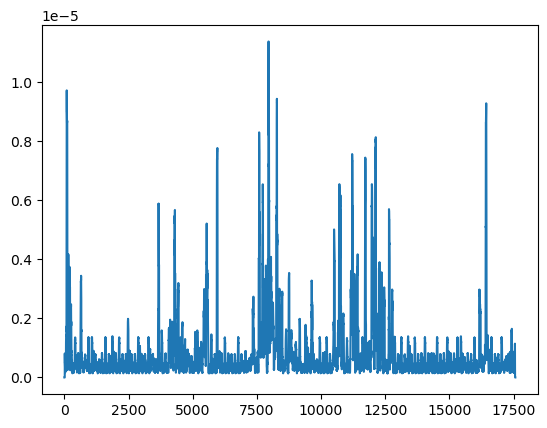

 97%|███████████████████████████████████████▊ | 291/300 [14:45<00:30,  3.35s/it]

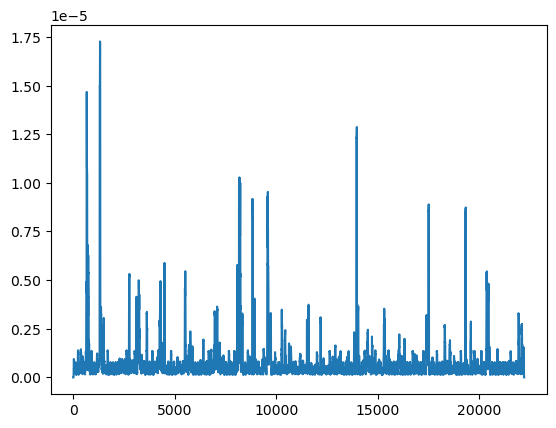

 97%|███████████████████████████████████████▉ | 292/300 [14:50<00:29,  3.64s/it]

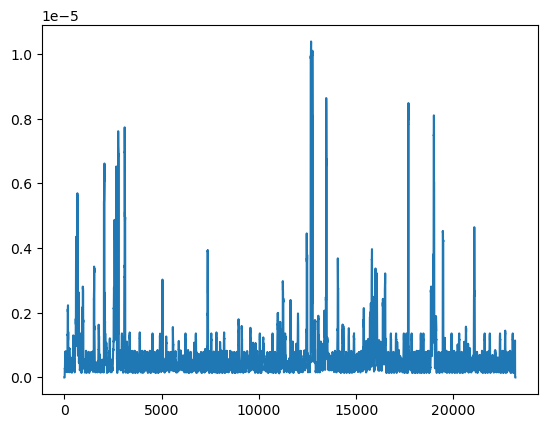

 98%|████████████████████████████████████████ | 293/300 [14:54<00:27,  3.90s/it]

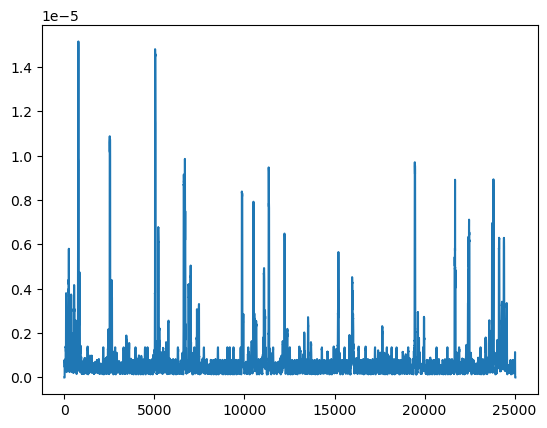

 98%|████████████████████████████████████████▏| 294/300 [14:59<00:25,  4.24s/it]

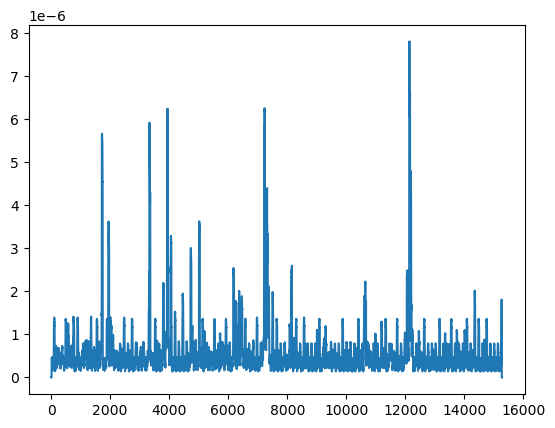

 98%|████████████████████████████████████████▎| 295/300 [15:02<00:19,  3.87s/it]

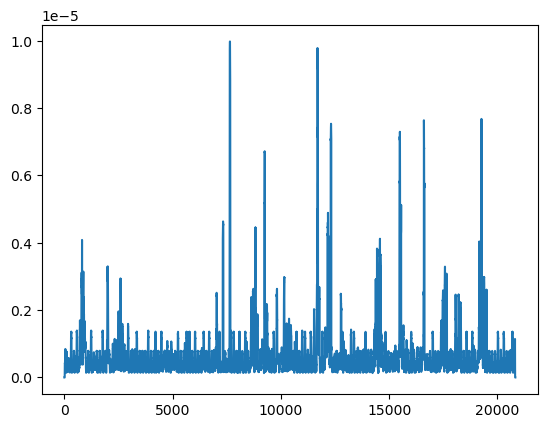

 99%|████████████████████████████████████████▍| 296/300 [15:07<00:16,  4.21s/it]

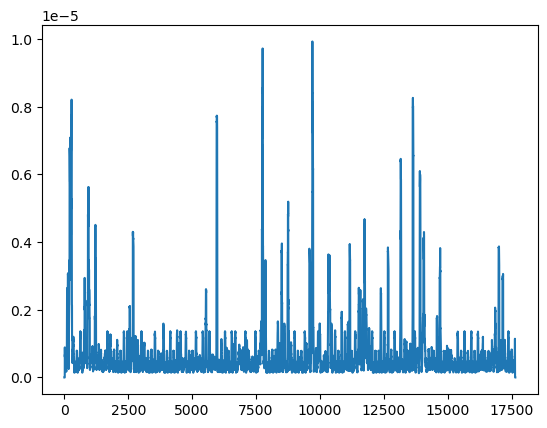

 99%|████████████████████████████████████████▌| 297/300 [15:11<00:12,  4.20s/it]

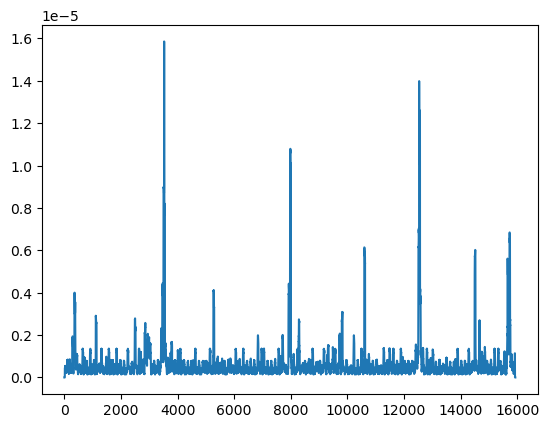

 99%|████████████████████████████████████████▋| 298/300 [15:15<00:08,  4.09s/it]

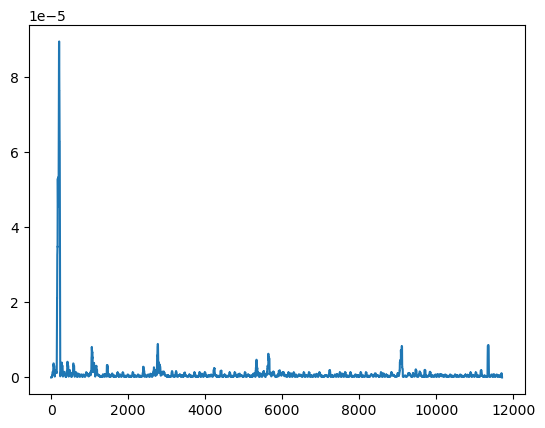

100%|████████████████████████████████████████▊| 299/300 [15:17<00:03,  3.53s/it]

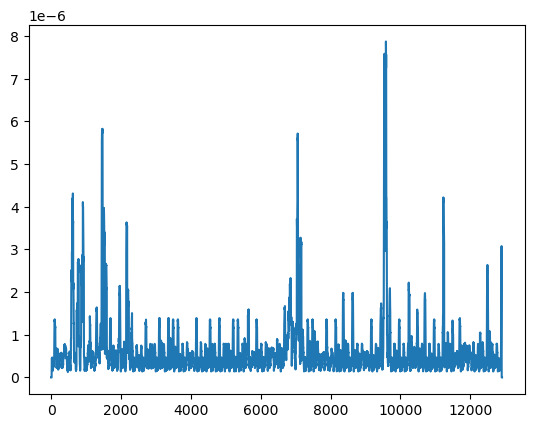

100%|█████████████████████████████████████████| 300/300 [15:20<00:00,  3.07s/it]

Bruteforce_CWE-307


In [34]:
recall, precision, fpr, f1_score, result_file_name = testing(Attack_list,threshold_list)


In [35]:
result_file_name

'/Users/cain/Desktop/Study/ML,DL_Project/LID-DS-2021_Preprocessing/result/FinalConv1dDense_7_50_time_30_layer_64_5e-06_200.txt'

In [36]:
f = open(result_file_name, 'r')
result_txt = f.read()
print(result_txt)
f.close()

Attack name : CVE-2014-0160
#####################
#####################
#####################
#####################
threshold : 5.000000e-06
Data count(Normal_and_Attack) : 100
anomaly_count : 100
Data count(Only Normal) : 300
false_positive_count : 237
Recall : 1.0
Precision : 0.2967359050357052
FPR(False Positive Rate) : 0.79
F1 score : 0.4576659003503187
----------------------------------
threshold : 1.000000e-05
Data count(Normal_and_Attack) : 100
anomaly_count : 100
Data count(Only Normal) : 300
false_positive_count : 79
Recall : 1.0
Precision : 0.5586592178458849
FPR(False Positive Rate) : 0.2633333333333333
F1 score : 0.7168458735113886
----------------------------------
threshold : 1.500000e-05
Data count(Normal_and_Attack) : 100
anomaly_count : 100
Data count(Only Normal) : 300
false_positive_count : 63
Recall : 1.0
Precision : 0.6134969324776995
FPR(False Positive Rate) : 0.21
F1 score : 0.7604562690222498
----------------------------------
threshold : 2.000000e-05
Data count

In [ ]:
f1_score[0]

In [ ]:
for i in range(len(Attack_list)):
    print("Attack name : "+ Attack_list[i])
    print("max f1_score : " + str(f1_score[i][f1_score[i].index(max(f1_score[i]))]))
    print("recall : " + str(recall[i][f1_score[i].index(max(f1_score[i]))]))
    print("precision : " +str(precision[i][f1_score[i].index(max(f1_score[i]))]))
    print("fpr : " +str(fpr[i][f1_score[i].index(max(f1_score[i]))]))
    print("Threshold : %e" %(threshold_list[f1_score[i].index(max(f1_score[i]))]))

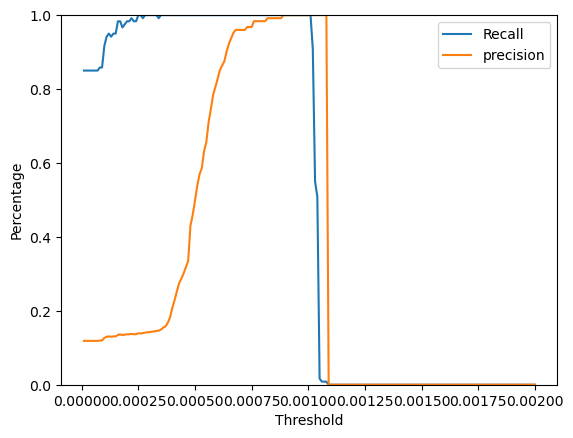

In [280]:
plt.figure()
plt.plot(threshold_list, recall, label="Recall")
plt.plot(threshold_list, precision, label="precision")
plt.xlabel('Threshold')
plt.ylabel('Percentage')
plt.ylim([0, 1]) 
plt.legend()

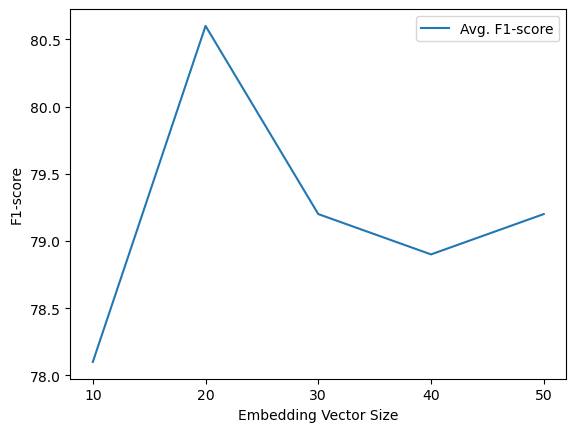

In [20]:
plt.figure()
plt.plot([10,20,30,40,50],[78.1,80.6,79.2,78.9,79.2], label="Avg. F1-score")
plt.xlabel('Embedding Vector Size')
plt.ylabel('F1-score')
plt.xticks([10, 20, 30, 40, 50])
plt.legend()

Text(0, 0.5, 'Avg. F1-score')

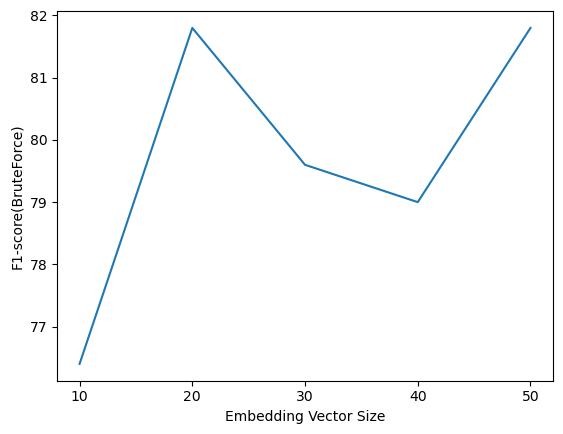

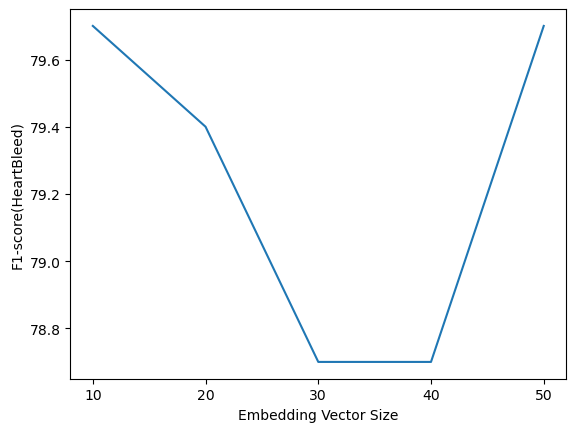

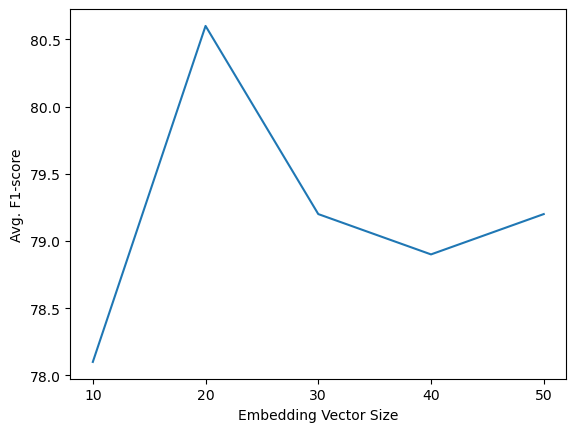

In [34]:
plt.figure()
plt.plot([10,20,30,40,50],[76.4, 81.8, 79.6, 79.0, 81.8], label="F1-score(BruteForce)")
plt.xlabel('Embedding Vector Size')
plt.ylabel('F1-score(BruteForce)')
plt.xticks([10, 20, 30, 40, 50])

plt.figure()
plt.plot([10,20,30,40,50],[79.7, 79.4, 78.7, 78.7, 79.7], label="F1-score(HeartBleed)")
plt.xlabel('Embedding Vector Size')
plt.ylabel('F1-score(HeartBleed)')
plt.xticks([10, 20, 30, 40, 50])

plt.figure()
plt.xticks([10, 20, 30, 40, 50])
plt.plot([10,20,30,40,50],[78.1,80.6,79.2,78.9,79.2], label="Avg. F1-score")
plt.xlabel('Embedding Vector Size')
plt.ylabel('Avg. F1-score')


Text(0, 0.5, 'Avg. F1-score')

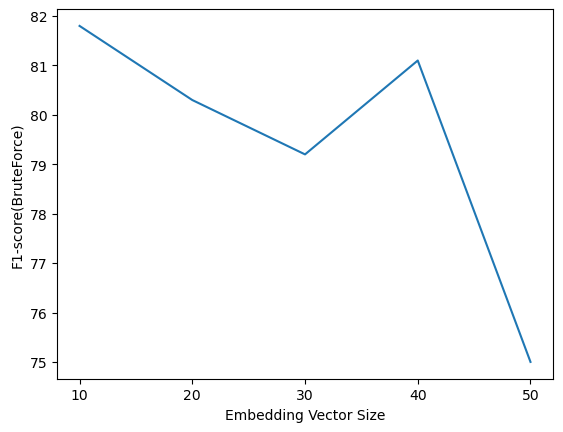

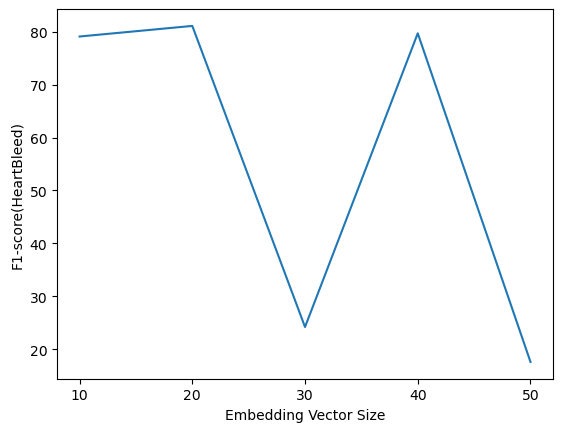

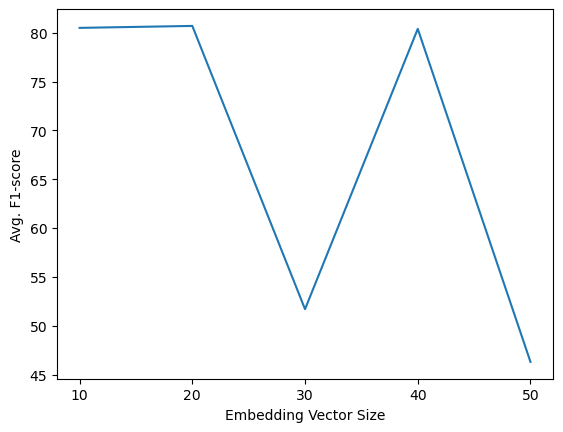

In [35]:
plt.figure()
plt.plot([10,20,30,40,50],[81.8, 80.3, 79.2, 81.1, 75.0], label="F1-score(BruteForce)")
plt.xlabel('Embedding Vector Size')
plt.ylabel('F1-score(BruteForce)')
plt.xticks([10, 20, 30, 40, 50])

plt.figure()
plt.plot([10,20,30,40,50],[79.1, 81.1, 24.2, 79.7, 17.6], label="F1-score(HeartBleed)")
plt.xlabel('Embedding Vector Size')
plt.ylabel('F1-score(HeartBleed)')
plt.xticks([10, 20, 30, 40, 50])

plt.figure()
plt.xticks([10, 20, 30, 40, 50])
plt.plot([10,20,30,40,50],[80.5,80.7,51.7,80.4,46.3], label="Avg. F1-score")
plt.xlabel('Embedding Vector Size')
plt.ylabel('Avg. F1-score')


In [ ]:
plt.figure()
plt.plot([10,20,30,40,50],[79.7, 79.4, 78.7, 78.7, 79.7], label="F1-score(HeartBleed)")
plt.xlabel('Embedding Vector Size')
plt.ylabel('F1-score')
plt.xticks([10, 20, 30, 40, 50])
plt.legend()

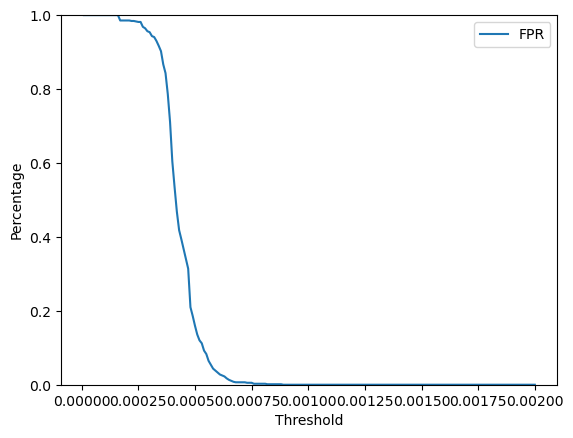

In [281]:
plt.figure()
plt.plot(threshold_list, fpr, label='FPR')
plt.xlabel('Threshold')
plt.ylabel('Percentage')
plt.ylim([0, 1]) 
plt.legend()

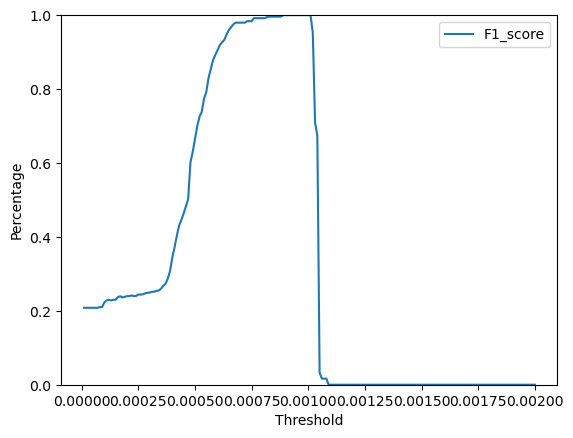

In [282]:
plt.figure()
plt.plot(threshold_list, f1_score, label='F1_score')
plt.xlabel('Threshold')
plt.ylabel('Percentage')
plt.ylim([0, 1])   
plt.legend()

In [ ]:
def testing(Attack_list,threshold_list):
    recall_all = []
    precision_all = []
    fpr_all = []
    f1_score_all=[]
    for name in Attack_list:
        Base_tmp_dir = Base_dir+name
        file_dir = Base_tmp_dir+"/"+ 'test/normal_and_attack'
        #Use normal_and_attack data
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        #print(len(file_list))
        file_list = file_list[:test_attack_data_size]
        attack_data_count = len(file_list)
        real_anomaly_count = [0 for i in range(len(threshold_list))]
        false_positive_count = [0 for i in range(len(threshold_list))]
        file_list = file_list[:test_attack_data_size]
        for e in tqdm(file_list):
            #print(e)
            sample_event_direction = []
            sample_event_type = []
            sample_user_uid = []
            sample_res = []
            sample_size = []
            sample_fd = []

            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")


            sample_event_direction.extend(sample['event_direction'])
            sample_event_type_tmp = sample['event_type'].tolist()
            sample_event_type_tmp = list(map(embedding_syscall,sample_event_type_tmp))
            sample_event_type.extend(sample_event_type_tmp)

            sample_user_uid.extend(sample['user_uid'])

            sample_param = sample['event_argument']

            tmp_res, tmp_size, tmp_fd= extract_params(sample_param)

            sample_res.extend(tmp_res)
            sample_size.extend(tmp_size)
            sample_fd.extend(tmp_fd)

            return_x = pd.DataFrame(zip(sample_res),columns=['res'])        
            return_x = scaler.transform(return_x)
            return_x = pd.DataFrame(return_x,columns=['res'])


            return_x['event_direction'] = sample_event_direction
            return_x = pd.get_dummies(return_x, columns=['event_direction'])
            return_x.drop(['event_direction_<'],axis=1,inplace=True)
            sample_event_type_df = pd.DataFrame(sample_event_type)
            return_x = pd.concat([return_x, sample_event_type_df],axis=1)

            test_x = making_model_input(return_x,model_input_sliding_size)


            predict = loaded_model.predict(test_x,verbose=0)

            pred = make_2d(predict)
            test_chk = return_x[model_input_sliding_size-1:]

            error = test_chk - pred
            mse = pd.Series(np.mean(np.power(error,2),axis=1))
            mean_window = mse.rolling(30,center=True).mean()
            window_error = mean_window.fillna(0)
            window_error.reset_index(drop=True,inplace=True)
            mse = mse.reset_index()
            plt.plot(window_error)
            #plt.axhline(y=threshold, color='r', linewidth=1)
            plt.show()

            real_label = make_label(Base_tmp_dir,e)

            '''  cos_similarity = np.array([])
            testing_1= torch.tensor(test_chk.values)
            testing_2 = torch.tensor(pred)
            #print(validation_chk.iloc[0])
            for i in range(testing_1.shape[0]):
                tmp_a = testing_1[i].reshape(-1,1)
                tmp_b = testing_2[i].reshape(-1,1)
                cos_similarity = np.append(cos_similarity,cos(testing_1,testing_2))
            result_cos = np.array(cos_similarity)
            plt.plot(result_cos)
            plt.show()'''
            k=0
            for threshold in threshold_list:
                chk =0 
                flag_real = 0
                flag_false=0
                checking_index = np.array(np.where(window_error > threshold)).reshape(-1)
                checking_index = checking_index + 30
                
                if len(np.where(checking_index >= real_label)[0]) > 0:
                    flag_real = 1
                    
                if len(np.where(checking_index < real_label)[0]) > 0 :
                    flag_false = 1
                
                    
                if flag_false > 0:
                    false_positive_count[k] = false_positive_count[k] + 1
                    #print("FALSE ALARM!!!!!!!!!!!!!!!")

                if flag_real > 0:
                    real_anomaly_count[k] = real_anomaly_count[k] + 1
                    #print("ALARM!!!!!!!!!!!!!!!")

    
               
                k=k+1
            gc.collect()    
        file_dir = Base_tmp_dir+"/"+ 'test/normal'
        #Use normal_and_attack data
        file_list = sorted(os.listdir(file_dir))
        if '.DS_Store' in file_list:   
             file_list.remove('.DS_Store') #Mac의 경우만 존재하는 것 같음 Mac환경이 아니라면 이 row를 무방함
        #print(len(file_list))
        
        
        file_list=file_list[:test_noraml_data_size]
        normal_data_count = len(file_list)

        false_anomaly_count = [0 for i in range(len(threshold_list))]
        chk_more_false = [0 for i in range(len(threshold_list))]

       
        for e in tqdm(file_list):
            #print(e)
            sample_event_direction = []
            sample_event_type = []
            sample_user_uid = []
            sample_res = []
            sample_size = []
            sample_fd = []

            sample = pd.read_csv(file_dir + "/" + e + "/" + e+".csv")


            sample_event_direction.extend(sample['event_direction'])
            sample_event_type_tmp = sample['event_type'].tolist()
            sample_event_type_tmp = list(map(embedding_syscall,sample_event_type_tmp))
            sample_event_type.extend(sample_event_type_tmp)

            sample_user_uid.extend(sample['user_uid'])

            sample_param = sample['event_argument']

            tmp_res, tmp_size, tmp_fd= extract_params(sample_param)

            sample_res.extend(tmp_res)
            sample_size.extend(tmp_size)
            sample_fd.extend(tmp_fd)

            return_x = pd.DataFrame(zip(sample_res),columns=['res'])        

            return_x = scaler.transform(return_x)
            return_x = pd.DataFrame(return_x,columns=['res'])


            return_x['event_direction'] = sample_event_direction
            return_x = pd.get_dummies(return_x, columns=['event_direction'])
            return_x.drop(['event_direction_<'],axis=1,inplace=True)
            sample_event_type_df = pd.DataFrame(sample_event_type)
            return_x = pd.concat([return_x, sample_event_type_df],axis=1)

            test_x = making_model_input(return_x,model_input_sliding_size)

            predict = loaded_model.predict(test_x,verbose=0)

            pred = make_2d(predict)
            test_chk = return_x[model_input_sliding_size-1:]


            error = test_chk - pred
            mse = pd.Series(np.mean(np.power(error,2),axis=1))
            mean_window = mse.rolling(30,center=True).mean()
            window_error = mean_window.fillna(0)
            window_error.reset_index(drop=True,inplace=True)
            mse = mse.reset_index()
            plt.plot(window_error)
            #plt.axhline(y=threshold, color='r', linewidth=1)
            plt.show()

            ''' cos_similarity = np.array([])
            testing_1= torch.tensor(test_chk.values)
            testing_2 = torch.tensor(pred)
            #print(validation_chk.iloc[0])
            for i in range(testing_1.shape[0]):
                tmp_a = testing_1[i].reshape(-1,1)
                tmp_b = testing_2[i].reshape(-1,1)
                cos_similarity = np.append(cos_similarity,cos(testing_1,testing_2))
            result_cos = np.array(cos_similarity)
            plt.plot(result_cos)
            plt.show()'''
            k=0
            for threshold in threshold_list:
                checking_index = np.array(np.where(window_error > threshold)).reshape(-1)
                checking_index = checking_index + 30
                if len(checking_index) > 0:
                    false_anomaly_count[k] = false_anomaly_count[k] + 1
                k=k+1
        gc.collect()
        recall = []
        precision = []
        fpr = []
        f1_score=[]
        result_file_name = result_save_dir + model_name + '_' + str(threshold_list[0]) + '_' + str(len(threshold_list)) + '.txt'
        f = open(result_file_name,'a')
        f.write("Attack name : "+name+"\n")
        print(name)
        f.write("#####################\n")
        f.write("#####################\n")
        f.write("#####################\n")
        f.write("#####################\n")
        for i in range(len(threshold_list)):
            recall_tmp = real_anomaly_count[i]/attack_data_count
            precision_tmp = real_anomaly_count[i]/(false_anomaly_count[i]+real_anomaly_count[i]+1e-8)#epsilon
            fpr_tmp = false_anomaly_count[i]/normal_data_count
            f1_score_tmp = 2*precision_tmp*recall_tmp/(precision_tmp+recall_tmp+1e-8)#epsilon
            f.write(f"threshold : %e\n" % threshold_list[i])
            f.write("Data count(Normal_and_Attack) : " + str(attack_data_count)+"\n")
            f.write("anomaly_count : " + str(real_anomaly_count[i])+"\n")           
            f.write("Data count(Only Normal) : " + str(normal_data_count)+"\n")
            f.write("false_positive_count : " + str(false_anomaly_count[i])+"\n")
            f.write("Recall : "+str(recall_tmp)+"\n") 
            f.write("Precision : "+str(precision_tmp)+"\n")
            f.write("FPR(False Positive Rate) : "+str(fpr_tmp)+"\n")
            f.write("F1 score : " + str(f1_score_tmp)+"\n")
            f.write("----------------------------------\n")
            recall.append(recall_tmp)
            precision.append(precision_tmp)
            fpr.append(fpr_tmp)
            f1_score.append(f1_score_tmp)
        recall_all.append(recall)
        precision_all.append(precision)
        fpr_all.append(fpr)
        f1_score_all.append(f1_score)
        f.close()
    return recall_all, precision_all, fpr_all, f1_score_all, result_file_name

In [ ]:
#backup
def make_label(directory , scenario_name):
    sample = pd.read_csv(directory+"/test/normal_and_attack/"+scenario_name+"/"+scenario_name+".csv",index_col=0)
    json_csv = pd.read_csv(directory+'/outline_json/test_normal_and_attack.csv',index_col=0)
    #print(json_csv)
    tmp_json_csv =json_csv.loc[json_csv['scenario_name'] == scenario_name,'exploit_absolute']
    tmp_json_csv = tmp_json_csv.astype(str)
    tmp_json_csv = tmp_json_csv.tolist()
    #print(tmp_json_csv)
    start_ex = tmp_json_csv[0][:12]
    start_ex = int(start_ex)
    
    event_record_time = sample['event_time']
    event_record_time = event_record_time.astype(str)
    event_record_time = event_record_time.apply(lambda x : x[:12])
    event_record_time = event_record_time.astype(int)
    
    label = event_record_time[(event_record_time == start_ex)]
    label_1s = event_record_time[(event_record_time == start_ex+1)]
    label_2s = event_record_time[(event_record_time == start_ex+2)]
    #timestamp의 오차로 인해 향후 0.02초까지 공격이라고 판정
    label = label.index.tolist()
    
    if(len(label_1s)>0):
        label_1s = label_1s.index.tolist()
        label.extend(label_1s)
        if(len(label_2s)>0):
            label.extend(label_2s.index.tolist())
    real_label = [label[0],len(label)]
    return real_label
    
